<a href="https://colab.research.google.com/github/deepanshgoyal33/VGAN/blob/master/Noob_Gan.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import torch
from torch import nn, optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets
!ln -sf /opt/bin/nvidia-smi /usr/bin/nvidia-smi
!pip install gputil
!pip install psutil
!pip install humanize
import psutil
import humanize
import os
import GPUtil as GPU
GPUs = GPU.getGPUs()
# XXX: only one GPU on Colab and isn’t guaranteed
gpu = GPUs[0]
def printm():
 process = psutil.Process(os.getpid())
 print("Gen RAM Free: " + humanize.naturalsize( psutil.virtual_memory().available ), " | Proc size: " + humanize.naturalsize( process.memory_info().rss))
 print("GPU RAM Free: {0:.0f}MB | Used: {1:.0f}MB | Util {2:3.0f}% | Total {3:.0f}MB".format(gpu.memoryFree, gpu.memoryUsed, gpu.memoryUtil*100, gpu.memoryTotal))
printm() 

Gen RAM Free: 12.9 GB  | Proc size: 262.2 MB
GPU RAM Free: 15079MB | Used: 0MB | Util   0% | Total 15079MB


In [0]:
def mnist_data():
    compose = transforms.Compose(
        [transforms.ToTensor(),
         transforms.Normalize((.5,), (.5,))
        ])
    out_dir = './dataset'
    return datasets.MNIST(root=out_dir, train=True, transform=compose, download=True)
data = mnist_data()
data_loader = torch.utils.data.DataLoader(data, batch_size=100, shuffle=True)
num_batches = len(data_loader)

In [0]:
class DiscriminatorNet(torch.nn.Module):
    def __init__(self):
        super(DiscriminatorNet, self).__init__()
        n_features = 784
        n_out = 1
        
        self.hidden0 = nn.Sequential( 
            nn.Linear(n_features, 1024),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden1 = nn.Sequential(
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.out = nn.Sequential(
            torch.nn.Linear(256, n_out),
            torch.nn.Sigmoid()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x

In [0]:
discriminator = DiscriminatorNet().cuda()

In [0]:
def images_to_vectors(images):
  return images.view(images.size(0),784)
def vectors_to_images(vectors):
  return vectors.view(vectors.size(0),1,28,28)

In [0]:
class GeneratorNet(torch.nn.Module):
  def __init__(self):
    super(GeneratorNet, self).__init__()
    n_features = 100
    n_out = 784      
    self.hidden0 = nn.Sequential(
      nn.Linear(n_features, 256),
      nn.LeakyReLU(0.2)
    )
    self.hidden1 = nn.Sequential(            
      nn.Linear(256, 512),
      nn.LeakyReLU(0.2)
      )
    self.hidden2 = nn.Sequential(
      nn.Linear(512, 1024),
      nn.LeakyReLU(0.2)
      )
    self.out = nn.Sequential(
      nn.Linear(1024, n_out),
      nn.Tanh()
      )

  def forward(self, x):
    x = self.hidden0(x)
    x = self.hidden1(x)
    x = self.hidden2(x)
    x = self.out(x)
    return x


In [0]:
def noise(size):
    n = Variable(torch.randn(size, 100))
    return n

In [0]:
generator = GeneratorNet().cuda()

In [0]:
d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002)
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002)

In [0]:
loss = nn.BCELoss()

In [0]:
def ones_target(size):
    data = Variable(torch.ones(size, 1))
    return data

def zeros_target(size):
    data = Variable(torch.zeros(size, 1))
    return data

In [12]:
!pip install tensorboardX

In [0]:
def train_discriminator(optimizer, real_data, fake_data):
    N = real_data.size(0)
    optimizer.zero_grad()
    
    # 1.1 Train on Real Data
    prediction_real = discriminator(real_data)
    # Calculate error and backpropagate
    error_real = loss(prediction_real, ones_target(N).cuda() )
    error_real.backward()

    # 1.2 Train on Fake Data
    prediction_fake = discriminator(fake_data)
    # Calculate error and backpropagate
    error_fake = loss(prediction_fake, zeros_target(N).cuda())
    error_fake.backward()
    
    # 1.3 Update weights with gradients
    optimizer.step()
    
    # Return error and predictions for real and fake inputs
    return error_real + error_fake, prediction_real, prediction_fake

In [0]:
import os
import numpy as np
import errno
import torchvision.utils as vutils
from tensorboardX import SummaryWriter
from IPython import display
from matplotlib import pyplot as plt
import torch



class Logger:

    def __init__(self, model_name, data_name):
        self.model_name = model_name
        self.data_name = data_name

        self.comment = '{}_{}'.format(model_name, data_name)
        self.data_subdir = '{}/{}'.format(model_name, data_name)

        # TensorBoard
        self.writer = SummaryWriter(comment=self.comment)

    def log(self, d_error, g_error, epoch, n_batch, num_batches):

        # var_class = torch.autograd.variable.Variable
        if isinstance(d_error, torch.autograd.Variable):
            d_error = d_error.data.cpu().numpy()
        if isinstance(g_error, torch.autograd.Variable):
            g_error = g_error.data.cpu().numpy()

        step = Logger._step(epoch, n_batch, num_batches)
        self.writer.add_scalar(
            '{}/D_error'.format(self.comment), d_error, step)
        self.writer.add_scalar(
            '{}/G_error'.format(self.comment), g_error, step)

    def log_images(self, images, num_images, epoch, n_batch, num_batches, format='NCHW', normalize=True):
        '''
        input images are expected in format (NCHW)
        '''
        if type(images) == np.ndarray:
            images = torch.from_numpy(images)
        
        if format=='NHWC':
            images = images.transpose(1,3)
        

        step = Logger._step(epoch, n_batch, num_batches)
        img_name = '{}/images{}'.format(self.comment, '')

        # Make horizontal grid from image tensor
        horizontal_grid = vutils.make_grid(
            images, normalize=normalize, scale_each=True)
        # Make vertical grid from image tensor
        nrows = int(np.sqrt(num_images))
        grid = vutils.make_grid(
            images, nrow=nrows, normalize=True, scale_each=True)

        # Add horizontal images to tensorboard
        self.writer.add_image(img_name, horizontal_grid, step)

        # Save plots
        self.save_torch_images(horizontal_grid, grid, epoch, n_batch)

    def save_torch_images(self, horizontal_grid, grid, epoch, n_batch, plot_horizontal=True):
        out_dir = './data/images/{}'.format(self.data_subdir)
        Logger._make_dir(out_dir)

        # Plot and save horizontal
        fig = plt.figure(figsize=(16, 16))
        plt.imshow(np.moveaxis(horizontal_grid.cpu().numpy(), 0, -1))
        plt.axis('off')
        if plot_horizontal:
            display.display(plt.gcf())
        self._save_images(fig, epoch, n_batch, 'hori')
        plt.close()

        # Save squared
        fig = plt.figure()
        plt.imshow(np.moveaxis(grid.cpu().numpy(), 0, -1))
        plt.axis('off')
        self._save_images(fig, epoch, n_batch)
        plt.close()

    def _save_images(self, fig, epoch, n_batch, comment=''):
        out_dir = './data/images/{}'.format(self.data_subdir)
        Logger._make_dir(out_dir)
        fig.savefig('{}/{}_epoch_{}_batch_{}.png'.format(out_dir,
                                                         comment, epoch, n_batch))

    def display_status(self, epoch, num_epochs, n_batch, num_batches, d_error, g_error, d_pred_real, d_pred_fake):
        
        # var_class = torch.autograd.variable.Variable
        if isinstance(d_error, torch.autograd.Variable):
            d_error = d_error.data.cpu().numpy()
        if isinstance(g_error, torch.autograd.Variable):
            g_error = g_error.data.cpu().numpy()
        if isinstance(d_pred_real, torch.autograd.Variable):
            d_pred_real = d_pred_real.data
        if isinstance(d_pred_fake, torch.autograd.Variable):
            d_pred_fake = d_pred_fake.data
        
        
        print('Epoch: [{}/{}], Batch Num: [{}/{}]'.format(
            epoch,num_epochs, n_batch, num_batches)
             )
        print('Discriminator Loss: {:.4f}, Generator Loss: {:.4f}'.format(d_error, g_error))
        print('D(x): {:.4f}, D(G(z)): {:.4f}'.format(d_pred_real.mean(), d_pred_fake.mean()))

    def save_models(self, generator, discriminator, epoch):
        out_dir = './data/models/{}'.format(self.data_subdir)
        Logger._make_dir(out_dir)
        torch.save(generator.state_dict(),
                   '{}/G_epoch_{}'.format(out_dir, epoch))
        torch.save(discriminator.state_dict(),
                   '{}/D_epoch_{}'.format(out_dir, epoch))

    def close(self):
        self.writer.close()


    @staticmethod
    def _step(epoch, n_batch, num_batches):
        return epoch * num_batches + n_batch

    @staticmethod
    def _make_dir(directory):
        try:
            os.makedirs(directory)
        except OSError as e:
            if e.errno != errno.EEXIST:
                raise

In [0]:
def train_generator(optimizer, fake_data):
    N = fake_data.size(0)
    optimizer.zero_grad()
    # Sample noise and generate fake data
    prediction = discriminator(fake_data)
    # Calculate error and backpropagate
    error = loss(prediction, ones_target(N).cuda())
    error.backward()
    # Update weights with gradients
    optimizer.step()
    # Return error
    return error

In [0]:
num_test_samples = 16
test_noise = noise(num_test_samples)

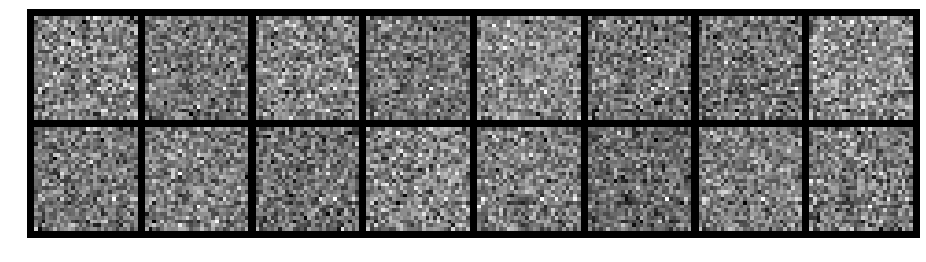

Epoch: [0/200], Batch Num: [0/600]
Discriminator Loss: 1.3496, Generator Loss: 0.7055
D(x): 0.5122, D(G(z)): 0.4935


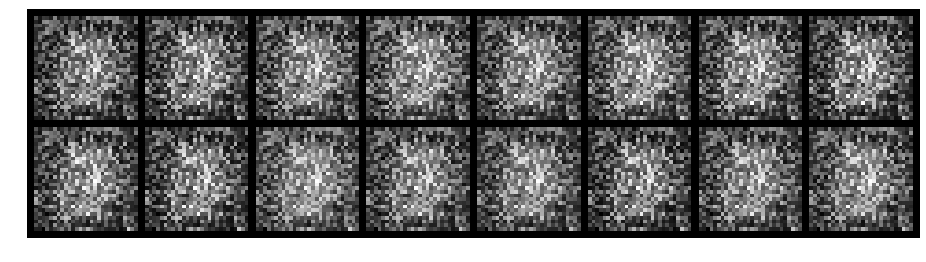

Epoch: [0/200], Batch Num: [100/600]
Discriminator Loss: 1.5559, Generator Loss: 1.0089
D(x): 0.7427, D(G(z)): 0.6511


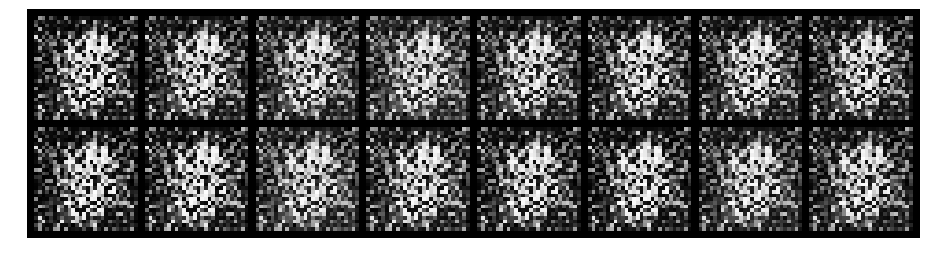

Epoch: [0/200], Batch Num: [200/600]
Discriminator Loss: 0.2959, Generator Loss: 3.2492
D(x): 0.9494, D(G(z)): 0.1998


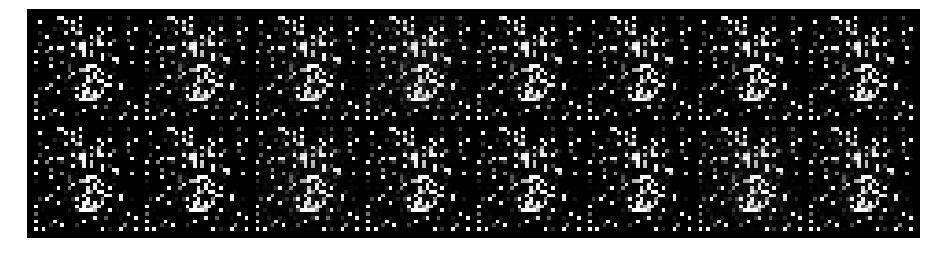

Epoch: [0/200], Batch Num: [300/600]
Discriminator Loss: 0.2311, Generator Loss: 5.6474
D(x): 0.9227, D(G(z)): 0.0843


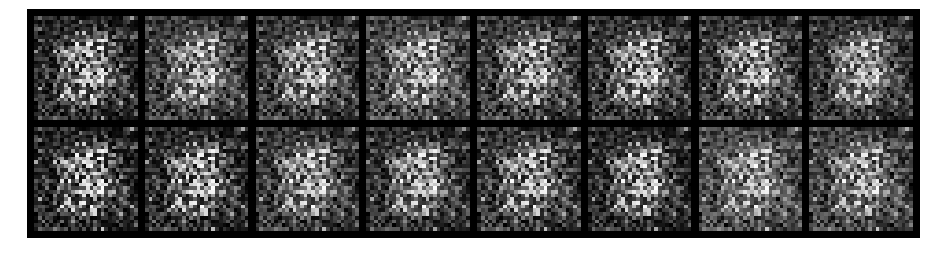

Epoch: [0/200], Batch Num: [400/600]
Discriminator Loss: 1.4596, Generator Loss: 0.8749
D(x): 0.6158, D(G(z)): 0.5798


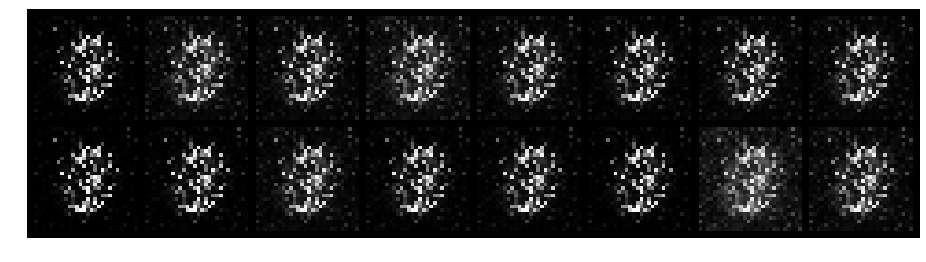

Epoch: [0/200], Batch Num: [500/600]
Discriminator Loss: 0.6959, Generator Loss: 2.2035
D(x): 0.7343, D(G(z)): 0.2588


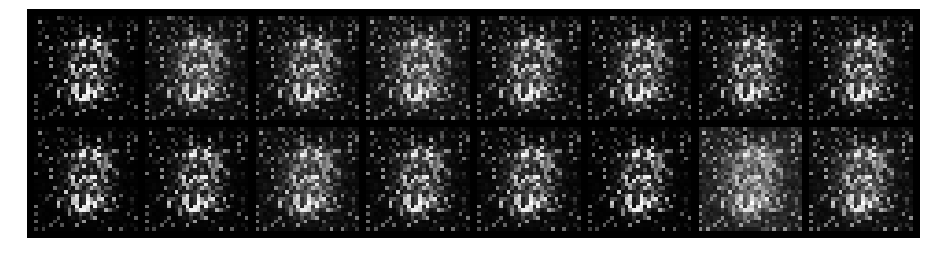

Epoch: [1/200], Batch Num: [0/600]
Discriminator Loss: 0.7940, Generator Loss: 3.7086
D(x): 0.8274, D(G(z)): 0.3286


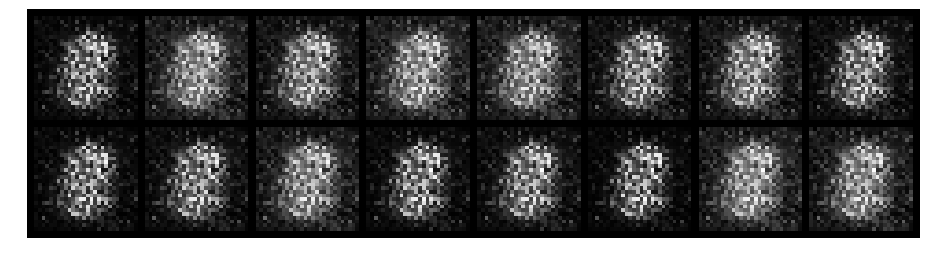

Epoch: [1/200], Batch Num: [100/600]
Discriminator Loss: 1.6494, Generator Loss: 0.6655
D(x): 0.6394, D(G(z)): 0.6397


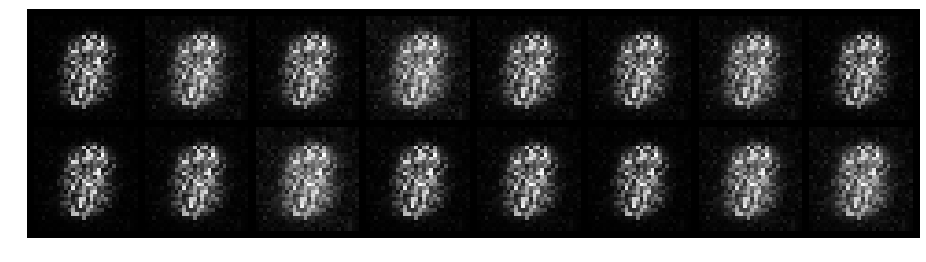

Epoch: [1/200], Batch Num: [200/600]
Discriminator Loss: 1.5443, Generator Loss: 1.1987
D(x): 0.5495, D(G(z)): 0.4567


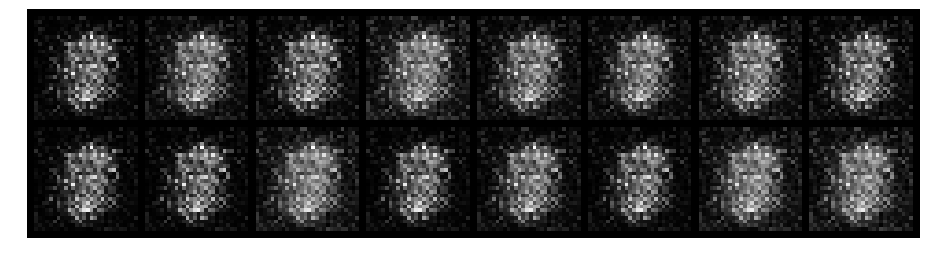

Epoch: [1/200], Batch Num: [300/600]
Discriminator Loss: 1.6062, Generator Loss: 1.4577
D(x): 0.6089, D(G(z)): 0.5006


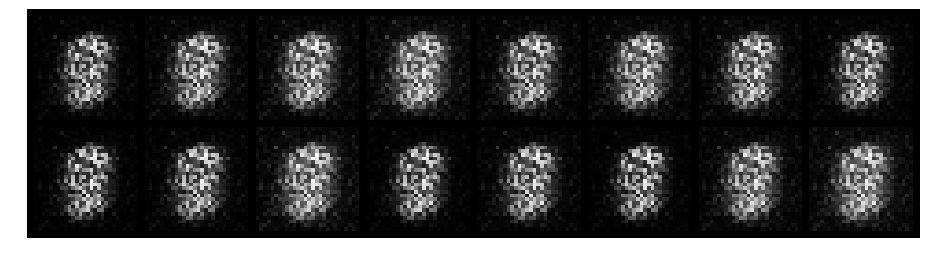

Epoch: [1/200], Batch Num: [400/600]
Discriminator Loss: 1.5247, Generator Loss: 1.1381
D(x): 0.5563, D(G(z)): 0.4689


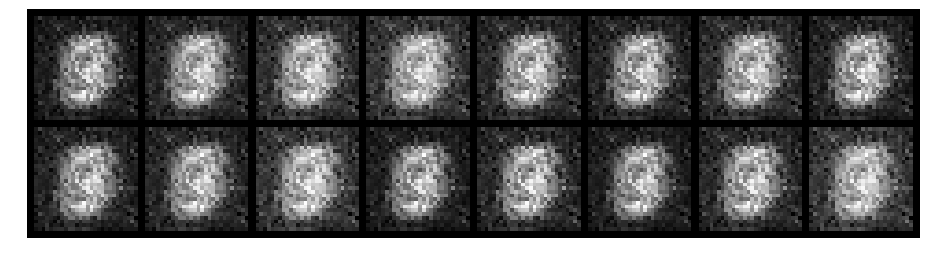

Epoch: [1/200], Batch Num: [500/600]
Discriminator Loss: 0.4408, Generator Loss: 3.0856
D(x): 0.8024, D(G(z)): 0.1542


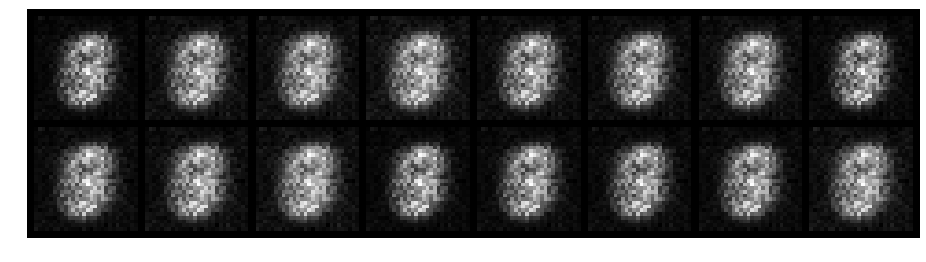

Epoch: [2/200], Batch Num: [0/600]
Discriminator Loss: 0.8864, Generator Loss: 1.1972
D(x): 0.6469, D(G(z)): 0.3381


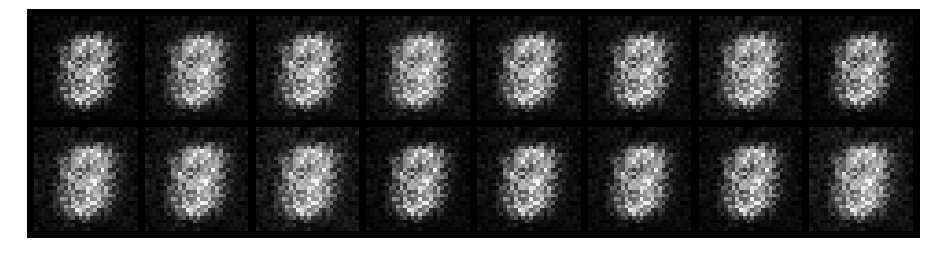

Epoch: [2/200], Batch Num: [100/600]
Discriminator Loss: 1.0081, Generator Loss: 0.9940
D(x): 0.6201, D(G(z)): 0.3904


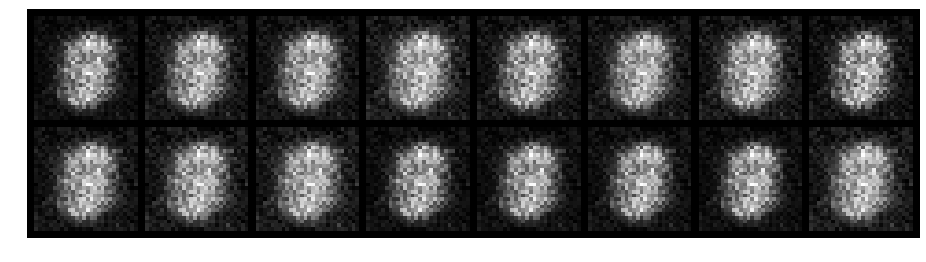

Epoch: [2/200], Batch Num: [200/600]
Discriminator Loss: 0.8514, Generator Loss: 1.4410
D(x): 0.6834, D(G(z)): 0.3214


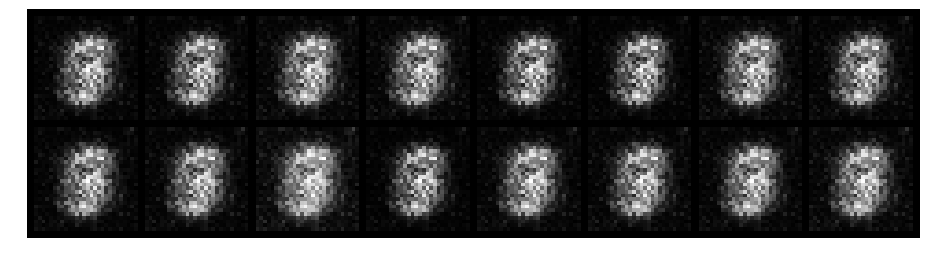

Epoch: [2/200], Batch Num: [300/600]
Discriminator Loss: 1.3970, Generator Loss: 0.8850
D(x): 0.5434, D(G(z)): 0.4867


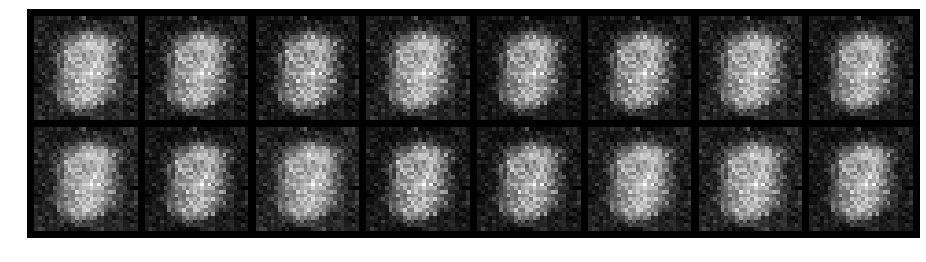

Epoch: [2/200], Batch Num: [400/600]
Discriminator Loss: 1.1306, Generator Loss: 2.6756
D(x): 0.7491, D(G(z)): 0.3806


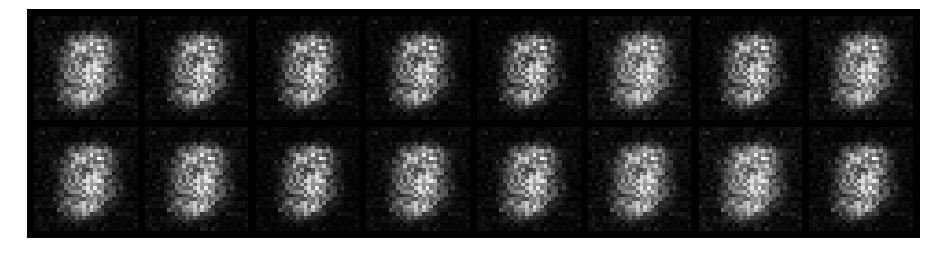

Epoch: [2/200], Batch Num: [500/600]
Discriminator Loss: 0.9606, Generator Loss: 1.0837
D(x): 0.6452, D(G(z)): 0.3751


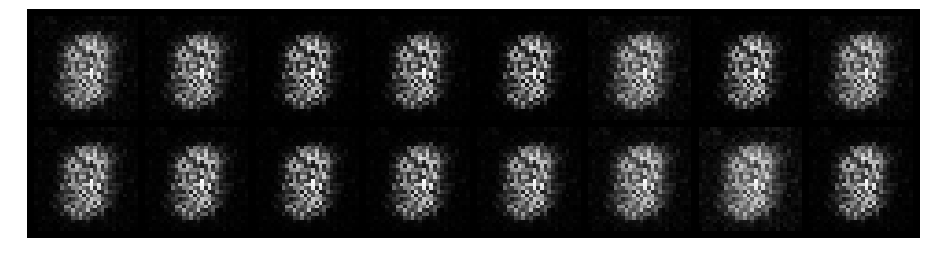

Epoch: [3/200], Batch Num: [0/600]
Discriminator Loss: 0.4001, Generator Loss: 2.2095
D(x): 0.8527, D(G(z)): 0.1574


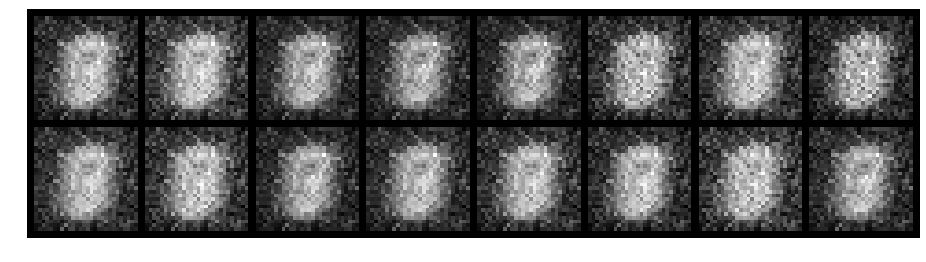

Epoch: [3/200], Batch Num: [100/600]
Discriminator Loss: 0.7329, Generator Loss: 2.2136
D(x): 0.7361, D(G(z)): 0.1852


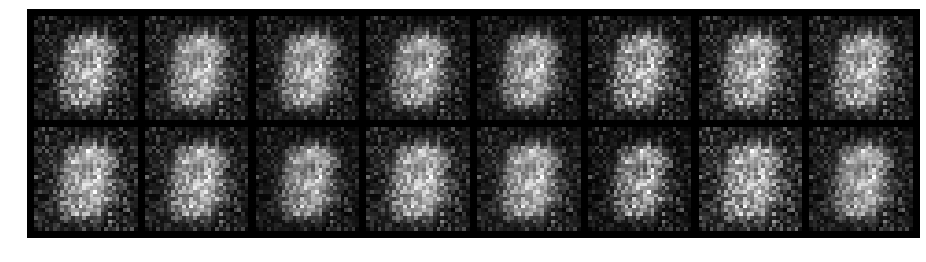

Epoch: [3/200], Batch Num: [200/600]
Discriminator Loss: 0.7906, Generator Loss: 1.4355
D(x): 0.7785, D(G(z)): 0.2817


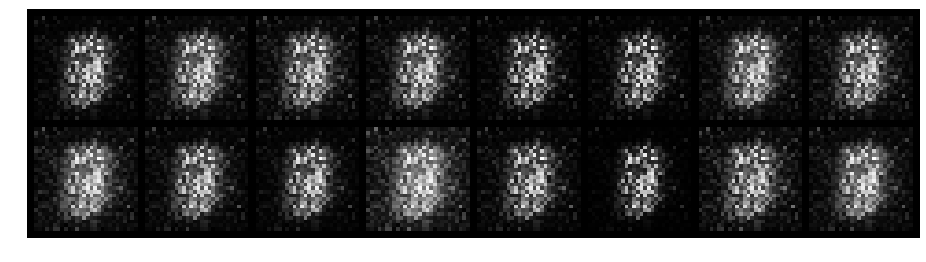

Epoch: [3/200], Batch Num: [300/600]
Discriminator Loss: 0.3381, Generator Loss: 7.1565
D(x): 0.9110, D(G(z)): 0.0841


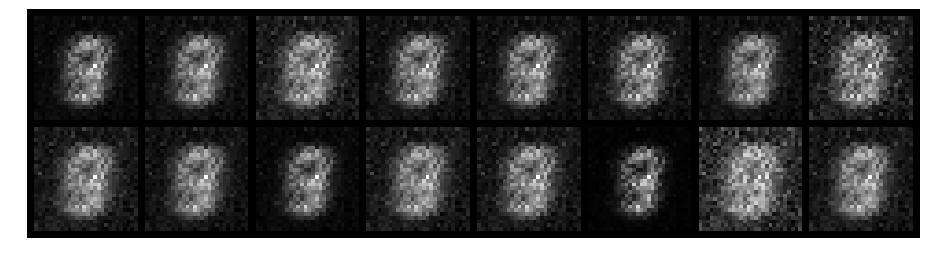

Epoch: [3/200], Batch Num: [400/600]
Discriminator Loss: 0.6601, Generator Loss: 1.7489
D(x): 0.8523, D(G(z)): 0.2396


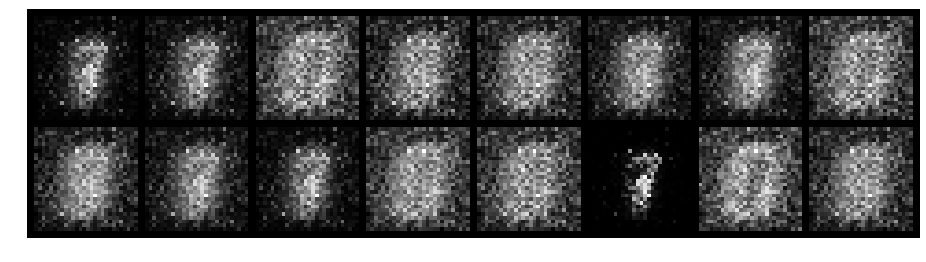

Epoch: [3/200], Batch Num: [500/600]
Discriminator Loss: 0.5793, Generator Loss: 1.8134
D(x): 0.8555, D(G(z)): 0.2387


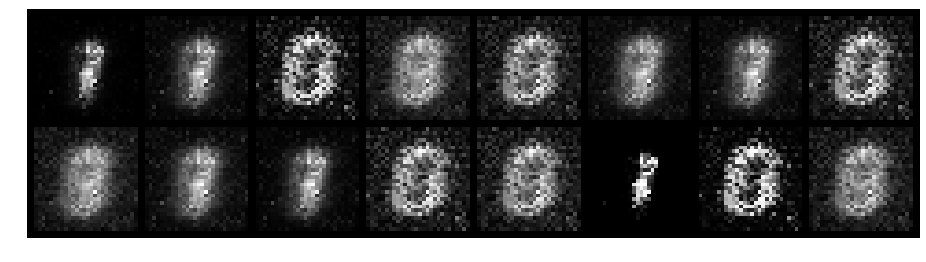

Epoch: [4/200], Batch Num: [0/600]
Discriminator Loss: 0.6998, Generator Loss: 1.7019
D(x): 0.7417, D(G(z)): 0.2404


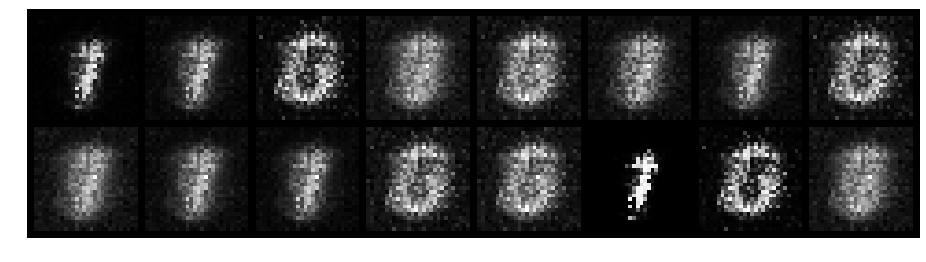

Epoch: [4/200], Batch Num: [100/600]
Discriminator Loss: 0.5620, Generator Loss: 1.7188
D(x): 0.8105, D(G(z)): 0.2150


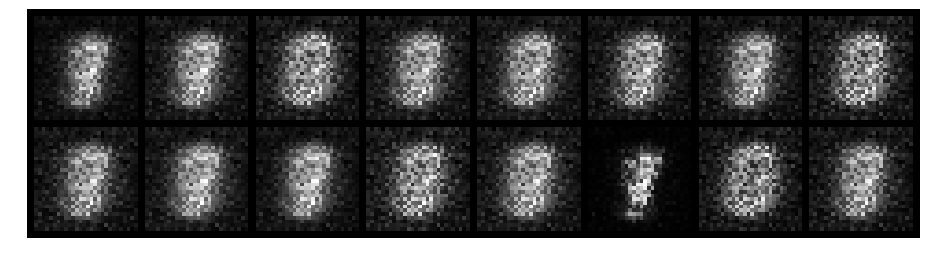

Epoch: [4/200], Batch Num: [200/600]
Discriminator Loss: 0.2898, Generator Loss: 3.0325
D(x): 0.8938, D(G(z)): 0.0819


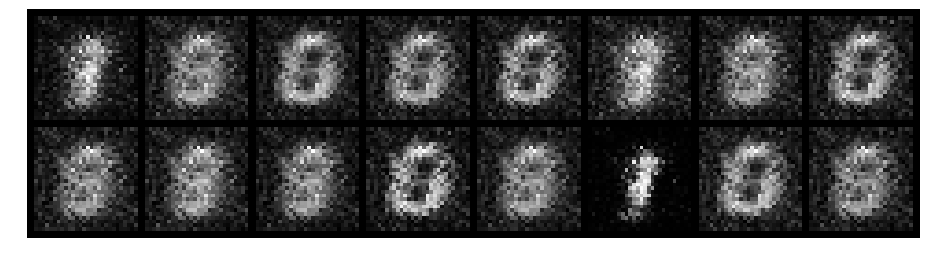

Epoch: [4/200], Batch Num: [300/600]
Discriminator Loss: 0.2892, Generator Loss: 2.8461
D(x): 0.9211, D(G(z)): 0.1267


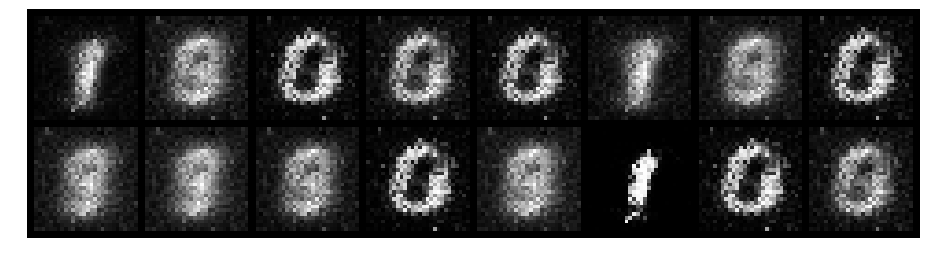

Epoch: [4/200], Batch Num: [400/600]
Discriminator Loss: 0.5103, Generator Loss: 2.3033
D(x): 0.8489, D(G(z)): 0.1756


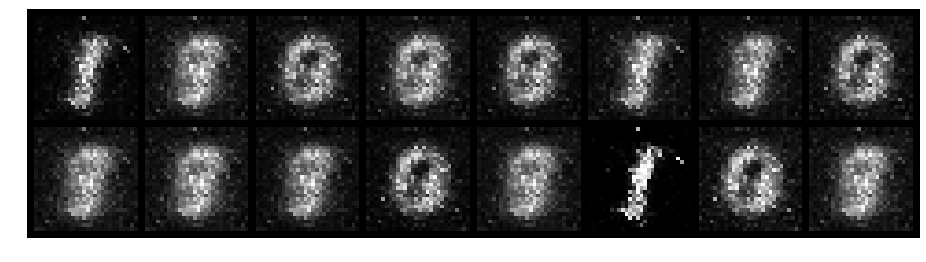

Epoch: [4/200], Batch Num: [500/600]
Discriminator Loss: 0.1615, Generator Loss: 2.7567
D(x): 0.9654, D(G(z)): 0.0971


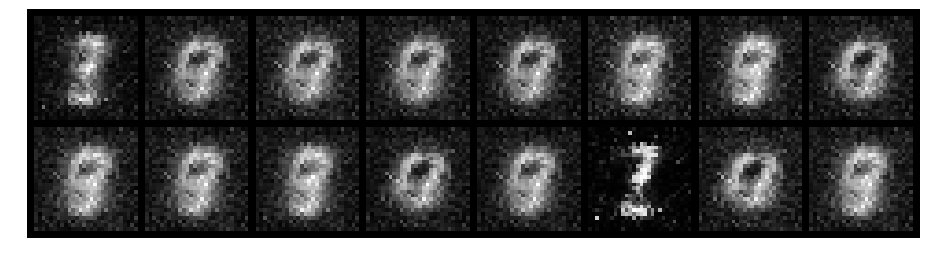

Epoch: [5/200], Batch Num: [0/600]
Discriminator Loss: 0.6153, Generator Loss: 1.9413
D(x): 0.8772, D(G(z)): 0.2531


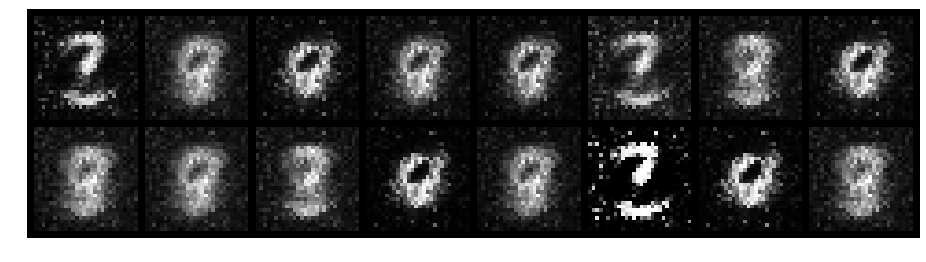

Epoch: [5/200], Batch Num: [100/600]
Discriminator Loss: 0.4363, Generator Loss: 3.1906
D(x): 0.8973, D(G(z)): 0.1428


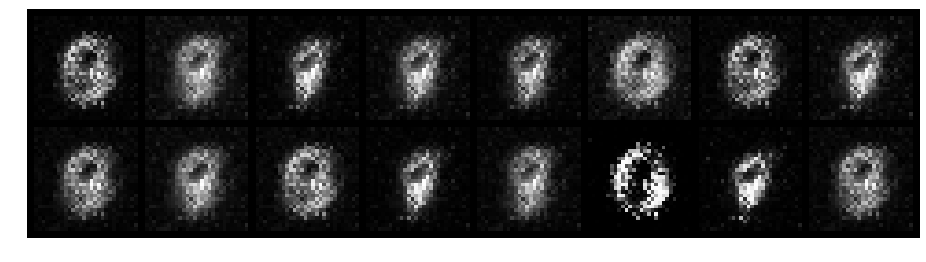

Epoch: [5/200], Batch Num: [200/600]
Discriminator Loss: 0.3622, Generator Loss: 2.6936
D(x): 0.9080, D(G(z)): 0.1519


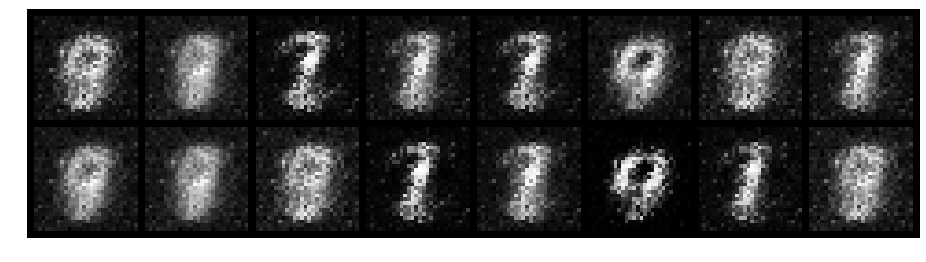

Epoch: [5/200], Batch Num: [300/600]
Discriminator Loss: 0.4654, Generator Loss: 2.5473
D(x): 0.8865, D(G(z)): 0.1773


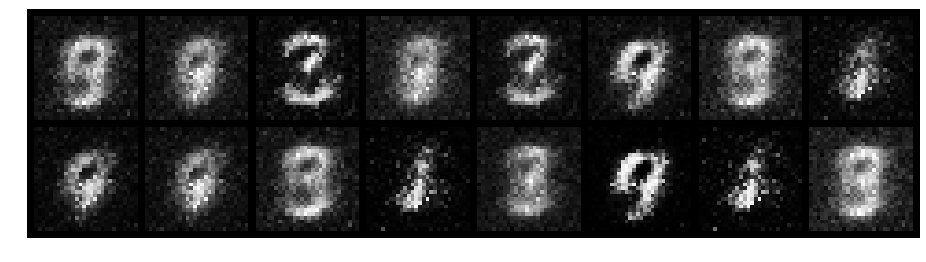

Epoch: [5/200], Batch Num: [400/600]
Discriminator Loss: 0.5894, Generator Loss: 2.1434
D(x): 0.8040, D(G(z)): 0.1744


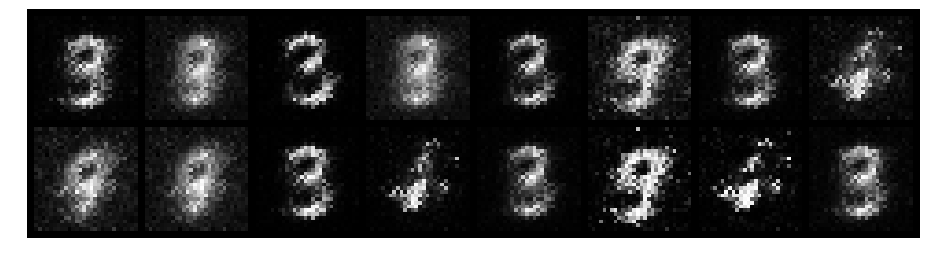

Epoch: [5/200], Batch Num: [500/600]
Discriminator Loss: 0.3762, Generator Loss: 2.5260
D(x): 0.9058, D(G(z)): 0.1423


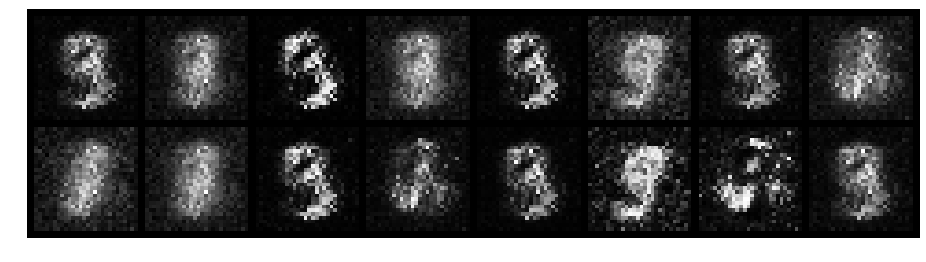

Epoch: [6/200], Batch Num: [0/600]
Discriminator Loss: 0.3601, Generator Loss: 2.7842
D(x): 0.8979, D(G(z)): 0.1359


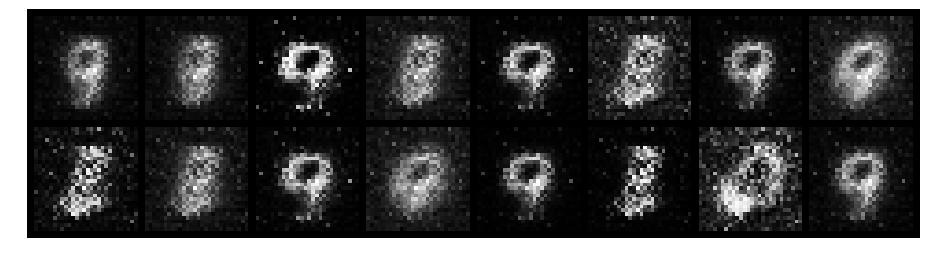

Epoch: [6/200], Batch Num: [100/600]
Discriminator Loss: 0.8106, Generator Loss: 2.5410
D(x): 0.7520, D(G(z)): 0.2433


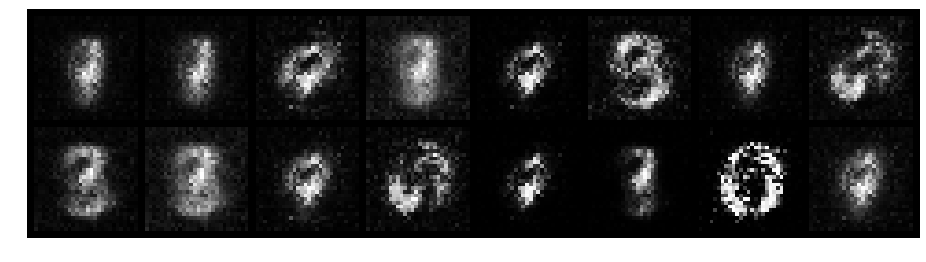

Epoch: [6/200], Batch Num: [200/600]
Discriminator Loss: 0.8421, Generator Loss: 1.7753
D(x): 0.7309, D(G(z)): 0.2285


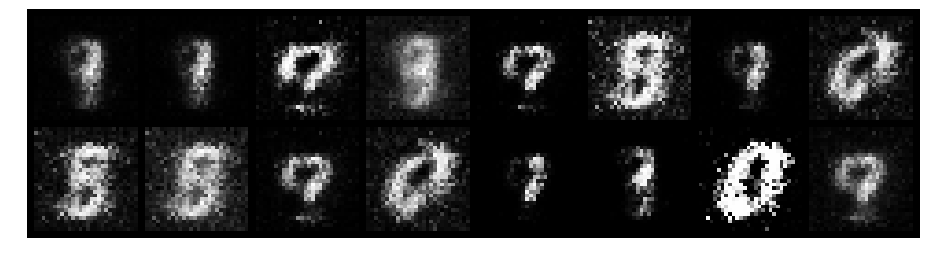

Epoch: [6/200], Batch Num: [300/600]
Discriminator Loss: 0.6891, Generator Loss: 1.8107
D(x): 0.7679, D(G(z)): 0.2350


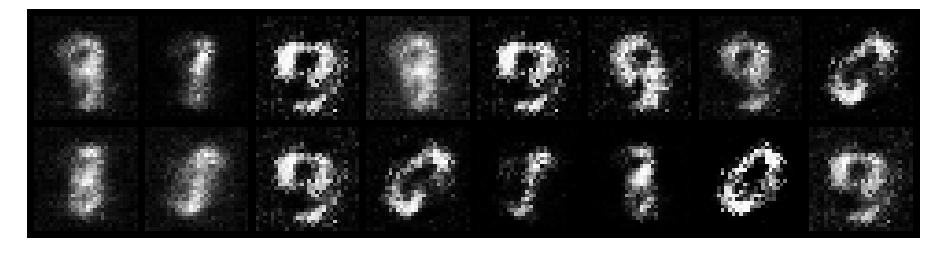

Epoch: [6/200], Batch Num: [400/600]
Discriminator Loss: 0.4826, Generator Loss: 2.0917
D(x): 0.8931, D(G(z)): 0.2106


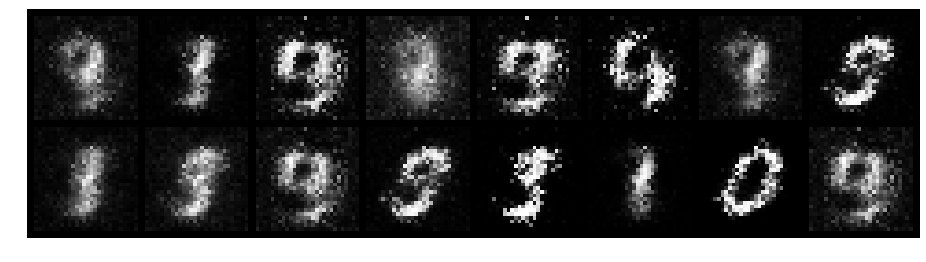

Epoch: [6/200], Batch Num: [500/600]
Discriminator Loss: 0.7141, Generator Loss: 1.8980
D(x): 0.8965, D(G(z)): 0.3061


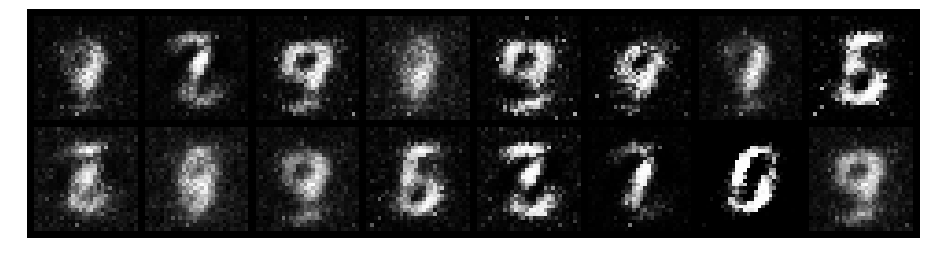

Epoch: [7/200], Batch Num: [0/600]
Discriminator Loss: 0.6166, Generator Loss: 2.6141
D(x): 0.7679, D(G(z)): 0.1337


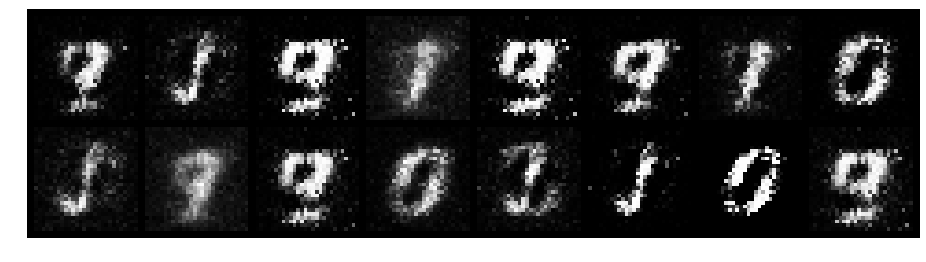

Epoch: [7/200], Batch Num: [100/600]
Discriminator Loss: 0.5147, Generator Loss: 2.5332
D(x): 0.8017, D(G(z)): 0.1517


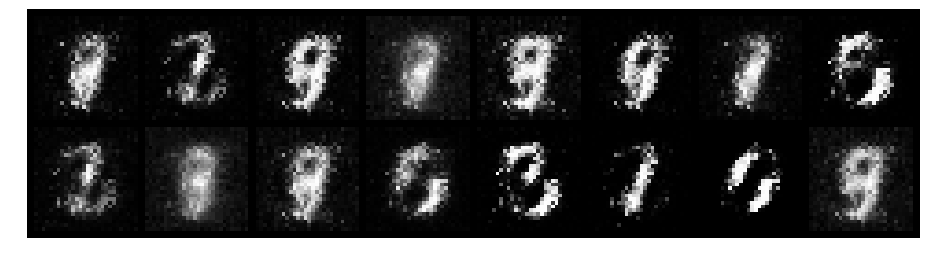

Epoch: [7/200], Batch Num: [200/600]
Discriminator Loss: 1.0129, Generator Loss: 1.5578
D(x): 0.6910, D(G(z)): 0.3033


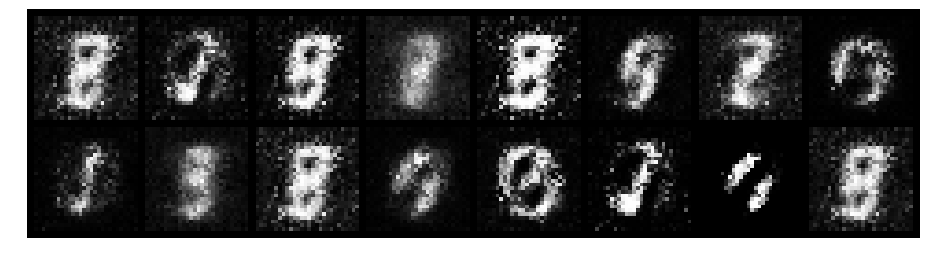

Epoch: [7/200], Batch Num: [300/600]
Discriminator Loss: 0.4380, Generator Loss: 2.7736
D(x): 0.8720, D(G(z)): 0.1458


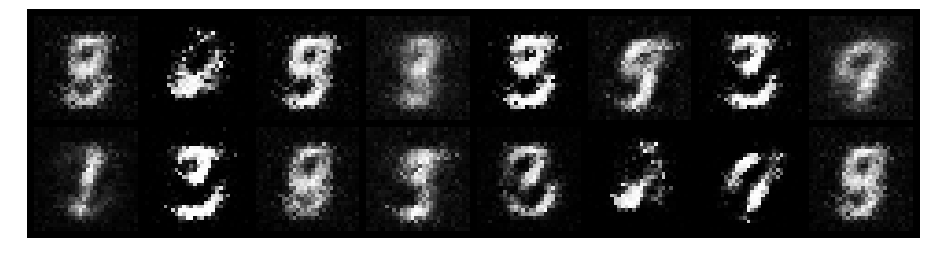

Epoch: [7/200], Batch Num: [400/600]
Discriminator Loss: 0.7340, Generator Loss: 1.9800
D(x): 0.7474, D(G(z)): 0.1641


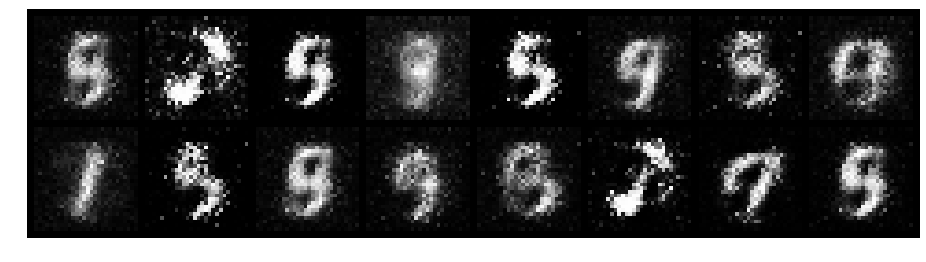

Epoch: [7/200], Batch Num: [500/600]
Discriminator Loss: 0.8126, Generator Loss: 1.3311
D(x): 0.7840, D(G(z)): 0.2764


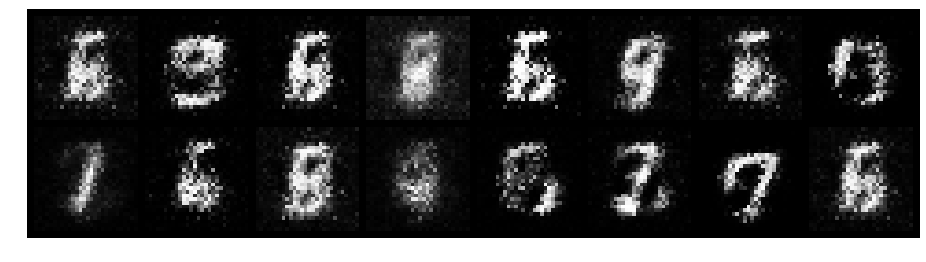

Epoch: [8/200], Batch Num: [0/600]
Discriminator Loss: 0.7079, Generator Loss: 2.0733
D(x): 0.7639, D(G(z)): 0.1954


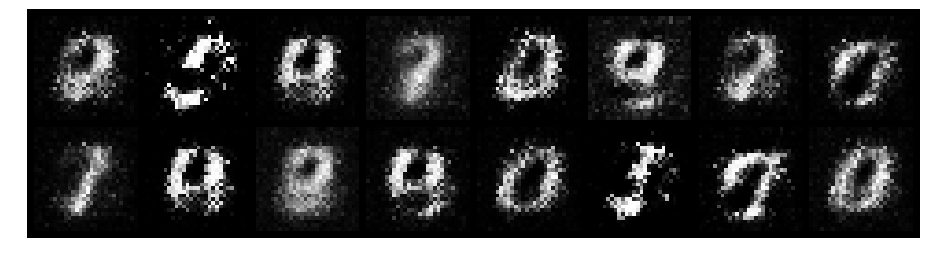

Epoch: [8/200], Batch Num: [100/600]
Discriminator Loss: 0.5900, Generator Loss: 2.3830
D(x): 0.7923, D(G(z)): 0.2000


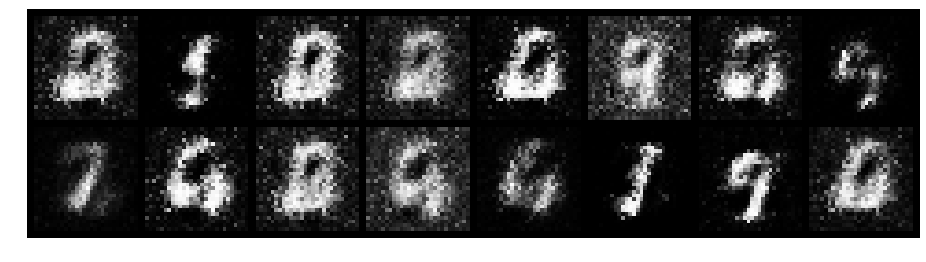

Epoch: [8/200], Batch Num: [200/600]
Discriminator Loss: 0.8933, Generator Loss: 1.7480
D(x): 0.7596, D(G(z)): 0.2527


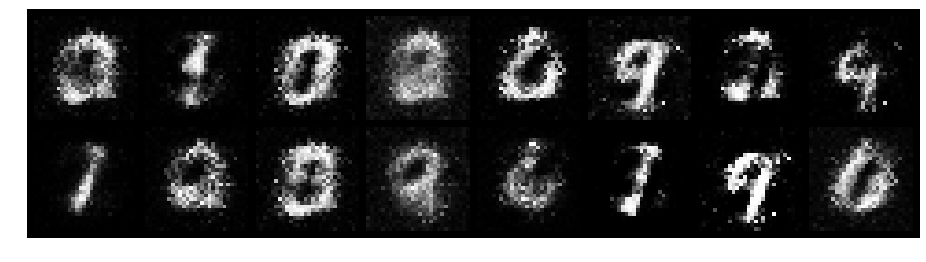

Epoch: [8/200], Batch Num: [300/600]
Discriminator Loss: 0.5451, Generator Loss: 2.0883
D(x): 0.8666, D(G(z)): 0.1704


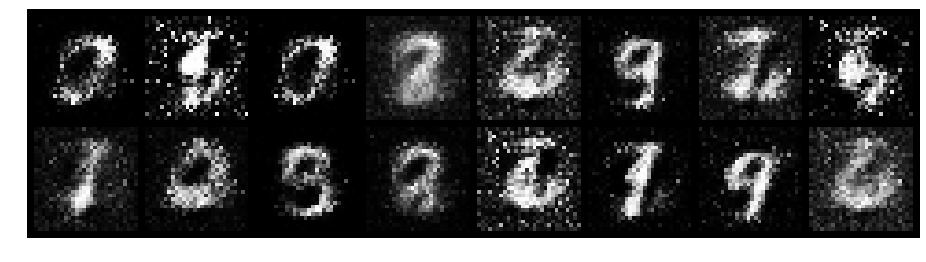

Epoch: [8/200], Batch Num: [400/600]
Discriminator Loss: 0.8933, Generator Loss: 2.1520
D(x): 0.7581, D(G(z)): 0.2535


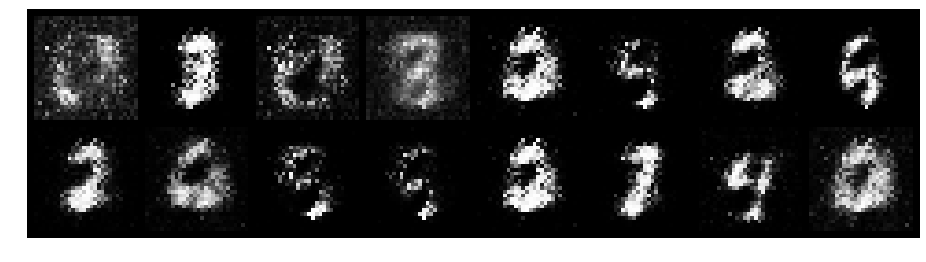

Epoch: [8/200], Batch Num: [500/600]
Discriminator Loss: 0.8433, Generator Loss: 1.8819
D(x): 0.7972, D(G(z)): 0.3100


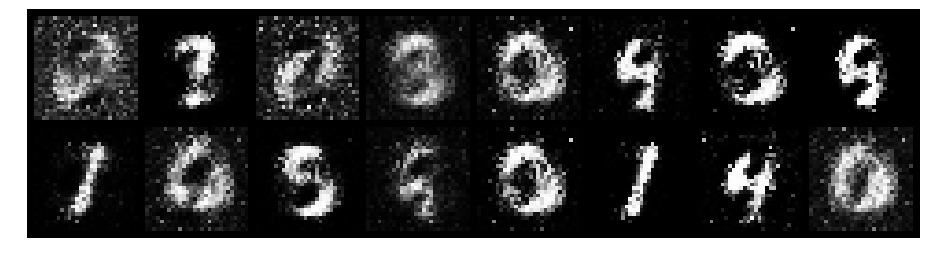

Epoch: [9/200], Batch Num: [0/600]
Discriminator Loss: 0.7959, Generator Loss: 1.8765
D(x): 0.7054, D(G(z)): 0.1903


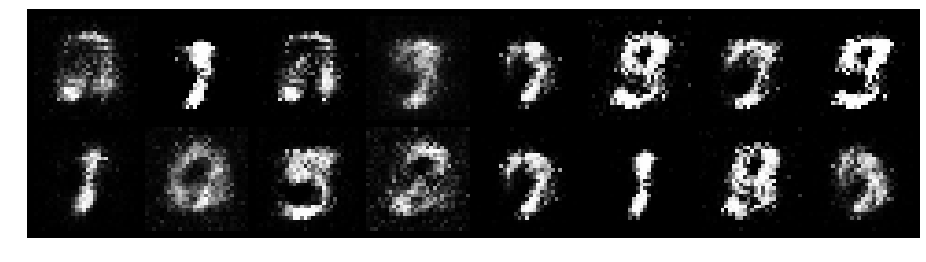

Epoch: [9/200], Batch Num: [100/600]
Discriminator Loss: 0.7893, Generator Loss: 1.4548
D(x): 0.7304, D(G(z)): 0.2987


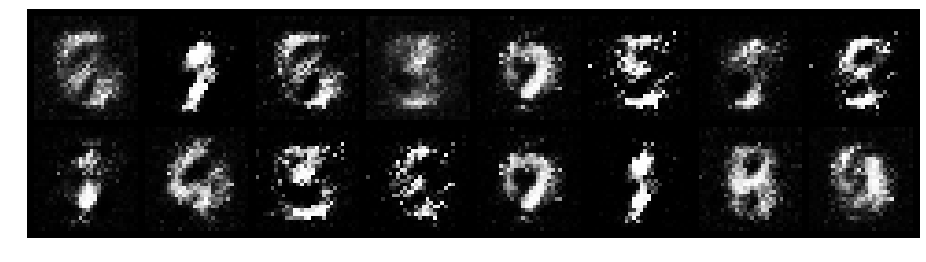

Epoch: [9/200], Batch Num: [200/600]
Discriminator Loss: 0.8397, Generator Loss: 1.6859
D(x): 0.6762, D(G(z)): 0.2027


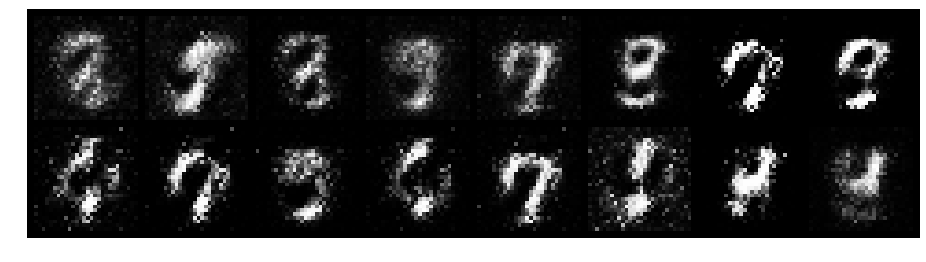

Epoch: [9/200], Batch Num: [300/600]
Discriminator Loss: 0.6435, Generator Loss: 2.2044
D(x): 0.7524, D(G(z)): 0.1542


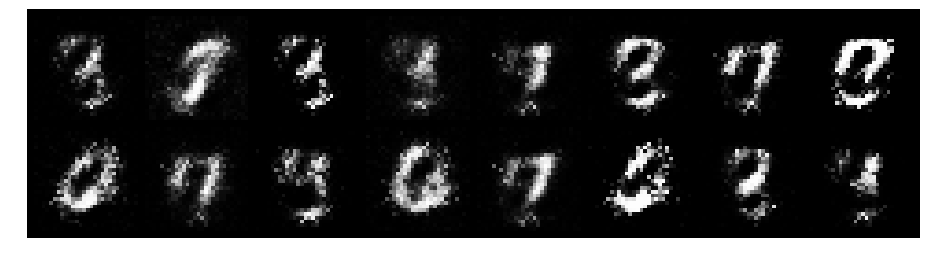

Epoch: [9/200], Batch Num: [400/600]
Discriminator Loss: 0.9053, Generator Loss: 1.7797
D(x): 0.7510, D(G(z)): 0.3233


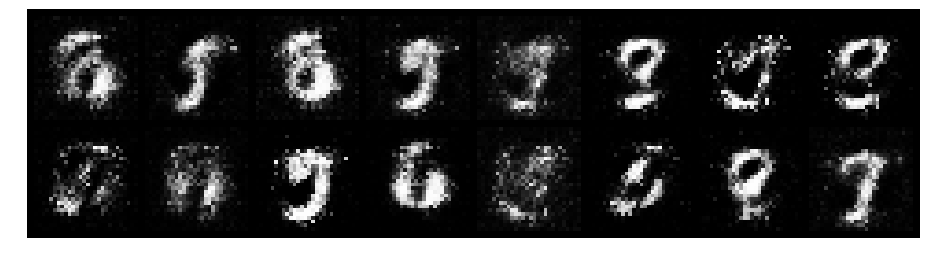

Epoch: [9/200], Batch Num: [500/600]
Discriminator Loss: 0.9099, Generator Loss: 1.5295
D(x): 0.6834, D(G(z)): 0.2558


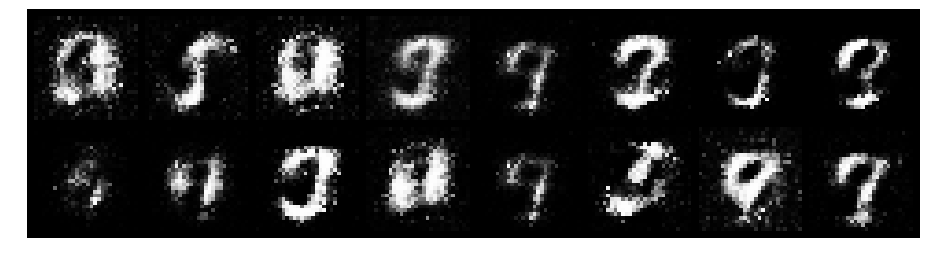

Epoch: [10/200], Batch Num: [0/600]
Discriminator Loss: 0.9832, Generator Loss: 1.8454
D(x): 0.7144, D(G(z)): 0.2941


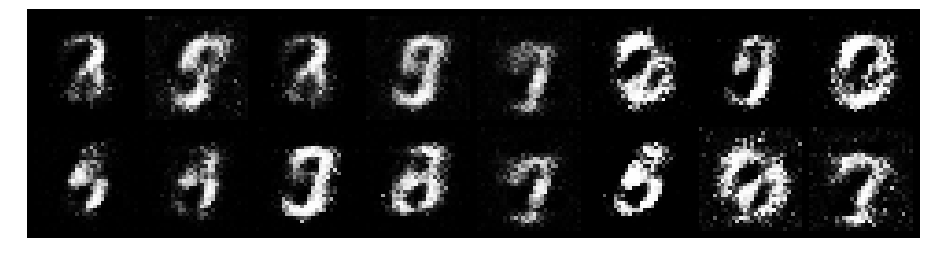

Epoch: [10/200], Batch Num: [100/600]
Discriminator Loss: 1.2050, Generator Loss: 1.2394
D(x): 0.6277, D(G(z)): 0.3516


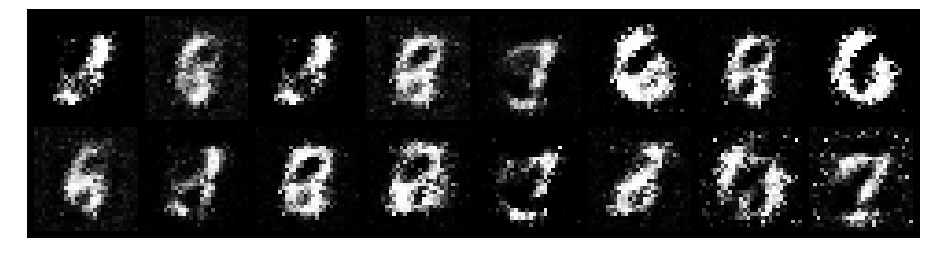

Epoch: [10/200], Batch Num: [200/600]
Discriminator Loss: 0.8952, Generator Loss: 1.1660
D(x): 0.7422, D(G(z)): 0.3245


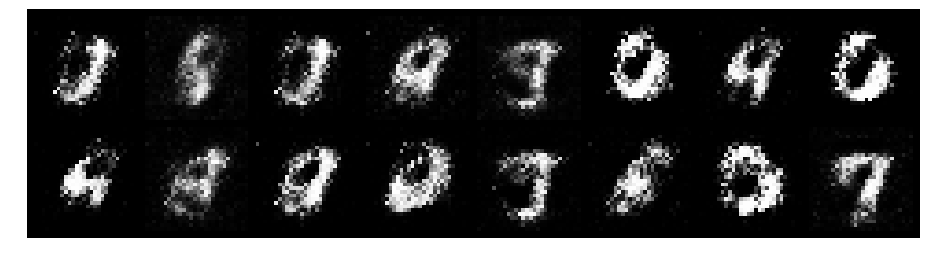

Epoch: [10/200], Batch Num: [300/600]
Discriminator Loss: 0.7958, Generator Loss: 1.8308
D(x): 0.7614, D(G(z)): 0.2927


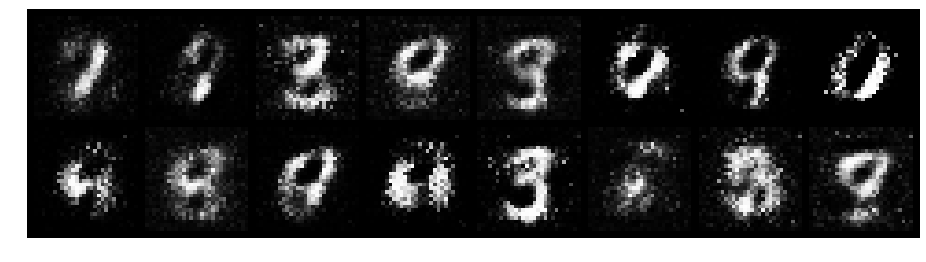

Epoch: [10/200], Batch Num: [400/600]
Discriminator Loss: 0.6530, Generator Loss: 1.6379
D(x): 0.7488, D(G(z)): 0.2143


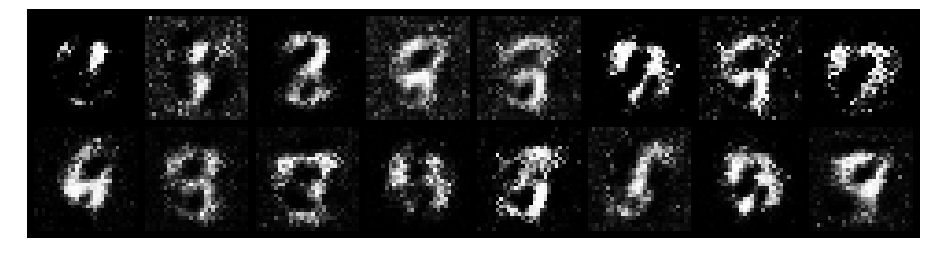

Epoch: [10/200], Batch Num: [500/600]
Discriminator Loss: 1.0997, Generator Loss: 1.6867
D(x): 0.6753, D(G(z)): 0.3111


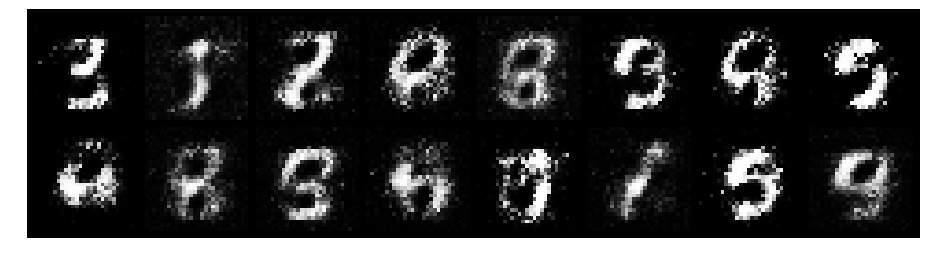

Epoch: [11/200], Batch Num: [0/600]
Discriminator Loss: 0.9727, Generator Loss: 1.6077
D(x): 0.6860, D(G(z)): 0.2957


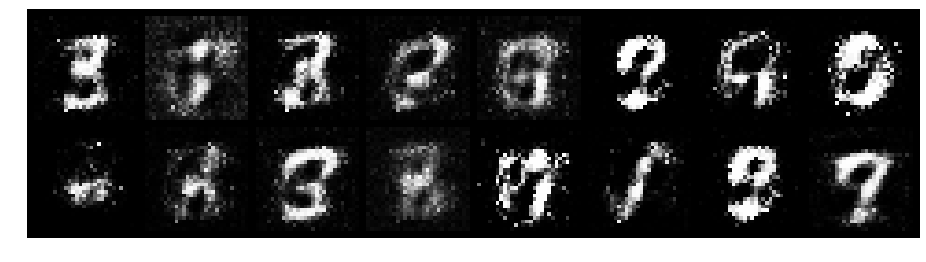

Epoch: [11/200], Batch Num: [100/600]
Discriminator Loss: 0.9053, Generator Loss: 2.2929
D(x): 0.7807, D(G(z)): 0.3029


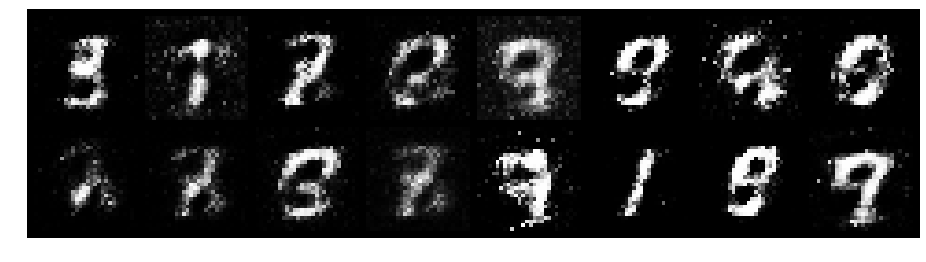

Epoch: [11/200], Batch Num: [200/600]
Discriminator Loss: 0.7175, Generator Loss: 1.7572
D(x): 0.7532, D(G(z)): 0.2082


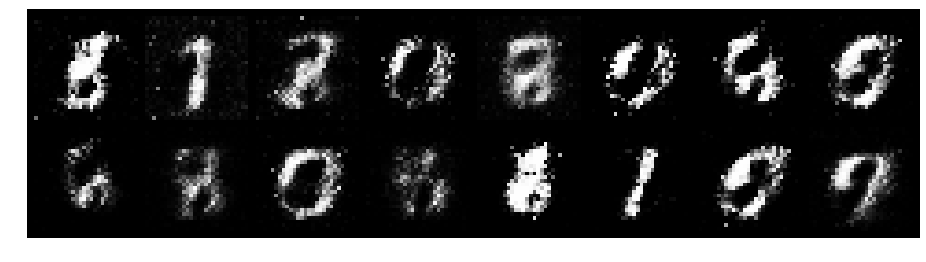

Epoch: [11/200], Batch Num: [300/600]
Discriminator Loss: 0.5887, Generator Loss: 2.2192
D(x): 0.8051, D(G(z)): 0.1985


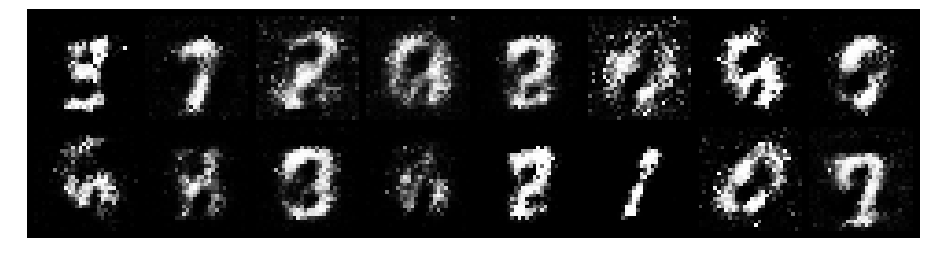

Epoch: [11/200], Batch Num: [400/600]
Discriminator Loss: 0.8384, Generator Loss: 1.8605
D(x): 0.8136, D(G(z)): 0.3118


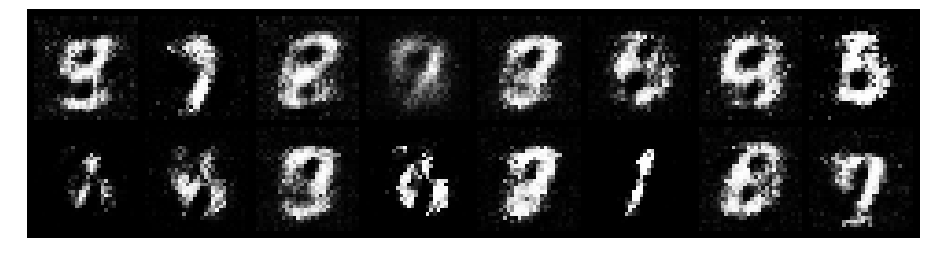

Epoch: [11/200], Batch Num: [500/600]
Discriminator Loss: 0.5639, Generator Loss: 2.3072
D(x): 0.8936, D(G(z)): 0.2376


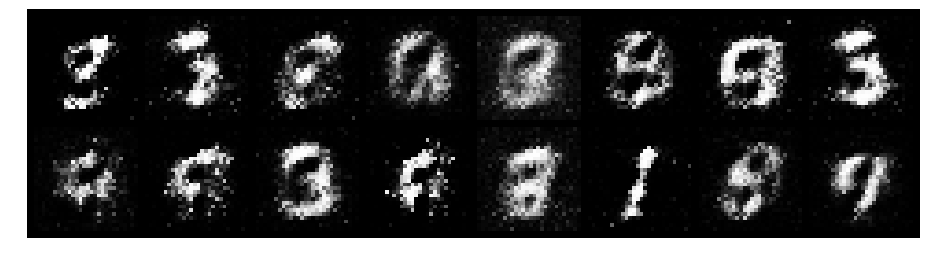

Epoch: [12/200], Batch Num: [0/600]
Discriminator Loss: 0.8688, Generator Loss: 1.8856
D(x): 0.6709, D(G(z)): 0.2269


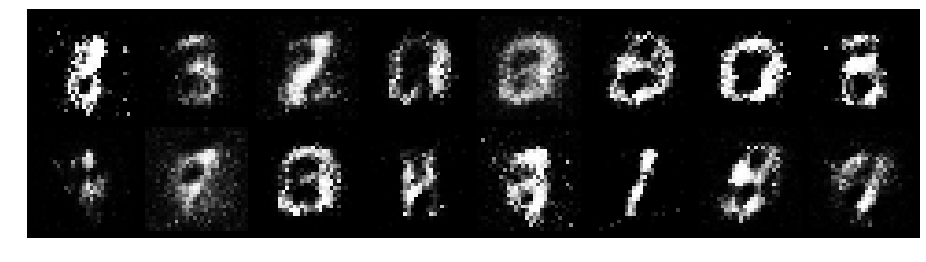

Epoch: [12/200], Batch Num: [100/600]
Discriminator Loss: 0.6951, Generator Loss: 1.8200
D(x): 0.7783, D(G(z)): 0.2772


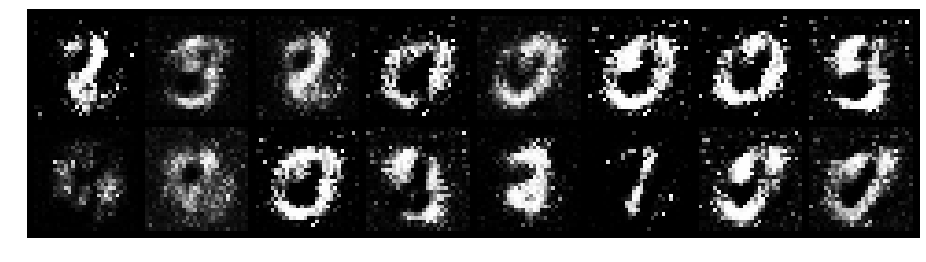

Epoch: [12/200], Batch Num: [200/600]
Discriminator Loss: 0.9115, Generator Loss: 1.5757
D(x): 0.6703, D(G(z)): 0.2560


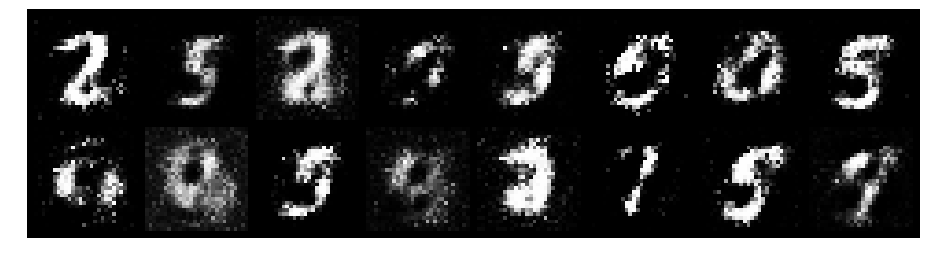

Epoch: [12/200], Batch Num: [300/600]
Discriminator Loss: 0.9503, Generator Loss: 2.0608
D(x): 0.7834, D(G(z)): 0.3069


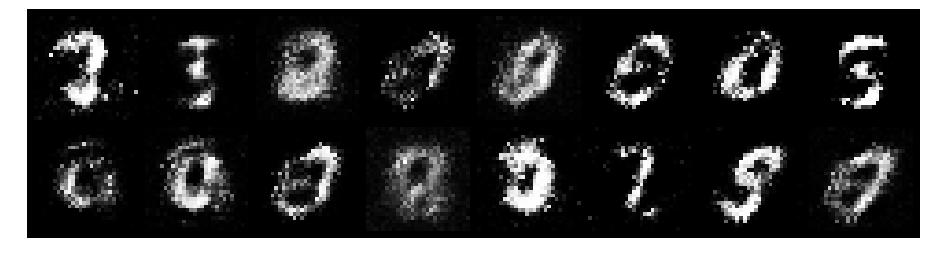

Epoch: [12/200], Batch Num: [400/600]
Discriminator Loss: 0.9118, Generator Loss: 2.2525
D(x): 0.7064, D(G(z)): 0.2756


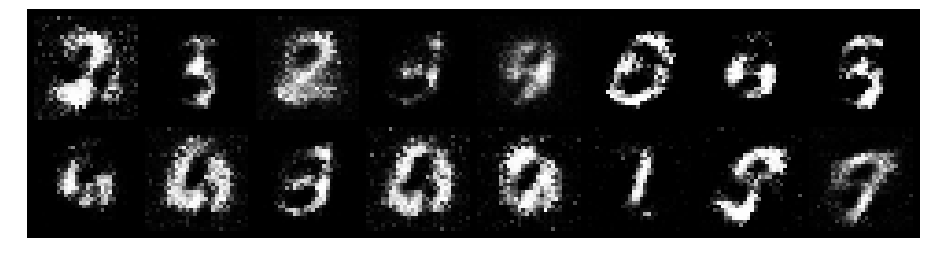

Epoch: [12/200], Batch Num: [500/600]
Discriminator Loss: 1.0610, Generator Loss: 1.7472
D(x): 0.7109, D(G(z)): 0.3291


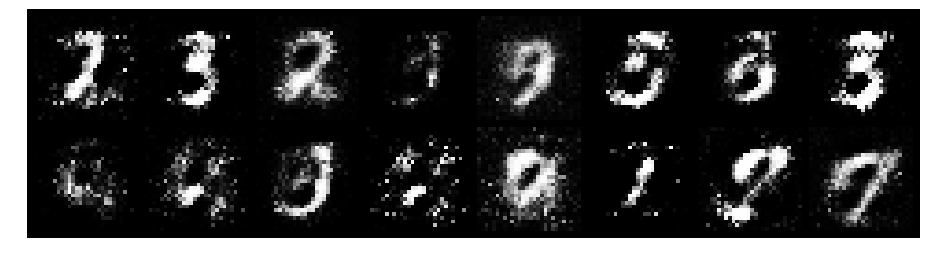

Epoch: [13/200], Batch Num: [0/600]
Discriminator Loss: 1.2848, Generator Loss: 1.8419
D(x): 0.6065, D(G(z)): 0.3016


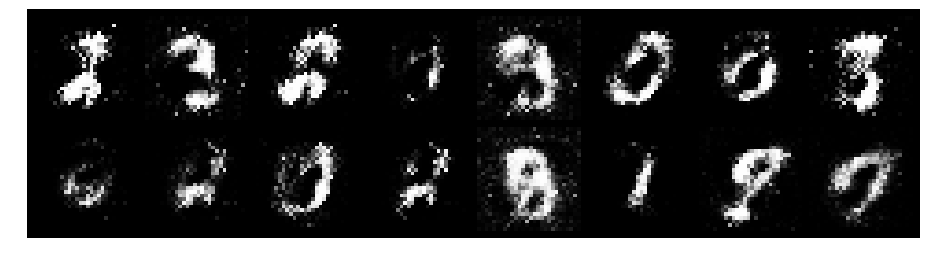

Epoch: [13/200], Batch Num: [100/600]
Discriminator Loss: 0.8441, Generator Loss: 1.8002
D(x): 0.6965, D(G(z)): 0.2741


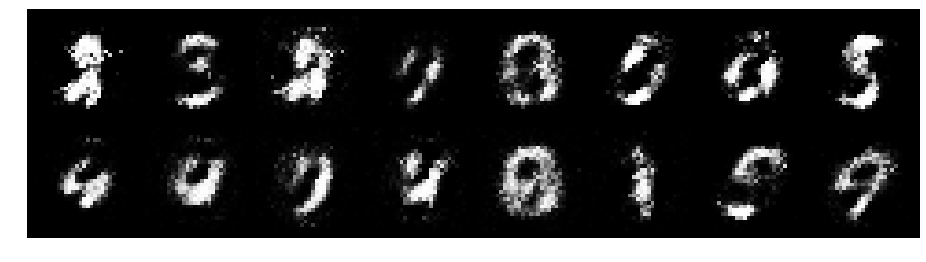

Epoch: [13/200], Batch Num: [200/600]
Discriminator Loss: 0.9930, Generator Loss: 1.8572
D(x): 0.6862, D(G(z)): 0.2766


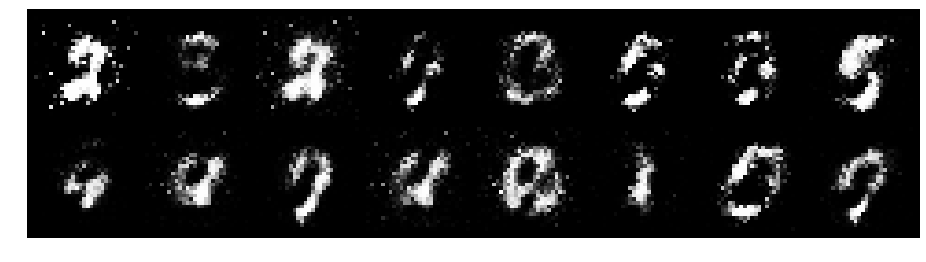

Epoch: [13/200], Batch Num: [300/600]
Discriminator Loss: 0.7291, Generator Loss: 1.7464
D(x): 0.7232, D(G(z)): 0.2302


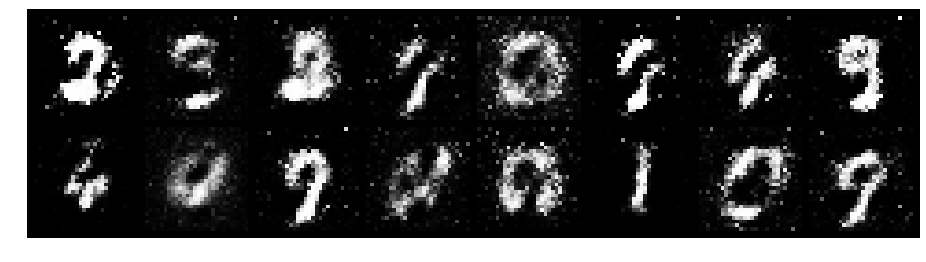

Epoch: [13/200], Batch Num: [400/600]
Discriminator Loss: 0.9584, Generator Loss: 1.6553
D(x): 0.7364, D(G(z)): 0.3397


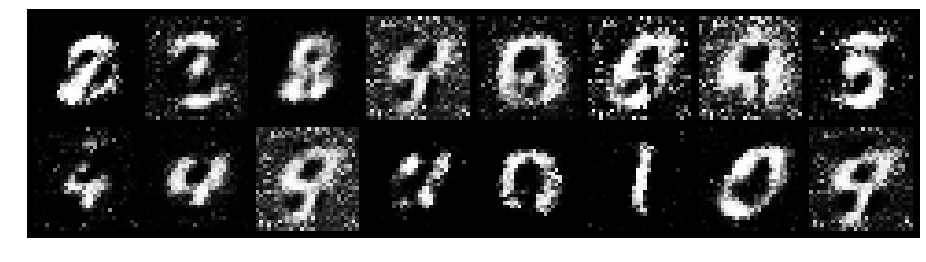

Epoch: [13/200], Batch Num: [500/600]
Discriminator Loss: 0.9759, Generator Loss: 1.8473
D(x): 0.6844, D(G(z)): 0.2763


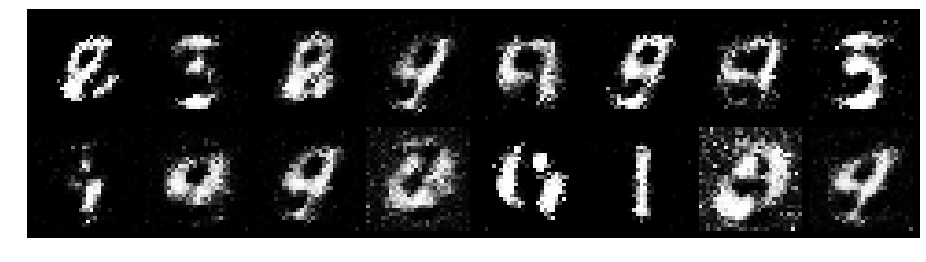

Epoch: [14/200], Batch Num: [0/600]
Discriminator Loss: 0.9566, Generator Loss: 1.7566
D(x): 0.7175, D(G(z)): 0.2993


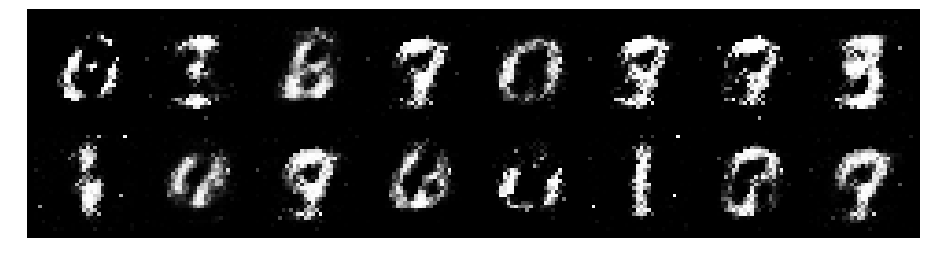

Epoch: [14/200], Batch Num: [100/600]
Discriminator Loss: 0.5856, Generator Loss: 2.0282
D(x): 0.7926, D(G(z)): 0.1869


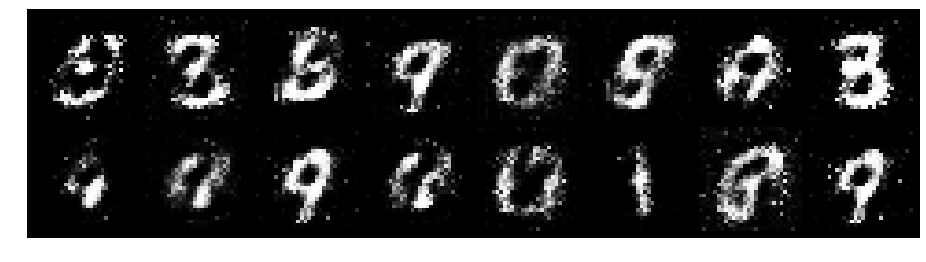

Epoch: [14/200], Batch Num: [200/600]
Discriminator Loss: 0.4945, Generator Loss: 2.2399
D(x): 0.8283, D(G(z)): 0.1842


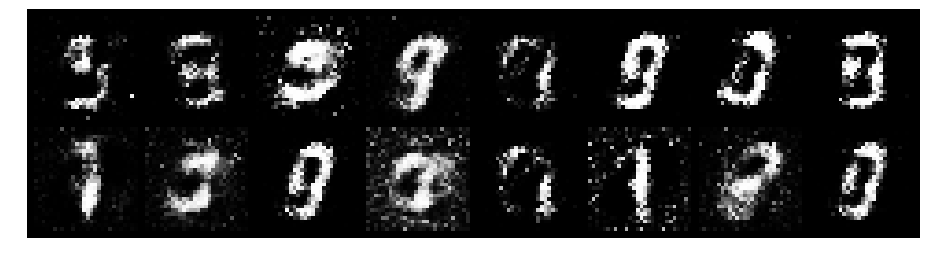

Epoch: [14/200], Batch Num: [300/600]
Discriminator Loss: 0.7785, Generator Loss: 2.1388
D(x): 0.6876, D(G(z)): 0.1897


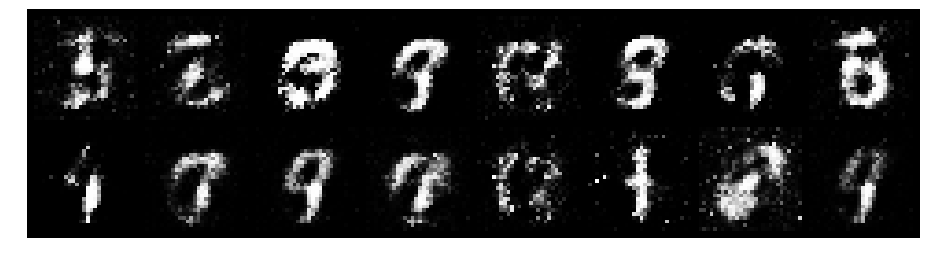

Epoch: [14/200], Batch Num: [400/600]
Discriminator Loss: 0.8086, Generator Loss: 1.8181
D(x): 0.7244, D(G(z)): 0.2387


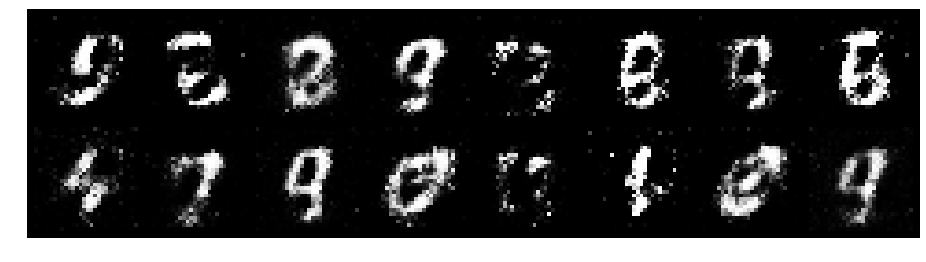

Epoch: [14/200], Batch Num: [500/600]
Discriminator Loss: 0.7077, Generator Loss: 2.0957
D(x): 0.7604, D(G(z)): 0.1950


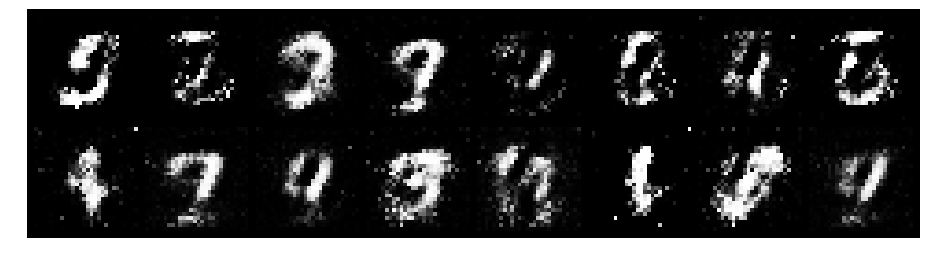

Epoch: [15/200], Batch Num: [0/600]
Discriminator Loss: 0.5139, Generator Loss: 2.0766
D(x): 0.8216, D(G(z)): 0.1879


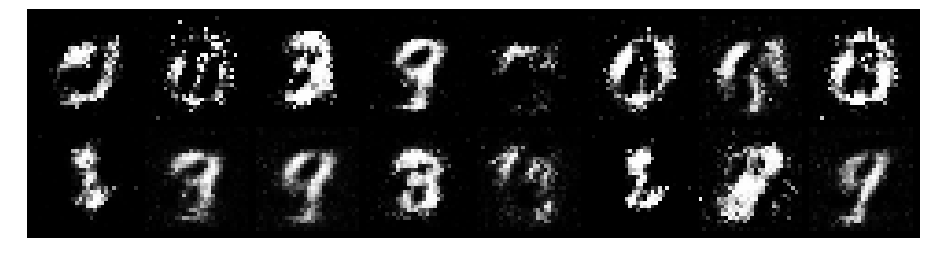

Epoch: [15/200], Batch Num: [100/600]
Discriminator Loss: 0.7347, Generator Loss: 1.7685
D(x): 0.7810, D(G(z)): 0.2808


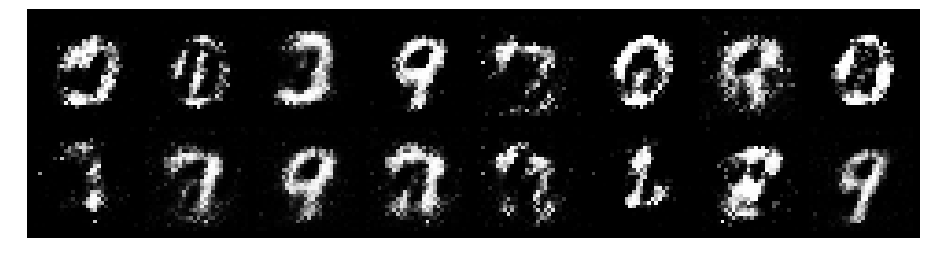

Epoch: [15/200], Batch Num: [200/600]
Discriminator Loss: 0.7148, Generator Loss: 2.0816
D(x): 0.7091, D(G(z)): 0.2150


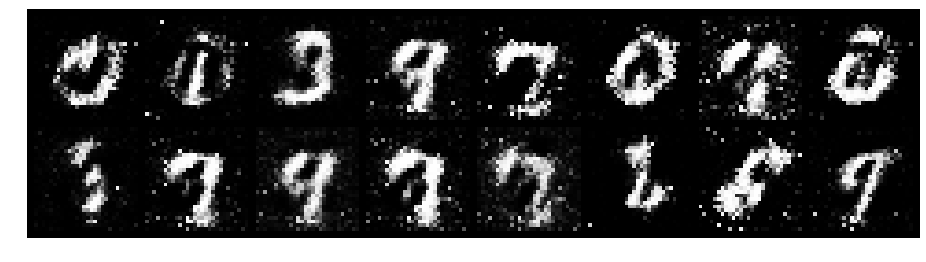

Epoch: [15/200], Batch Num: [300/600]
Discriminator Loss: 0.7655, Generator Loss: 1.7993
D(x): 0.6743, D(G(z)): 0.2118


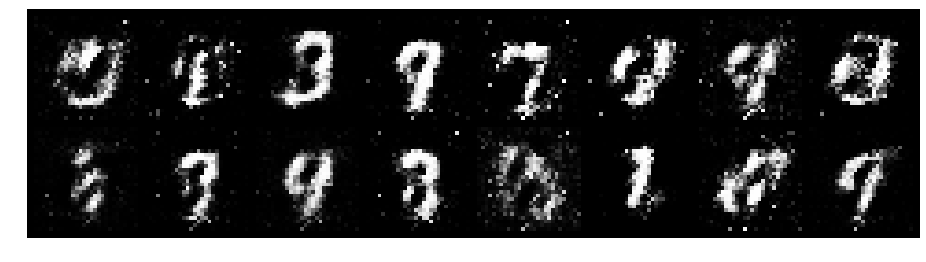

Epoch: [15/200], Batch Num: [400/600]
Discriminator Loss: 0.9901, Generator Loss: 1.4410
D(x): 0.7201, D(G(z)): 0.3500


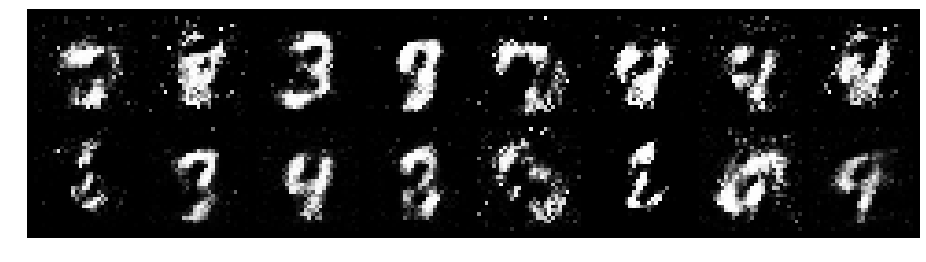

Epoch: [15/200], Batch Num: [500/600]
Discriminator Loss: 0.8437, Generator Loss: 1.7780
D(x): 0.7489, D(G(z)): 0.2520


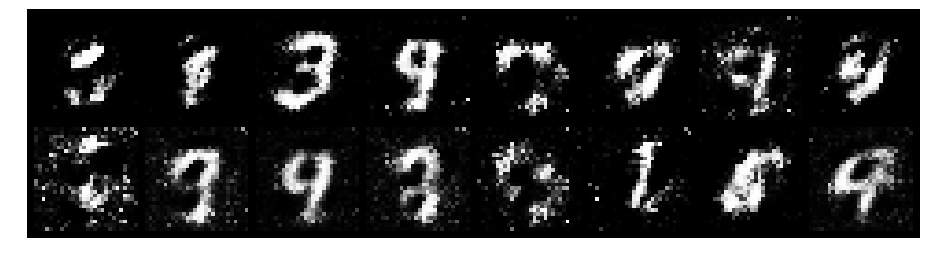

Epoch: [16/200], Batch Num: [0/600]
Discriminator Loss: 0.8937, Generator Loss: 1.8373
D(x): 0.7700, D(G(z)): 0.2811


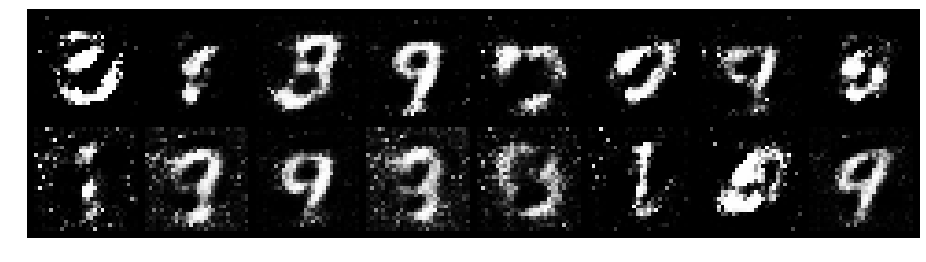

Epoch: [16/200], Batch Num: [100/600]
Discriminator Loss: 0.7717, Generator Loss: 1.8801
D(x): 0.7559, D(G(z)): 0.2474


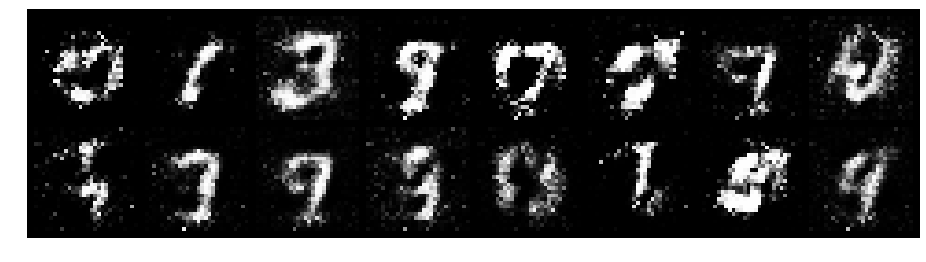

Epoch: [16/200], Batch Num: [200/600]
Discriminator Loss: 0.7657, Generator Loss: 1.5708
D(x): 0.7742, D(G(z)): 0.3022


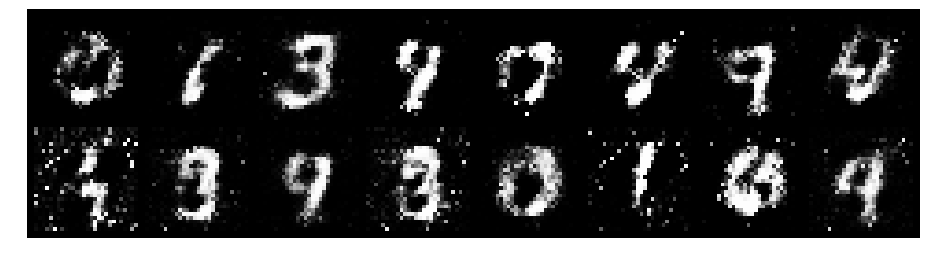

Epoch: [16/200], Batch Num: [300/600]
Discriminator Loss: 0.6106, Generator Loss: 1.9143
D(x): 0.7731, D(G(z)): 0.1765


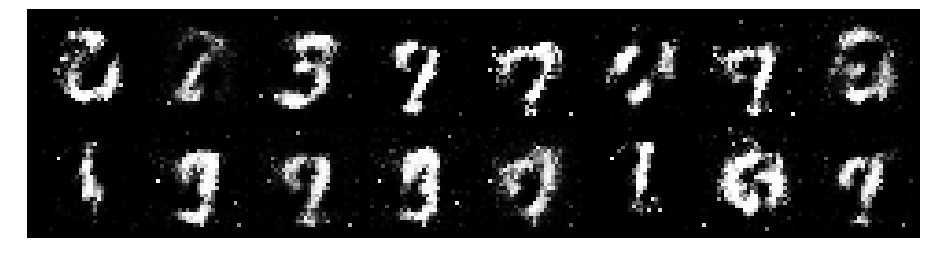

Epoch: [16/200], Batch Num: [400/600]
Discriminator Loss: 0.9650, Generator Loss: 1.7070
D(x): 0.7095, D(G(z)): 0.2657


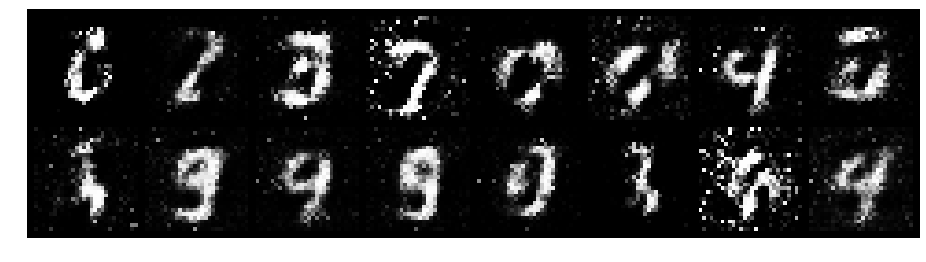

Epoch: [16/200], Batch Num: [500/600]
Discriminator Loss: 1.1646, Generator Loss: 1.0188
D(x): 0.6473, D(G(z)): 0.4088


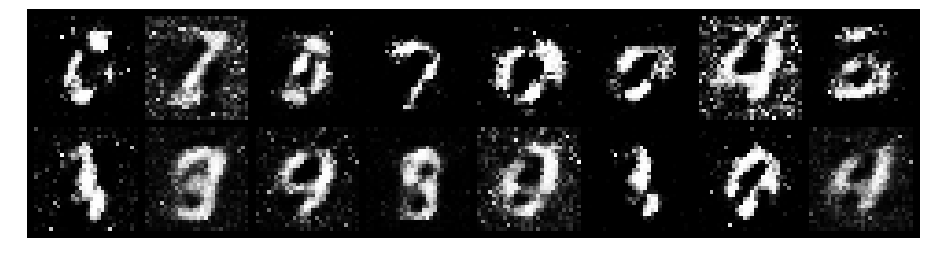

Epoch: [17/200], Batch Num: [0/600]
Discriminator Loss: 1.1617, Generator Loss: 1.6025
D(x): 0.6311, D(G(z)): 0.3316


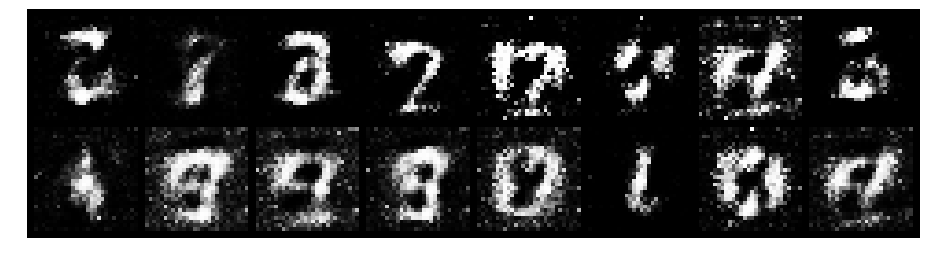

Epoch: [17/200], Batch Num: [100/600]
Discriminator Loss: 1.1352, Generator Loss: 1.5971
D(x): 0.6517, D(G(z)): 0.3455


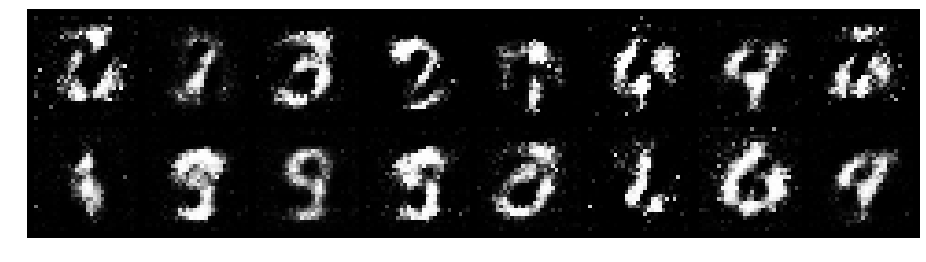

Epoch: [17/200], Batch Num: [200/600]
Discriminator Loss: 1.0690, Generator Loss: 1.5239
D(x): 0.7136, D(G(z)): 0.3595


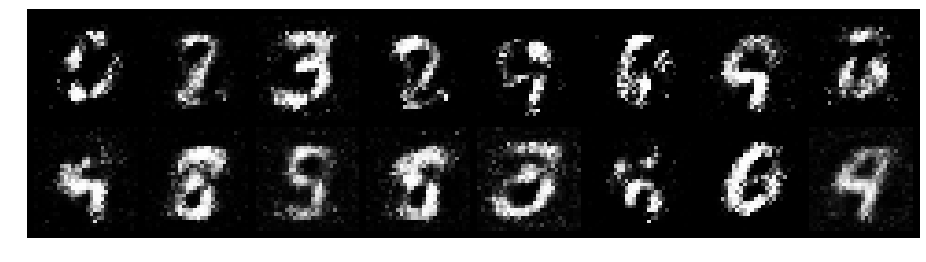

Epoch: [17/200], Batch Num: [300/600]
Discriminator Loss: 0.8704, Generator Loss: 1.4775
D(x): 0.6793, D(G(z)): 0.2593


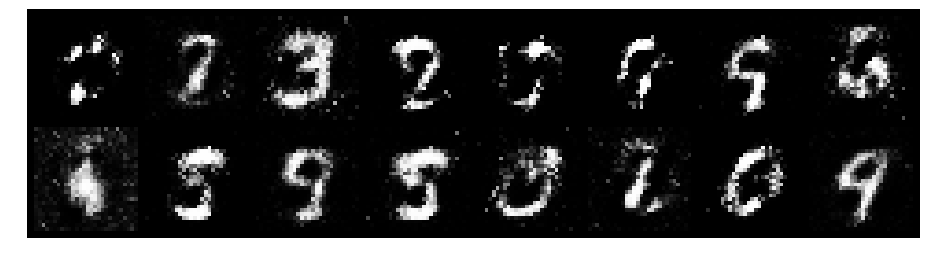

Epoch: [17/200], Batch Num: [400/600]
Discriminator Loss: 0.7830, Generator Loss: 1.4511
D(x): 0.7402, D(G(z)): 0.2809


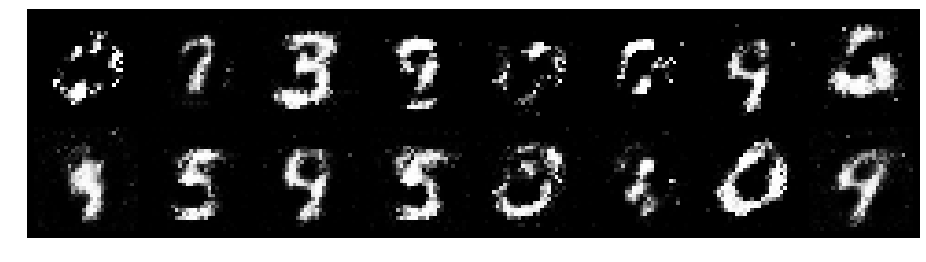

Epoch: [17/200], Batch Num: [500/600]
Discriminator Loss: 0.7982, Generator Loss: 1.4461
D(x): 0.7309, D(G(z)): 0.2943


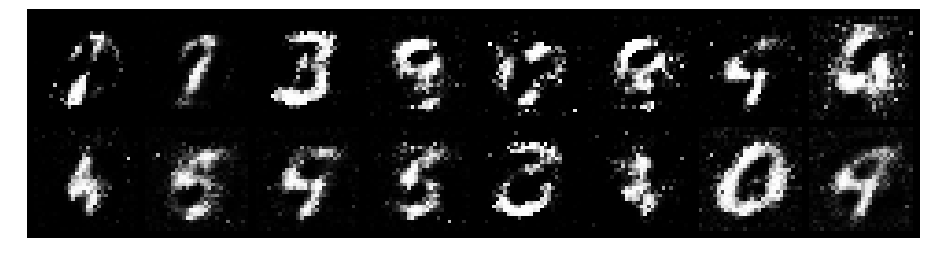

Epoch: [18/200], Batch Num: [0/600]
Discriminator Loss: 0.8147, Generator Loss: 1.6327
D(x): 0.6772, D(G(z)): 0.2534


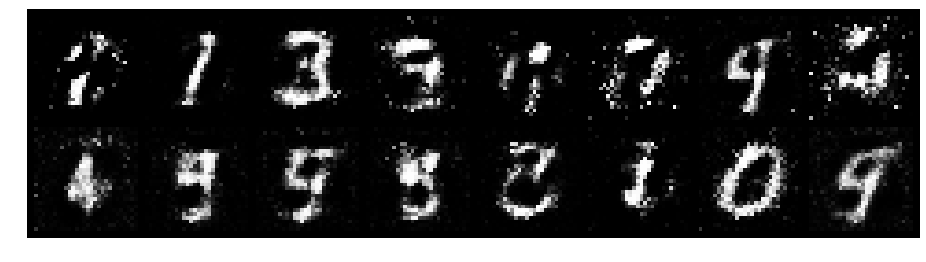

Epoch: [18/200], Batch Num: [100/600]
Discriminator Loss: 0.9285, Generator Loss: 1.2018
D(x): 0.6908, D(G(z)): 0.3227


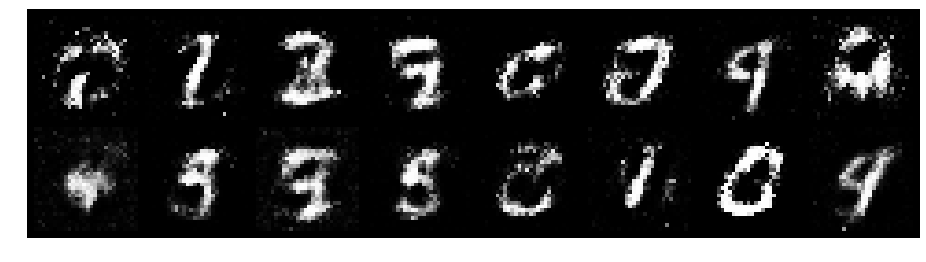

Epoch: [18/200], Batch Num: [200/600]
Discriminator Loss: 1.0210, Generator Loss: 1.3353
D(x): 0.6906, D(G(z)): 0.3871


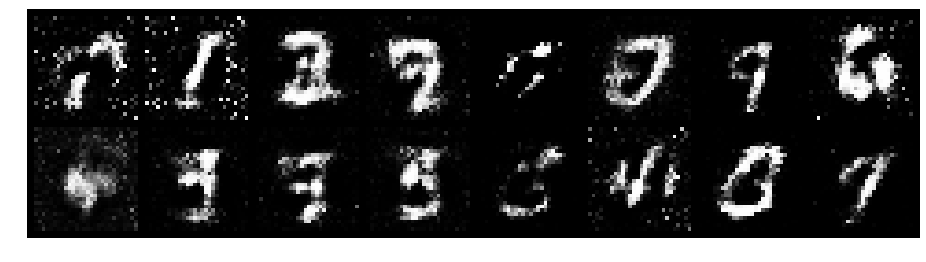

Epoch: [18/200], Batch Num: [300/600]
Discriminator Loss: 0.9825, Generator Loss: 1.1538
D(x): 0.7162, D(G(z)): 0.3907


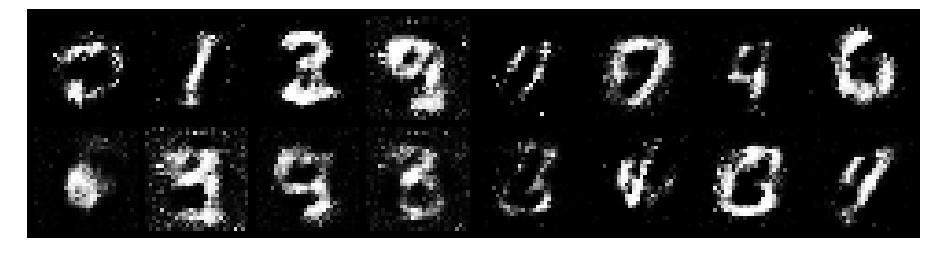

Epoch: [18/200], Batch Num: [400/600]
Discriminator Loss: 0.8083, Generator Loss: 1.6495
D(x): 0.7088, D(G(z)): 0.2568


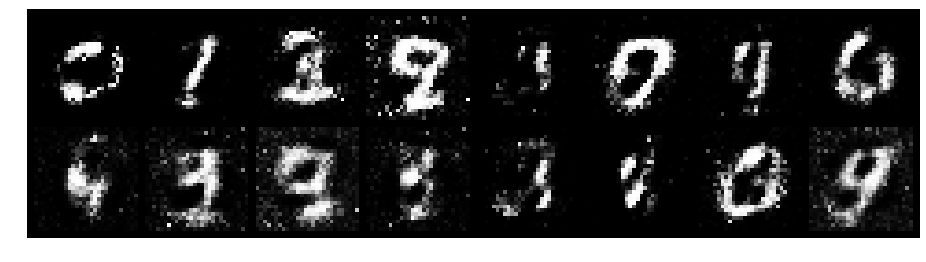

Epoch: [18/200], Batch Num: [500/600]
Discriminator Loss: 1.1154, Generator Loss: 1.4355
D(x): 0.7088, D(G(z)): 0.3672


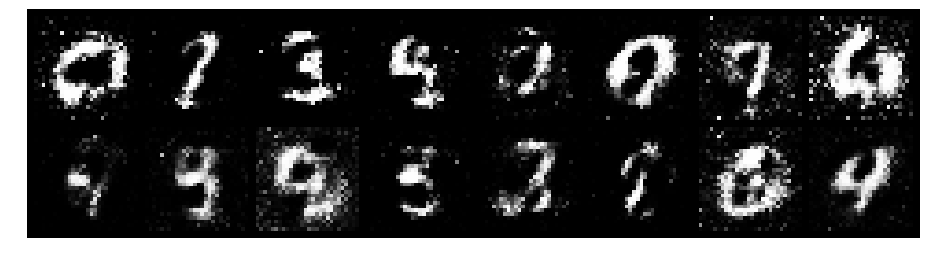

Epoch: [19/200], Batch Num: [0/600]
Discriminator Loss: 1.0876, Generator Loss: 1.2154
D(x): 0.6897, D(G(z)): 0.3897


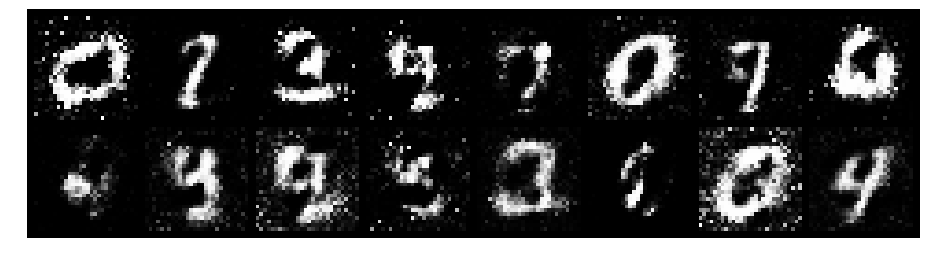

Epoch: [19/200], Batch Num: [100/600]
Discriminator Loss: 1.2126, Generator Loss: 1.2212
D(x): 0.6409, D(G(z)): 0.3882


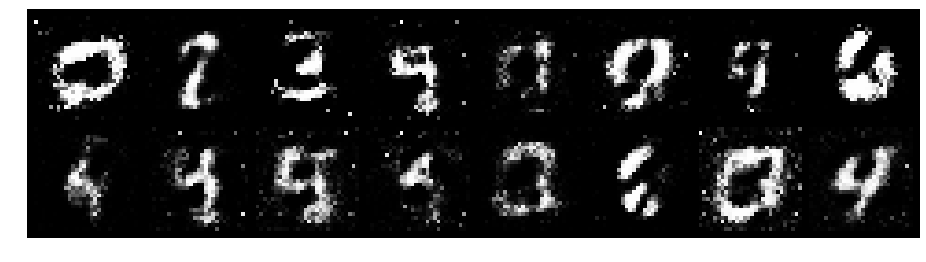

Epoch: [19/200], Batch Num: [200/600]
Discriminator Loss: 0.8543, Generator Loss: 1.8428
D(x): 0.7138, D(G(z)): 0.2592


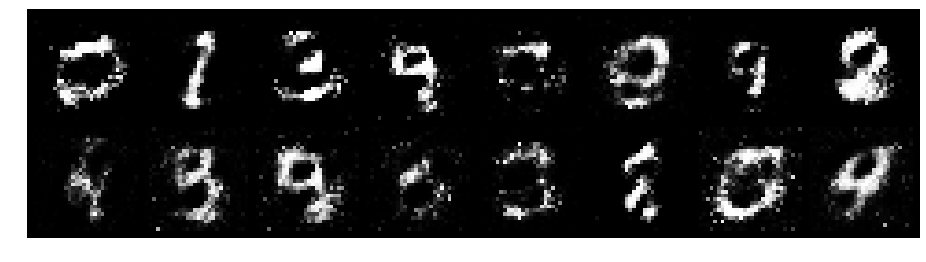

Epoch: [19/200], Batch Num: [300/600]
Discriminator Loss: 0.7256, Generator Loss: 2.7440
D(x): 0.7784, D(G(z)): 0.2494


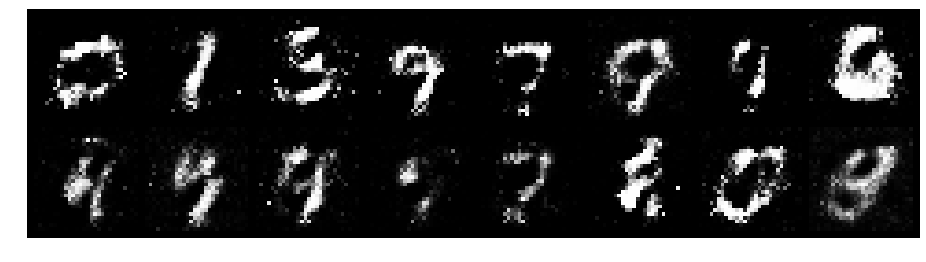

Epoch: [19/200], Batch Num: [400/600]
Discriminator Loss: 0.8693, Generator Loss: 1.3436
D(x): 0.6763, D(G(z)): 0.2979


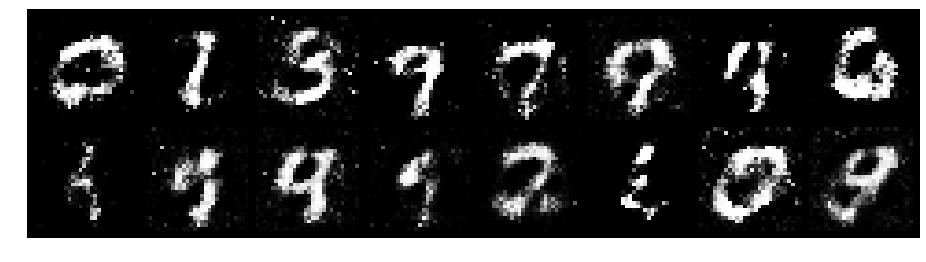

Epoch: [19/200], Batch Num: [500/600]
Discriminator Loss: 0.9654, Generator Loss: 1.4378
D(x): 0.6790, D(G(z)): 0.3373


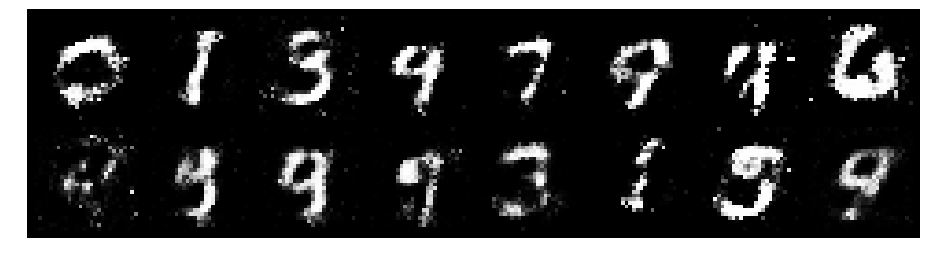

Epoch: [20/200], Batch Num: [0/600]
Discriminator Loss: 0.9540, Generator Loss: 1.4700
D(x): 0.6984, D(G(z)): 0.3256


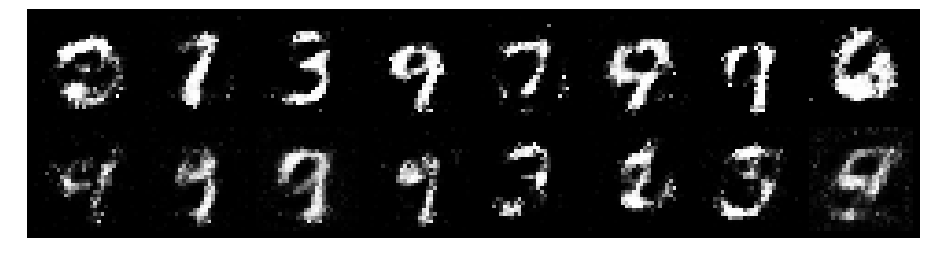

Epoch: [20/200], Batch Num: [100/600]
Discriminator Loss: 0.7831, Generator Loss: 1.4348
D(x): 0.8130, D(G(z)): 0.3699


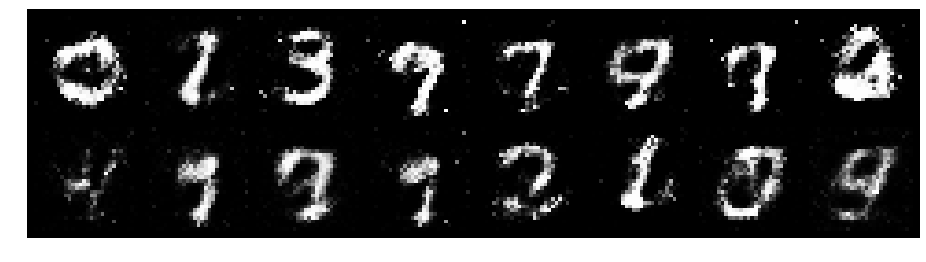

Epoch: [20/200], Batch Num: [200/600]
Discriminator Loss: 1.0288, Generator Loss: 1.3420
D(x): 0.6630, D(G(z)): 0.3238


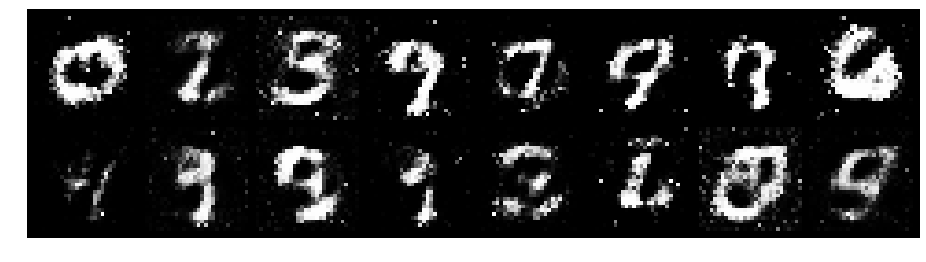

Epoch: [20/200], Batch Num: [300/600]
Discriminator Loss: 1.0336, Generator Loss: 1.3411
D(x): 0.7316, D(G(z)): 0.3912


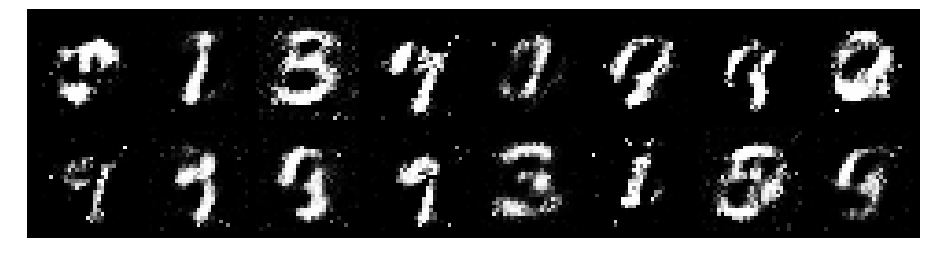

Epoch: [20/200], Batch Num: [400/600]
Discriminator Loss: 1.0195, Generator Loss: 1.6544
D(x): 0.7256, D(G(z)): 0.3361


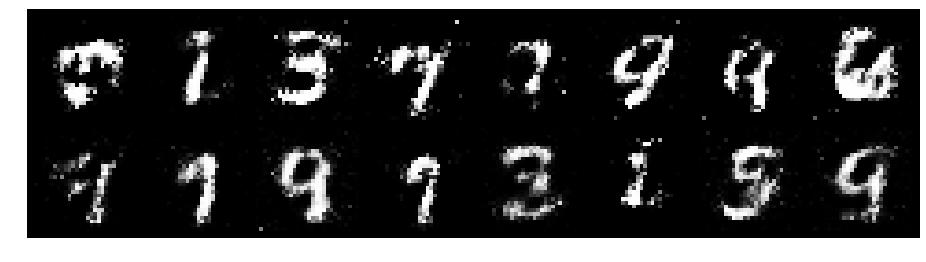

Epoch: [20/200], Batch Num: [500/600]
Discriminator Loss: 0.9031, Generator Loss: 1.4847
D(x): 0.6885, D(G(z)): 0.2879


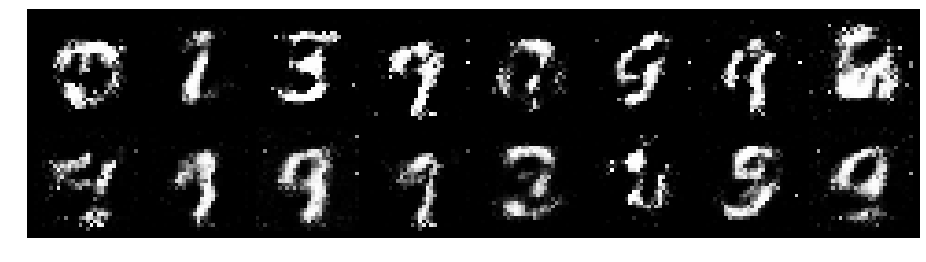

Epoch: [21/200], Batch Num: [0/600]
Discriminator Loss: 1.1445, Generator Loss: 1.2117
D(x): 0.5950, D(G(z)): 0.3285


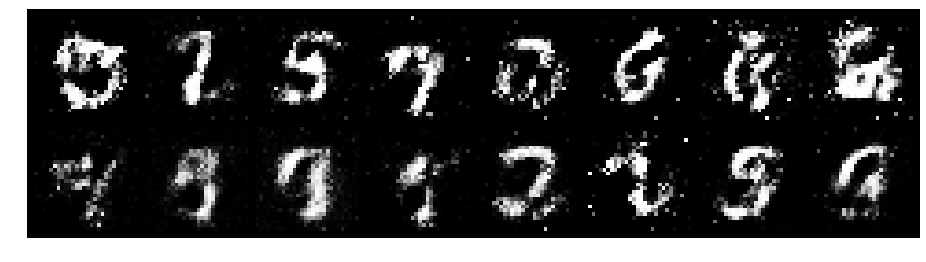

Epoch: [21/200], Batch Num: [100/600]
Discriminator Loss: 1.0957, Generator Loss: 1.2013
D(x): 0.5918, D(G(z)): 0.2952


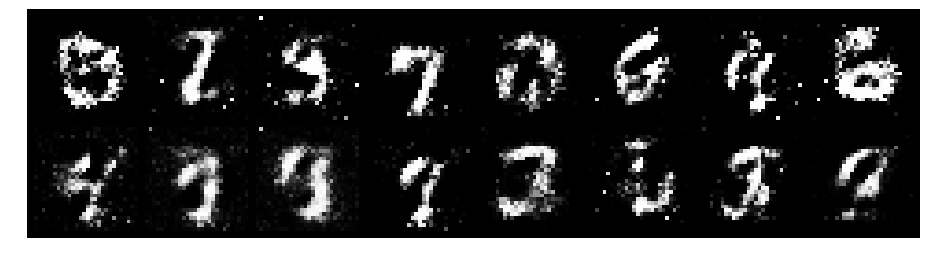

Epoch: [21/200], Batch Num: [200/600]
Discriminator Loss: 1.0330, Generator Loss: 1.3291
D(x): 0.6952, D(G(z)): 0.3921


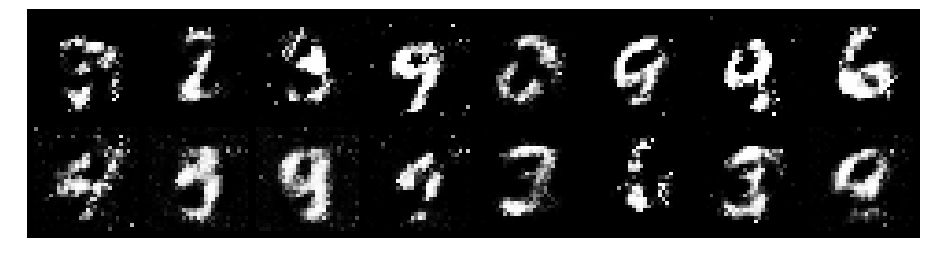

Epoch: [21/200], Batch Num: [300/600]
Discriminator Loss: 0.8551, Generator Loss: 1.5992
D(x): 0.6960, D(G(z)): 0.2882


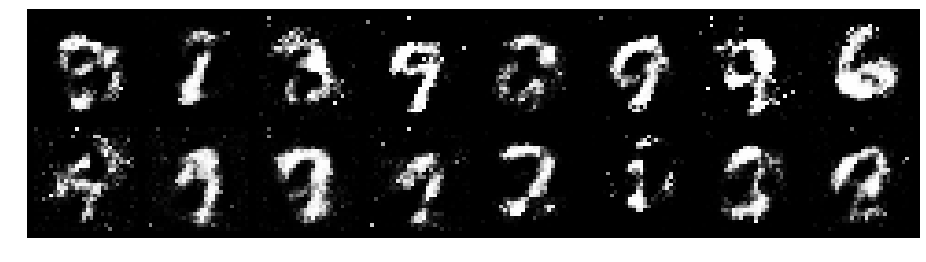

Epoch: [21/200], Batch Num: [400/600]
Discriminator Loss: 0.8871, Generator Loss: 1.3932
D(x): 0.7410, D(G(z)): 0.3318


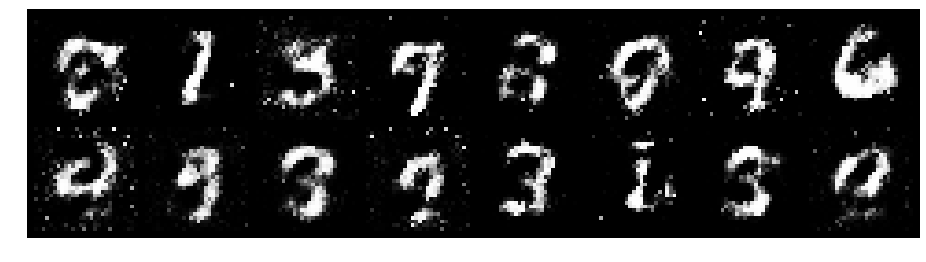

Epoch: [21/200], Batch Num: [500/600]
Discriminator Loss: 1.0362, Generator Loss: 1.1326
D(x): 0.7020, D(G(z)): 0.3569


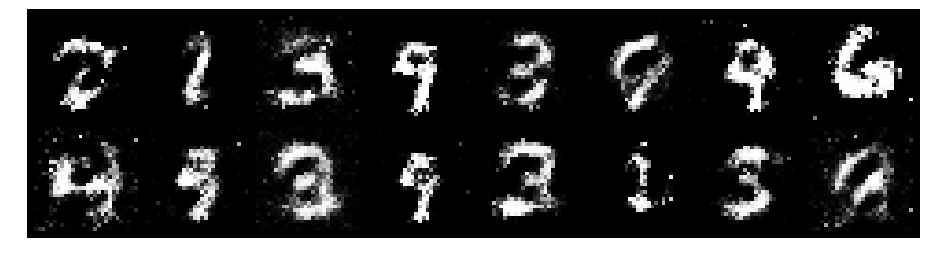

Epoch: [22/200], Batch Num: [0/600]
Discriminator Loss: 1.0663, Generator Loss: 1.2703
D(x): 0.6716, D(G(z)): 0.3519


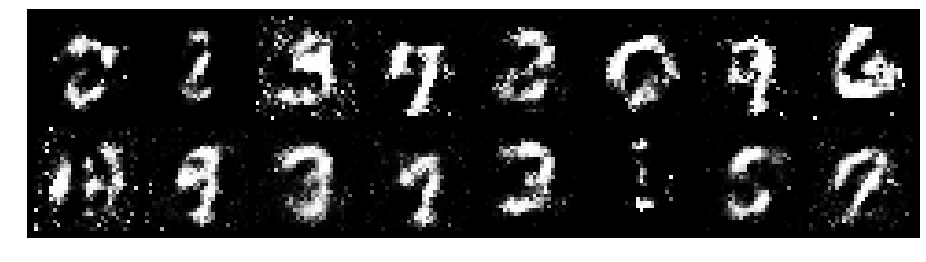

Epoch: [22/200], Batch Num: [100/600]
Discriminator Loss: 0.8499, Generator Loss: 1.5431
D(x): 0.7064, D(G(z)): 0.2678


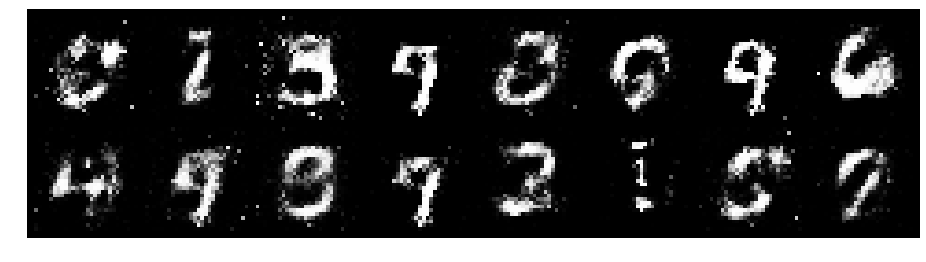

Epoch: [22/200], Batch Num: [200/600]
Discriminator Loss: 1.0167, Generator Loss: 1.3775
D(x): 0.6378, D(G(z)): 0.3323


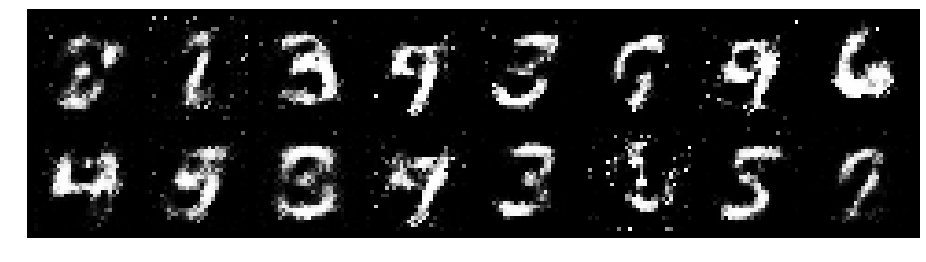

Epoch: [22/200], Batch Num: [300/600]
Discriminator Loss: 0.9117, Generator Loss: 1.4236
D(x): 0.7253, D(G(z)): 0.3316


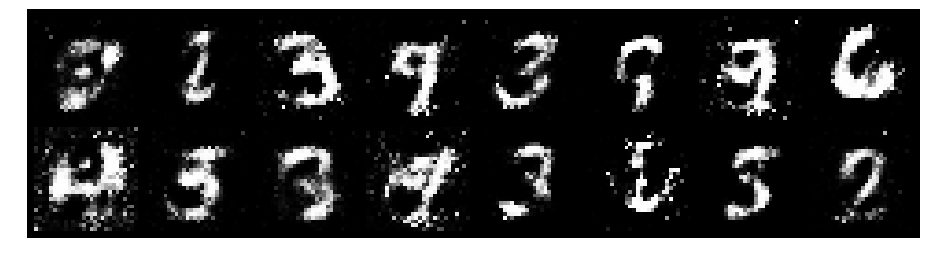

Epoch: [22/200], Batch Num: [400/600]
Discriminator Loss: 0.7542, Generator Loss: 1.6532
D(x): 0.7749, D(G(z)): 0.2978


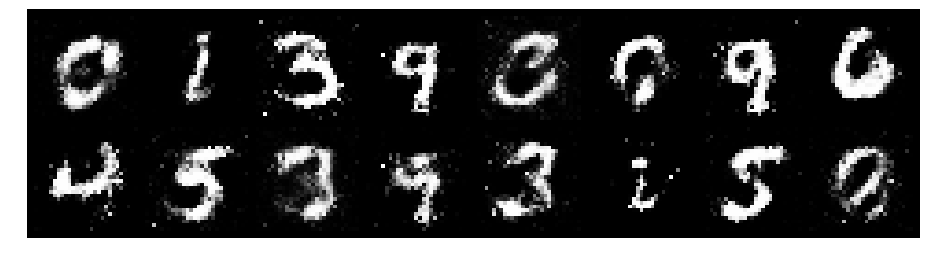

Epoch: [22/200], Batch Num: [500/600]
Discriminator Loss: 0.8689, Generator Loss: 1.8592
D(x): 0.6757, D(G(z)): 0.2381


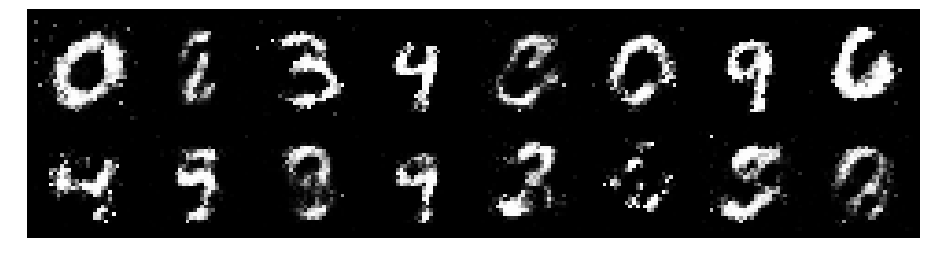

Epoch: [23/200], Batch Num: [0/600]
Discriminator Loss: 0.7548, Generator Loss: 1.6600
D(x): 0.7226, D(G(z)): 0.2503


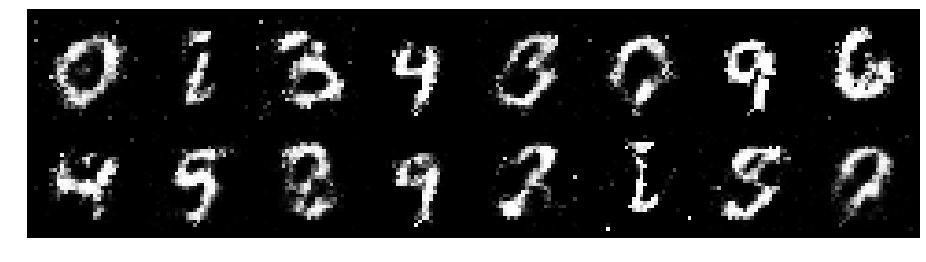

Epoch: [23/200], Batch Num: [100/600]
Discriminator Loss: 0.8979, Generator Loss: 1.6434
D(x): 0.7625, D(G(z)): 0.3496


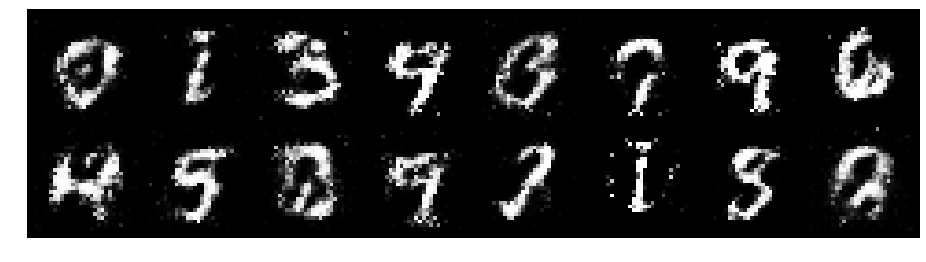

Epoch: [23/200], Batch Num: [200/600]
Discriminator Loss: 0.8156, Generator Loss: 1.9498
D(x): 0.6779, D(G(z)): 0.2232


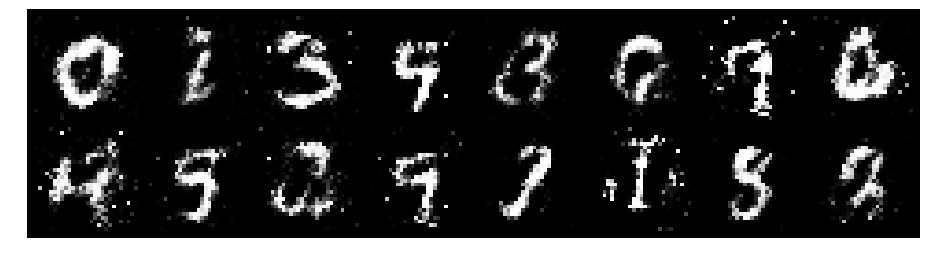

Epoch: [23/200], Batch Num: [300/600]
Discriminator Loss: 0.9483, Generator Loss: 1.4897
D(x): 0.7079, D(G(z)): 0.3243


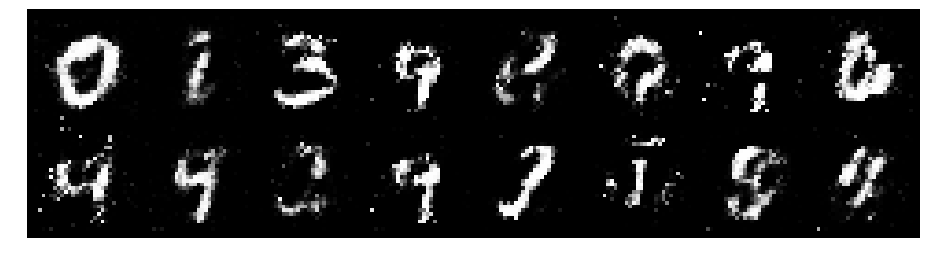

Epoch: [23/200], Batch Num: [400/600]
Discriminator Loss: 0.7273, Generator Loss: 1.6650
D(x): 0.7518, D(G(z)): 0.2797


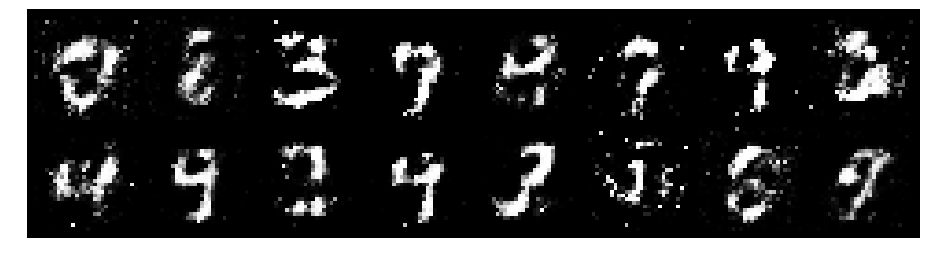

Epoch: [23/200], Batch Num: [500/600]
Discriminator Loss: 0.9553, Generator Loss: 1.2517
D(x): 0.6383, D(G(z)): 0.2756


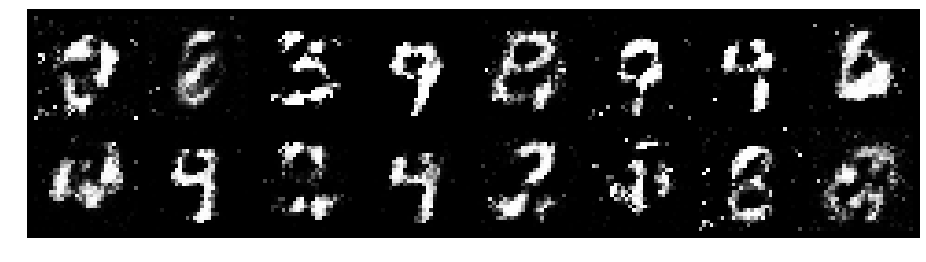

Epoch: [24/200], Batch Num: [0/600]
Discriminator Loss: 1.0445, Generator Loss: 1.3803
D(x): 0.6765, D(G(z)): 0.3395


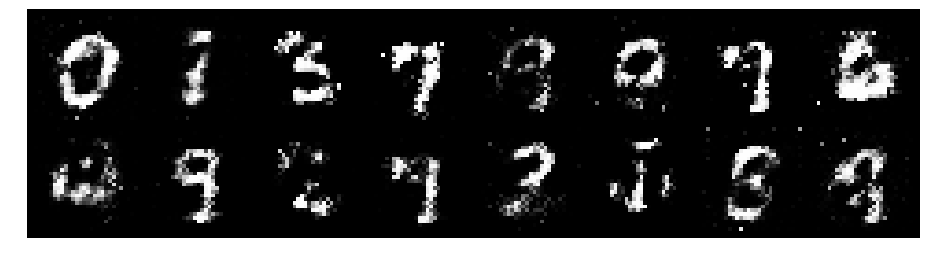

Epoch: [24/200], Batch Num: [100/600]
Discriminator Loss: 0.7535, Generator Loss: 1.2872
D(x): 0.7492, D(G(z)): 0.2995


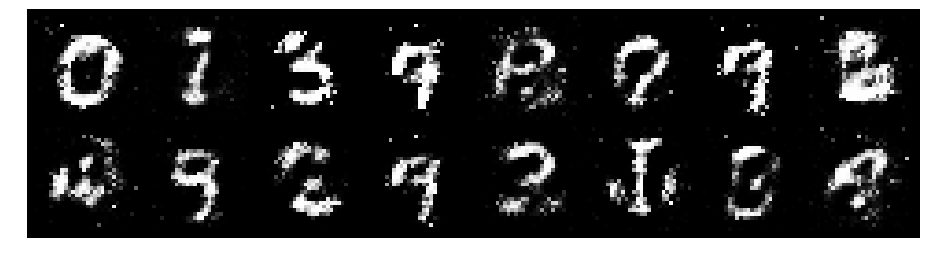

Epoch: [24/200], Batch Num: [200/600]
Discriminator Loss: 0.9039, Generator Loss: 1.2886
D(x): 0.6804, D(G(z)): 0.3007


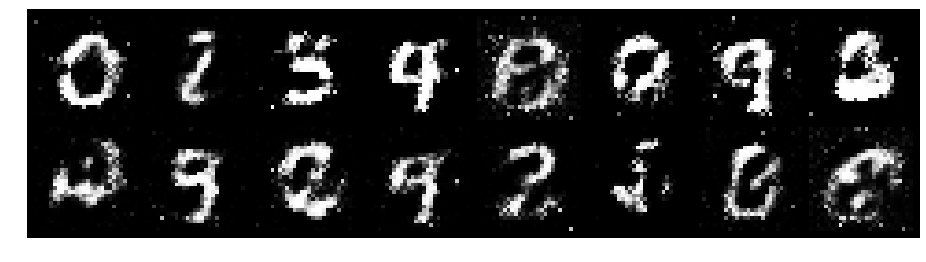

Epoch: [24/200], Batch Num: [300/600]
Discriminator Loss: 0.8830, Generator Loss: 1.6588
D(x): 0.7006, D(G(z)): 0.2746


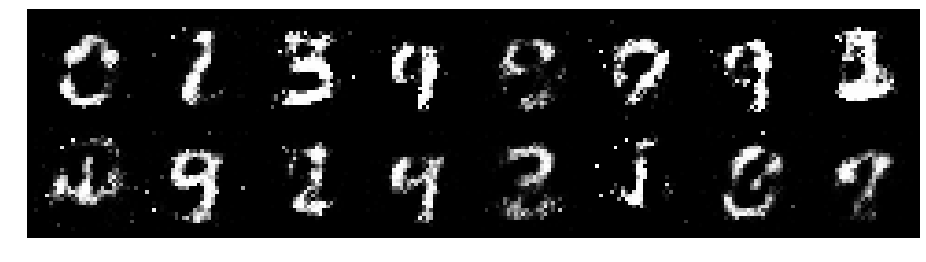

Epoch: [24/200], Batch Num: [400/600]
Discriminator Loss: 0.7780, Generator Loss: 1.8405
D(x): 0.7141, D(G(z)): 0.2309


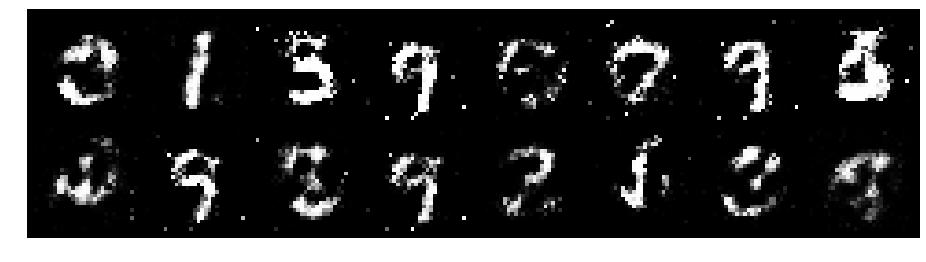

Epoch: [24/200], Batch Num: [500/600]
Discriminator Loss: 0.7729, Generator Loss: 1.7905
D(x): 0.7756, D(G(z)): 0.3006


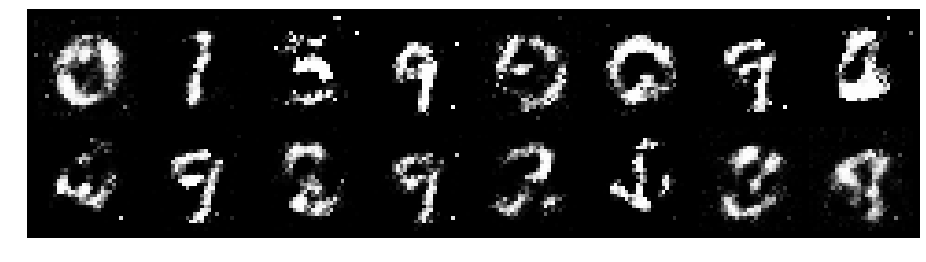

Epoch: [25/200], Batch Num: [0/600]
Discriminator Loss: 0.7674, Generator Loss: 2.0213
D(x): 0.7378, D(G(z)): 0.2566


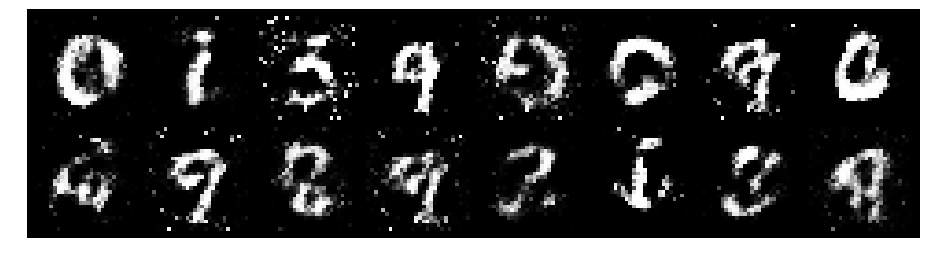

Epoch: [25/200], Batch Num: [100/600]
Discriminator Loss: 0.8163, Generator Loss: 2.1085
D(x): 0.7097, D(G(z)): 0.2104


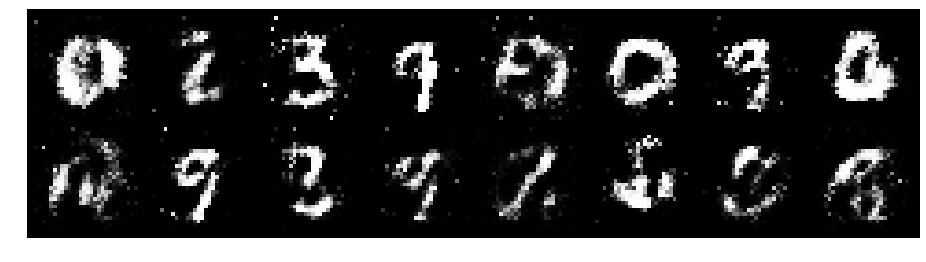

Epoch: [25/200], Batch Num: [200/600]
Discriminator Loss: 0.9821, Generator Loss: 1.7293
D(x): 0.6388, D(G(z)): 0.2440


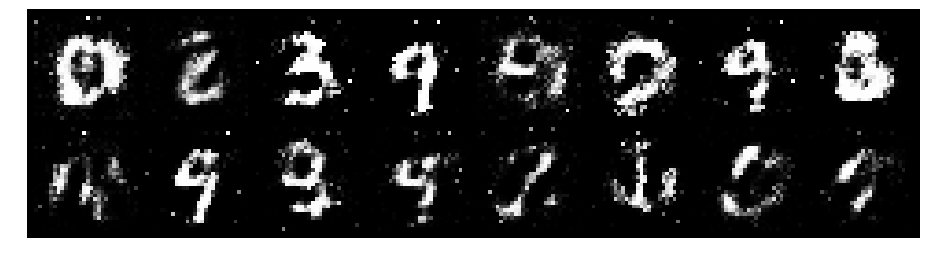

Epoch: [25/200], Batch Num: [300/600]
Discriminator Loss: 0.6743, Generator Loss: 1.9819
D(x): 0.7918, D(G(z)): 0.2425


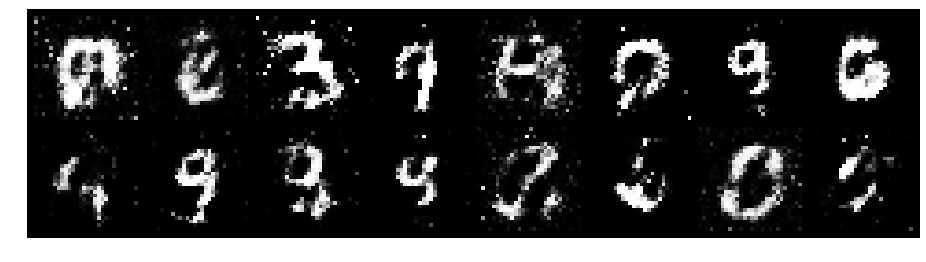

Epoch: [25/200], Batch Num: [400/600]
Discriminator Loss: 0.9605, Generator Loss: 1.6987
D(x): 0.7314, D(G(z)): 0.3160


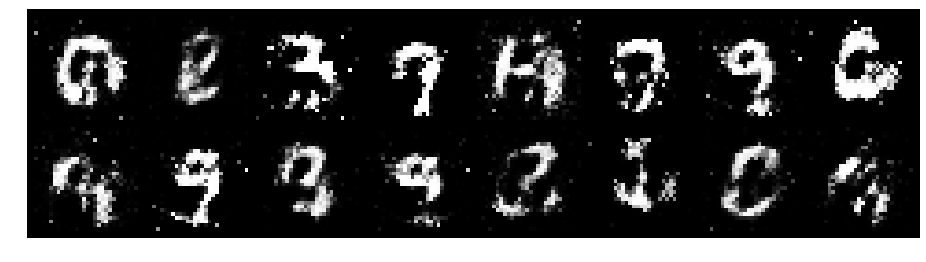

Epoch: [25/200], Batch Num: [500/600]
Discriminator Loss: 1.1351, Generator Loss: 1.5668
D(x): 0.6984, D(G(z)): 0.3582


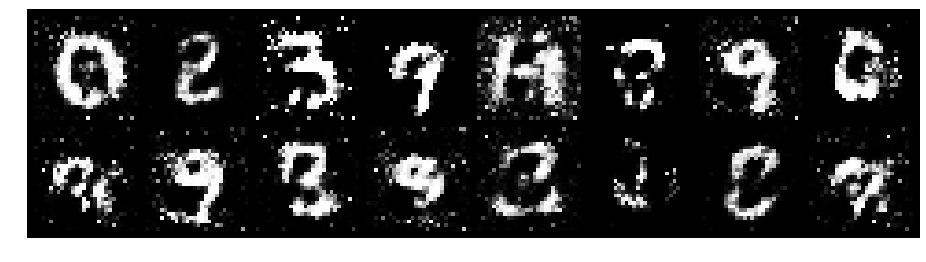

Epoch: [26/200], Batch Num: [0/600]
Discriminator Loss: 1.0452, Generator Loss: 1.7080
D(x): 0.6549, D(G(z)): 0.2811


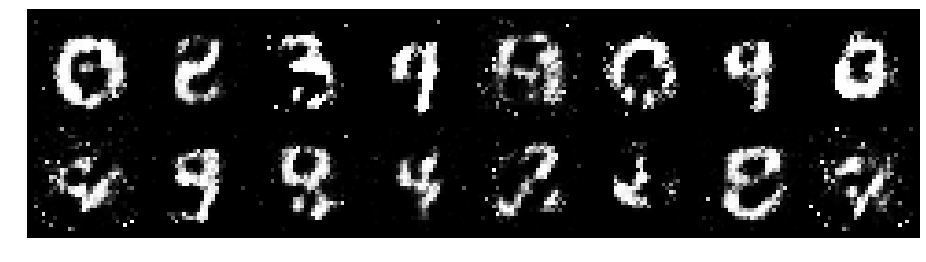

Epoch: [26/200], Batch Num: [100/600]
Discriminator Loss: 1.1931, Generator Loss: 1.6481
D(x): 0.5483, D(G(z)): 0.2878


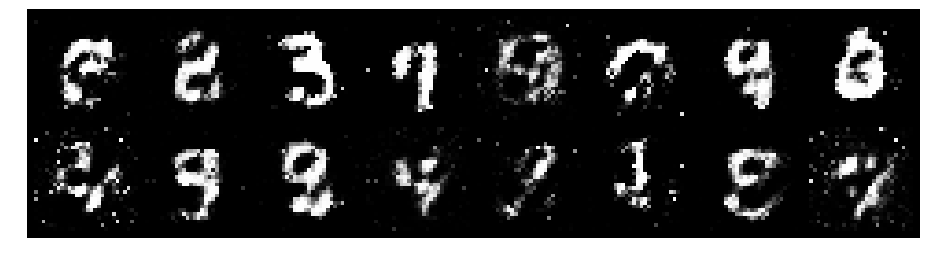

Epoch: [26/200], Batch Num: [200/600]
Discriminator Loss: 1.0094, Generator Loss: 1.2919
D(x): 0.6635, D(G(z)): 0.3309


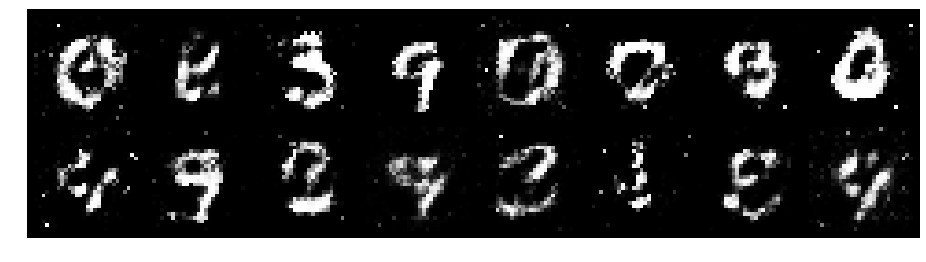

Epoch: [26/200], Batch Num: [300/600]
Discriminator Loss: 0.9105, Generator Loss: 1.2662
D(x): 0.7223, D(G(z)): 0.3560


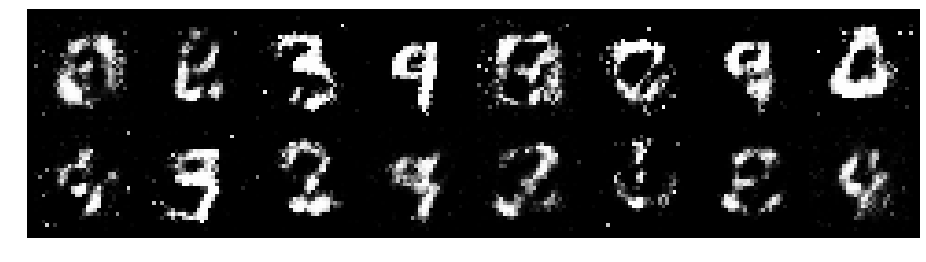

Epoch: [26/200], Batch Num: [400/600]
Discriminator Loss: 1.0494, Generator Loss: 1.3156
D(x): 0.7162, D(G(z)): 0.3968


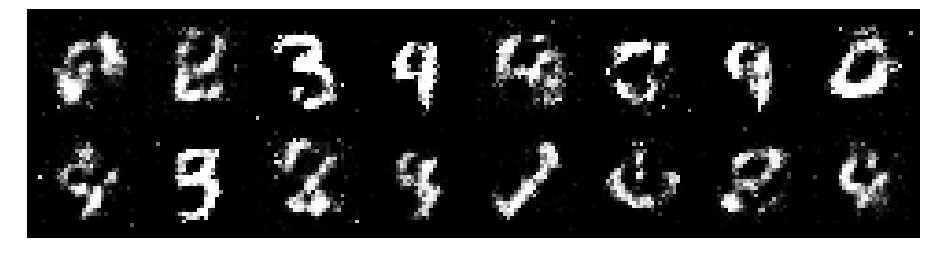

Epoch: [26/200], Batch Num: [500/600]
Discriminator Loss: 0.9820, Generator Loss: 1.1592
D(x): 0.7634, D(G(z)): 0.4315


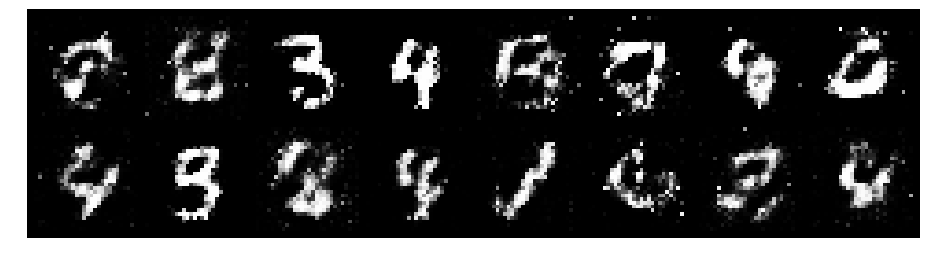

Epoch: [27/200], Batch Num: [0/600]
Discriminator Loss: 0.9851, Generator Loss: 1.3739
D(x): 0.7074, D(G(z)): 0.3767


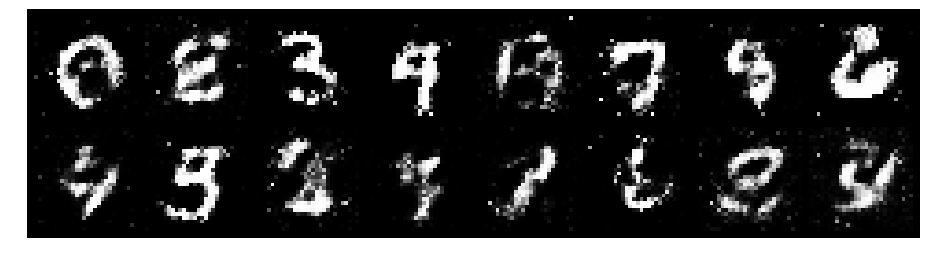

Epoch: [27/200], Batch Num: [100/600]
Discriminator Loss: 1.0523, Generator Loss: 1.2261
D(x): 0.6503, D(G(z)): 0.3592


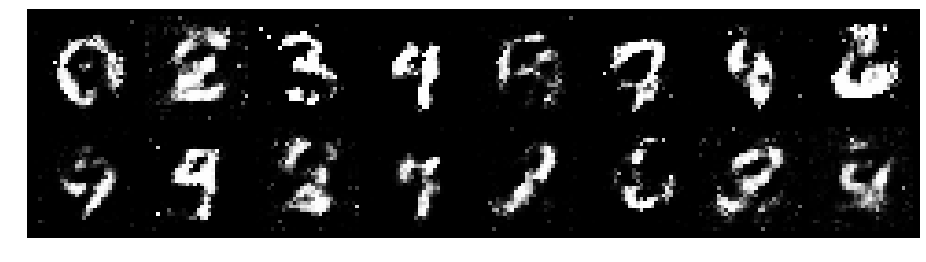

Epoch: [27/200], Batch Num: [200/600]
Discriminator Loss: 1.0570, Generator Loss: 1.1838
D(x): 0.6402, D(G(z)): 0.3353


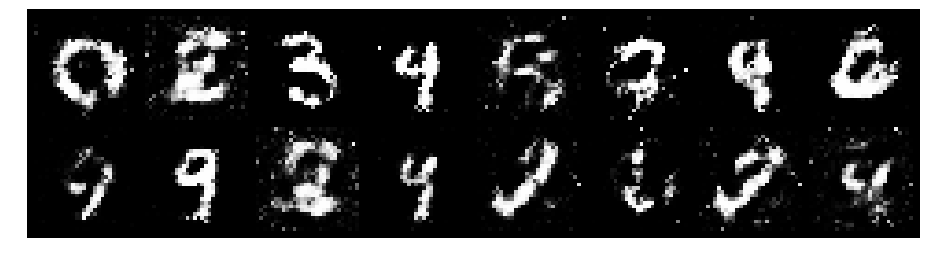

Epoch: [27/200], Batch Num: [300/600]
Discriminator Loss: 1.1697, Generator Loss: 1.1307
D(x): 0.6732, D(G(z)): 0.4251


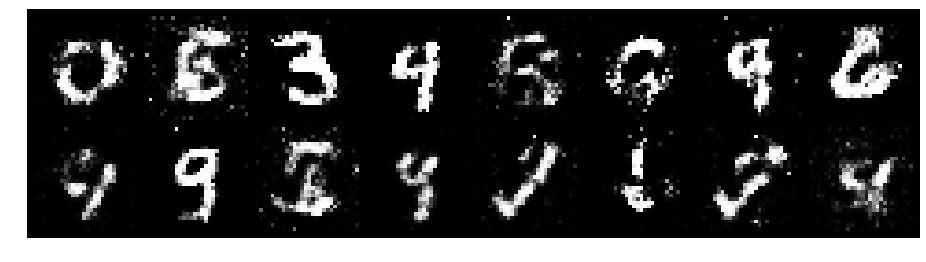

Epoch: [27/200], Batch Num: [400/600]
Discriminator Loss: 1.1087, Generator Loss: 1.1759
D(x): 0.6083, D(G(z)): 0.3218


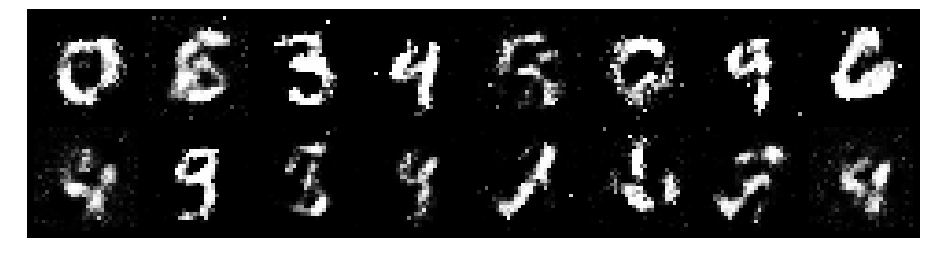

Epoch: [27/200], Batch Num: [500/600]
Discriminator Loss: 1.1576, Generator Loss: 1.2068
D(x): 0.6595, D(G(z)): 0.3868


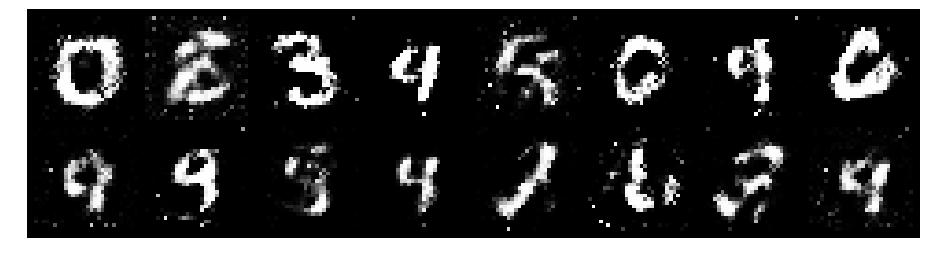

Epoch: [28/200], Batch Num: [0/600]
Discriminator Loss: 1.0654, Generator Loss: 1.2827
D(x): 0.6863, D(G(z)): 0.3587


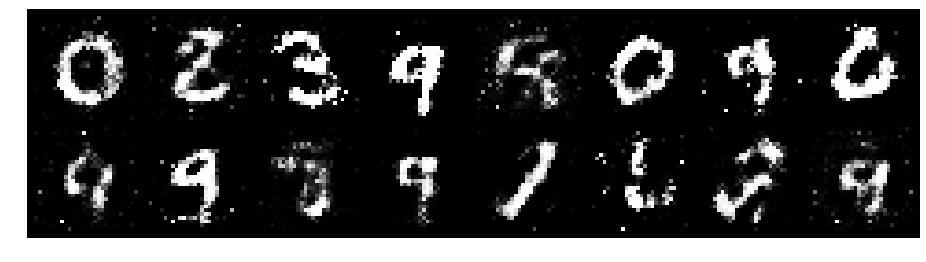

Epoch: [28/200], Batch Num: [100/600]
Discriminator Loss: 1.1328, Generator Loss: 1.5400
D(x): 0.6570, D(G(z)): 0.3516


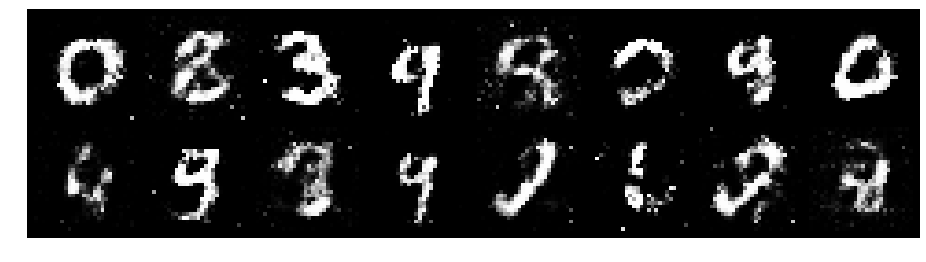

Epoch: [28/200], Batch Num: [200/600]
Discriminator Loss: 1.1398, Generator Loss: 1.2810
D(x): 0.6474, D(G(z)): 0.3830


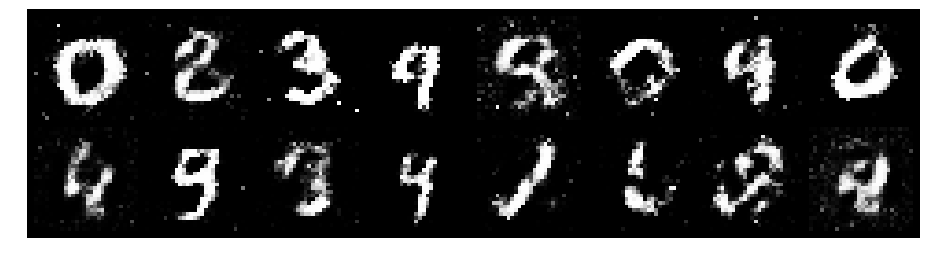

Epoch: [28/200], Batch Num: [300/600]
Discriminator Loss: 0.9251, Generator Loss: 1.5028
D(x): 0.6584, D(G(z)): 0.2926


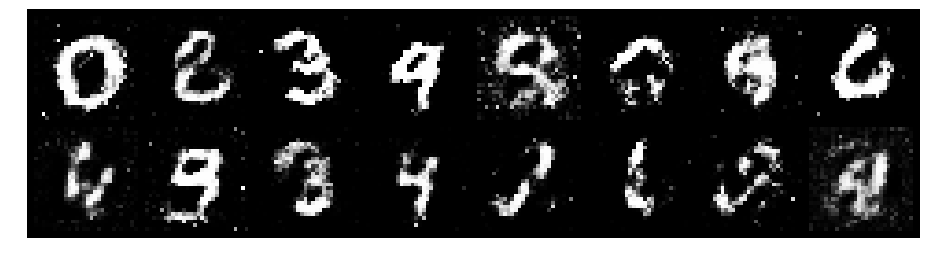

Epoch: [28/200], Batch Num: [400/600]
Discriminator Loss: 0.9606, Generator Loss: 1.7879
D(x): 0.6585, D(G(z)): 0.2835


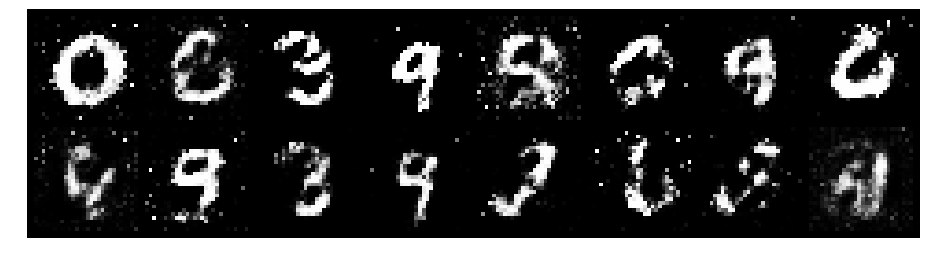

Epoch: [28/200], Batch Num: [500/600]
Discriminator Loss: 0.8895, Generator Loss: 1.2683
D(x): 0.6831, D(G(z)): 0.2999


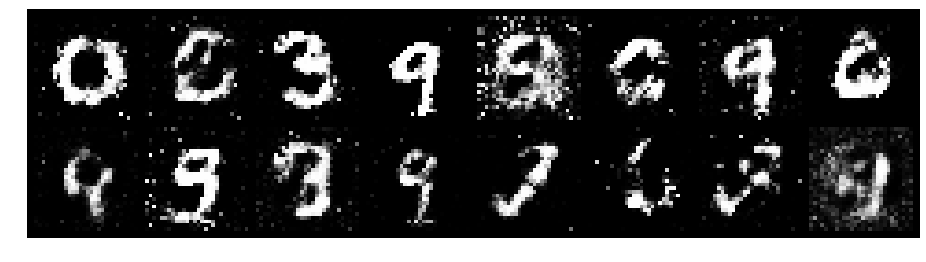

Epoch: [29/200], Batch Num: [0/600]
Discriminator Loss: 1.1059, Generator Loss: 1.4245
D(x): 0.6997, D(G(z)): 0.3784


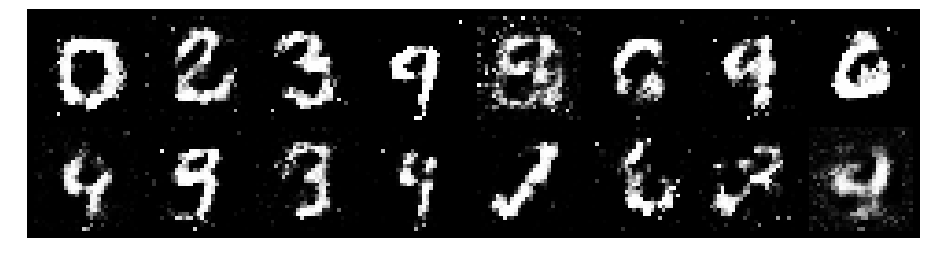

Epoch: [29/200], Batch Num: [100/600]
Discriminator Loss: 1.1655, Generator Loss: 1.0772
D(x): 0.6609, D(G(z)): 0.4335


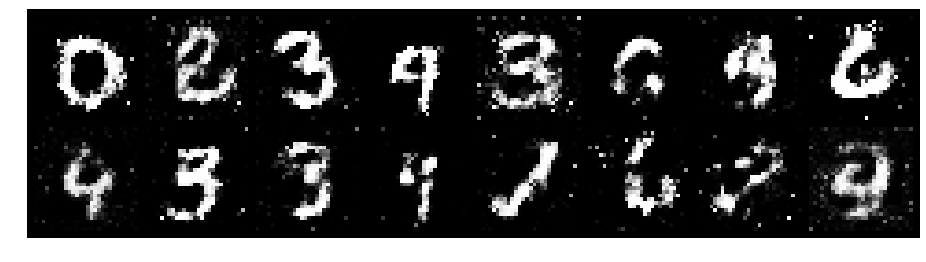

Epoch: [29/200], Batch Num: [200/600]
Discriminator Loss: 1.0472, Generator Loss: 1.1769
D(x): 0.6284, D(G(z)): 0.3494


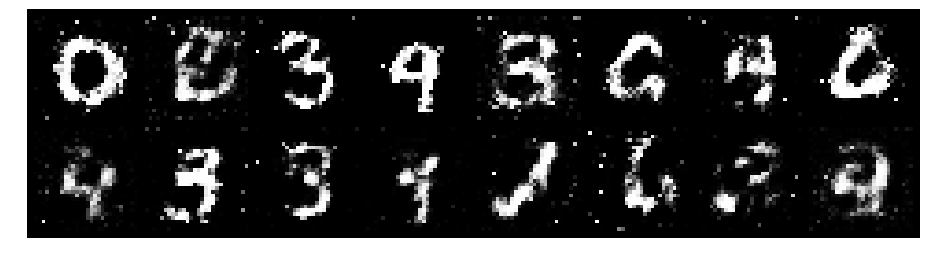

Epoch: [29/200], Batch Num: [300/600]
Discriminator Loss: 0.9722, Generator Loss: 1.2867
D(x): 0.6711, D(G(z)): 0.3561


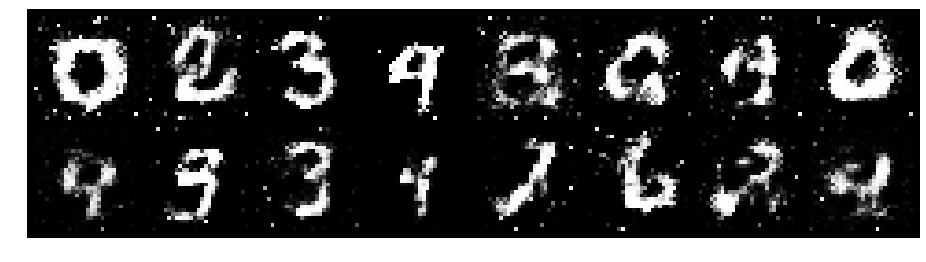

Epoch: [29/200], Batch Num: [400/600]
Discriminator Loss: 0.9616, Generator Loss: 1.6984
D(x): 0.6153, D(G(z)): 0.2696


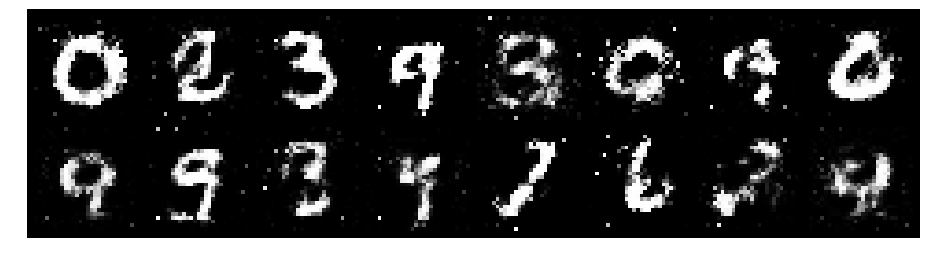

Epoch: [29/200], Batch Num: [500/600]
Discriminator Loss: 1.0128, Generator Loss: 1.7561
D(x): 0.5816, D(G(z)): 0.2242


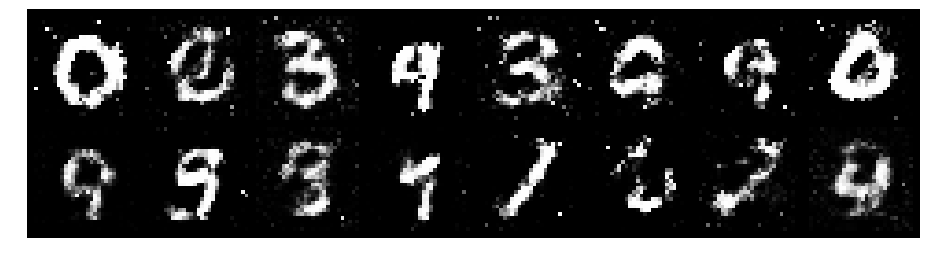

Epoch: [30/200], Batch Num: [0/600]
Discriminator Loss: 1.0549, Generator Loss: 1.4242
D(x): 0.6743, D(G(z)): 0.3648


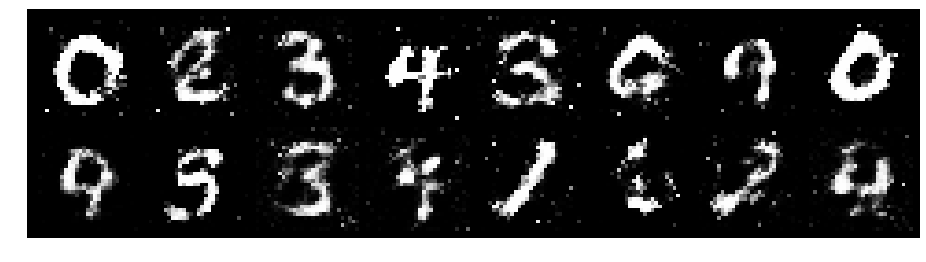

Epoch: [30/200], Batch Num: [100/600]
Discriminator Loss: 0.9319, Generator Loss: 1.8319
D(x): 0.6913, D(G(z)): 0.3156


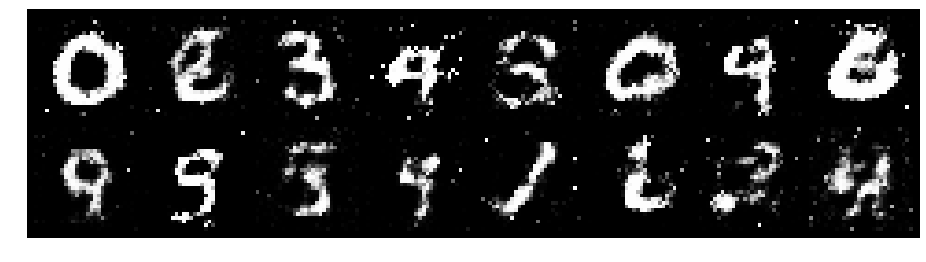

Epoch: [30/200], Batch Num: [200/600]
Discriminator Loss: 0.8252, Generator Loss: 1.5900
D(x): 0.7059, D(G(z)): 0.2510


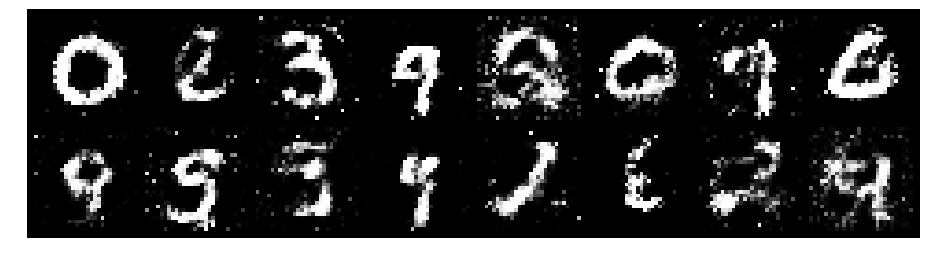

Epoch: [30/200], Batch Num: [300/600]
Discriminator Loss: 0.9605, Generator Loss: 1.5683
D(x): 0.6625, D(G(z)): 0.3079


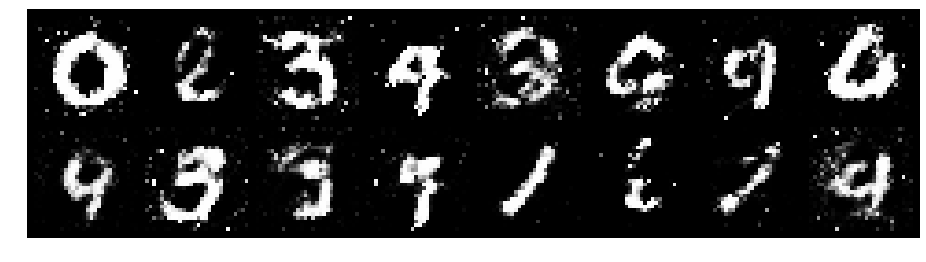

Epoch: [30/200], Batch Num: [400/600]
Discriminator Loss: 0.9588, Generator Loss: 1.2620
D(x): 0.7097, D(G(z)): 0.3229


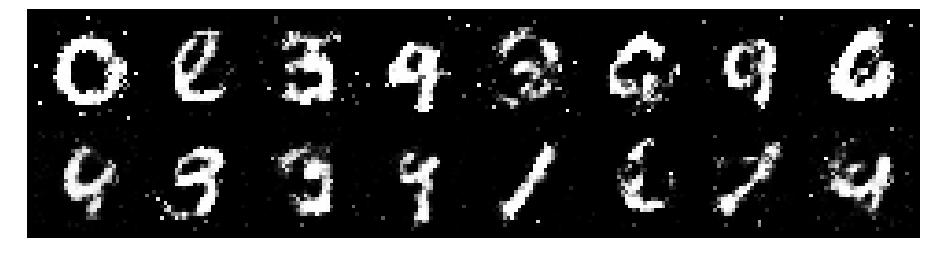

Epoch: [30/200], Batch Num: [500/600]
Discriminator Loss: 0.8683, Generator Loss: 1.4620
D(x): 0.7420, D(G(z)): 0.3123


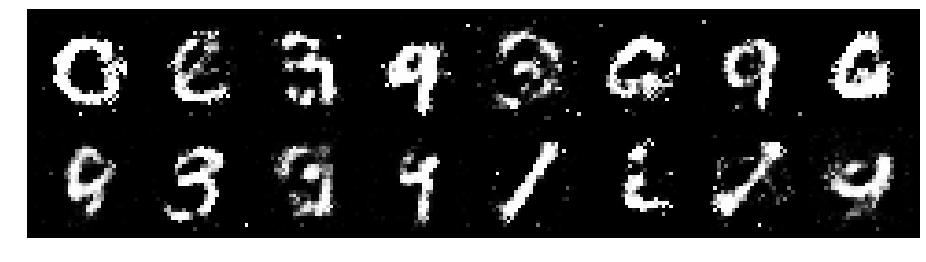

Epoch: [31/200], Batch Num: [0/600]
Discriminator Loss: 0.9983, Generator Loss: 1.5526
D(x): 0.6089, D(G(z)): 0.2637


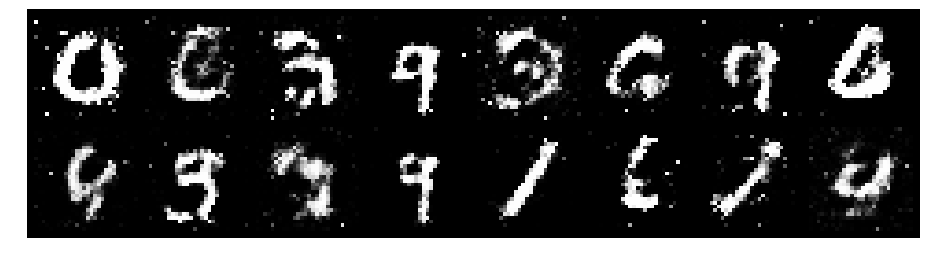

Epoch: [31/200], Batch Num: [100/600]
Discriminator Loss: 0.9495, Generator Loss: 1.2344
D(x): 0.6661, D(G(z)): 0.3291


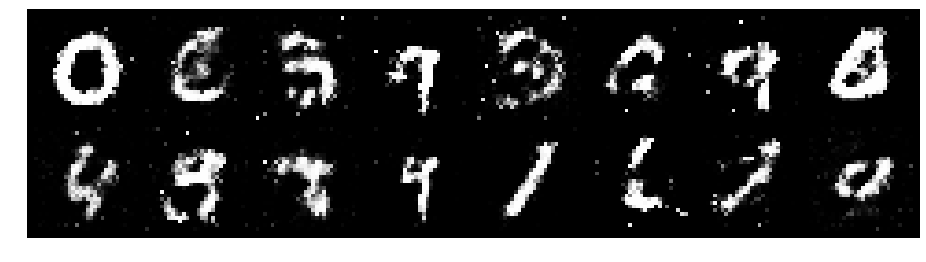

Epoch: [31/200], Batch Num: [200/600]
Discriminator Loss: 0.8685, Generator Loss: 1.2590
D(x): 0.7082, D(G(z)): 0.3219


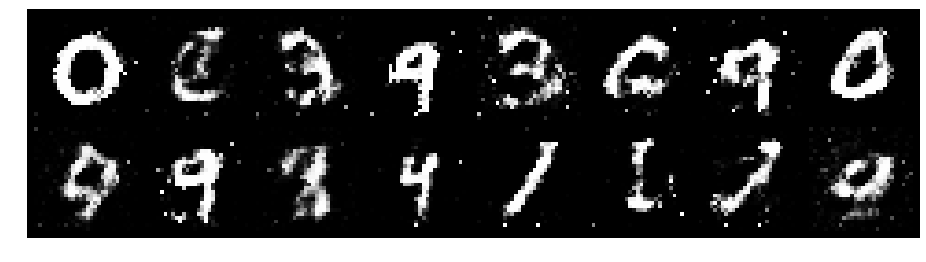

Epoch: [31/200], Batch Num: [300/600]
Discriminator Loss: 1.0404, Generator Loss: 1.6157
D(x): 0.5941, D(G(z)): 0.2834


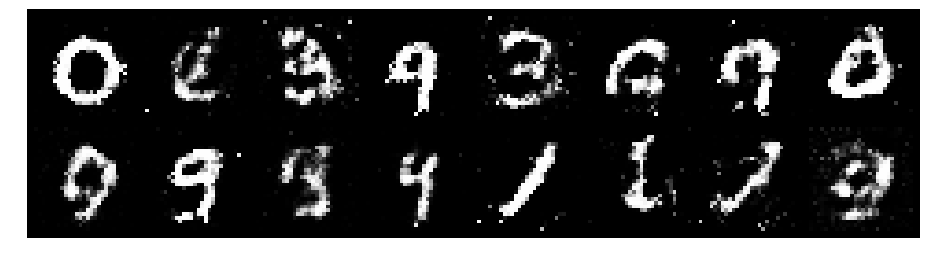

Epoch: [31/200], Batch Num: [400/600]
Discriminator Loss: 0.9015, Generator Loss: 1.5811
D(x): 0.7693, D(G(z)): 0.3811


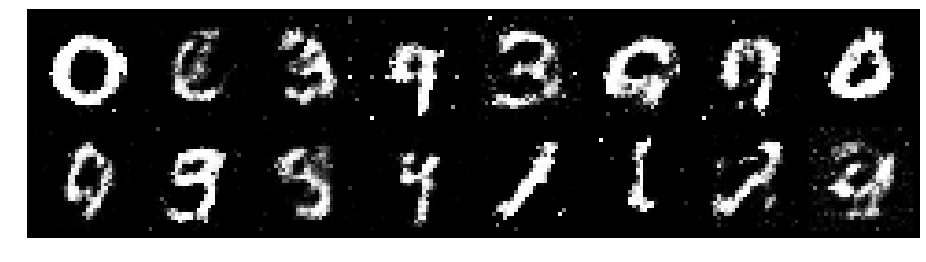

Epoch: [31/200], Batch Num: [500/600]
Discriminator Loss: 1.0587, Generator Loss: 1.7421
D(x): 0.5607, D(G(z)): 0.2513


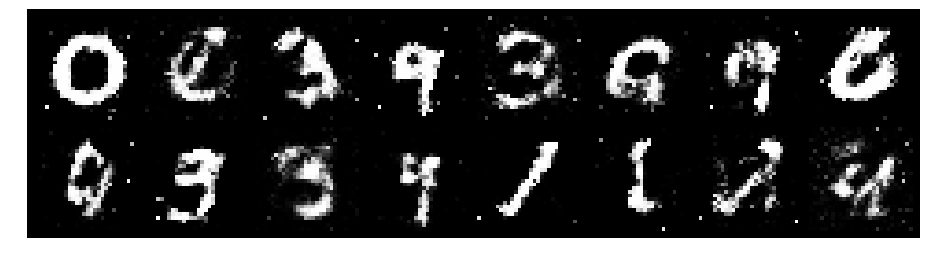

Epoch: [32/200], Batch Num: [0/600]
Discriminator Loss: 1.0879, Generator Loss: 1.2124
D(x): 0.6341, D(G(z)): 0.3751


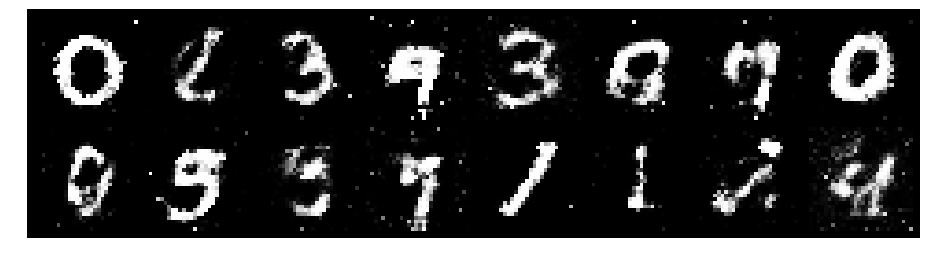

Epoch: [32/200], Batch Num: [100/600]
Discriminator Loss: 1.1871, Generator Loss: 0.9777
D(x): 0.6668, D(G(z)): 0.4693


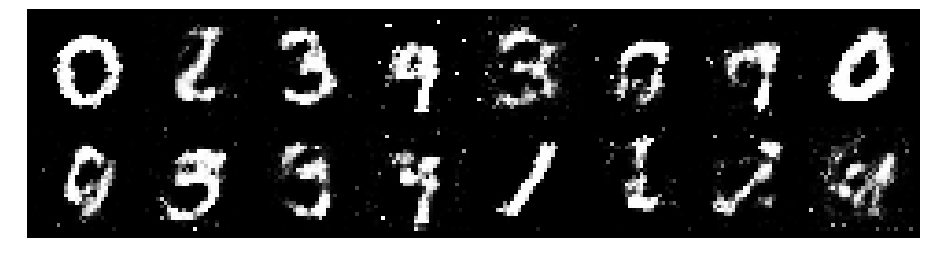

Epoch: [32/200], Batch Num: [200/600]
Discriminator Loss: 1.0880, Generator Loss: 1.1754
D(x): 0.6156, D(G(z)): 0.3650


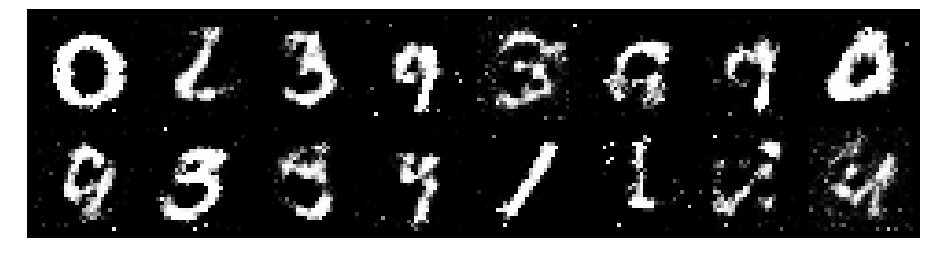

Epoch: [32/200], Batch Num: [300/600]
Discriminator Loss: 1.1034, Generator Loss: 1.2124
D(x): 0.6336, D(G(z)): 0.3692


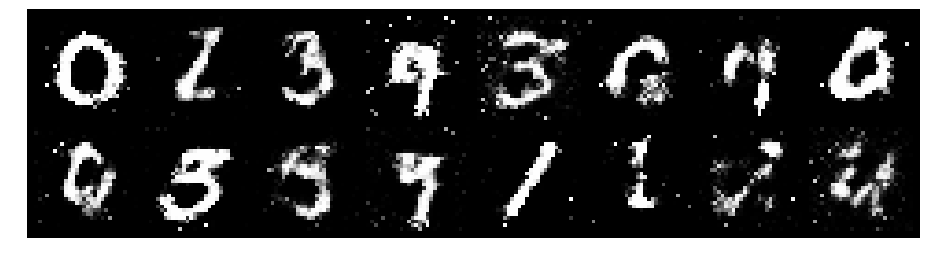

Epoch: [32/200], Batch Num: [400/600]
Discriminator Loss: 1.1838, Generator Loss: 1.2337
D(x): 0.6267, D(G(z)): 0.3907


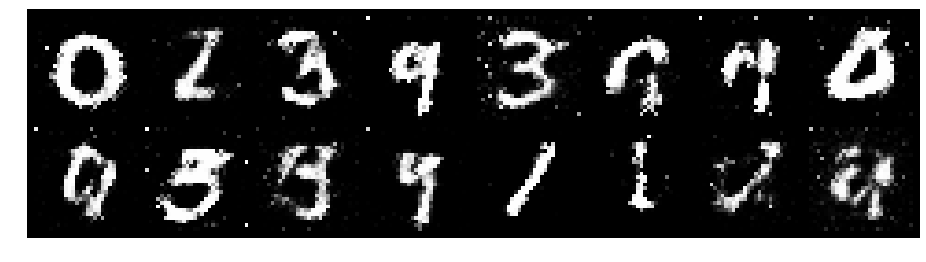

Epoch: [32/200], Batch Num: [500/600]
Discriminator Loss: 0.9727, Generator Loss: 1.2895
D(x): 0.6374, D(G(z)): 0.3317


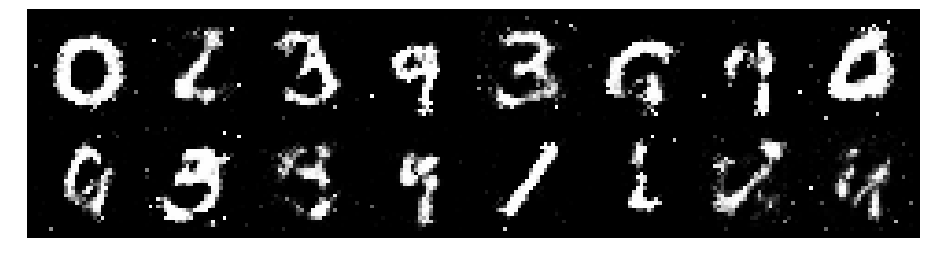

Epoch: [33/200], Batch Num: [0/600]
Discriminator Loss: 1.0732, Generator Loss: 1.3119
D(x): 0.6117, D(G(z)): 0.3253


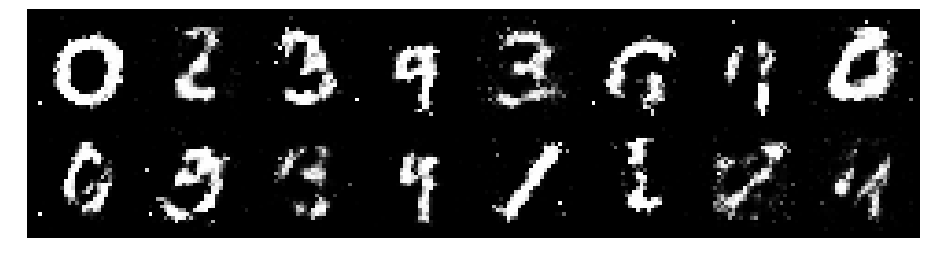

Epoch: [33/200], Batch Num: [100/600]
Discriminator Loss: 1.0608, Generator Loss: 1.6037
D(x): 0.7081, D(G(z)): 0.4095


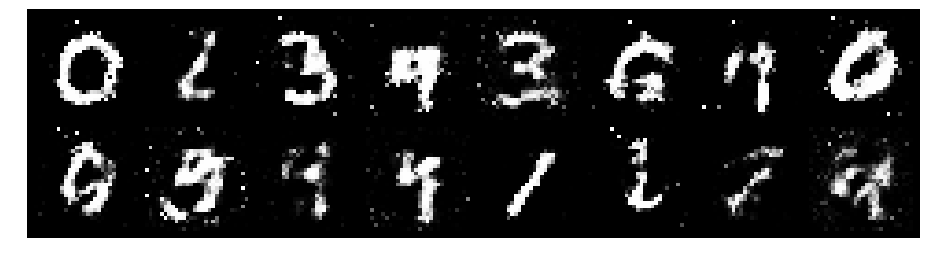

Epoch: [33/200], Batch Num: [200/600]
Discriminator Loss: 1.0224, Generator Loss: 1.3051
D(x): 0.6235, D(G(z)): 0.3164


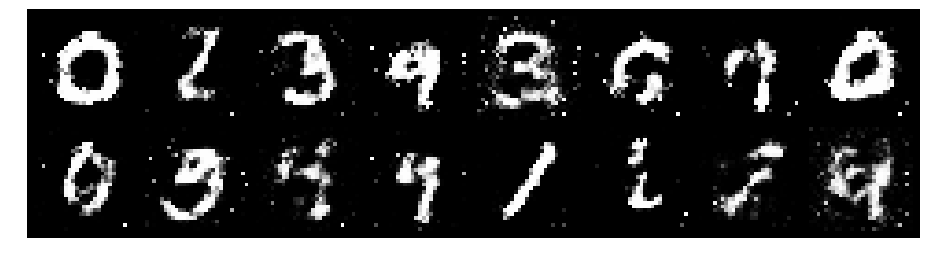

Epoch: [33/200], Batch Num: [300/600]
Discriminator Loss: 1.0103, Generator Loss: 1.2499
D(x): 0.6700, D(G(z)): 0.3271


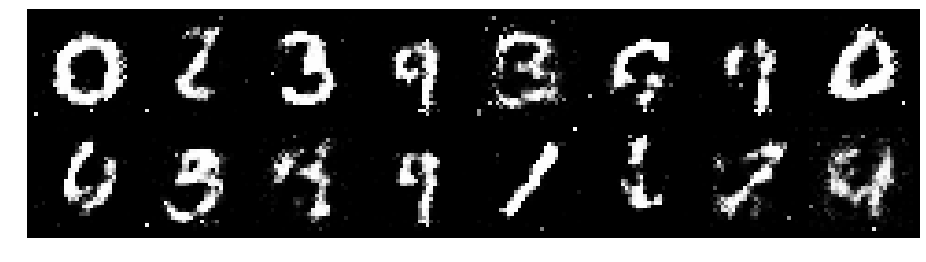

Epoch: [33/200], Batch Num: [400/600]
Discriminator Loss: 1.0270, Generator Loss: 1.4418
D(x): 0.6631, D(G(z)): 0.3248


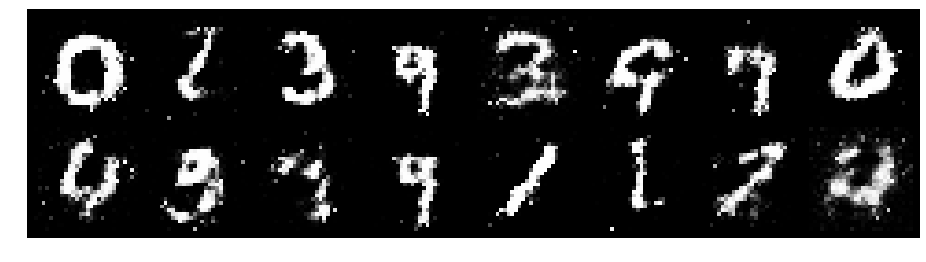

Epoch: [33/200], Batch Num: [500/600]
Discriminator Loss: 1.1488, Generator Loss: 0.9995
D(x): 0.6138, D(G(z)): 0.4106


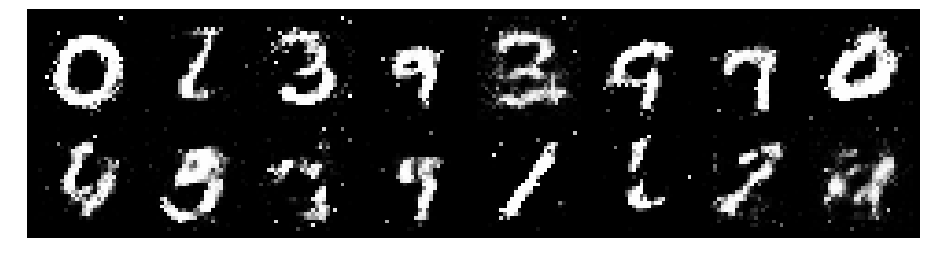

Epoch: [34/200], Batch Num: [0/600]
Discriminator Loss: 1.1036, Generator Loss: 1.0086
D(x): 0.6050, D(G(z)): 0.3842


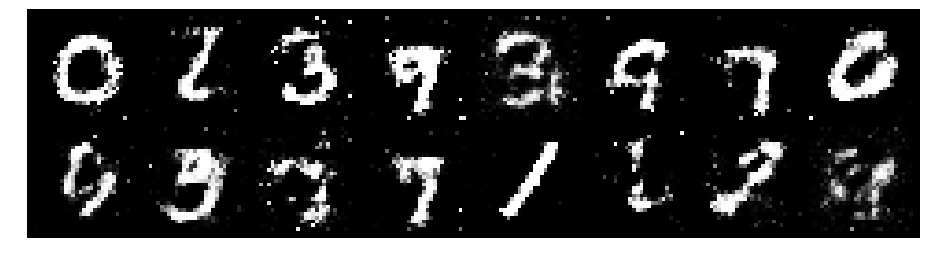

Epoch: [34/200], Batch Num: [100/600]
Discriminator Loss: 0.9036, Generator Loss: 1.0653
D(x): 0.7234, D(G(z)): 0.3717


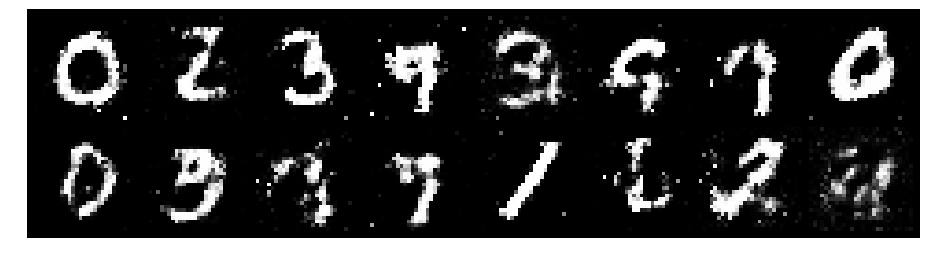

Epoch: [34/200], Batch Num: [200/600]
Discriminator Loss: 0.9138, Generator Loss: 1.3366
D(x): 0.6797, D(G(z)): 0.3191


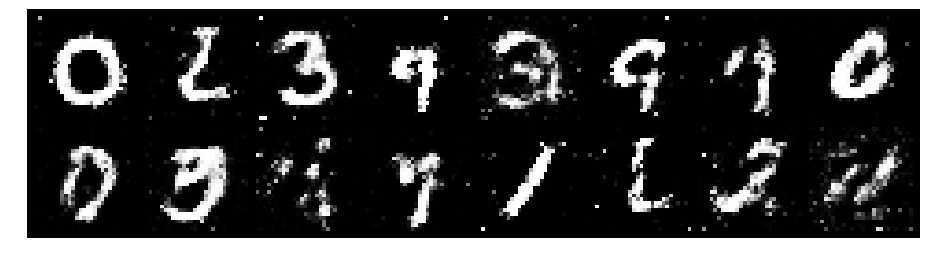

Epoch: [34/200], Batch Num: [300/600]
Discriminator Loss: 1.2113, Generator Loss: 1.2035
D(x): 0.5462, D(G(z)): 0.3501


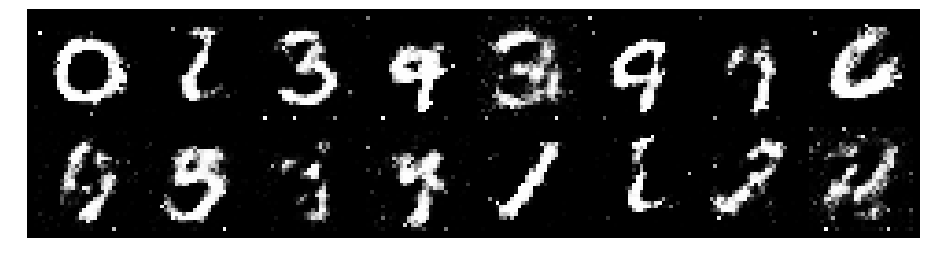

Epoch: [34/200], Batch Num: [400/600]
Discriminator Loss: 0.9845, Generator Loss: 1.1642
D(x): 0.6850, D(G(z)): 0.3685


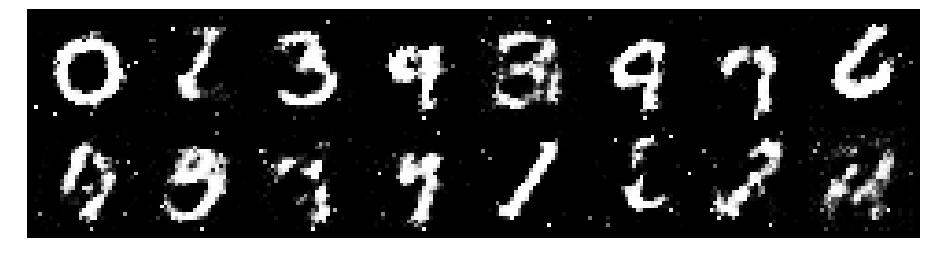

Epoch: [34/200], Batch Num: [500/600]
Discriminator Loss: 0.9864, Generator Loss: 1.2909
D(x): 0.7126, D(G(z)): 0.4013


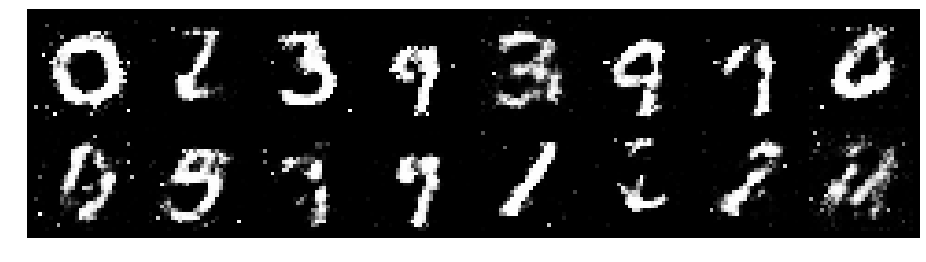

Epoch: [35/200], Batch Num: [0/600]
Discriminator Loss: 1.2582, Generator Loss: 0.9925
D(x): 0.6508, D(G(z)): 0.4576


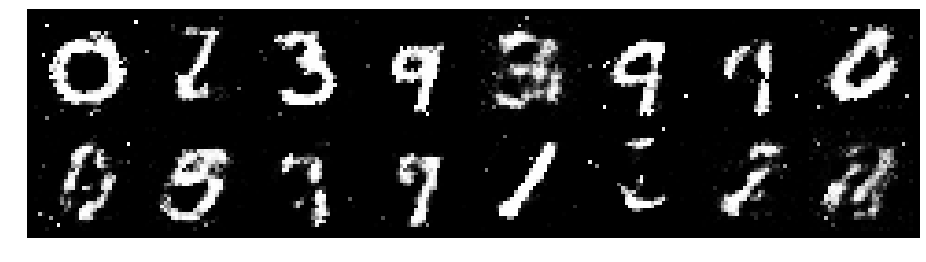

Epoch: [35/200], Batch Num: [100/600]
Discriminator Loss: 1.2942, Generator Loss: 1.0781
D(x): 0.5412, D(G(z)): 0.3727


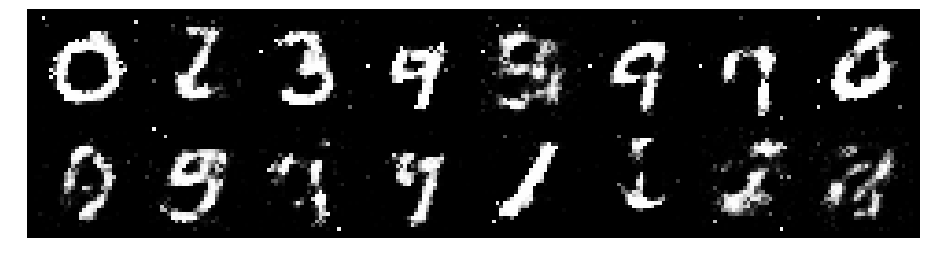

Epoch: [35/200], Batch Num: [200/600]
Discriminator Loss: 1.2158, Generator Loss: 1.0139
D(x): 0.5516, D(G(z)): 0.3542


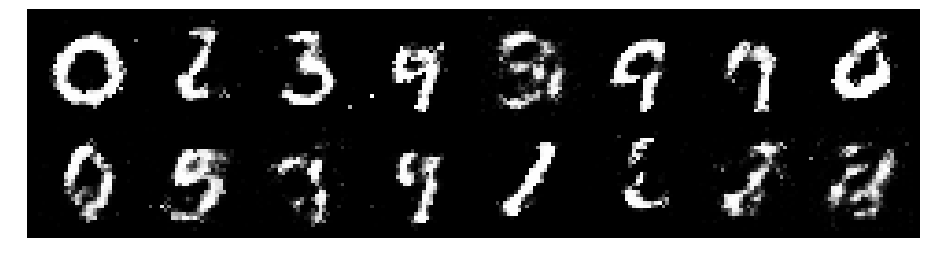

Epoch: [35/200], Batch Num: [300/600]
Discriminator Loss: 1.3321, Generator Loss: 1.2464
D(x): 0.5930, D(G(z)): 0.4301


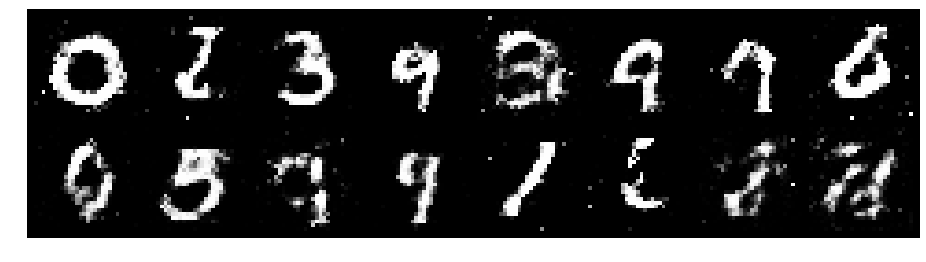

Epoch: [35/200], Batch Num: [400/600]
Discriminator Loss: 1.2286, Generator Loss: 1.0400
D(x): 0.6181, D(G(z)): 0.3734


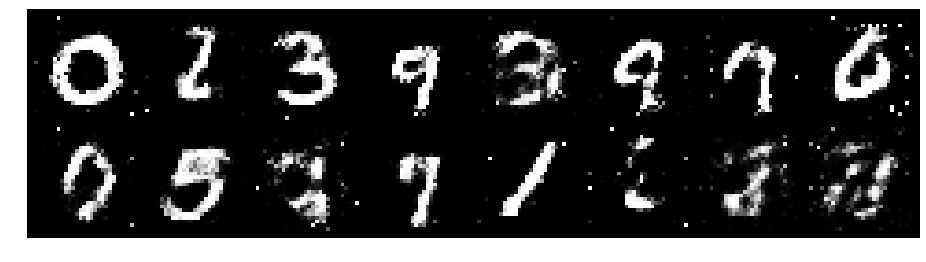

Epoch: [35/200], Batch Num: [500/600]
Discriminator Loss: 1.3177, Generator Loss: 1.1058
D(x): 0.6980, D(G(z)): 0.4961


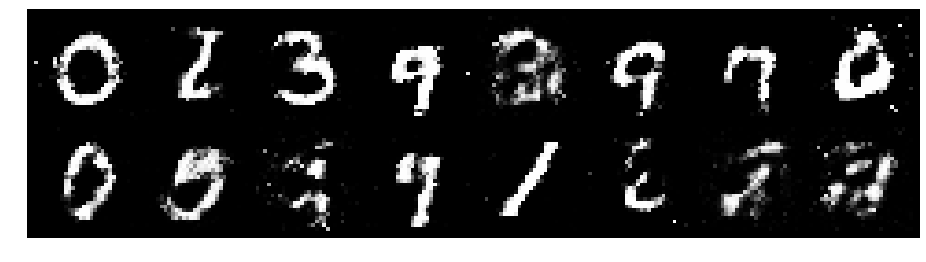

Epoch: [36/200], Batch Num: [0/600]
Discriminator Loss: 1.1673, Generator Loss: 1.5359
D(x): 0.5766, D(G(z)): 0.3487


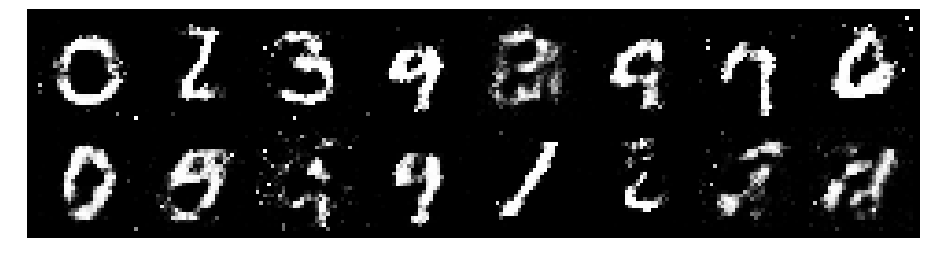

Epoch: [36/200], Batch Num: [100/600]
Discriminator Loss: 0.9976, Generator Loss: 1.1915
D(x): 0.6805, D(G(z)): 0.3731


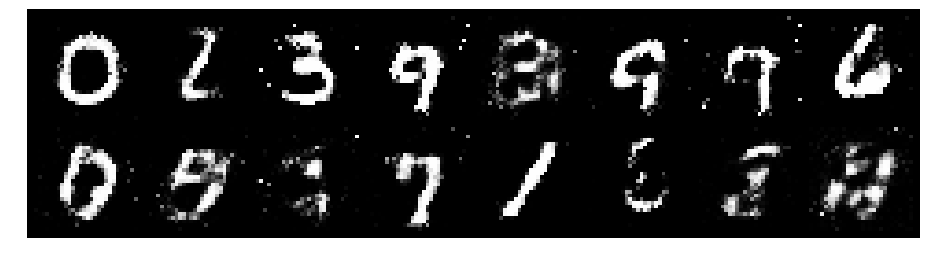

Epoch: [36/200], Batch Num: [200/600]
Discriminator Loss: 1.1846, Generator Loss: 1.0619
D(x): 0.6051, D(G(z)): 0.3817


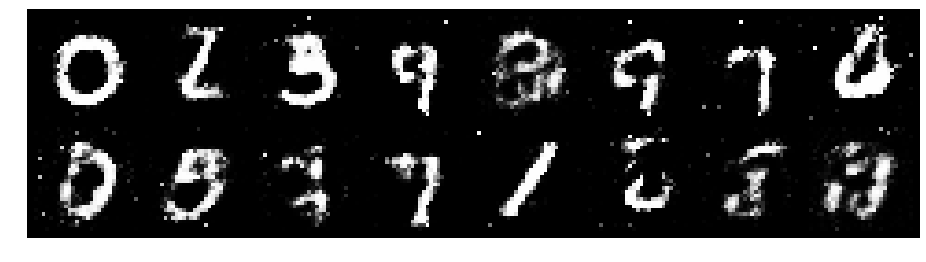

Epoch: [36/200], Batch Num: [300/600]
Discriminator Loss: 1.1719, Generator Loss: 1.2753
D(x): 0.5894, D(G(z)): 0.3777


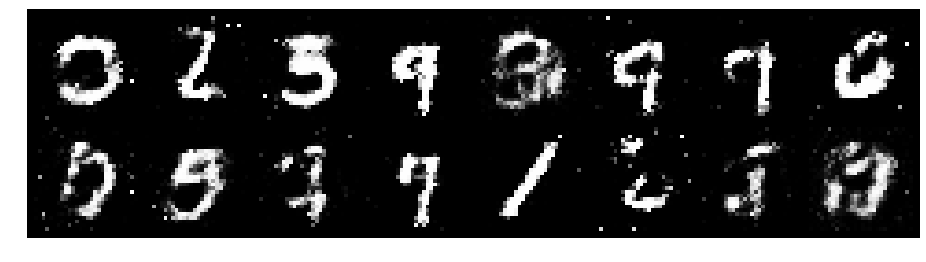

Epoch: [36/200], Batch Num: [400/600]
Discriminator Loss: 0.9760, Generator Loss: 1.2740
D(x): 0.6614, D(G(z)): 0.3518


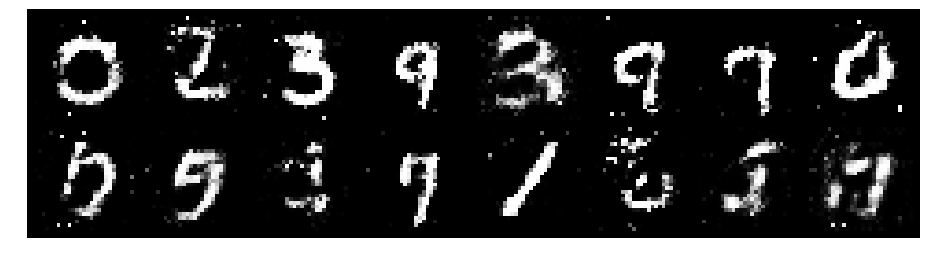

Epoch: [36/200], Batch Num: [500/600]
Discriminator Loss: 1.0409, Generator Loss: 1.3056
D(x): 0.6954, D(G(z)): 0.3989


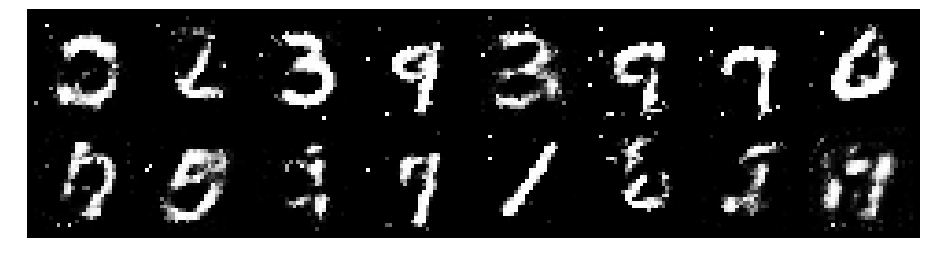

Epoch: [37/200], Batch Num: [0/600]
Discriminator Loss: 1.0842, Generator Loss: 1.0515
D(x): 0.6266, D(G(z)): 0.3527


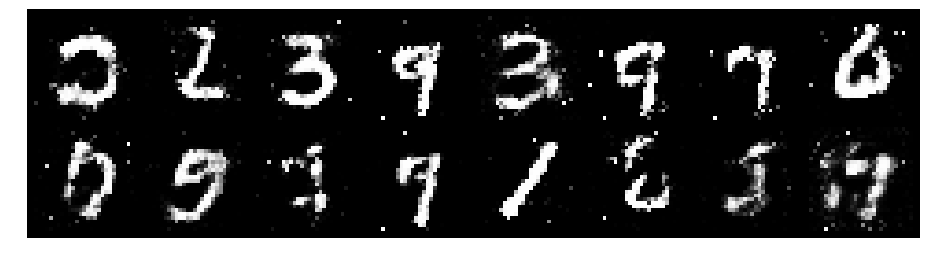

Epoch: [37/200], Batch Num: [100/600]
Discriminator Loss: 1.0383, Generator Loss: 1.1925
D(x): 0.6505, D(G(z)): 0.3500


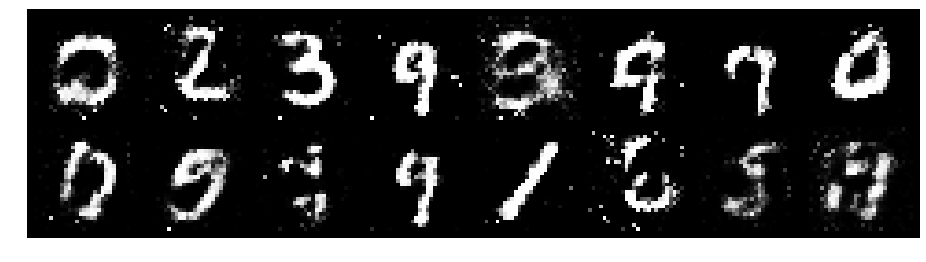

Epoch: [37/200], Batch Num: [200/600]
Discriminator Loss: 0.9396, Generator Loss: 1.3852
D(x): 0.6959, D(G(z)): 0.3431


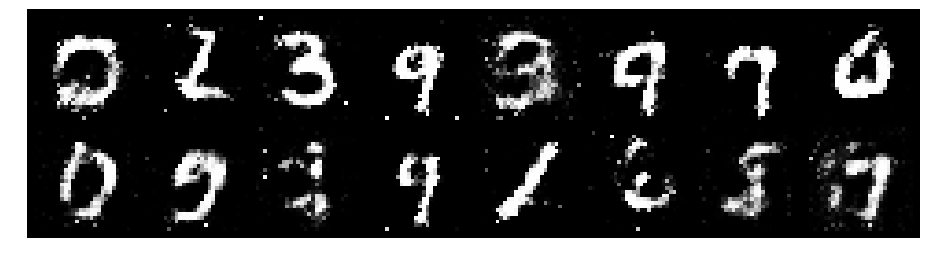

Epoch: [37/200], Batch Num: [300/600]
Discriminator Loss: 1.0991, Generator Loss: 0.9814
D(x): 0.7439, D(G(z)): 0.4588


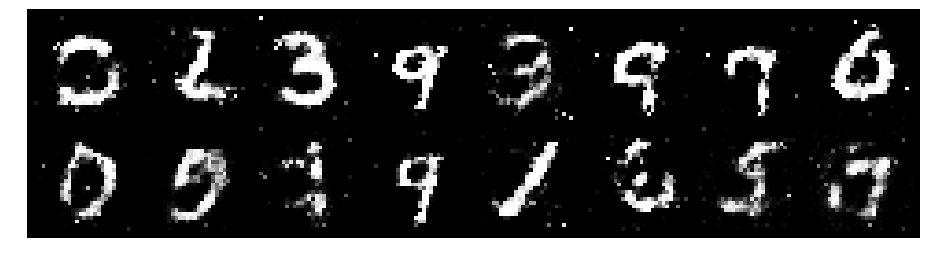

Epoch: [37/200], Batch Num: [400/600]
Discriminator Loss: 0.9090, Generator Loss: 1.4028
D(x): 0.7003, D(G(z)): 0.3321


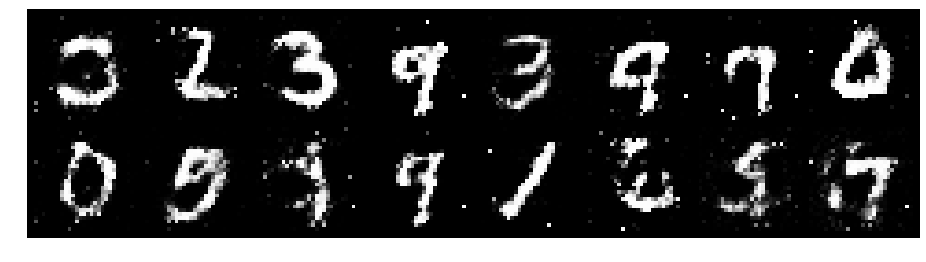

Epoch: [37/200], Batch Num: [500/600]
Discriminator Loss: 1.1800, Generator Loss: 1.3276
D(x): 0.5652, D(G(z)): 0.3387


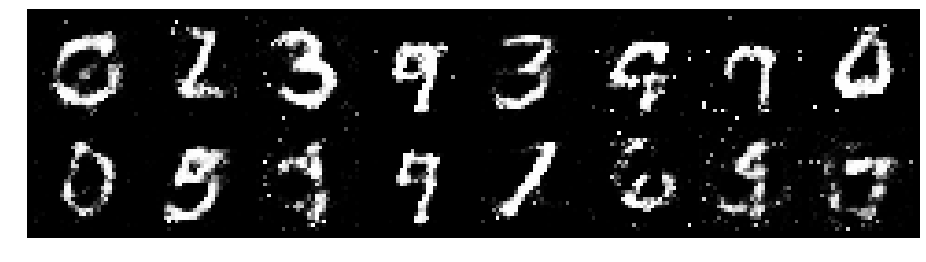

Epoch: [38/200], Batch Num: [0/600]
Discriminator Loss: 1.0434, Generator Loss: 1.2014
D(x): 0.6995, D(G(z)): 0.3769


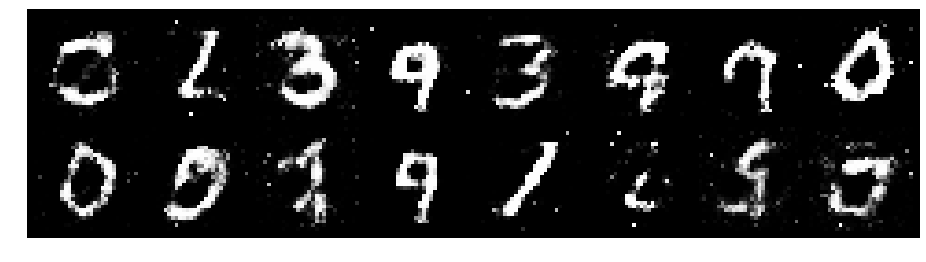

Epoch: [38/200], Batch Num: [100/600]
Discriminator Loss: 1.1532, Generator Loss: 1.6016
D(x): 0.7187, D(G(z)): 0.4382


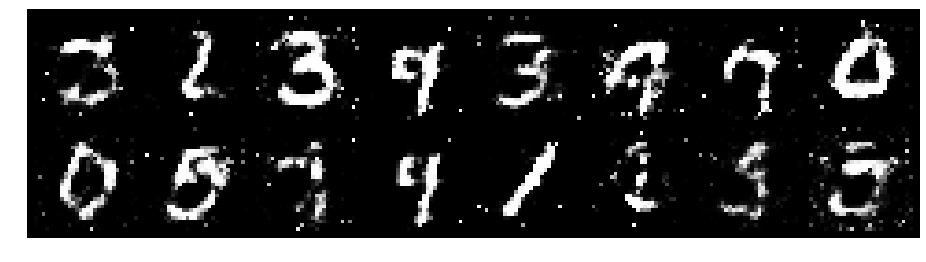

Epoch: [38/200], Batch Num: [200/600]
Discriminator Loss: 1.2502, Generator Loss: 1.0213
D(x): 0.5925, D(G(z)): 0.4322


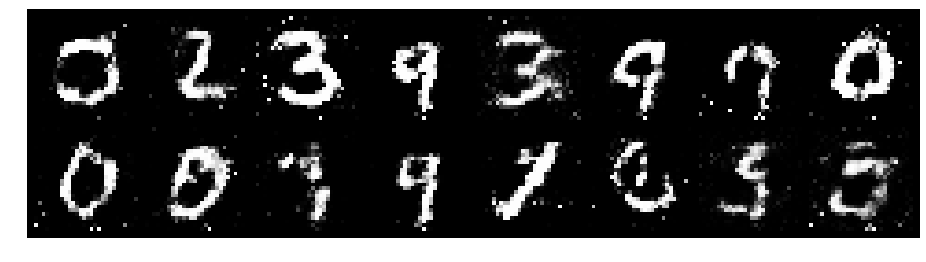

Epoch: [38/200], Batch Num: [300/600]
Discriminator Loss: 1.2920, Generator Loss: 1.2284
D(x): 0.5879, D(G(z)): 0.4206


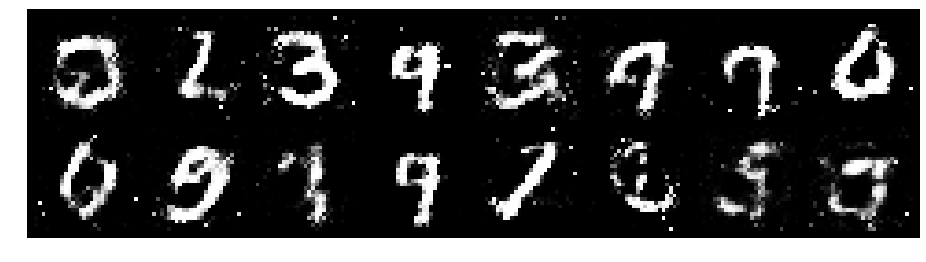

Epoch: [38/200], Batch Num: [400/600]
Discriminator Loss: 1.1809, Generator Loss: 1.2491
D(x): 0.5248, D(G(z)): 0.3196


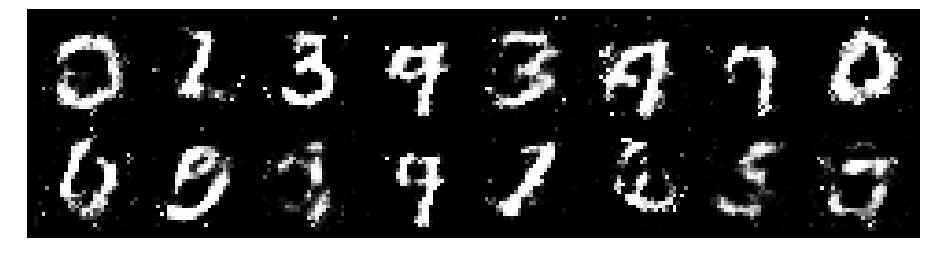

Epoch: [38/200], Batch Num: [500/600]
Discriminator Loss: 1.0840, Generator Loss: 1.2140
D(x): 0.5889, D(G(z)): 0.3637


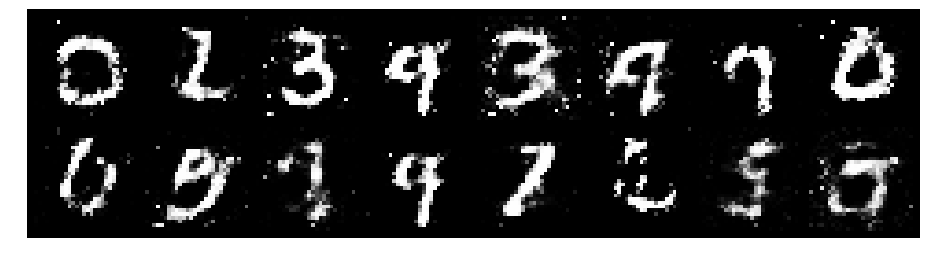

Epoch: [39/200], Batch Num: [0/600]
Discriminator Loss: 1.1253, Generator Loss: 1.0447
D(x): 0.6294, D(G(z)): 0.4220


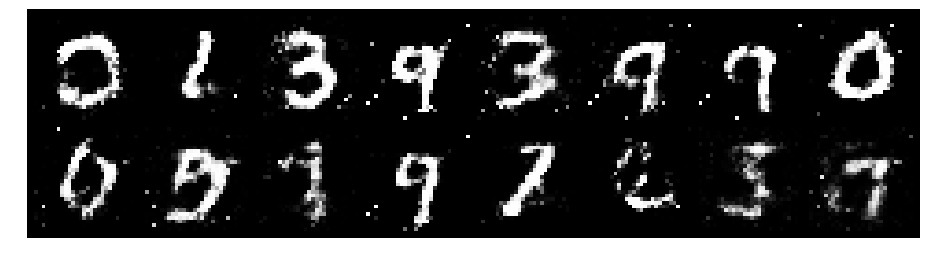

Epoch: [39/200], Batch Num: [100/600]
Discriminator Loss: 0.9418, Generator Loss: 1.4058
D(x): 0.6579, D(G(z)): 0.3148


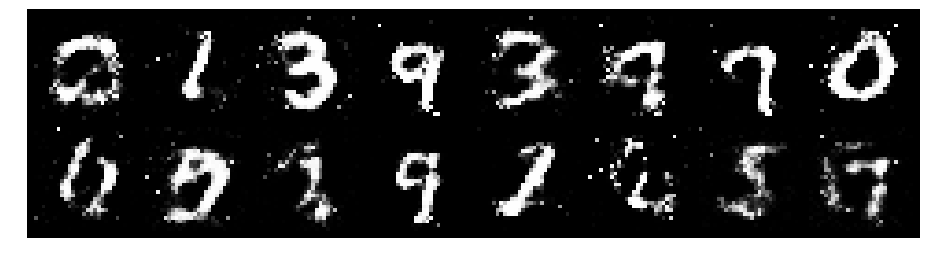

Epoch: [39/200], Batch Num: [200/600]
Discriminator Loss: 1.0279, Generator Loss: 1.2666
D(x): 0.6621, D(G(z)): 0.3412


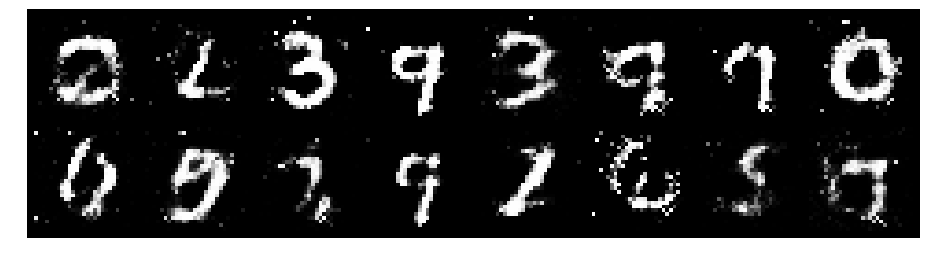

Epoch: [39/200], Batch Num: [300/600]
Discriminator Loss: 1.1847, Generator Loss: 1.2143
D(x): 0.5961, D(G(z)): 0.3583


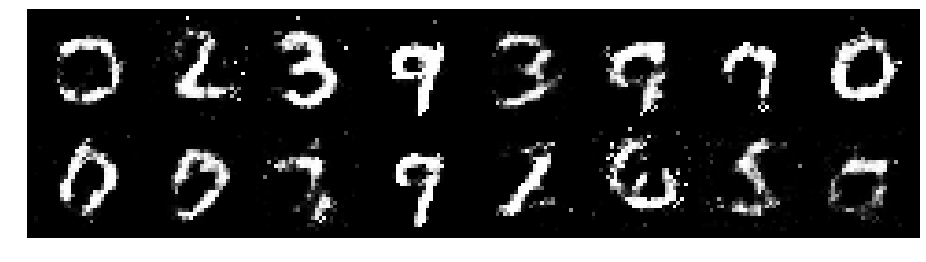

Epoch: [39/200], Batch Num: [400/600]
Discriminator Loss: 1.0152, Generator Loss: 1.2184
D(x): 0.5993, D(G(z)): 0.3169


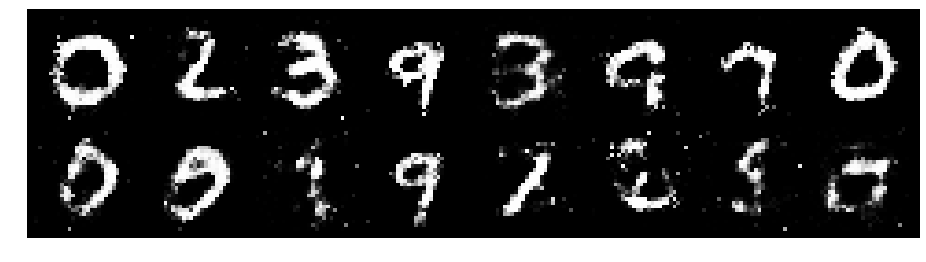

Epoch: [39/200], Batch Num: [500/600]
Discriminator Loss: 1.1518, Generator Loss: 1.0229
D(x): 0.6865, D(G(z)): 0.4346


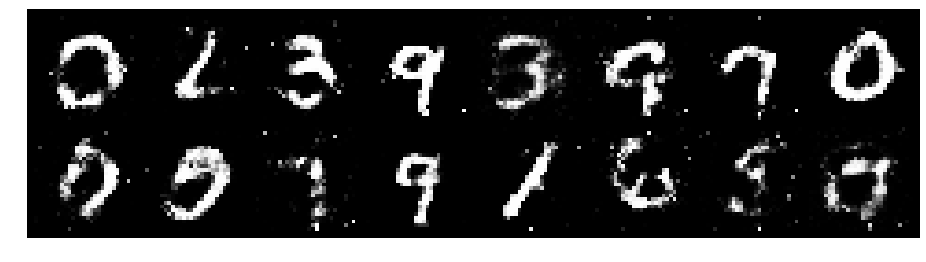

Epoch: [40/200], Batch Num: [0/600]
Discriminator Loss: 1.1970, Generator Loss: 1.3775
D(x): 0.6466, D(G(z)): 0.4041


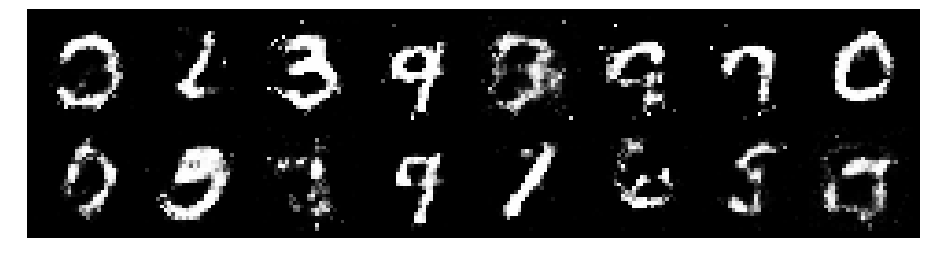

Epoch: [40/200], Batch Num: [100/600]
Discriminator Loss: 1.2081, Generator Loss: 1.5014
D(x): 0.5967, D(G(z)): 0.3615


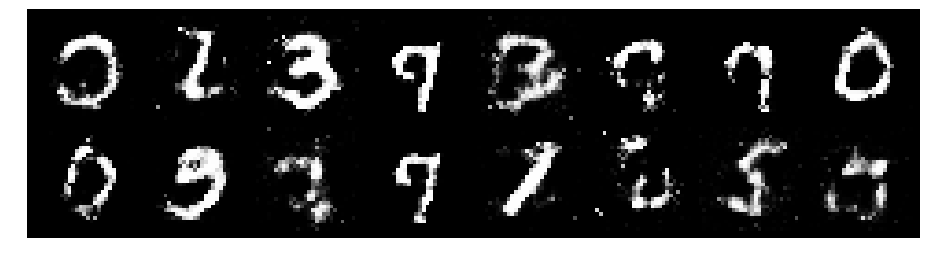

Epoch: [40/200], Batch Num: [200/600]
Discriminator Loss: 1.2428, Generator Loss: 1.0509
D(x): 0.6011, D(G(z)): 0.4320


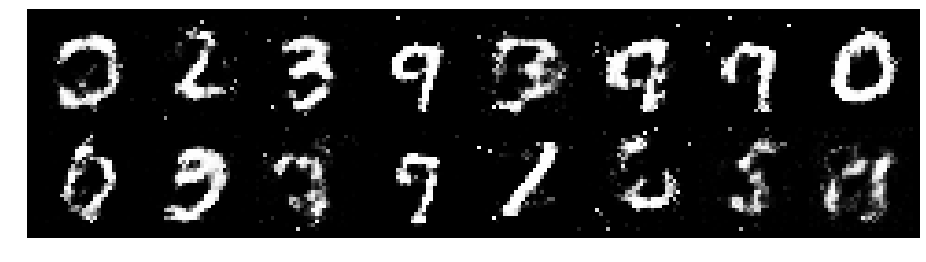

Epoch: [40/200], Batch Num: [300/600]
Discriminator Loss: 1.1905, Generator Loss: 1.0322
D(x): 0.5549, D(G(z)): 0.3853


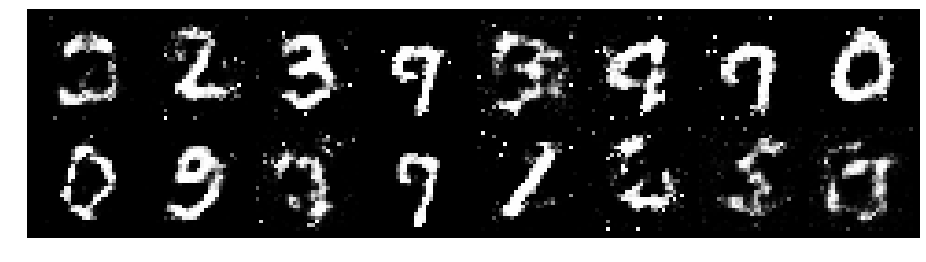

Epoch: [40/200], Batch Num: [400/600]
Discriminator Loss: 0.9600, Generator Loss: 1.3078
D(x): 0.6584, D(G(z)): 0.3534


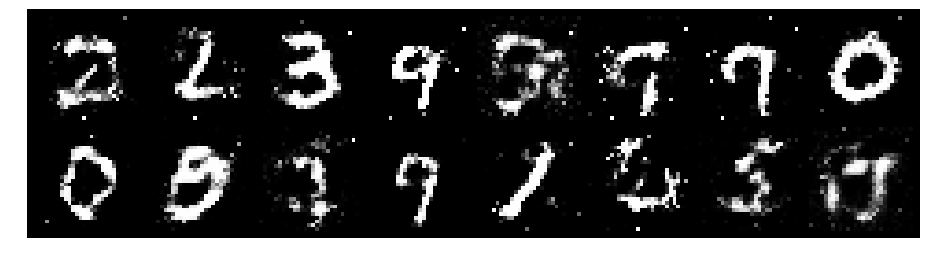

Epoch: [40/200], Batch Num: [500/600]
Discriminator Loss: 0.9811, Generator Loss: 1.2081
D(x): 0.6529, D(G(z)): 0.3461


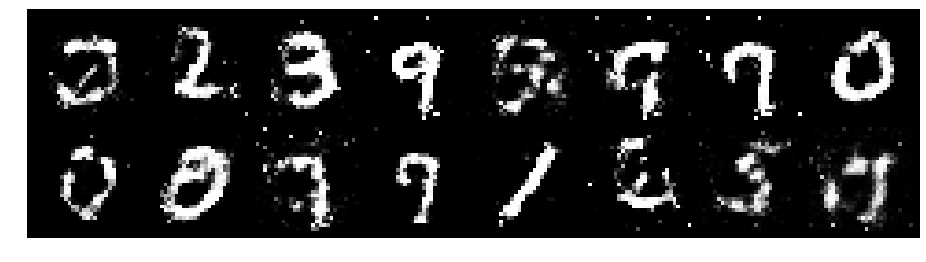

Epoch: [41/200], Batch Num: [0/600]
Discriminator Loss: 1.1967, Generator Loss: 1.2747
D(x): 0.5709, D(G(z)): 0.3451


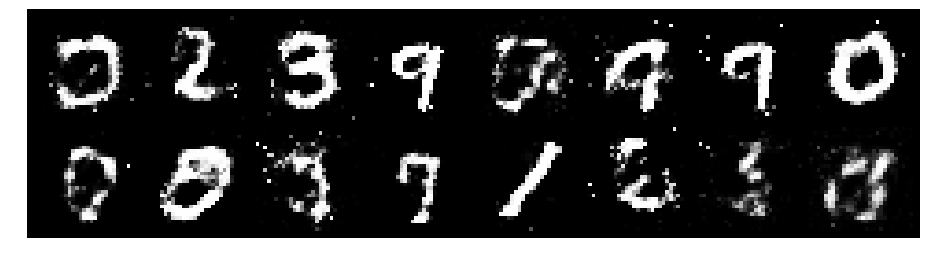

Epoch: [41/200], Batch Num: [100/600]
Discriminator Loss: 1.1399, Generator Loss: 1.2790
D(x): 0.6119, D(G(z)): 0.3854


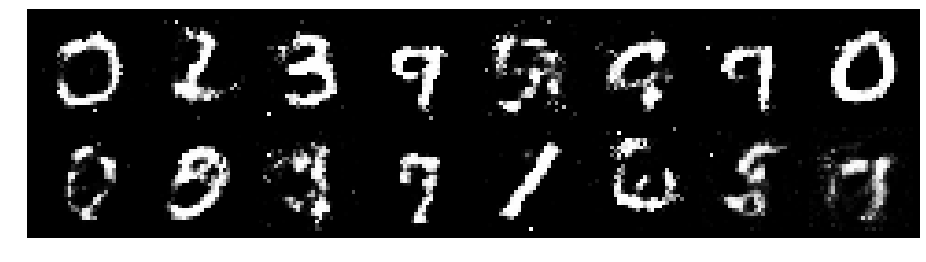

Epoch: [41/200], Batch Num: [200/600]
Discriminator Loss: 0.9583, Generator Loss: 1.3157
D(x): 0.5983, D(G(z)): 0.2752


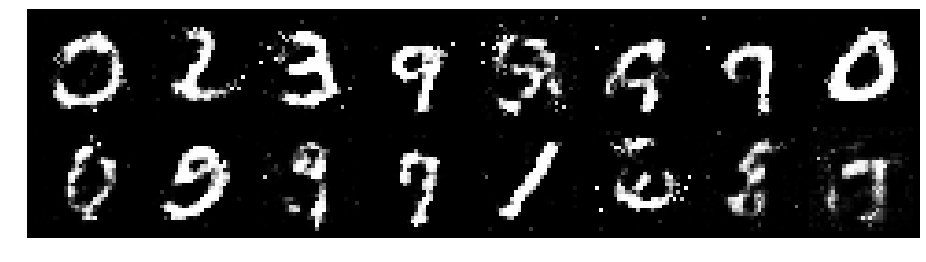

Epoch: [41/200], Batch Num: [300/600]
Discriminator Loss: 1.0934, Generator Loss: 1.3928
D(x): 0.6269, D(G(z)): 0.3580


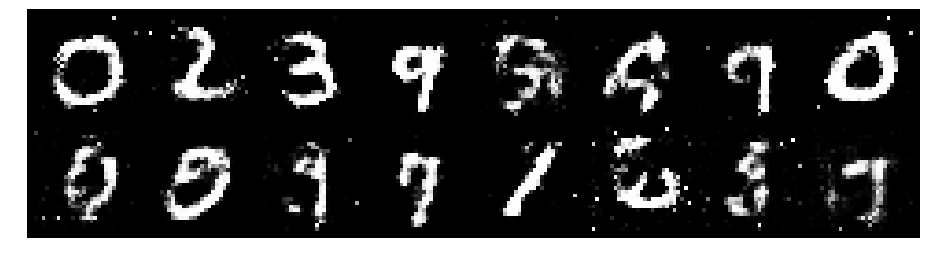

Epoch: [41/200], Batch Num: [400/600]
Discriminator Loss: 1.0224, Generator Loss: 1.1258
D(x): 0.6841, D(G(z)): 0.3993


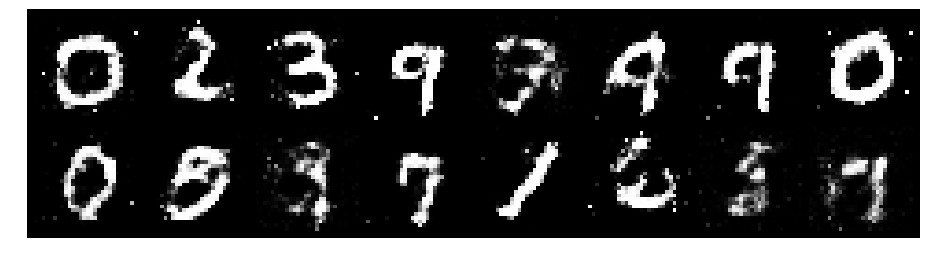

Epoch: [41/200], Batch Num: [500/600]
Discriminator Loss: 1.1098, Generator Loss: 1.2976
D(x): 0.6070, D(G(z)): 0.3658


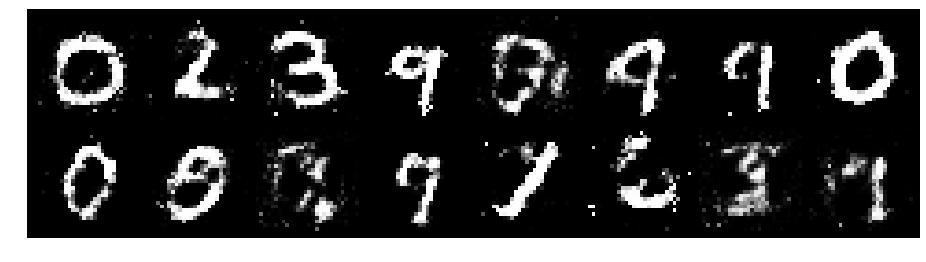

Epoch: [42/200], Batch Num: [0/600]
Discriminator Loss: 1.1066, Generator Loss: 1.0605
D(x): 0.6441, D(G(z)): 0.4059


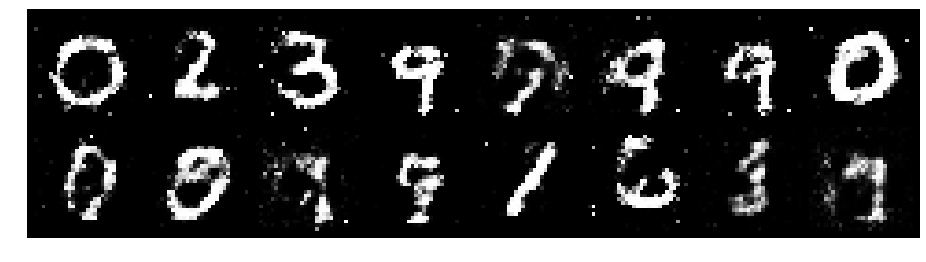

Epoch: [42/200], Batch Num: [100/600]
Discriminator Loss: 1.0098, Generator Loss: 1.2290
D(x): 0.6467, D(G(z)): 0.3634


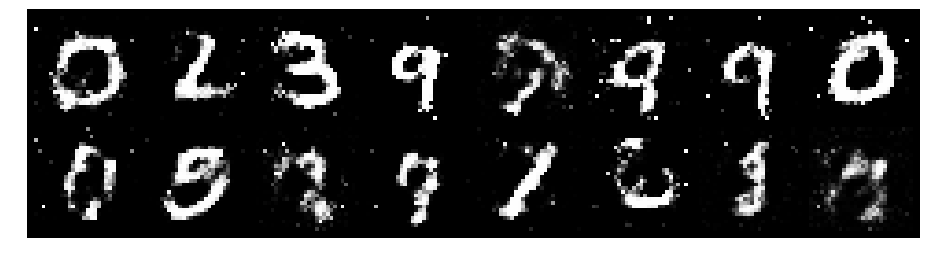

Epoch: [42/200], Batch Num: [200/600]
Discriminator Loss: 1.1352, Generator Loss: 1.1751
D(x): 0.6177, D(G(z)): 0.3740


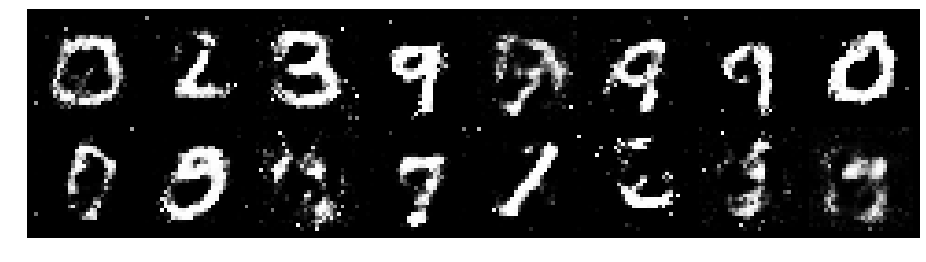

Epoch: [42/200], Batch Num: [300/600]
Discriminator Loss: 1.0232, Generator Loss: 1.1771
D(x): 0.6795, D(G(z)): 0.3926


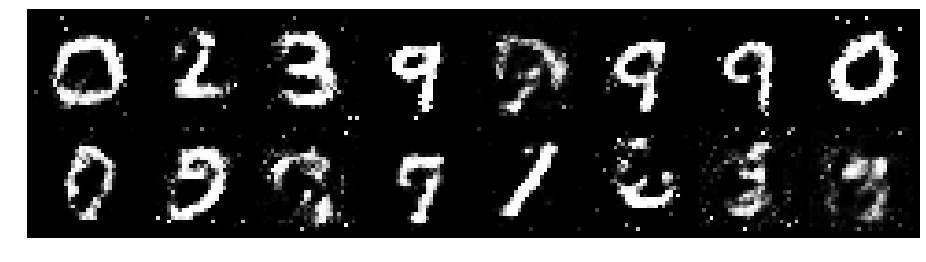

Epoch: [42/200], Batch Num: [400/600]
Discriminator Loss: 1.0360, Generator Loss: 1.2208
D(x): 0.6341, D(G(z)): 0.3509


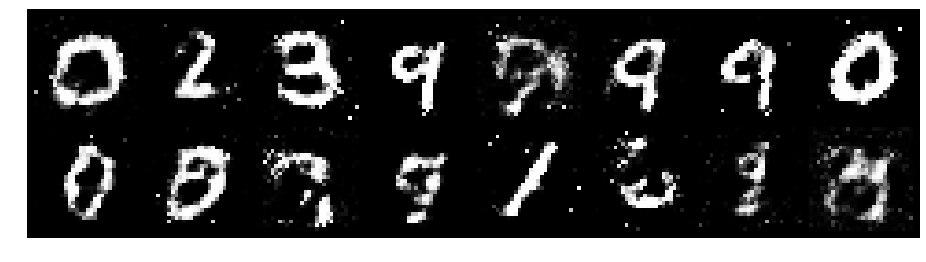

Epoch: [42/200], Batch Num: [500/600]
Discriminator Loss: 0.9794, Generator Loss: 1.2934
D(x): 0.6299, D(G(z)): 0.3134


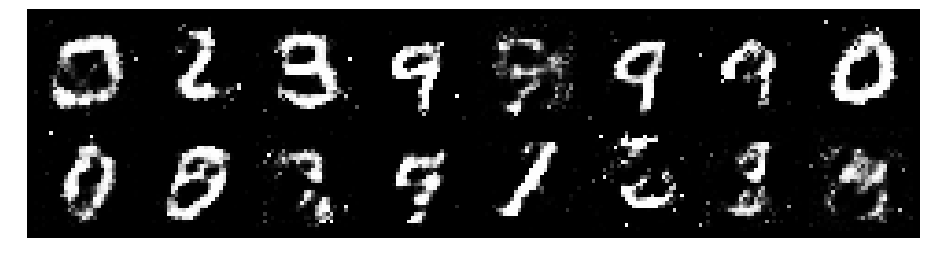

Epoch: [43/200], Batch Num: [0/600]
Discriminator Loss: 1.2249, Generator Loss: 1.0820
D(x): 0.5943, D(G(z)): 0.4047


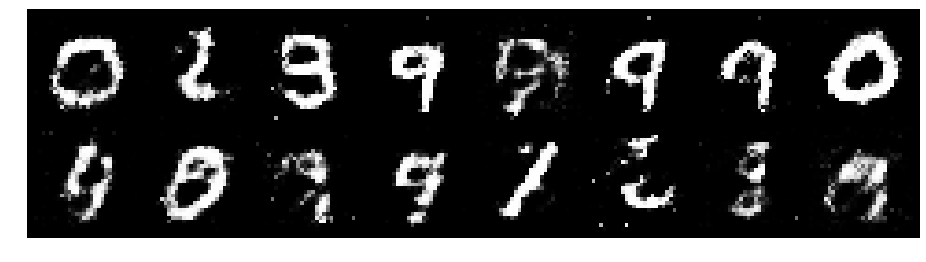

Epoch: [43/200], Batch Num: [100/600]
Discriminator Loss: 1.3613, Generator Loss: 1.0487
D(x): 0.6083, D(G(z)): 0.4623


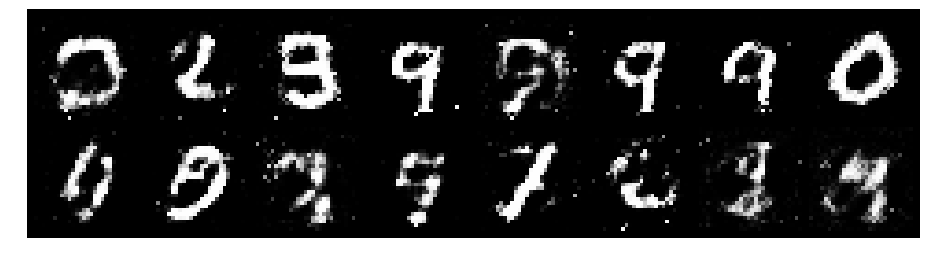

Epoch: [43/200], Batch Num: [200/600]
Discriminator Loss: 1.1072, Generator Loss: 1.2539
D(x): 0.6641, D(G(z)): 0.3776


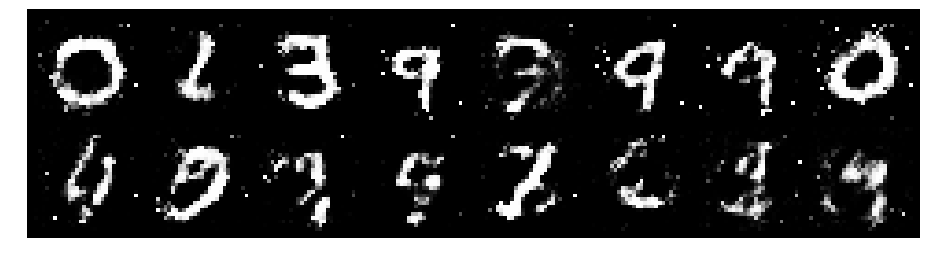

Epoch: [43/200], Batch Num: [300/600]
Discriminator Loss: 1.1650, Generator Loss: 1.2358
D(x): 0.6348, D(G(z)): 0.3974


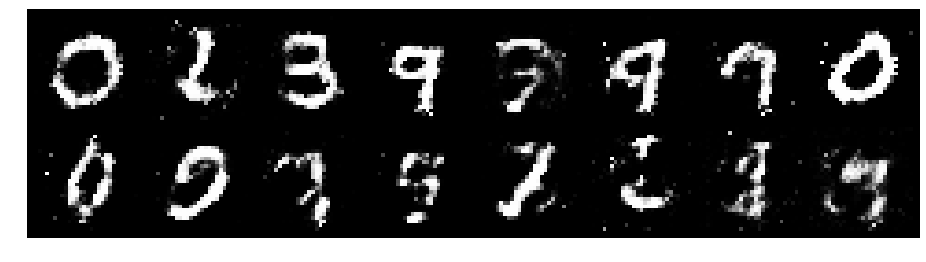

Epoch: [43/200], Batch Num: [400/600]
Discriminator Loss: 1.2863, Generator Loss: 1.0163
D(x): 0.6214, D(G(z)): 0.4504


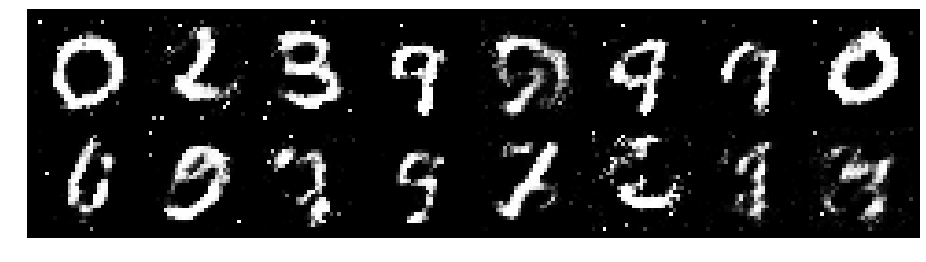

Epoch: [43/200], Batch Num: [500/600]
Discriminator Loss: 1.2504, Generator Loss: 1.0987
D(x): 0.5799, D(G(z)): 0.4200


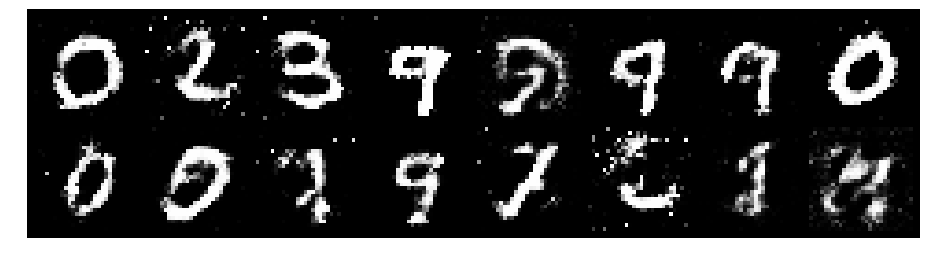

Epoch: [44/200], Batch Num: [0/600]
Discriminator Loss: 1.2777, Generator Loss: 1.0962
D(x): 0.5491, D(G(z)): 0.4073


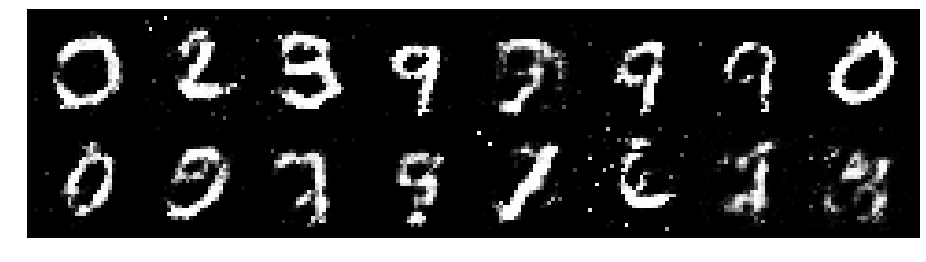

Epoch: [44/200], Batch Num: [100/600]
Discriminator Loss: 1.0883, Generator Loss: 1.0624
D(x): 0.6432, D(G(z)): 0.4171


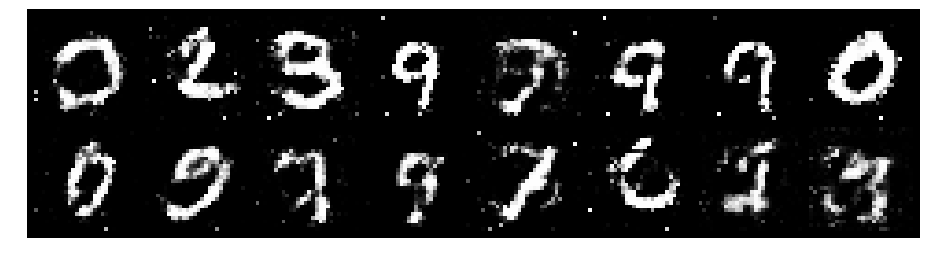

Epoch: [44/200], Batch Num: [200/600]
Discriminator Loss: 1.0427, Generator Loss: 1.3253
D(x): 0.6249, D(G(z)): 0.3468


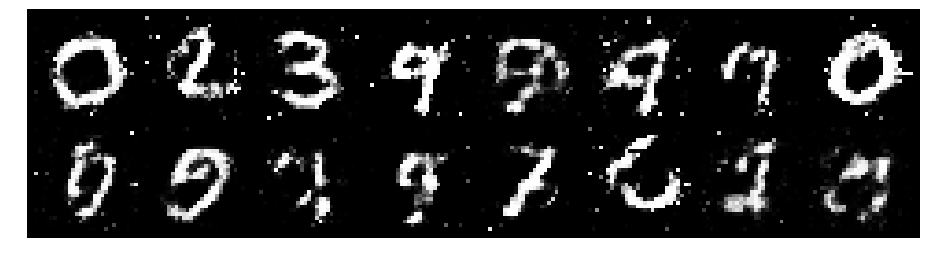

Epoch: [44/200], Batch Num: [300/600]
Discriminator Loss: 1.2761, Generator Loss: 1.0911
D(x): 0.6115, D(G(z)): 0.4256


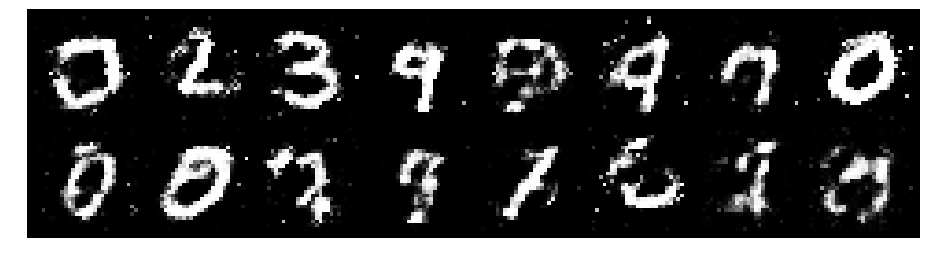

Epoch: [44/200], Batch Num: [400/600]
Discriminator Loss: 1.1052, Generator Loss: 0.9504
D(x): 0.6190, D(G(z)): 0.3861


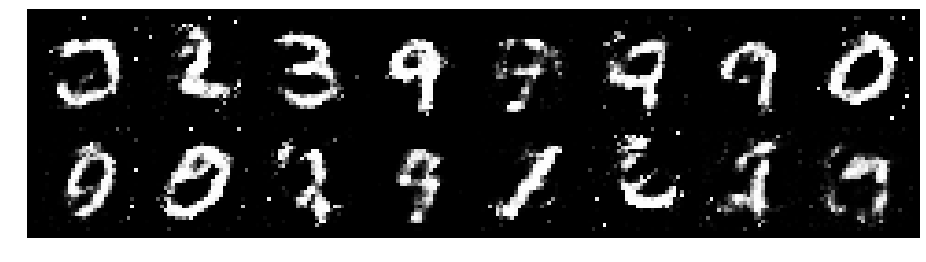

Epoch: [44/200], Batch Num: [500/600]
Discriminator Loss: 1.1762, Generator Loss: 1.1379
D(x): 0.5940, D(G(z)): 0.3855


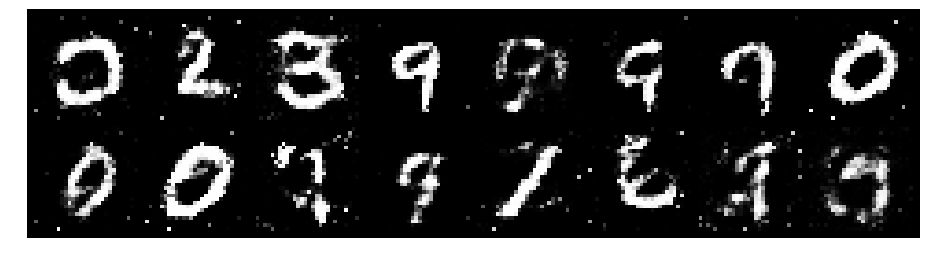

Epoch: [45/200], Batch Num: [0/600]
Discriminator Loss: 1.2481, Generator Loss: 1.1968
D(x): 0.5861, D(G(z)): 0.4168


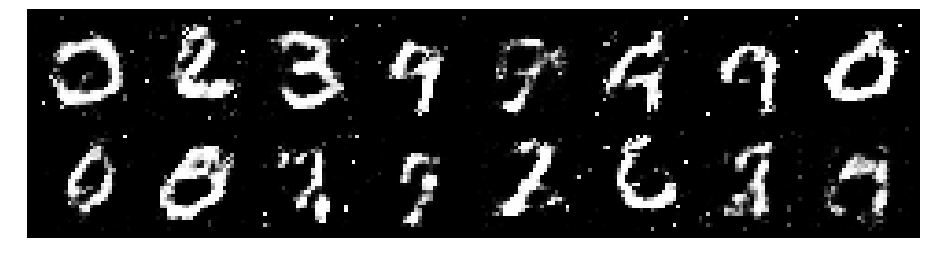

Epoch: [45/200], Batch Num: [100/600]
Discriminator Loss: 1.0381, Generator Loss: 1.4837
D(x): 0.6156, D(G(z)): 0.2968


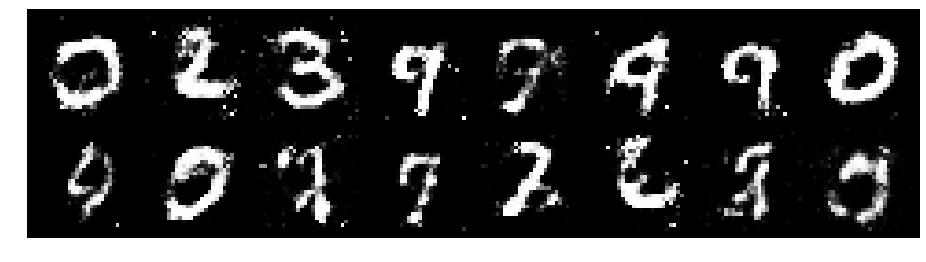

Epoch: [45/200], Batch Num: [200/600]
Discriminator Loss: 1.1987, Generator Loss: 1.4787
D(x): 0.5816, D(G(z)): 0.3368


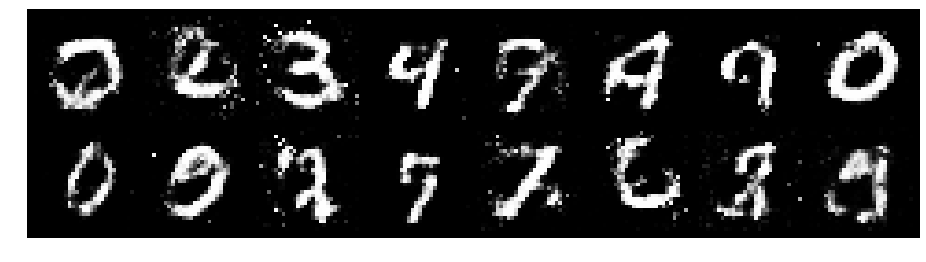

Epoch: [45/200], Batch Num: [300/600]
Discriminator Loss: 1.0873, Generator Loss: 1.2486
D(x): 0.6734, D(G(z)): 0.3823


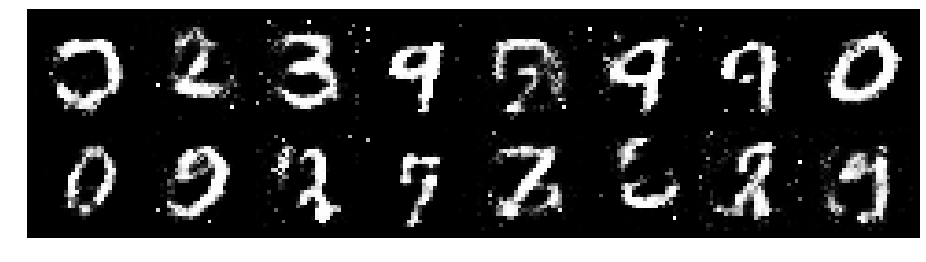

Epoch: [45/200], Batch Num: [400/600]
Discriminator Loss: 1.1303, Generator Loss: 1.5476
D(x): 0.6236, D(G(z)): 0.3682


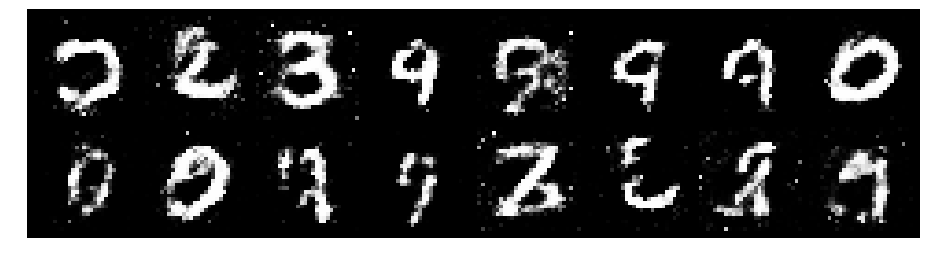

Epoch: [45/200], Batch Num: [500/600]
Discriminator Loss: 0.9604, Generator Loss: 1.6237
D(x): 0.6873, D(G(z)): 0.3353


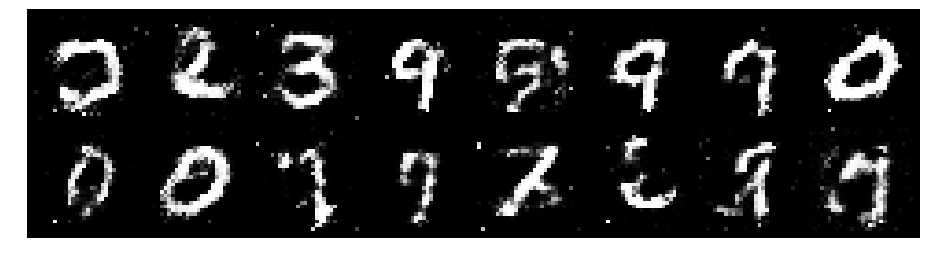

Epoch: [46/200], Batch Num: [0/600]
Discriminator Loss: 1.2643, Generator Loss: 1.6428
D(x): 0.5693, D(G(z)): 0.3330


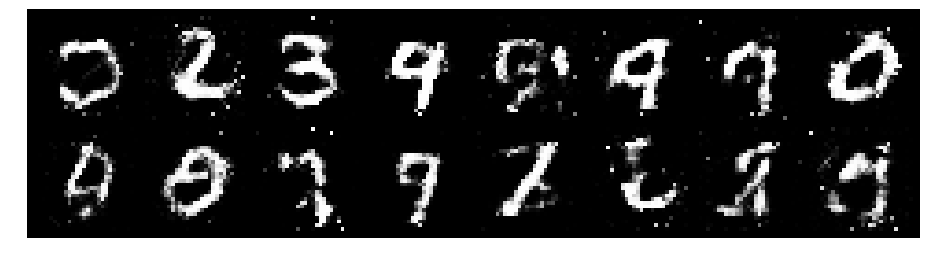

Epoch: [46/200], Batch Num: [100/600]
Discriminator Loss: 0.9317, Generator Loss: 1.3271
D(x): 0.6344, D(G(z)): 0.3086


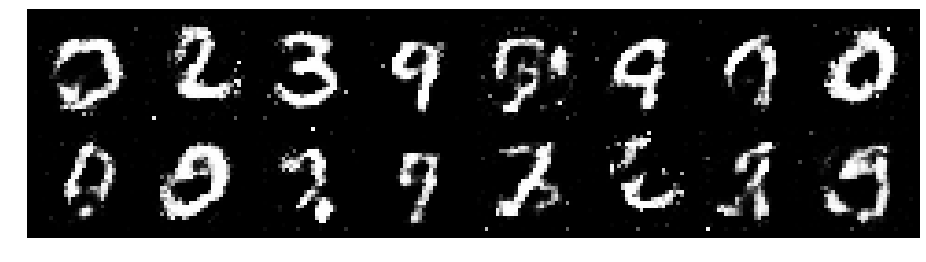

Epoch: [46/200], Batch Num: [200/600]
Discriminator Loss: 1.0093, Generator Loss: 0.9530
D(x): 0.6460, D(G(z)): 0.3641


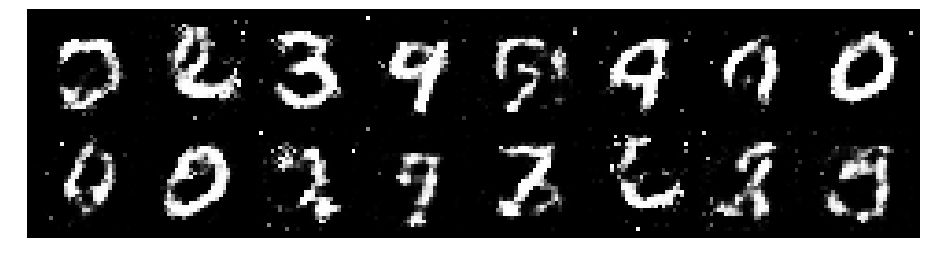

Epoch: [46/200], Batch Num: [300/600]
Discriminator Loss: 1.1175, Generator Loss: 1.1369
D(x): 0.6245, D(G(z)): 0.4020


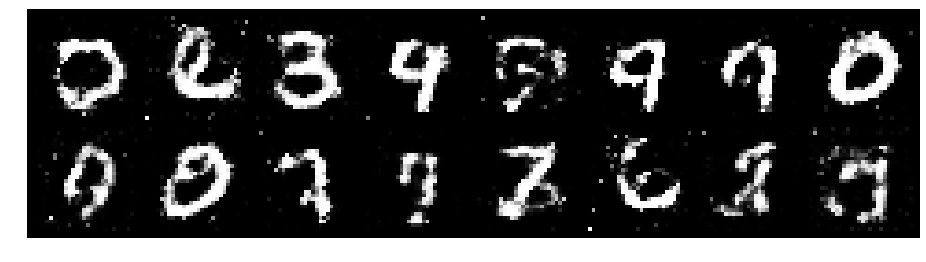

Epoch: [46/200], Batch Num: [400/600]
Discriminator Loss: 1.1545, Generator Loss: 1.3925
D(x): 0.6528, D(G(z)): 0.3959


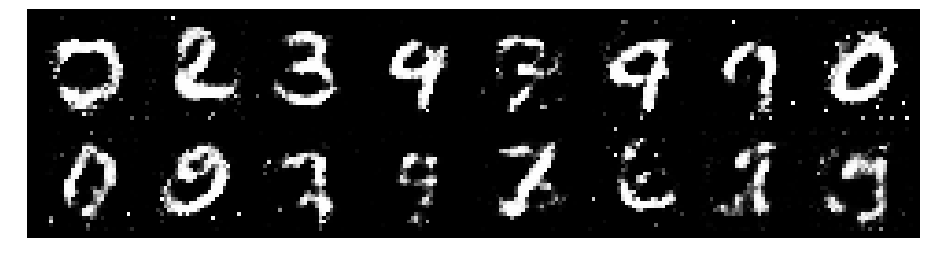

Epoch: [46/200], Batch Num: [500/600]
Discriminator Loss: 1.1020, Generator Loss: 1.2047
D(x): 0.6062, D(G(z)): 0.3571


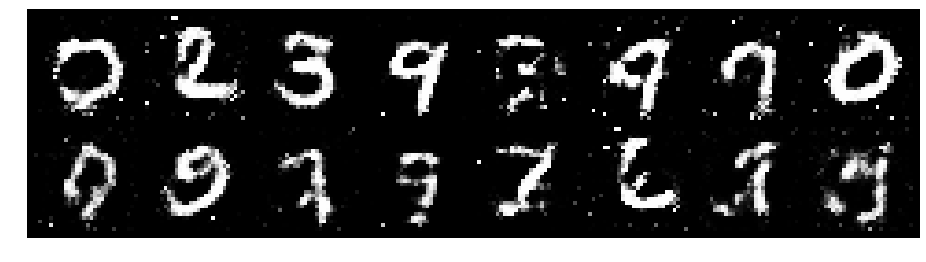

Epoch: [47/200], Batch Num: [0/600]
Discriminator Loss: 1.0780, Generator Loss: 1.1986
D(x): 0.6407, D(G(z)): 0.3953


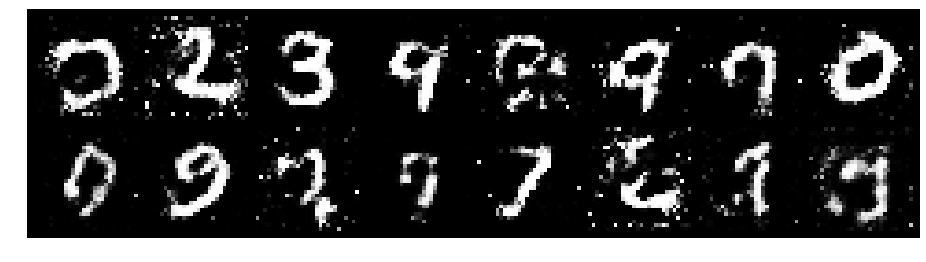

Epoch: [47/200], Batch Num: [100/600]
Discriminator Loss: 1.2619, Generator Loss: 0.9846
D(x): 0.5869, D(G(z)): 0.4546


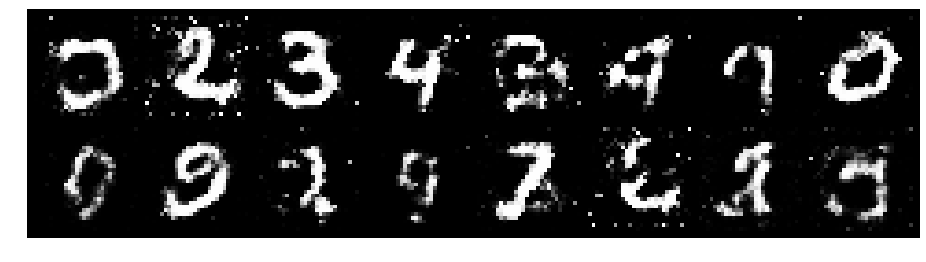

Epoch: [47/200], Batch Num: [200/600]
Discriminator Loss: 1.1679, Generator Loss: 1.1536
D(x): 0.5708, D(G(z)): 0.3758


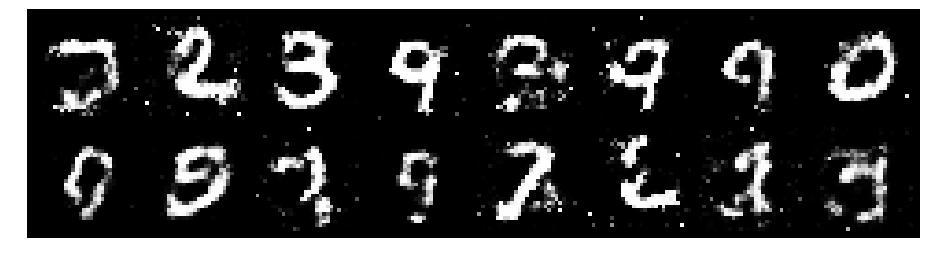

Epoch: [47/200], Batch Num: [300/600]
Discriminator Loss: 1.1281, Generator Loss: 1.2862
D(x): 0.5599, D(G(z)): 0.3526


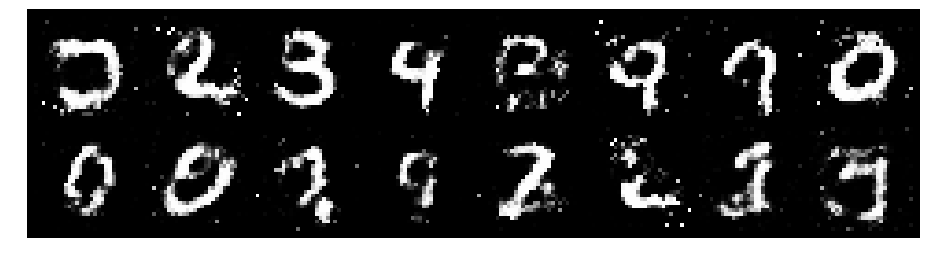

Epoch: [47/200], Batch Num: [400/600]
Discriminator Loss: 1.0905, Generator Loss: 1.1547
D(x): 0.6385, D(G(z)): 0.3999


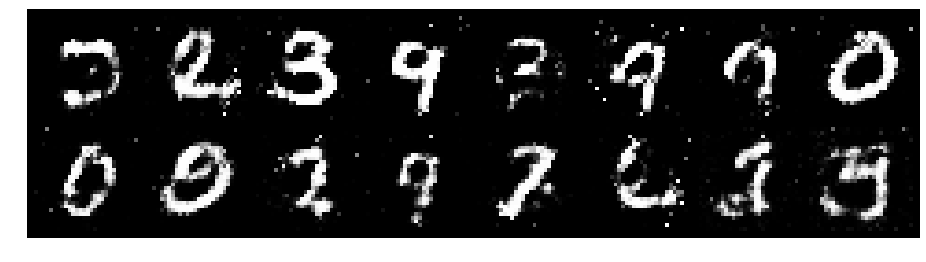

Epoch: [47/200], Batch Num: [500/600]
Discriminator Loss: 1.1919, Generator Loss: 0.9979
D(x): 0.5878, D(G(z)): 0.3950


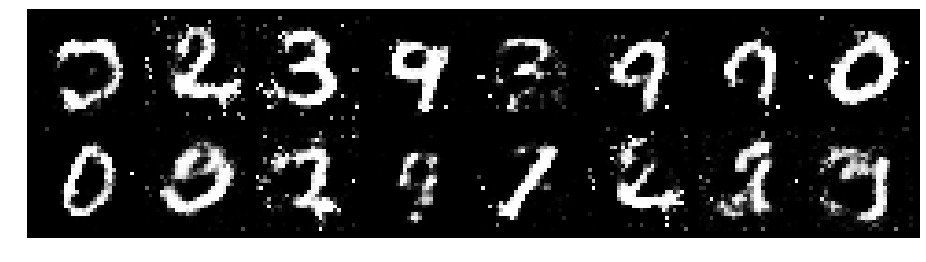

Epoch: [48/200], Batch Num: [0/600]
Discriminator Loss: 1.0615, Generator Loss: 1.1469
D(x): 0.6124, D(G(z)): 0.3606


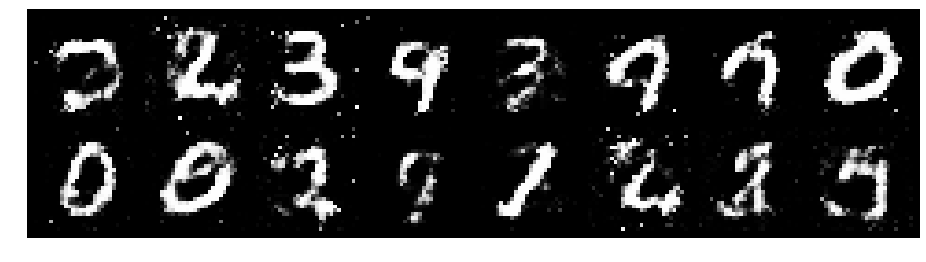

Epoch: [48/200], Batch Num: [100/600]
Discriminator Loss: 1.0539, Generator Loss: 1.1877
D(x): 0.6559, D(G(z)): 0.3564


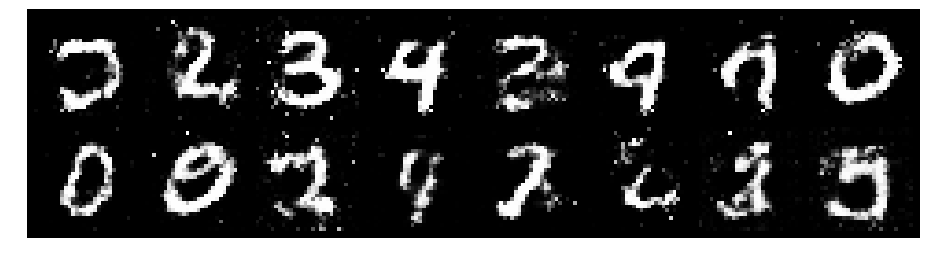

Epoch: [48/200], Batch Num: [200/600]
Discriminator Loss: 1.1479, Generator Loss: 1.1645
D(x): 0.6674, D(G(z)): 0.4253


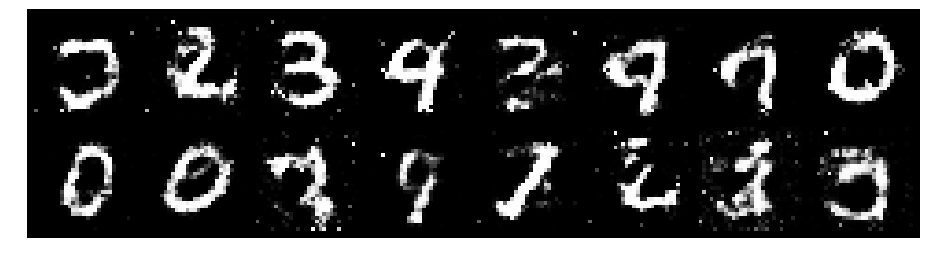

Epoch: [48/200], Batch Num: [300/600]
Discriminator Loss: 1.1876, Generator Loss: 1.1192
D(x): 0.5969, D(G(z)): 0.4158


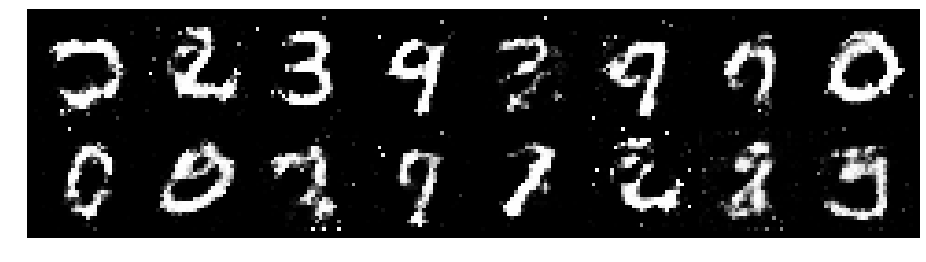

Epoch: [48/200], Batch Num: [400/600]
Discriminator Loss: 1.3399, Generator Loss: 1.0340
D(x): 0.5223, D(G(z)): 0.4013


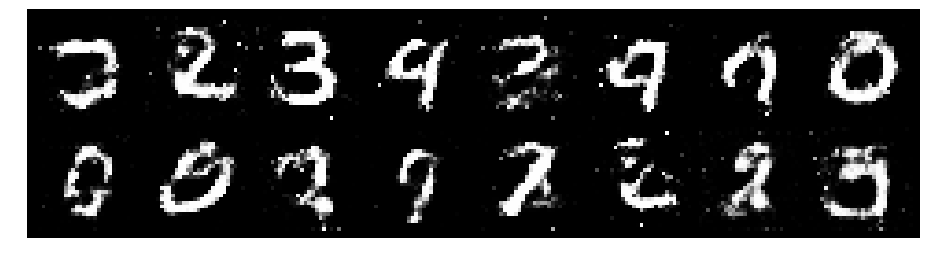

Epoch: [48/200], Batch Num: [500/600]
Discriminator Loss: 1.2967, Generator Loss: 1.0027
D(x): 0.6200, D(G(z)): 0.4663


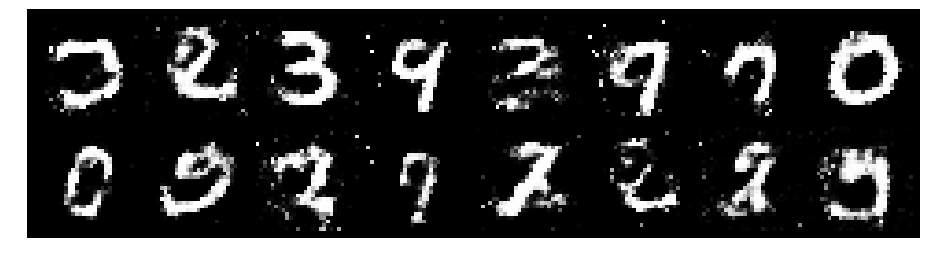

Epoch: [49/200], Batch Num: [0/600]
Discriminator Loss: 1.1275, Generator Loss: 1.0824
D(x): 0.5921, D(G(z)): 0.3657


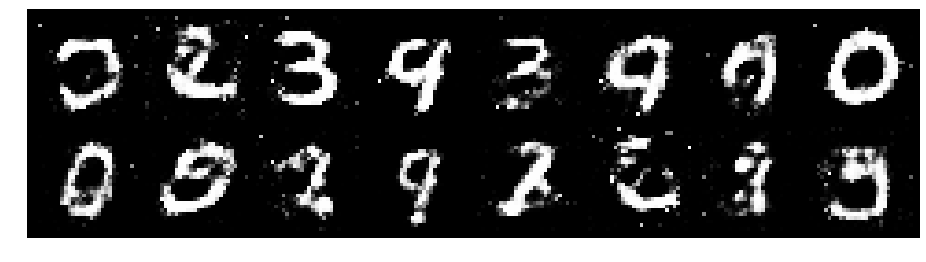

Epoch: [49/200], Batch Num: [100/600]
Discriminator Loss: 1.1179, Generator Loss: 0.9665
D(x): 0.6003, D(G(z)): 0.4058


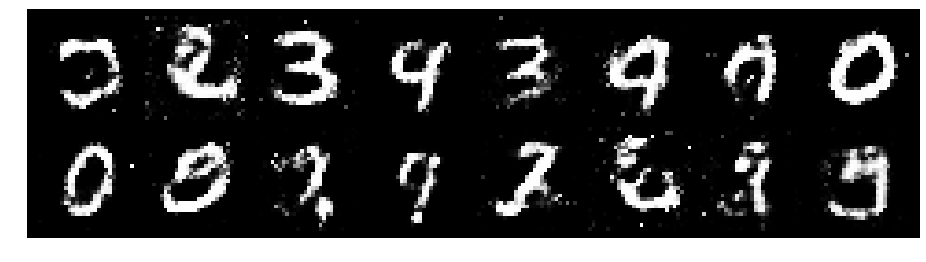

Epoch: [49/200], Batch Num: [200/600]
Discriminator Loss: 1.1309, Generator Loss: 0.9929
D(x): 0.5997, D(G(z)): 0.3994


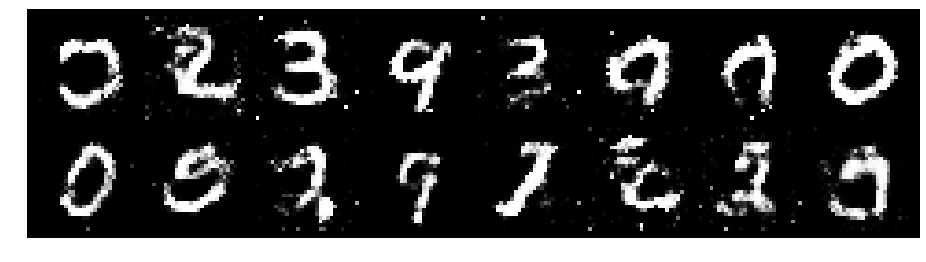

Epoch: [49/200], Batch Num: [300/600]
Discriminator Loss: 1.0920, Generator Loss: 1.2174
D(x): 0.6023, D(G(z)): 0.3721


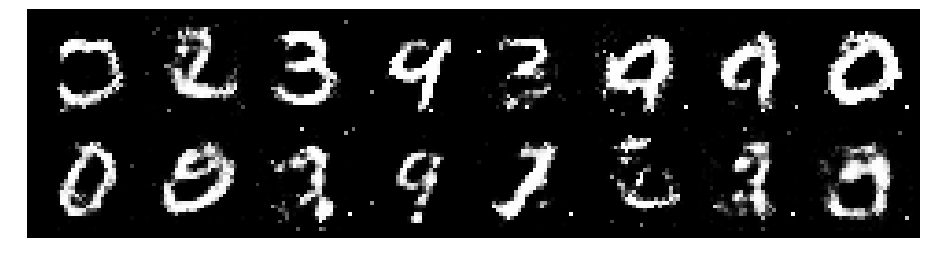

Epoch: [49/200], Batch Num: [400/600]
Discriminator Loss: 1.0753, Generator Loss: 1.1898
D(x): 0.6148, D(G(z)): 0.3630


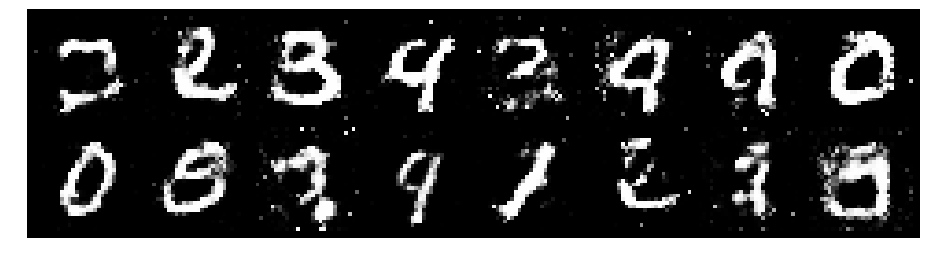

Epoch: [49/200], Batch Num: [500/600]
Discriminator Loss: 0.9645, Generator Loss: 1.2734
D(x): 0.6400, D(G(z)): 0.3343


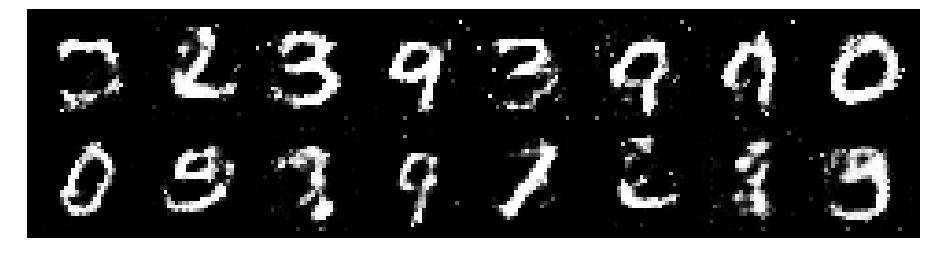

Epoch: [50/200], Batch Num: [0/600]
Discriminator Loss: 1.3909, Generator Loss: 0.8616
D(x): 0.5387, D(G(z)): 0.4694


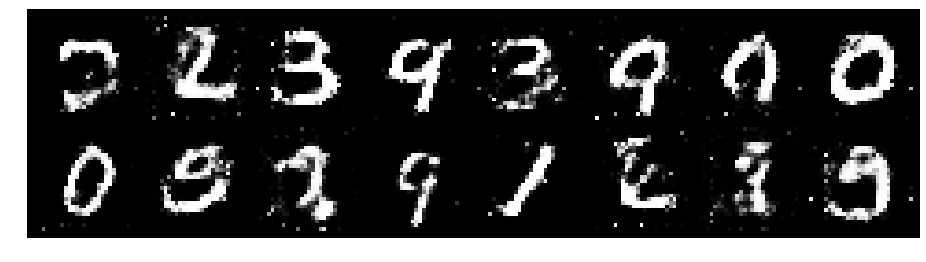

Epoch: [50/200], Batch Num: [100/600]
Discriminator Loss: 1.2066, Generator Loss: 1.0795
D(x): 0.5789, D(G(z)): 0.3912


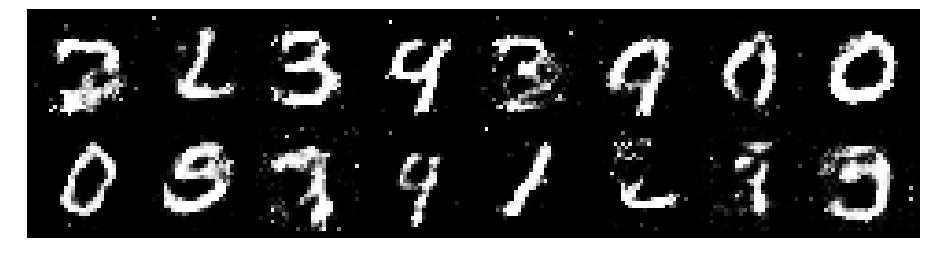

Epoch: [50/200], Batch Num: [200/600]
Discriminator Loss: 1.2459, Generator Loss: 1.1726
D(x): 0.5910, D(G(z)): 0.4045


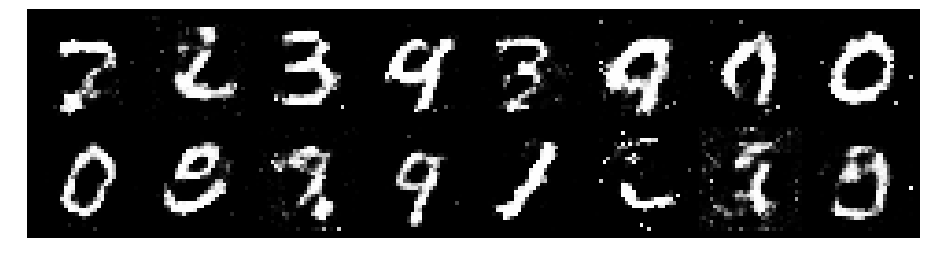

Epoch: [50/200], Batch Num: [300/600]
Discriminator Loss: 1.2311, Generator Loss: 0.9436
D(x): 0.6283, D(G(z)): 0.4432


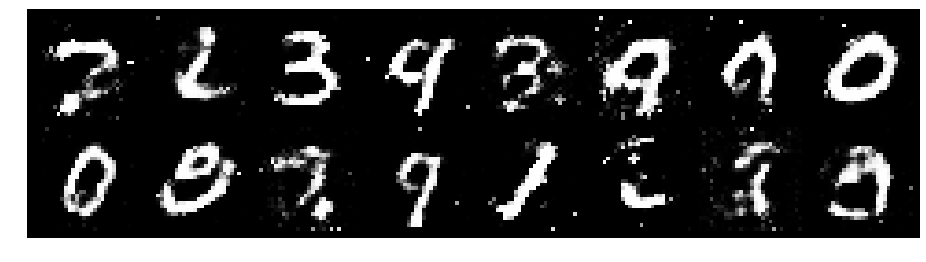

Epoch: [50/200], Batch Num: [400/600]
Discriminator Loss: 1.3256, Generator Loss: 0.9656
D(x): 0.6318, D(G(z)): 0.4943


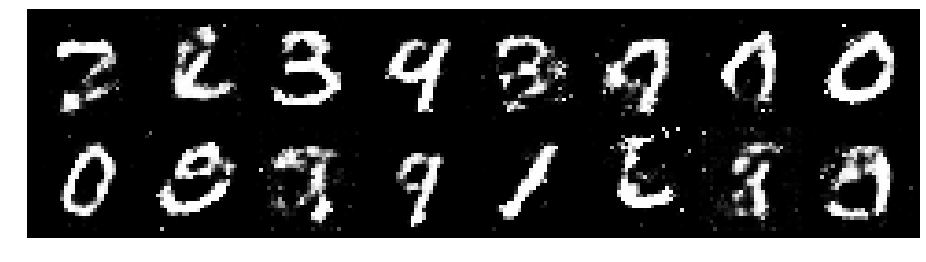

Epoch: [50/200], Batch Num: [500/600]
Discriminator Loss: 1.2215, Generator Loss: 0.9415
D(x): 0.5949, D(G(z)): 0.4232


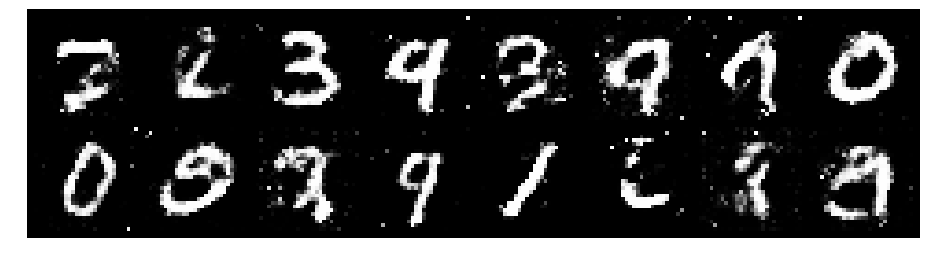

Epoch: [51/200], Batch Num: [0/600]
Discriminator Loss: 1.0802, Generator Loss: 1.2532
D(x): 0.6233, D(G(z)): 0.3549


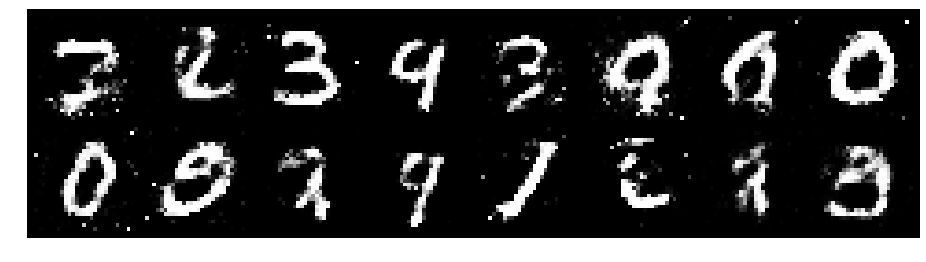

Epoch: [51/200], Batch Num: [100/600]
Discriminator Loss: 1.2790, Generator Loss: 1.0143
D(x): 0.5997, D(G(z)): 0.4582


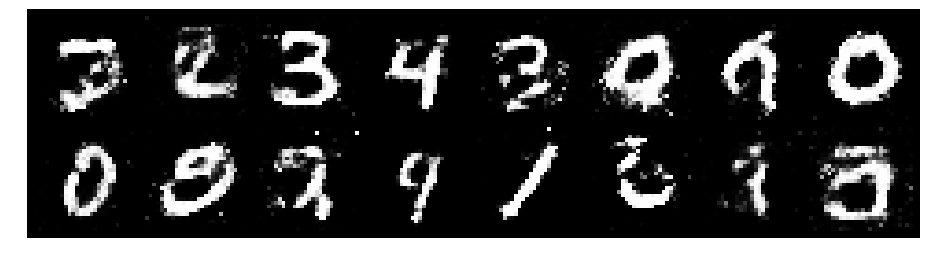

Epoch: [51/200], Batch Num: [200/600]
Discriminator Loss: 1.1923, Generator Loss: 1.1286
D(x): 0.5570, D(G(z)): 0.3519


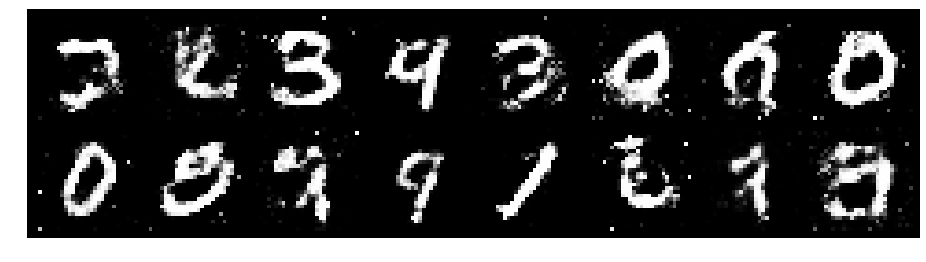

Epoch: [51/200], Batch Num: [300/600]
Discriminator Loss: 1.1692, Generator Loss: 0.9056
D(x): 0.6110, D(G(z)): 0.4319


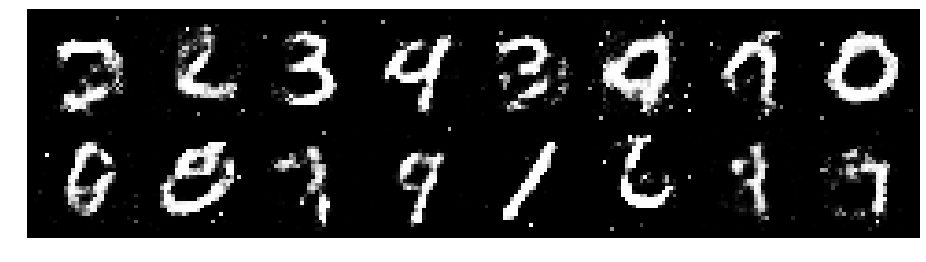

Epoch: [51/200], Batch Num: [400/600]
Discriminator Loss: 1.1707, Generator Loss: 0.8992
D(x): 0.5879, D(G(z)): 0.4068


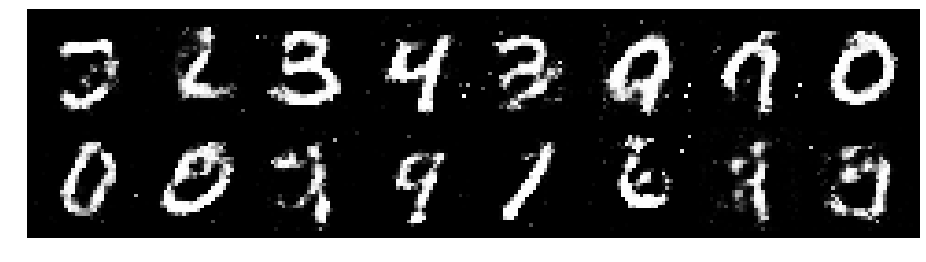

Epoch: [51/200], Batch Num: [500/600]
Discriminator Loss: 1.2187, Generator Loss: 1.0609
D(x): 0.5549, D(G(z)): 0.4102


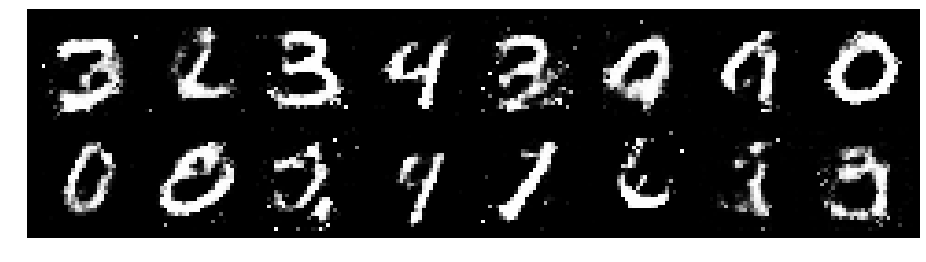

Epoch: [52/200], Batch Num: [0/600]
Discriminator Loss: 1.2135, Generator Loss: 0.9899
D(x): 0.6203, D(G(z)): 0.4353


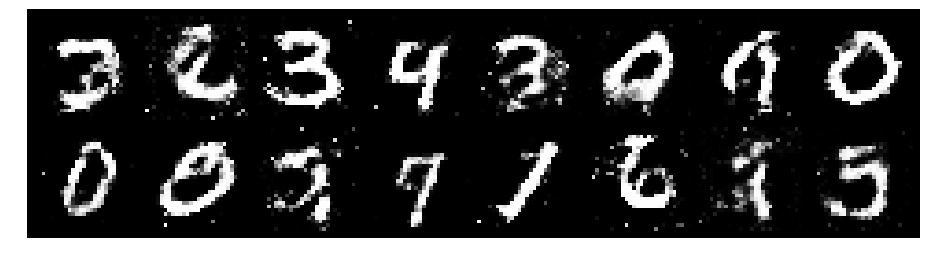

Epoch: [52/200], Batch Num: [100/600]
Discriminator Loss: 1.3539, Generator Loss: 0.9828
D(x): 0.5483, D(G(z)): 0.4514


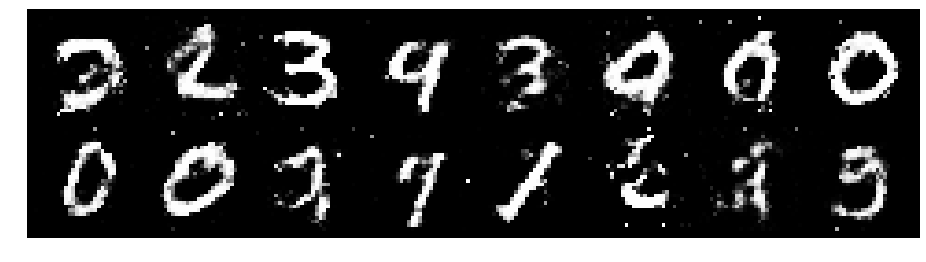

Epoch: [52/200], Batch Num: [200/600]
Discriminator Loss: 1.1354, Generator Loss: 0.9475
D(x): 0.5868, D(G(z)): 0.3821


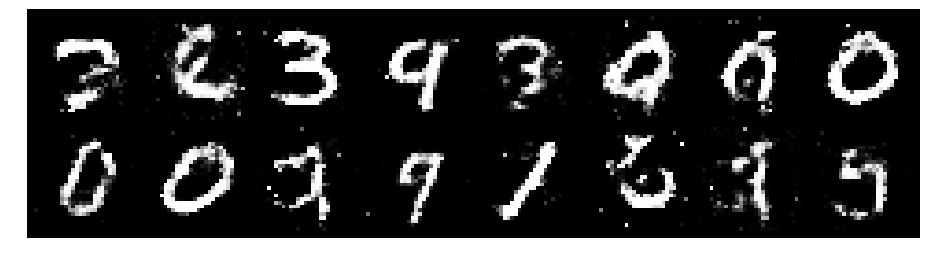

Epoch: [52/200], Batch Num: [300/600]
Discriminator Loss: 1.2162, Generator Loss: 0.9681
D(x): 0.6137, D(G(z)): 0.4161


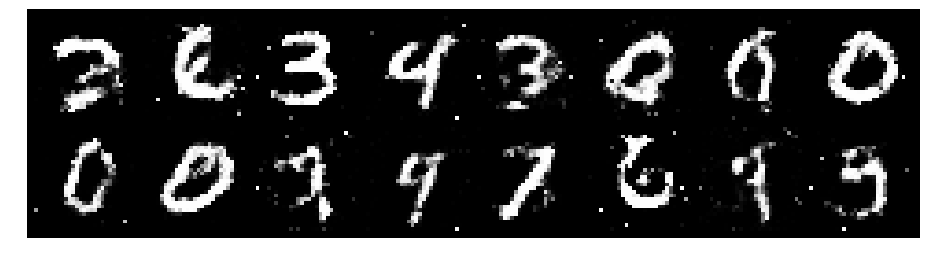

Epoch: [52/200], Batch Num: [400/600]
Discriminator Loss: 1.2194, Generator Loss: 0.9077
D(x): 0.6020, D(G(z)): 0.4638


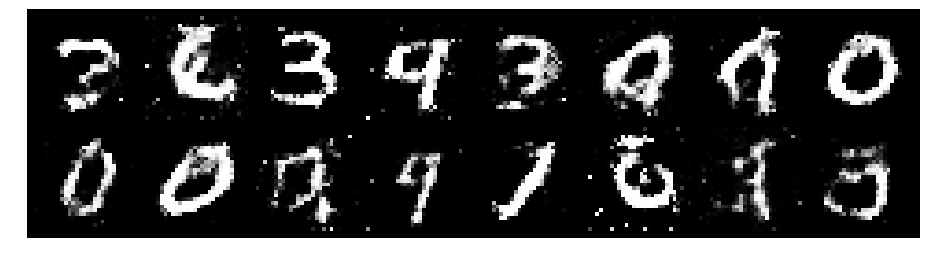

Epoch: [52/200], Batch Num: [500/600]
Discriminator Loss: 1.0462, Generator Loss: 1.2563
D(x): 0.5936, D(G(z)): 0.3327


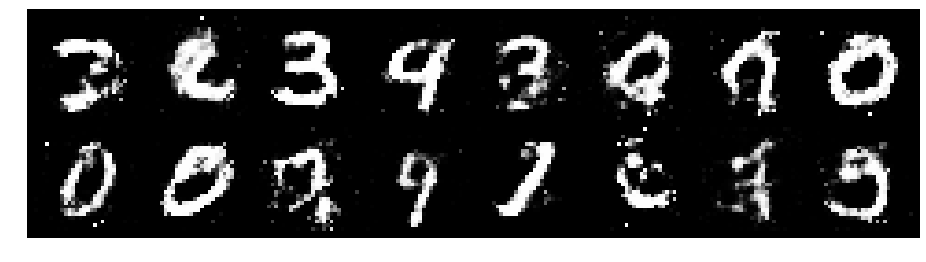

Epoch: [53/200], Batch Num: [0/600]
Discriminator Loss: 1.2448, Generator Loss: 1.2206
D(x): 0.5736, D(G(z)): 0.4064


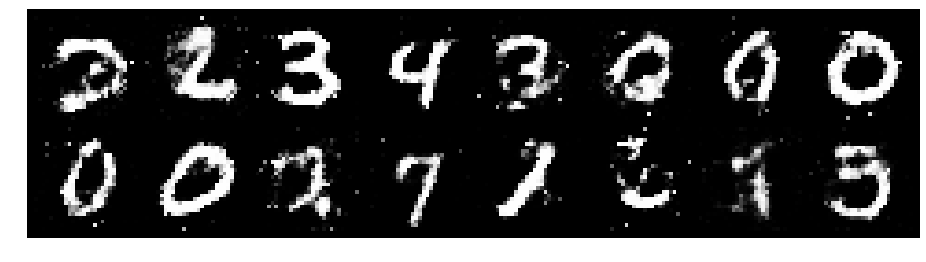

Epoch: [53/200], Batch Num: [100/600]
Discriminator Loss: 1.1615, Generator Loss: 1.0539
D(x): 0.6287, D(G(z)): 0.4088


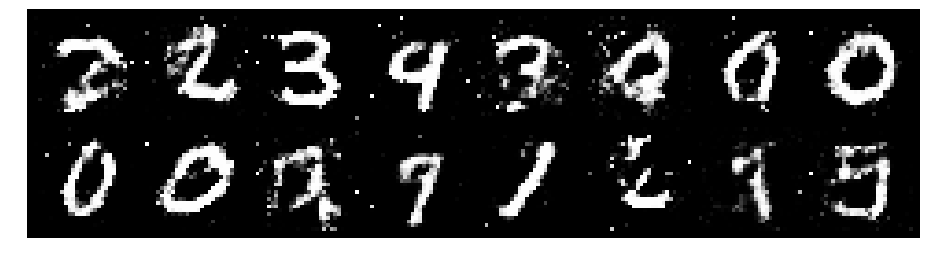

Epoch: [53/200], Batch Num: [200/600]
Discriminator Loss: 1.2385, Generator Loss: 1.0571
D(x): 0.5552, D(G(z)): 0.3853


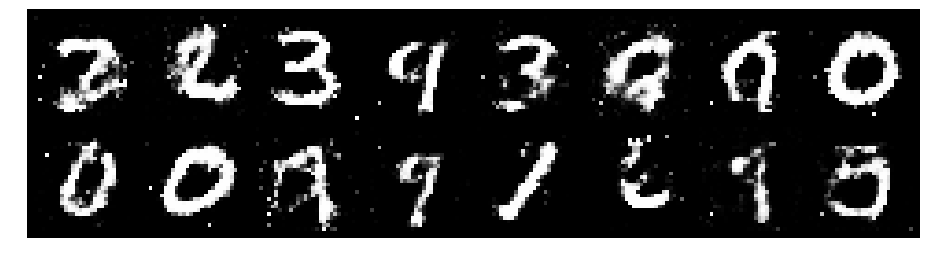

Epoch: [53/200], Batch Num: [300/600]
Discriminator Loss: 1.2178, Generator Loss: 1.0125
D(x): 0.5707, D(G(z)): 0.4058


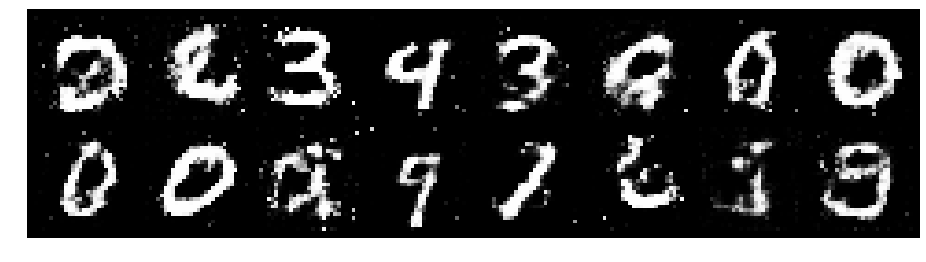

Epoch: [53/200], Batch Num: [400/600]
Discriminator Loss: 1.2420, Generator Loss: 1.0732
D(x): 0.5802, D(G(z)): 0.4278


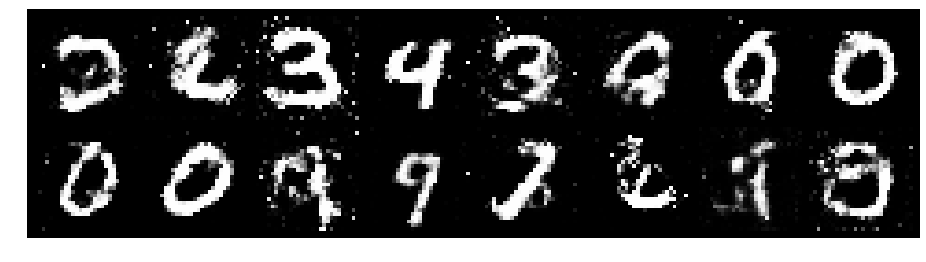

Epoch: [53/200], Batch Num: [500/600]
Discriminator Loss: 1.3619, Generator Loss: 0.8133
D(x): 0.5859, D(G(z)): 0.4787


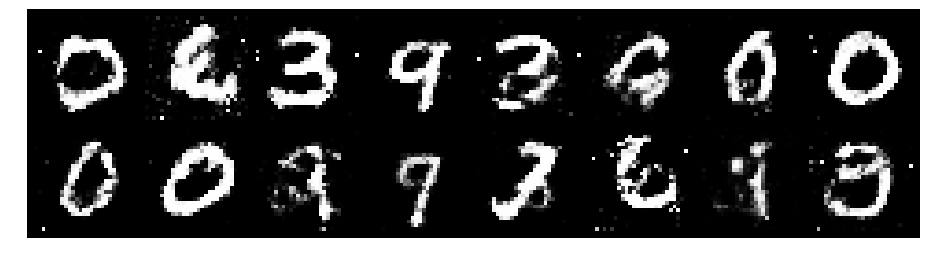

Epoch: [54/200], Batch Num: [0/600]
Discriminator Loss: 1.2737, Generator Loss: 0.8733
D(x): 0.5612, D(G(z)): 0.4410


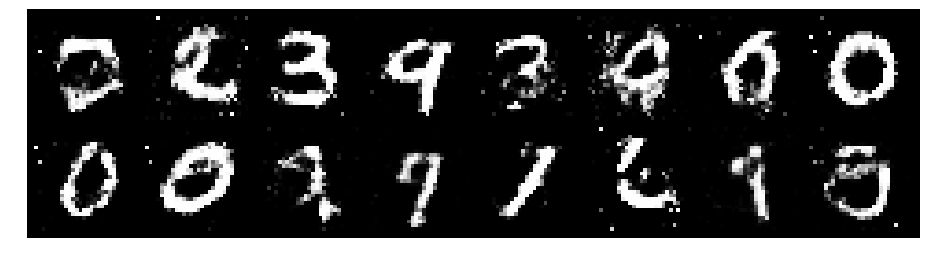

Epoch: [54/200], Batch Num: [100/600]
Discriminator Loss: 1.2178, Generator Loss: 1.0381
D(x): 0.5405, D(G(z)): 0.3765


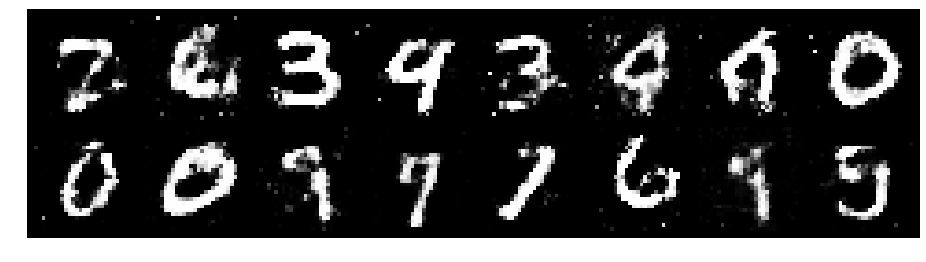

Epoch: [54/200], Batch Num: [200/600]
Discriminator Loss: 1.2779, Generator Loss: 0.9737
D(x): 0.5108, D(G(z)): 0.3866


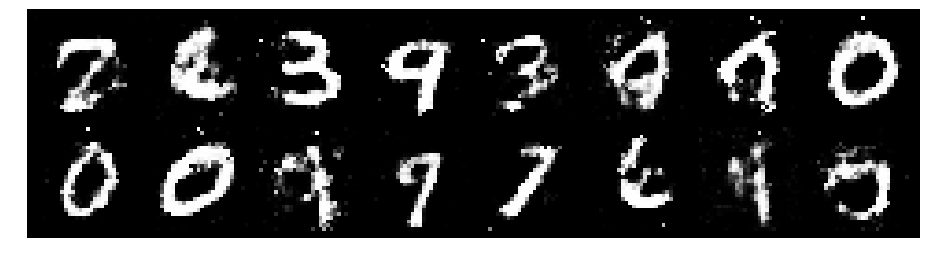

Epoch: [54/200], Batch Num: [300/600]
Discriminator Loss: 1.2523, Generator Loss: 0.9946
D(x): 0.5551, D(G(z)): 0.4105


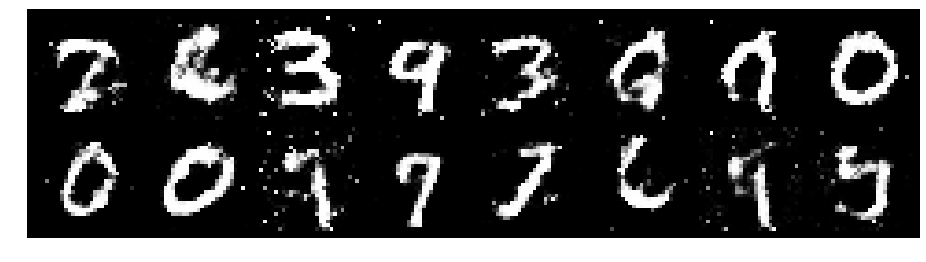

Epoch: [54/200], Batch Num: [400/600]
Discriminator Loss: 1.1962, Generator Loss: 1.0392
D(x): 0.5244, D(G(z)): 0.3542


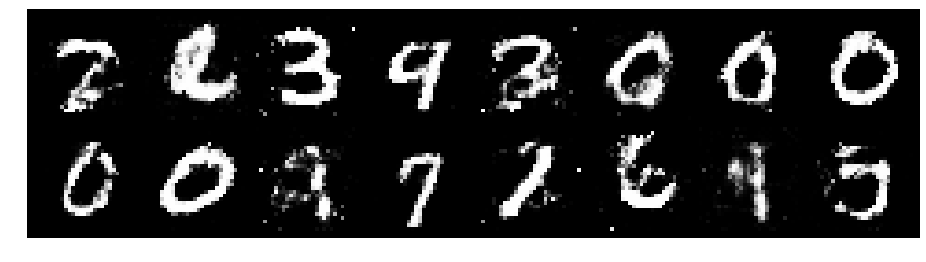

Epoch: [54/200], Batch Num: [500/600]
Discriminator Loss: 1.3300, Generator Loss: 1.0077
D(x): 0.5705, D(G(z)): 0.4552


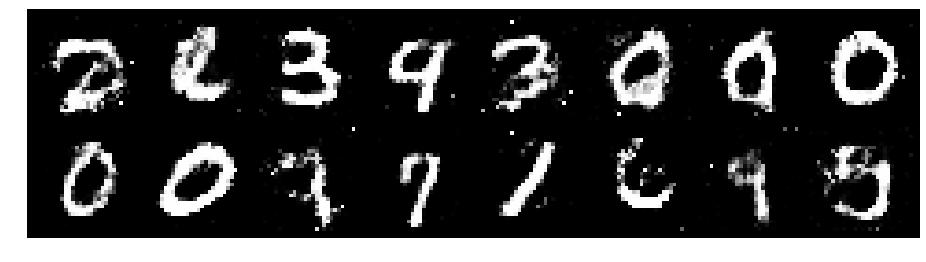

Epoch: [55/200], Batch Num: [0/600]
Discriminator Loss: 1.0696, Generator Loss: 1.1052
D(x): 0.5988, D(G(z)): 0.3830


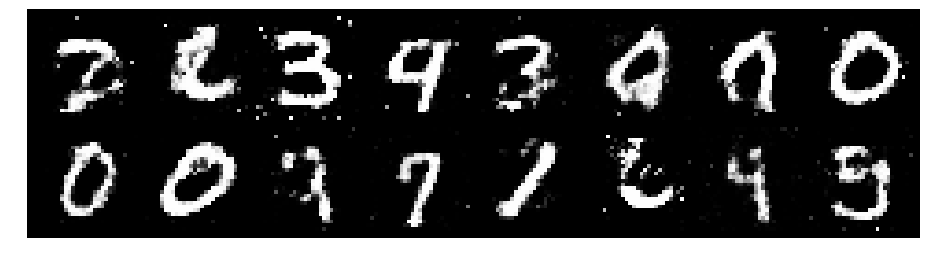

Epoch: [55/200], Batch Num: [100/600]
Discriminator Loss: 1.0708, Generator Loss: 0.9235
D(x): 0.6761, D(G(z)): 0.4238


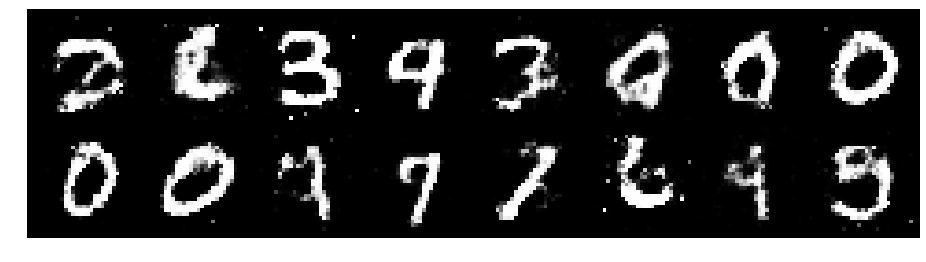

Epoch: [55/200], Batch Num: [200/600]
Discriminator Loss: 1.0888, Generator Loss: 1.1441
D(x): 0.6689, D(G(z)): 0.4035


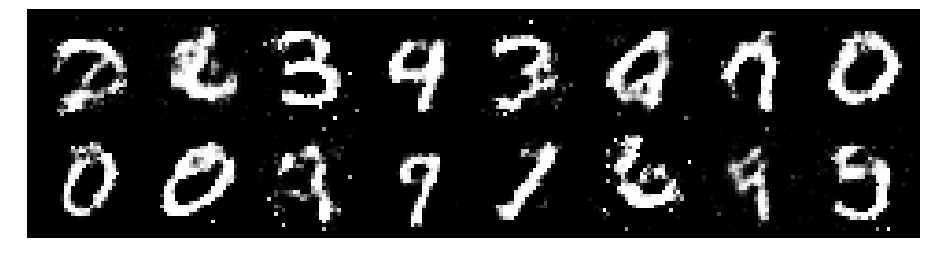

Epoch: [55/200], Batch Num: [300/600]
Discriminator Loss: 1.1734, Generator Loss: 1.2454
D(x): 0.5672, D(G(z)): 0.3578


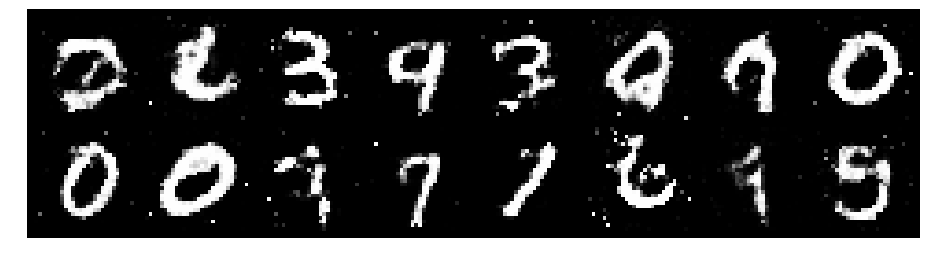

Epoch: [55/200], Batch Num: [400/600]
Discriminator Loss: 1.1718, Generator Loss: 1.1344
D(x): 0.5531, D(G(z)): 0.3593


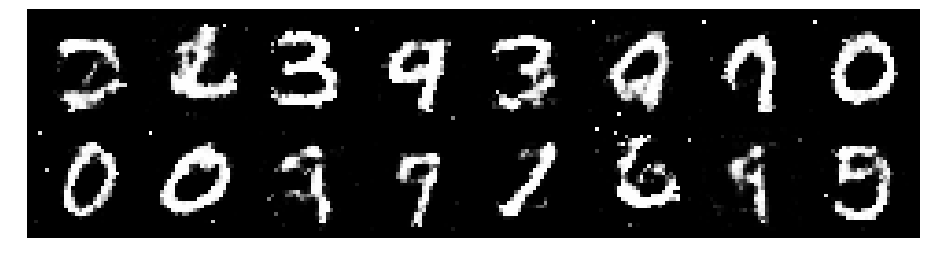

Epoch: [55/200], Batch Num: [500/600]
Discriminator Loss: 1.2022, Generator Loss: 1.1296
D(x): 0.6184, D(G(z)): 0.4195


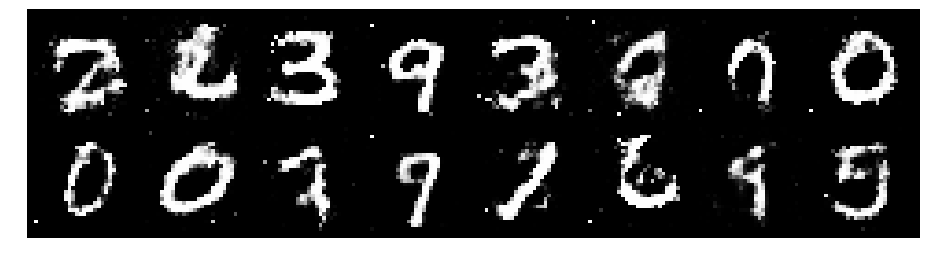

Epoch: [56/200], Batch Num: [0/600]
Discriminator Loss: 1.2723, Generator Loss: 1.0304
D(x): 0.6271, D(G(z)): 0.4525


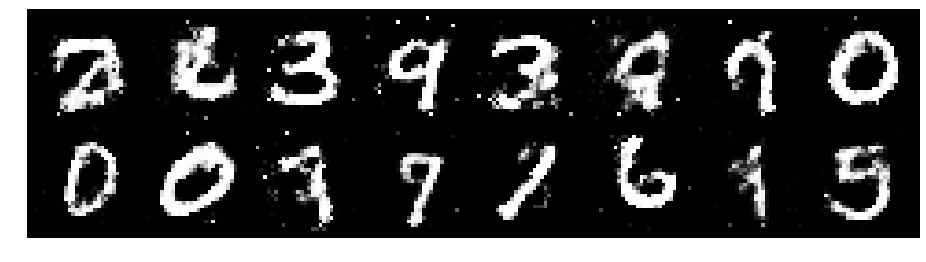

Epoch: [56/200], Batch Num: [100/600]
Discriminator Loss: 1.3312, Generator Loss: 0.9113
D(x): 0.5649, D(G(z)): 0.4608


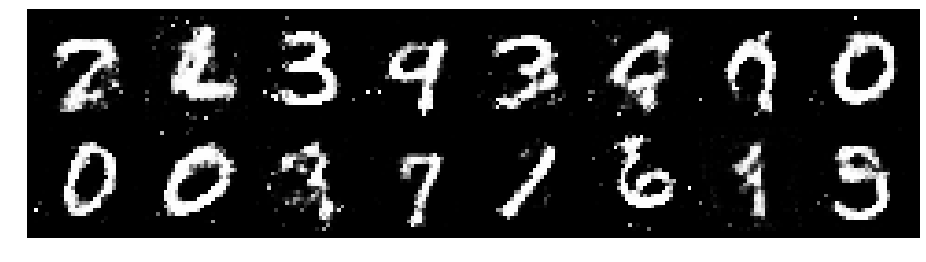

Epoch: [56/200], Batch Num: [200/600]
Discriminator Loss: 1.3817, Generator Loss: 0.8527
D(x): 0.5091, D(G(z)): 0.4446


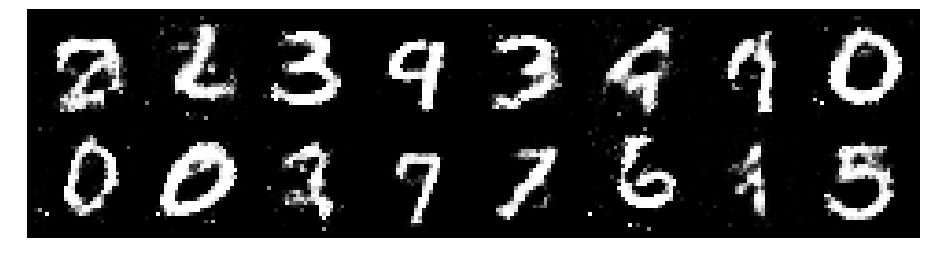

Epoch: [56/200], Batch Num: [300/600]
Discriminator Loss: 1.1207, Generator Loss: 1.0610
D(x): 0.6475, D(G(z)): 0.4098


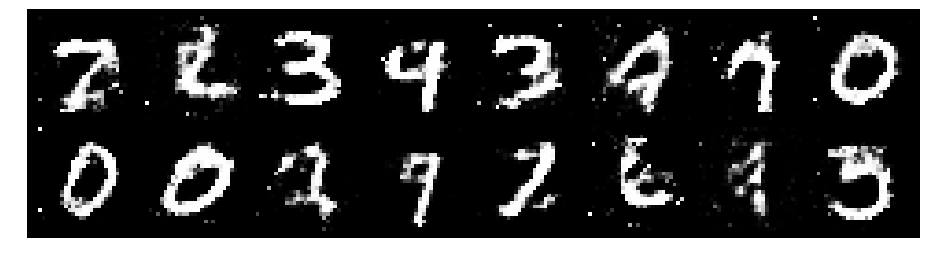

Epoch: [56/200], Batch Num: [400/600]
Discriminator Loss: 1.2189, Generator Loss: 0.9146
D(x): 0.5759, D(G(z)): 0.4319


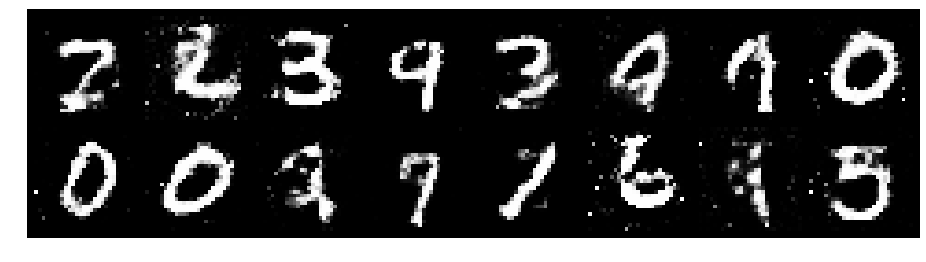

Epoch: [56/200], Batch Num: [500/600]
Discriminator Loss: 1.2188, Generator Loss: 1.1087
D(x): 0.5947, D(G(z)): 0.4030


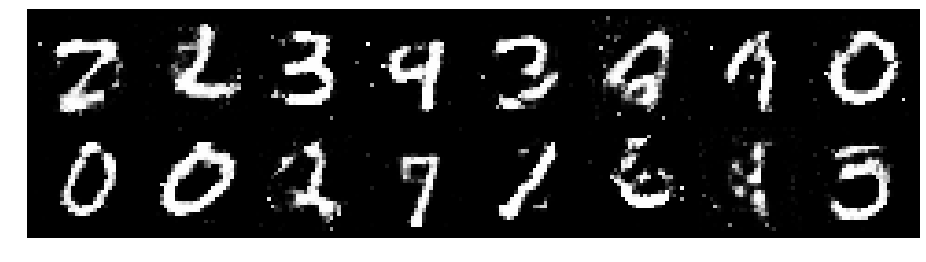

Epoch: [57/200], Batch Num: [0/600]
Discriminator Loss: 1.1259, Generator Loss: 1.0626
D(x): 0.6318, D(G(z)): 0.3994


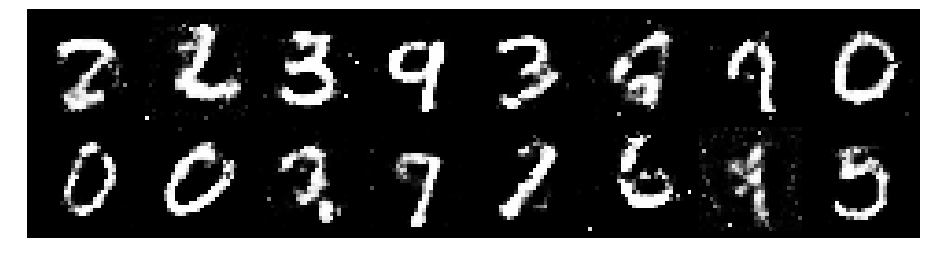

Epoch: [57/200], Batch Num: [100/600]
Discriminator Loss: 1.3008, Generator Loss: 0.9601
D(x): 0.5414, D(G(z)): 0.4095


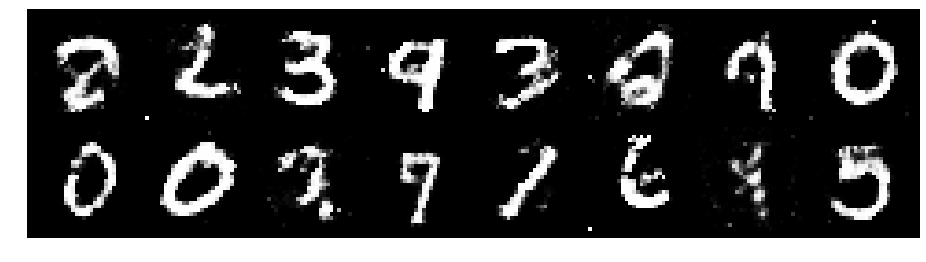

Epoch: [57/200], Batch Num: [200/600]
Discriminator Loss: 1.2180, Generator Loss: 0.9650
D(x): 0.6278, D(G(z)): 0.4710


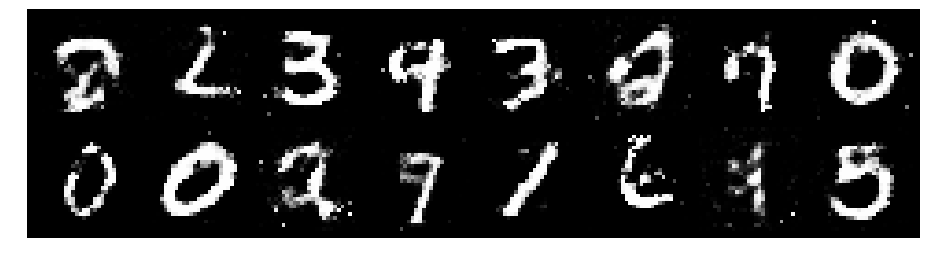

Epoch: [57/200], Batch Num: [300/600]
Discriminator Loss: 1.1352, Generator Loss: 1.0681
D(x): 0.5899, D(G(z)): 0.3836


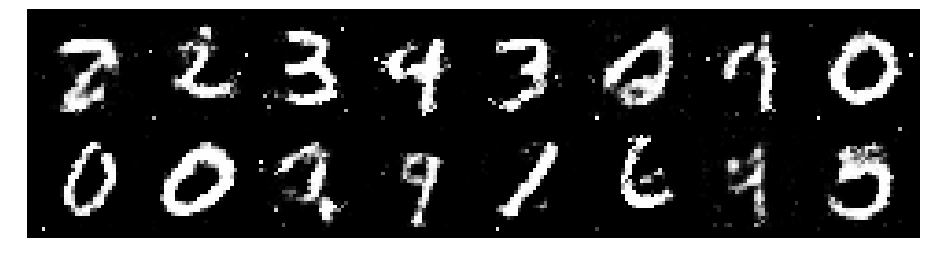

Epoch: [57/200], Batch Num: [400/600]
Discriminator Loss: 1.1077, Generator Loss: 1.2142
D(x): 0.5851, D(G(z)): 0.3529


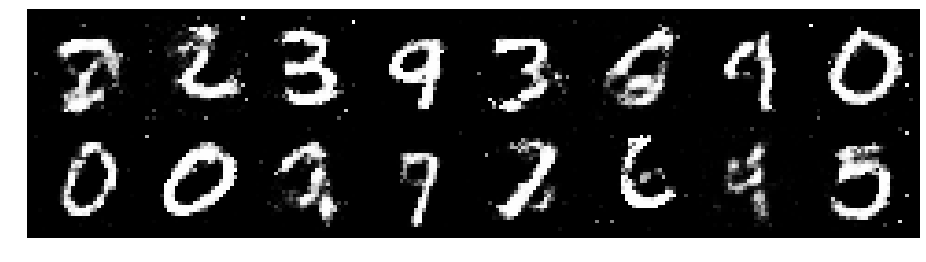

Epoch: [57/200], Batch Num: [500/600]
Discriminator Loss: 1.1384, Generator Loss: 1.1805
D(x): 0.5719, D(G(z)): 0.3549


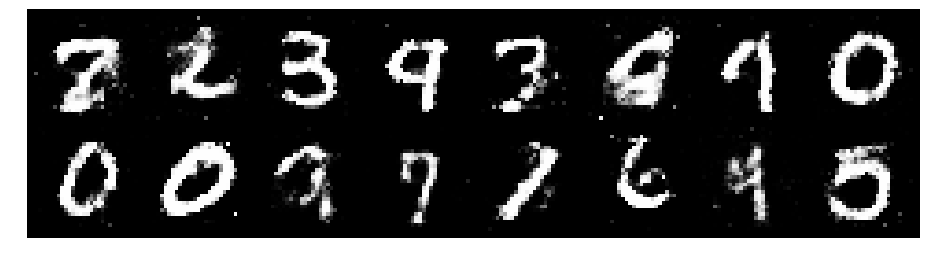

Epoch: [58/200], Batch Num: [0/600]
Discriminator Loss: 0.9634, Generator Loss: 0.9959
D(x): 0.6719, D(G(z)): 0.3645


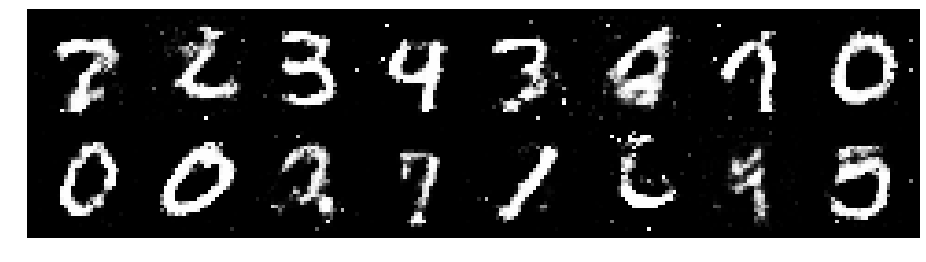

Epoch: [58/200], Batch Num: [100/600]
Discriminator Loss: 1.1885, Generator Loss: 1.0643
D(x): 0.6025, D(G(z)): 0.4046


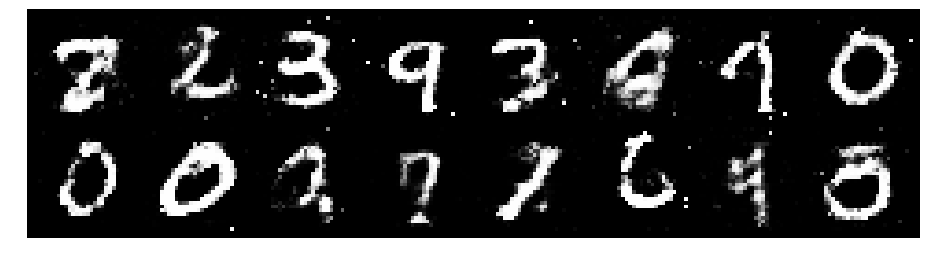

Epoch: [58/200], Batch Num: [200/600]
Discriminator Loss: 1.2414, Generator Loss: 0.9912
D(x): 0.5626, D(G(z)): 0.3997


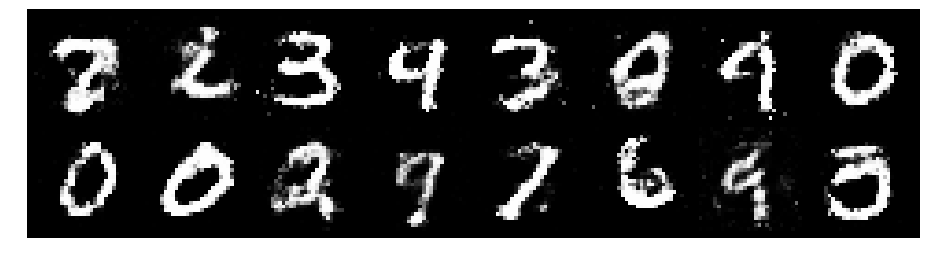

Epoch: [58/200], Batch Num: [300/600]
Discriminator Loss: 1.1905, Generator Loss: 0.9917
D(x): 0.6203, D(G(z)): 0.4521


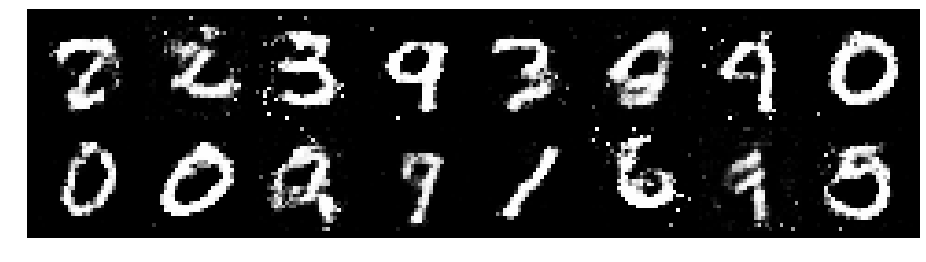

Epoch: [58/200], Batch Num: [400/600]
Discriminator Loss: 1.2174, Generator Loss: 0.9277
D(x): 0.5752, D(G(z)): 0.4247


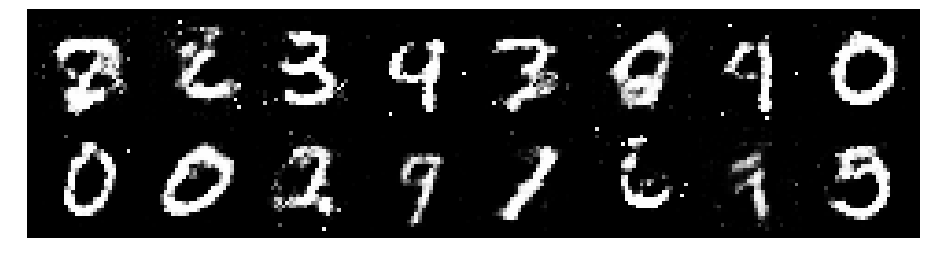

Epoch: [58/200], Batch Num: [500/600]
Discriminator Loss: 1.1688, Generator Loss: 0.9371
D(x): 0.5986, D(G(z)): 0.4151


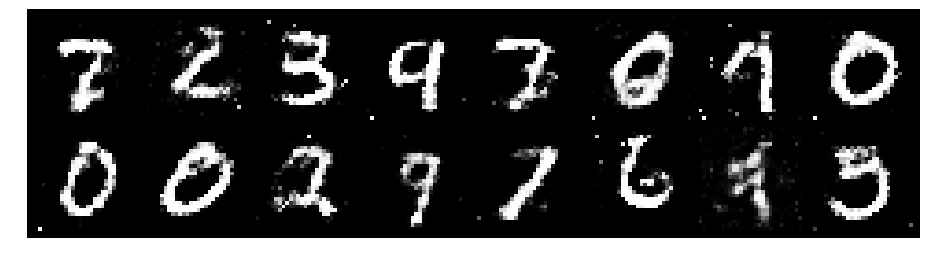

Epoch: [59/200], Batch Num: [0/600]
Discriminator Loss: 1.1643, Generator Loss: 0.9928
D(x): 0.5980, D(G(z)): 0.4158


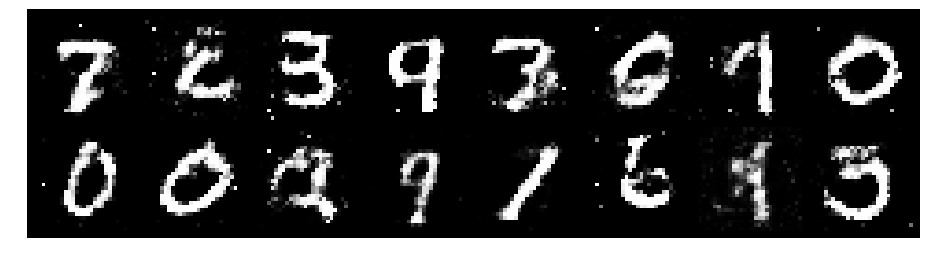

Epoch: [59/200], Batch Num: [100/600]
Discriminator Loss: 1.1301, Generator Loss: 1.0300
D(x): 0.6038, D(G(z)): 0.3985


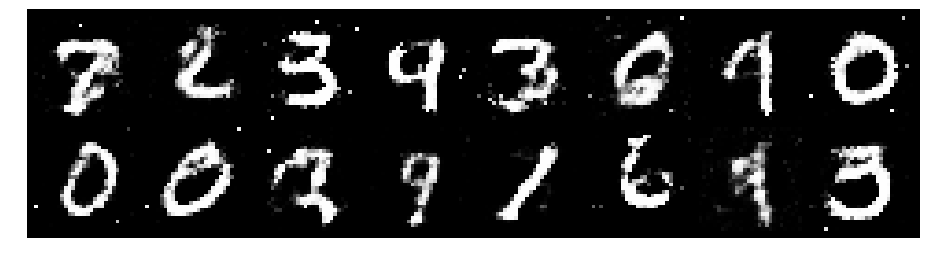

Epoch: [59/200], Batch Num: [200/600]
Discriminator Loss: 1.1531, Generator Loss: 1.0661
D(x): 0.5810, D(G(z)): 0.3864


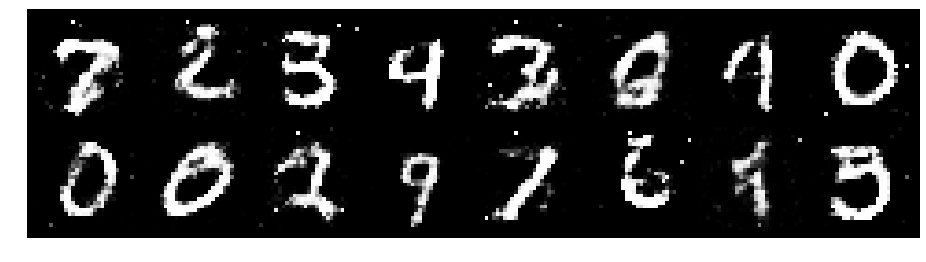

Epoch: [59/200], Batch Num: [300/600]
Discriminator Loss: 1.1112, Generator Loss: 1.0932
D(x): 0.5944, D(G(z)): 0.3675


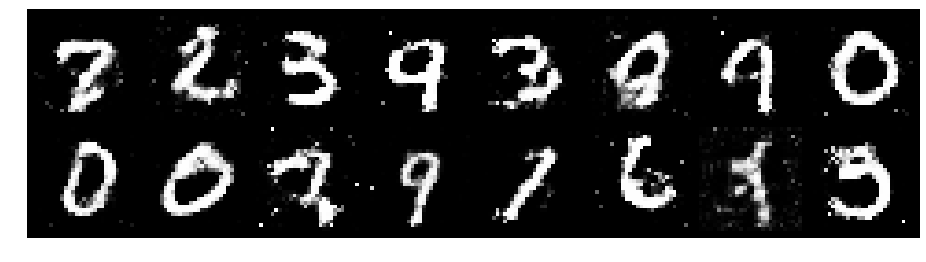

Epoch: [59/200], Batch Num: [400/600]
Discriminator Loss: 1.0631, Generator Loss: 1.2532
D(x): 0.6429, D(G(z)): 0.3844


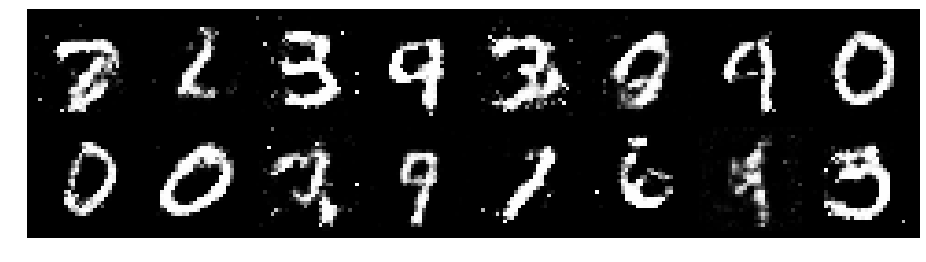

Epoch: [59/200], Batch Num: [500/600]
Discriminator Loss: 1.2711, Generator Loss: 0.9402
D(x): 0.6239, D(G(z)): 0.4887


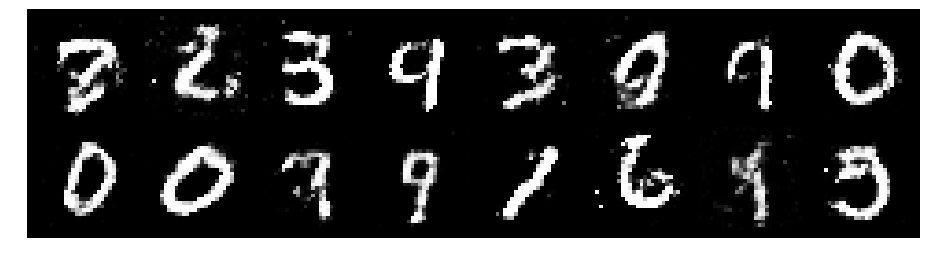

Epoch: [60/200], Batch Num: [0/600]
Discriminator Loss: 1.1604, Generator Loss: 0.9976
D(x): 0.6148, D(G(z)): 0.4257


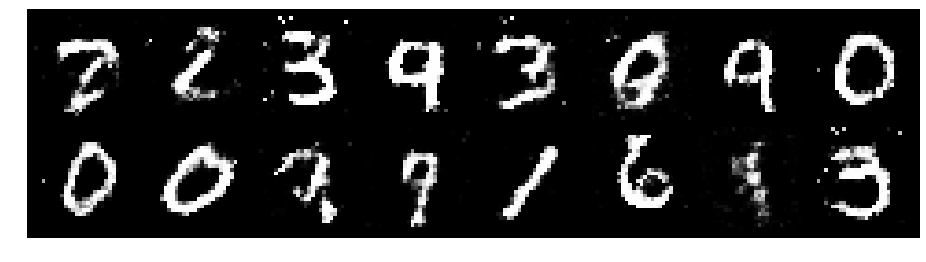

Epoch: [60/200], Batch Num: [100/600]
Discriminator Loss: 1.1007, Generator Loss: 0.9141
D(x): 0.6395, D(G(z)): 0.4183


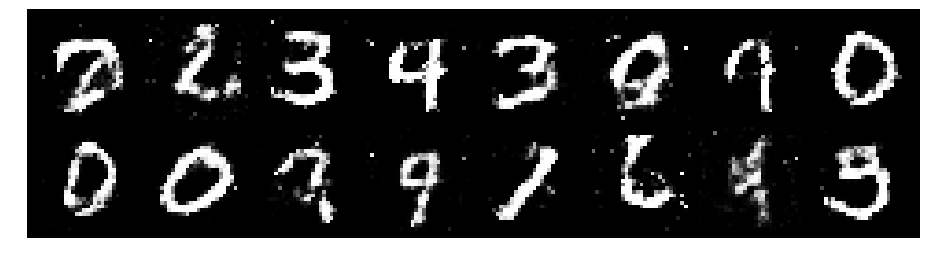

Epoch: [60/200], Batch Num: [200/600]
Discriminator Loss: 1.2473, Generator Loss: 0.9254
D(x): 0.5988, D(G(z)): 0.4410


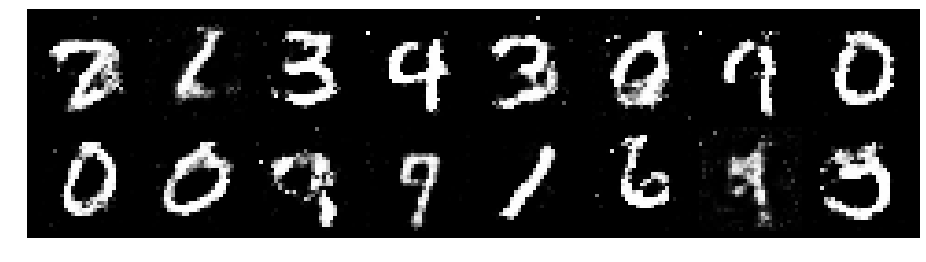

Epoch: [60/200], Batch Num: [300/600]
Discriminator Loss: 1.2909, Generator Loss: 0.8645
D(x): 0.5808, D(G(z)): 0.4510


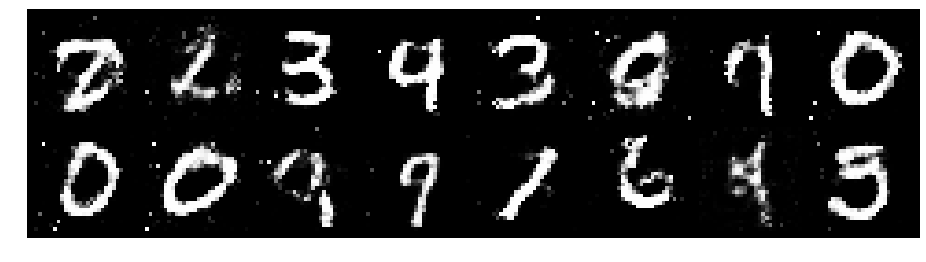

Epoch: [60/200], Batch Num: [400/600]
Discriminator Loss: 1.2083, Generator Loss: 1.0273
D(x): 0.5820, D(G(z)): 0.4082


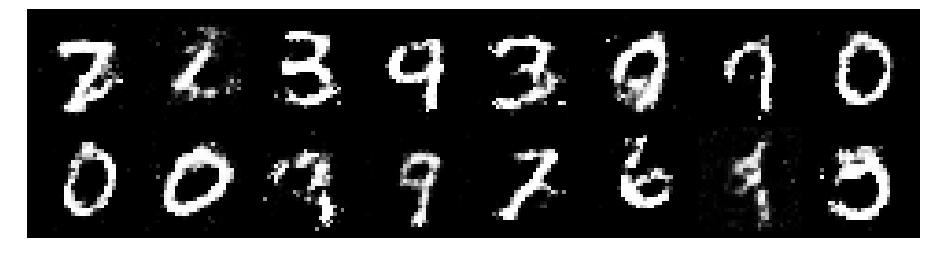

Epoch: [60/200], Batch Num: [500/600]
Discriminator Loss: 1.2528, Generator Loss: 1.0025
D(x): 0.5660, D(G(z)): 0.4113


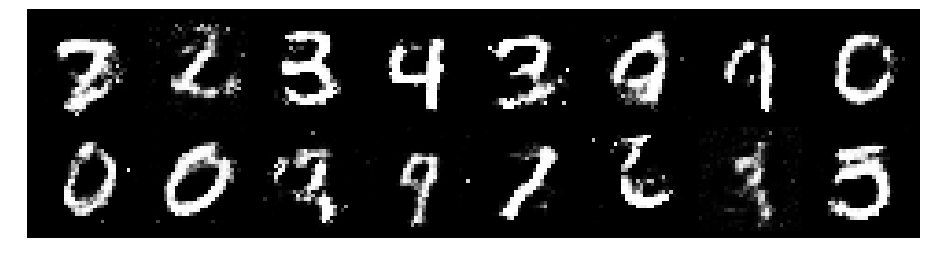

Epoch: [61/200], Batch Num: [0/600]
Discriminator Loss: 1.1467, Generator Loss: 1.1651
D(x): 0.6161, D(G(z)): 0.4176


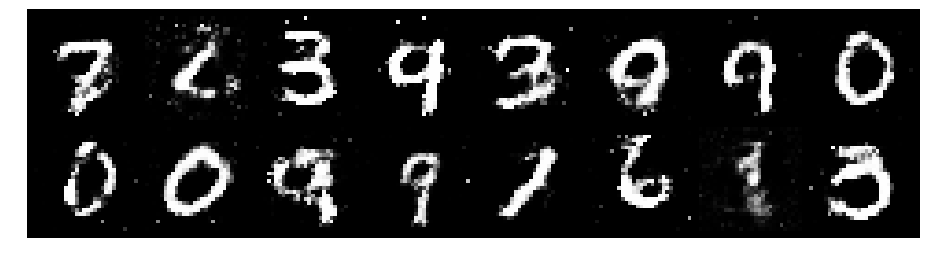

Epoch: [61/200], Batch Num: [100/600]
Discriminator Loss: 1.2371, Generator Loss: 1.0219
D(x): 0.5755, D(G(z)): 0.4284


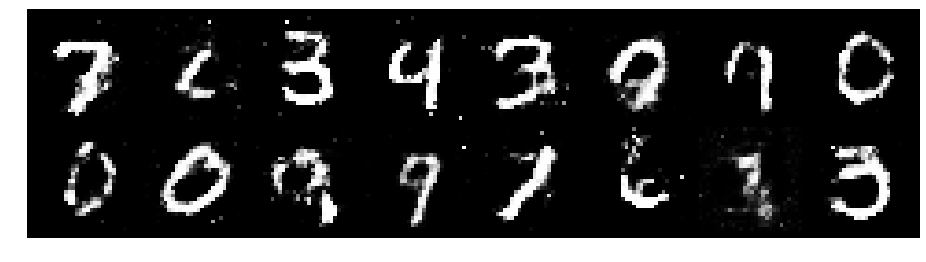

Epoch: [61/200], Batch Num: [200/600]
Discriminator Loss: 1.2601, Generator Loss: 0.9938
D(x): 0.5750, D(G(z)): 0.4079


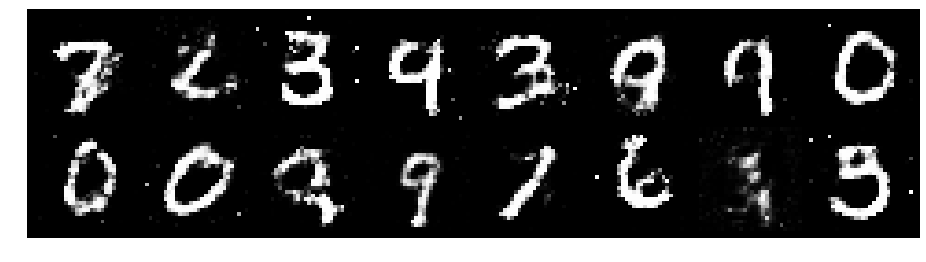

Epoch: [61/200], Batch Num: [300/600]
Discriminator Loss: 1.1949, Generator Loss: 0.9885
D(x): 0.5652, D(G(z)): 0.3715


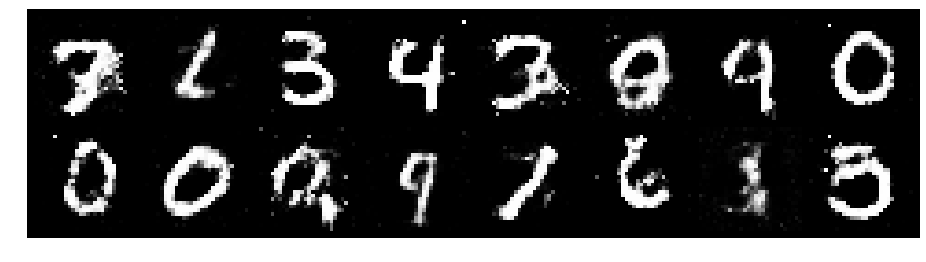

Epoch: [61/200], Batch Num: [400/600]
Discriminator Loss: 1.3470, Generator Loss: 0.8330
D(x): 0.5489, D(G(z)): 0.4828


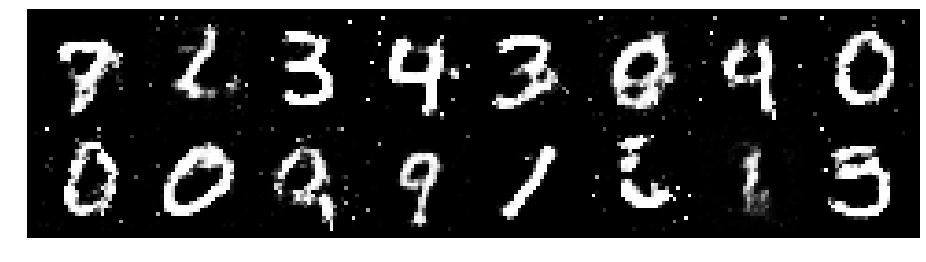

Epoch: [61/200], Batch Num: [500/600]
Discriminator Loss: 1.2945, Generator Loss: 0.9224
D(x): 0.5432, D(G(z)): 0.4412


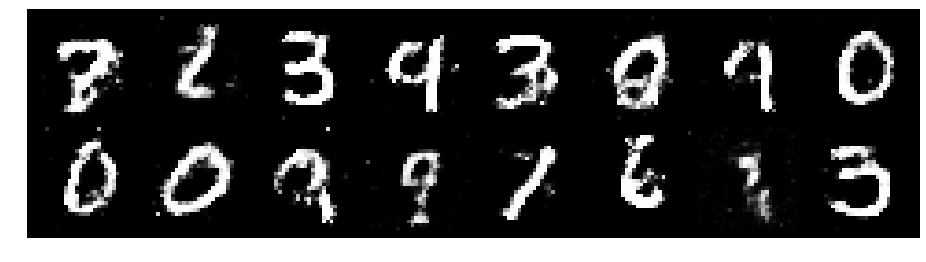

Epoch: [62/200], Batch Num: [0/600]
Discriminator Loss: 1.1564, Generator Loss: 1.0976
D(x): 0.6370, D(G(z)): 0.4179


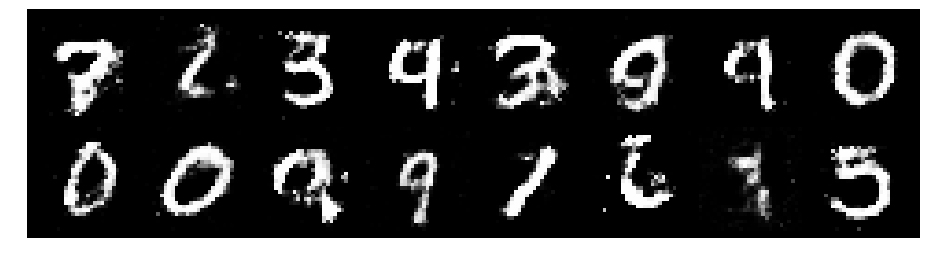

Epoch: [62/200], Batch Num: [100/600]
Discriminator Loss: 1.1386, Generator Loss: 1.1654
D(x): 0.5969, D(G(z)): 0.4009


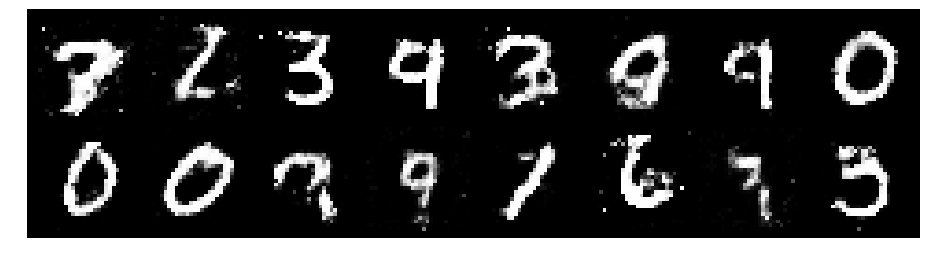

Epoch: [62/200], Batch Num: [200/600]
Discriminator Loss: 1.0857, Generator Loss: 1.1119
D(x): 0.5900, D(G(z)): 0.3527


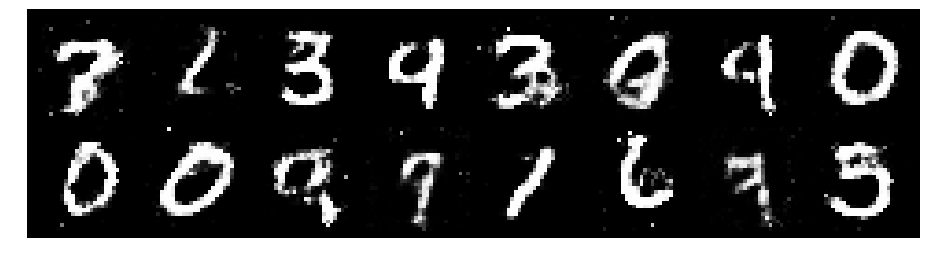

Epoch: [62/200], Batch Num: [300/600]
Discriminator Loss: 1.2742, Generator Loss: 0.9661
D(x): 0.5765, D(G(z)): 0.4169


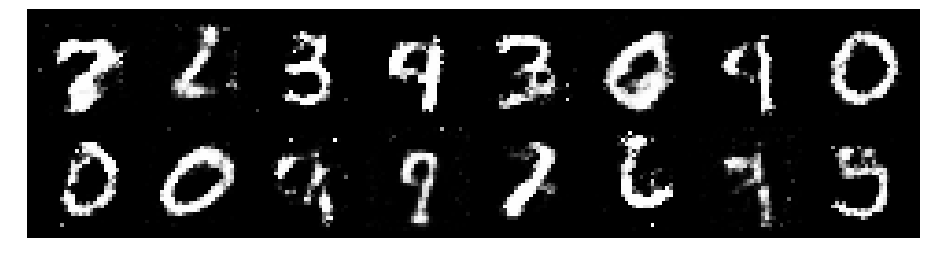

Epoch: [62/200], Batch Num: [400/600]
Discriminator Loss: 1.4061, Generator Loss: 0.7851
D(x): 0.5619, D(G(z)): 0.5060


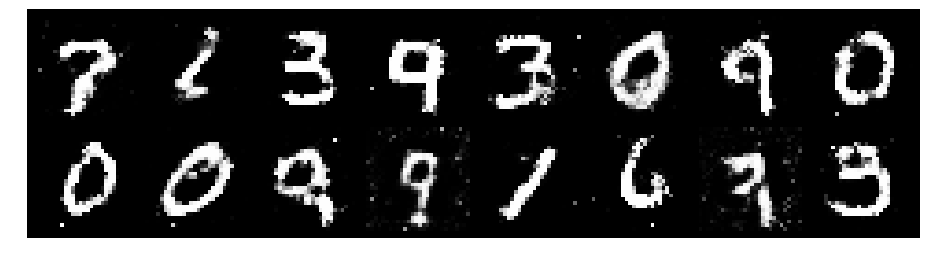

Epoch: [62/200], Batch Num: [500/600]
Discriminator Loss: 1.2687, Generator Loss: 1.1212
D(x): 0.5406, D(G(z)): 0.3777


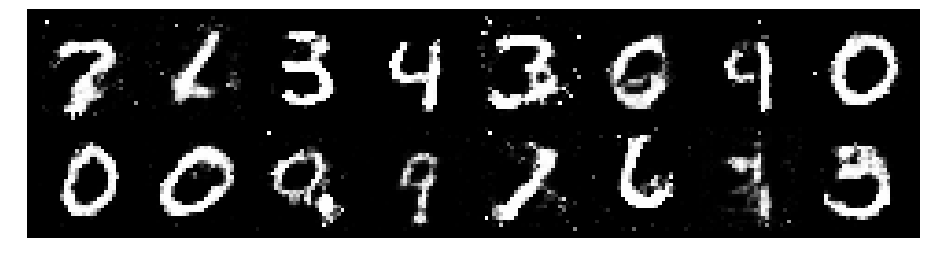

Epoch: [63/200], Batch Num: [0/600]
Discriminator Loss: 1.2624, Generator Loss: 0.9404
D(x): 0.5879, D(G(z)): 0.4585


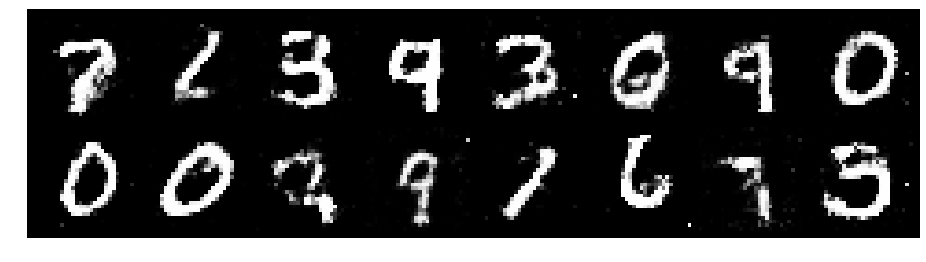

Epoch: [63/200], Batch Num: [100/600]
Discriminator Loss: 1.2480, Generator Loss: 0.9079
D(x): 0.5419, D(G(z)): 0.4230


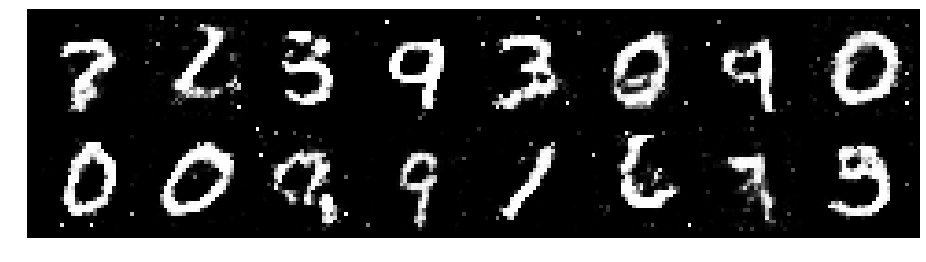

Epoch: [63/200], Batch Num: [200/600]
Discriminator Loss: 1.2830, Generator Loss: 0.9868
D(x): 0.5578, D(G(z)): 0.4432


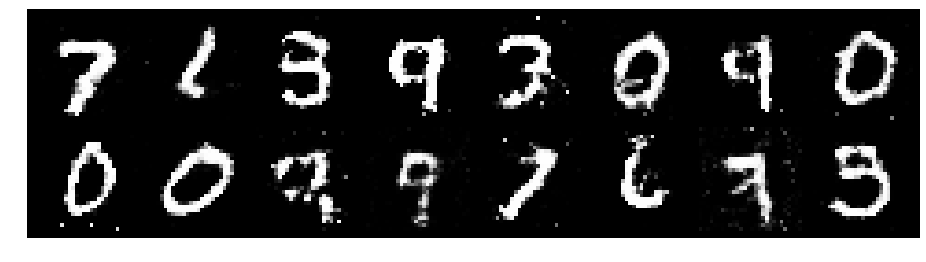

Epoch: [63/200], Batch Num: [300/600]
Discriminator Loss: 1.1670, Generator Loss: 0.8833
D(x): 0.6069, D(G(z)): 0.4422


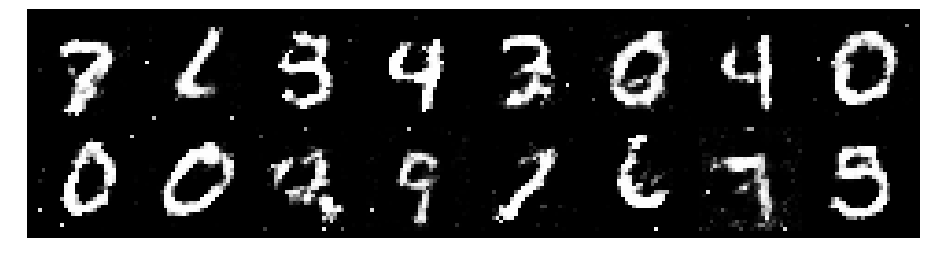

Epoch: [63/200], Batch Num: [400/600]
Discriminator Loss: 1.2085, Generator Loss: 0.9043
D(x): 0.5997, D(G(z)): 0.4485


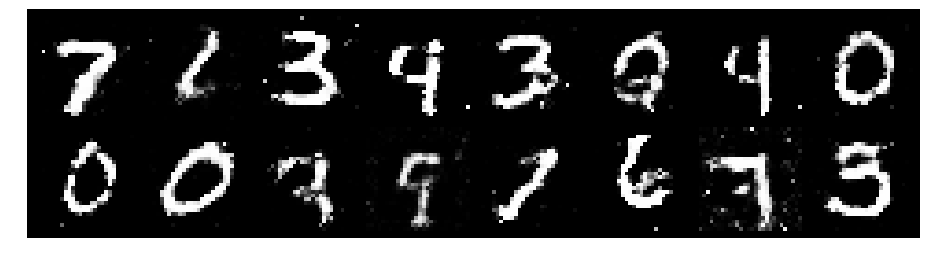

Epoch: [63/200], Batch Num: [500/600]
Discriminator Loss: 1.1495, Generator Loss: 1.1044
D(x): 0.5804, D(G(z)): 0.3975


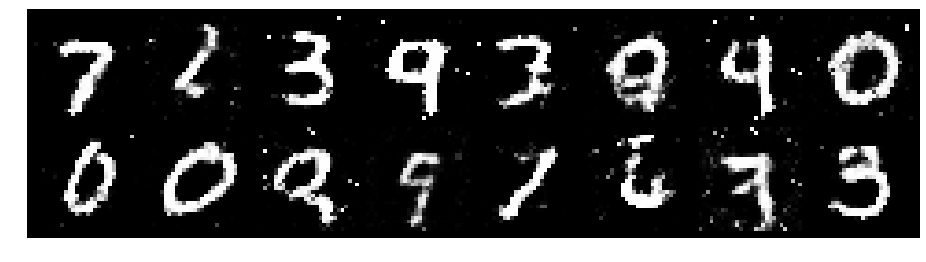

Epoch: [64/200], Batch Num: [0/600]
Discriminator Loss: 1.2188, Generator Loss: 0.8471
D(x): 0.5634, D(G(z)): 0.4191


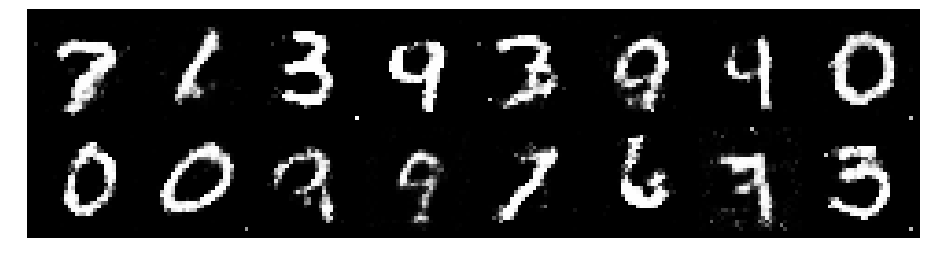

Epoch: [64/200], Batch Num: [100/600]
Discriminator Loss: 1.2010, Generator Loss: 1.0348
D(x): 0.5519, D(G(z)): 0.3924


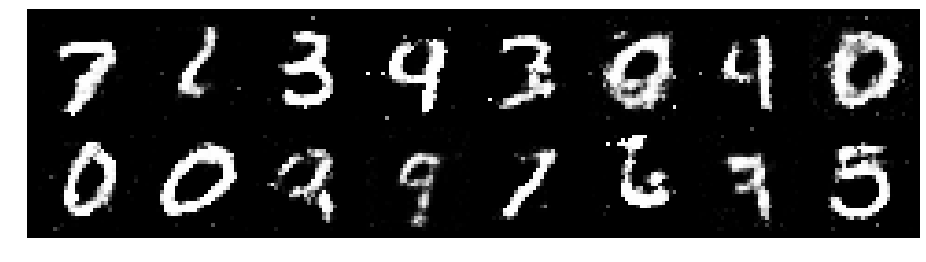

Epoch: [64/200], Batch Num: [200/600]
Discriminator Loss: 1.1994, Generator Loss: 0.8955
D(x): 0.5634, D(G(z)): 0.4079


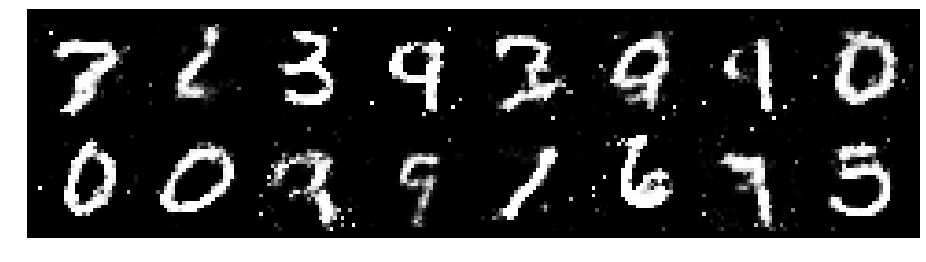

Epoch: [64/200], Batch Num: [300/600]
Discriminator Loss: 1.1339, Generator Loss: 0.9989
D(x): 0.5964, D(G(z)): 0.3884


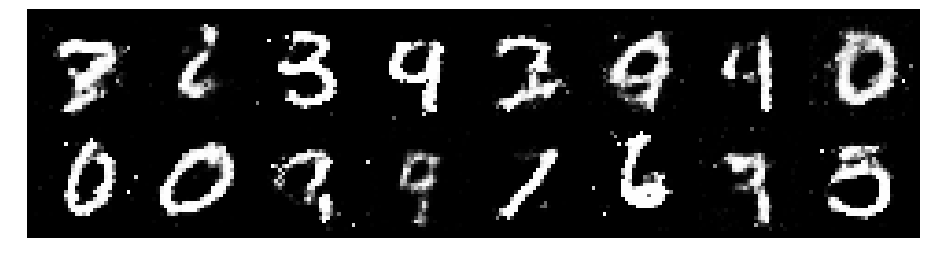

Epoch: [64/200], Batch Num: [400/600]
Discriminator Loss: 1.3529, Generator Loss: 0.9630
D(x): 0.6014, D(G(z)): 0.4525


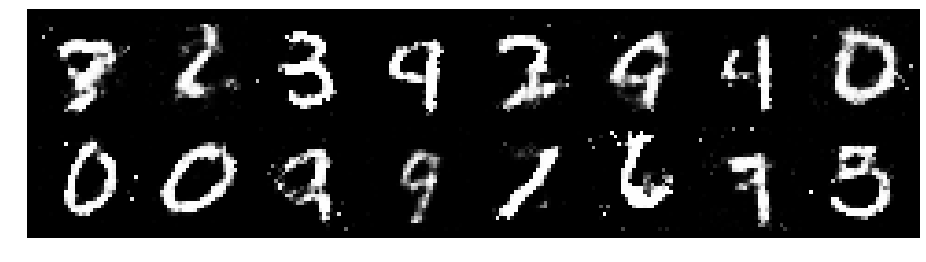

Epoch: [64/200], Batch Num: [500/600]
Discriminator Loss: 1.4566, Generator Loss: 0.9127
D(x): 0.5265, D(G(z)): 0.4755


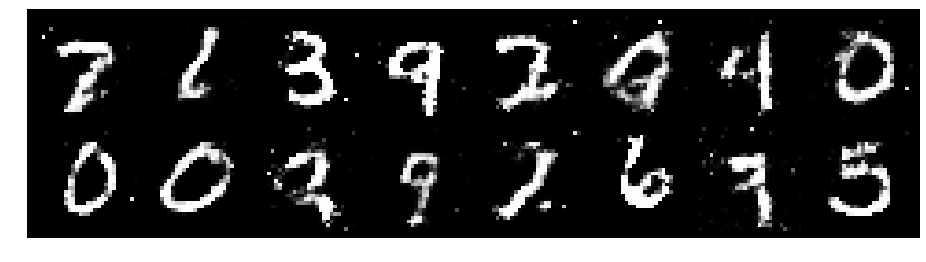

Epoch: [65/200], Batch Num: [0/600]
Discriminator Loss: 1.3034, Generator Loss: 0.9388
D(x): 0.5771, D(G(z)): 0.4632


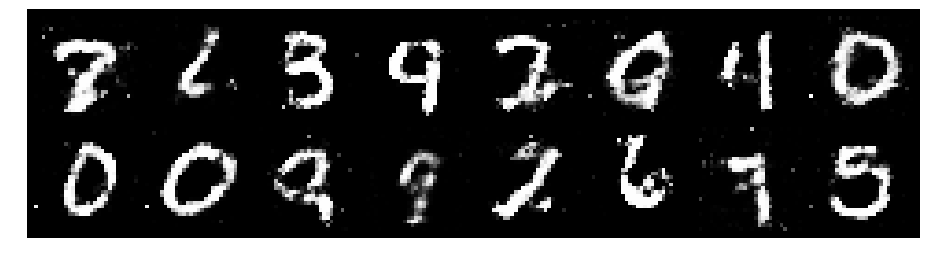

Epoch: [65/200], Batch Num: [100/600]
Discriminator Loss: 1.2789, Generator Loss: 0.9412
D(x): 0.5397, D(G(z)): 0.4250


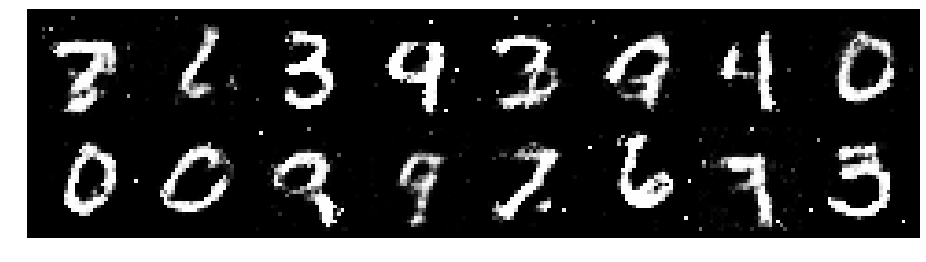

Epoch: [65/200], Batch Num: [200/600]
Discriminator Loss: 1.3608, Generator Loss: 0.8444
D(x): 0.5543, D(G(z)): 0.4751


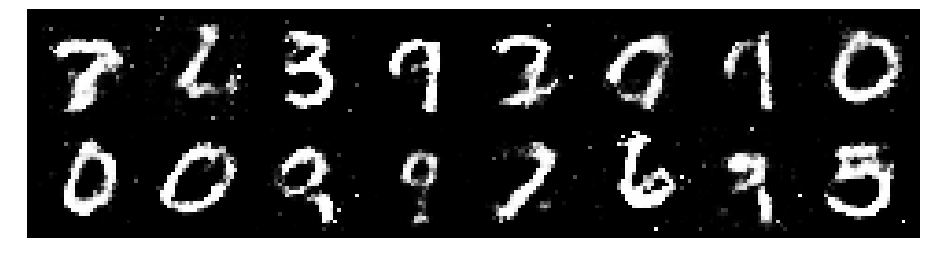

Epoch: [65/200], Batch Num: [300/600]
Discriminator Loss: 1.3616, Generator Loss: 0.8200
D(x): 0.5034, D(G(z)): 0.4337


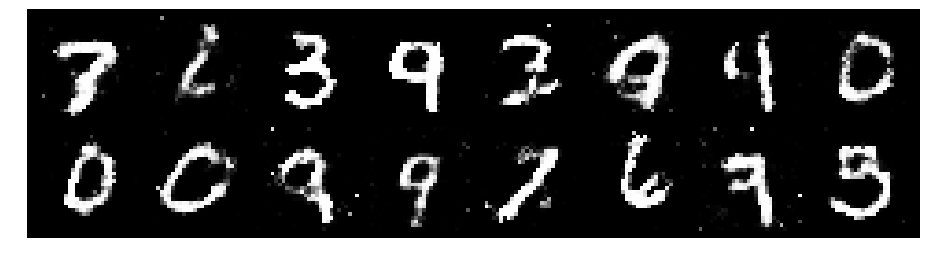

Epoch: [65/200], Batch Num: [400/600]
Discriminator Loss: 1.4382, Generator Loss: 0.9867
D(x): 0.5576, D(G(z)): 0.4750


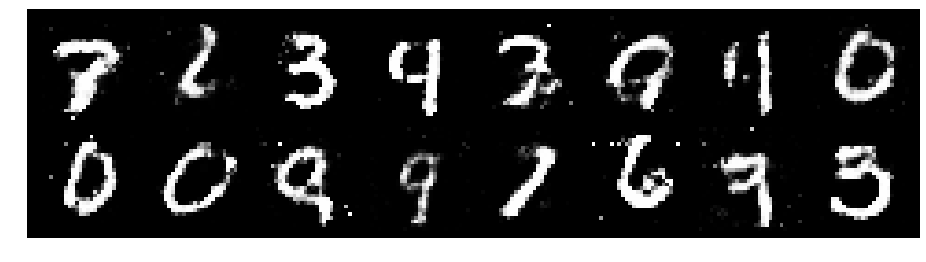

Epoch: [65/200], Batch Num: [500/600]
Discriminator Loss: 1.2669, Generator Loss: 1.2508
D(x): 0.6024, D(G(z)): 0.4246


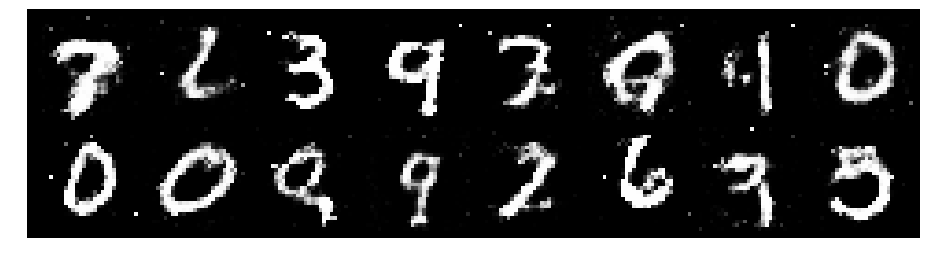

Epoch: [66/200], Batch Num: [0/600]
Discriminator Loss: 1.2311, Generator Loss: 1.0520
D(x): 0.5395, D(G(z)): 0.3844


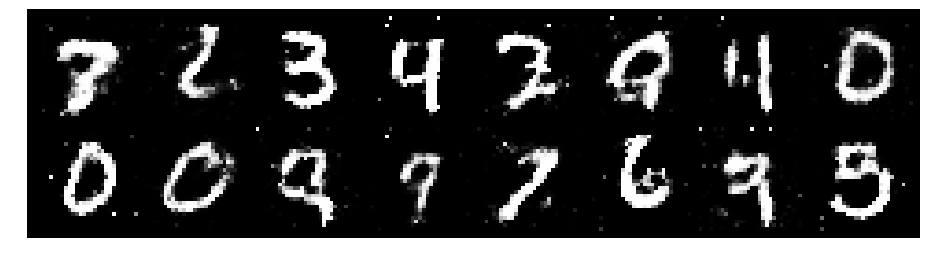

Epoch: [66/200], Batch Num: [100/600]
Discriminator Loss: 1.1948, Generator Loss: 0.9774
D(x): 0.6582, D(G(z)): 0.4519


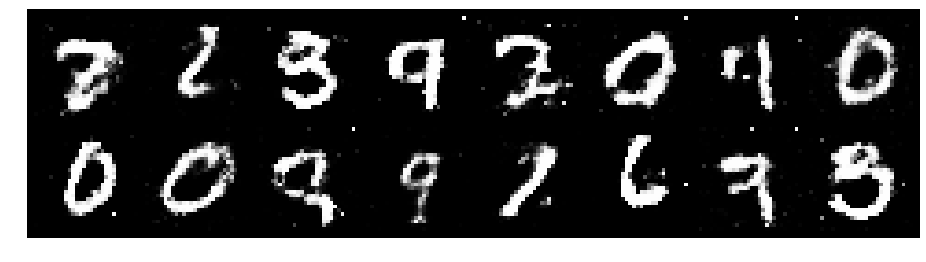

Epoch: [66/200], Batch Num: [200/600]
Discriminator Loss: 1.2030, Generator Loss: 0.9457
D(x): 0.6086, D(G(z)): 0.4498


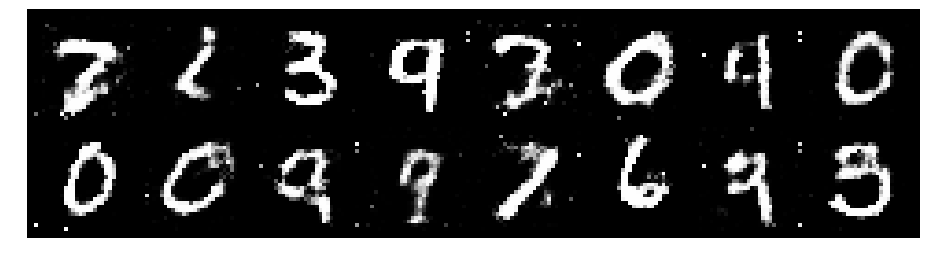

Epoch: [66/200], Batch Num: [300/600]
Discriminator Loss: 1.2250, Generator Loss: 1.1407
D(x): 0.5773, D(G(z)): 0.4047


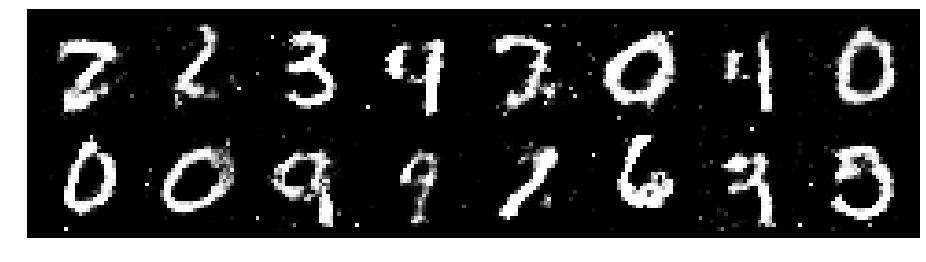

Epoch: [66/200], Batch Num: [400/600]
Discriminator Loss: 1.2344, Generator Loss: 1.0181
D(x): 0.5844, D(G(z)): 0.4299


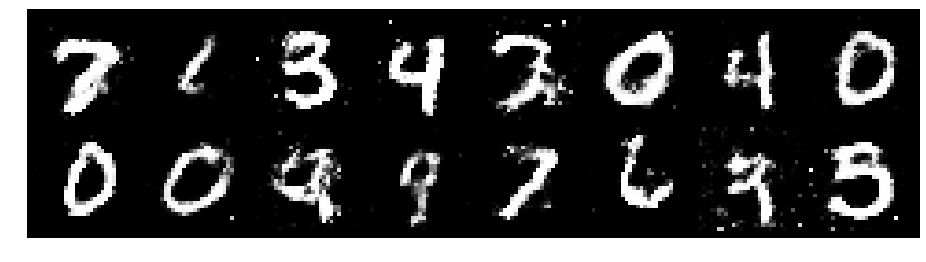

Epoch: [66/200], Batch Num: [500/600]
Discriminator Loss: 1.1086, Generator Loss: 1.0471
D(x): 0.5881, D(G(z)): 0.3805


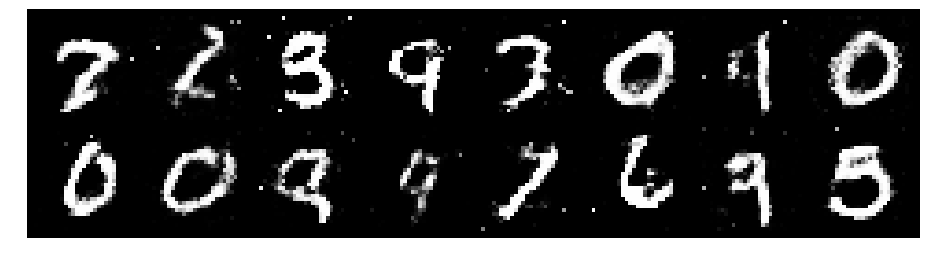

Epoch: [67/200], Batch Num: [0/600]
Discriminator Loss: 1.0645, Generator Loss: 1.0836
D(x): 0.6372, D(G(z)): 0.3914


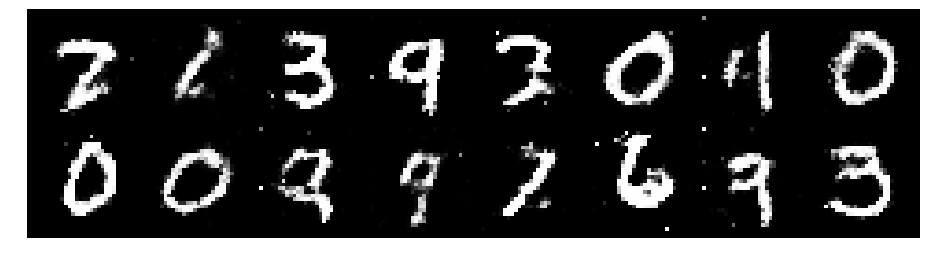

Epoch: [67/200], Batch Num: [100/600]
Discriminator Loss: 1.1595, Generator Loss: 0.8877
D(x): 0.5675, D(G(z)): 0.3945


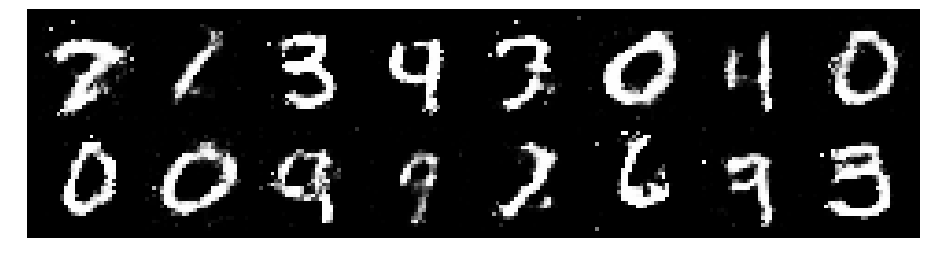

Epoch: [67/200], Batch Num: [200/600]
Discriminator Loss: 1.1855, Generator Loss: 0.9278
D(x): 0.6661, D(G(z)): 0.4711


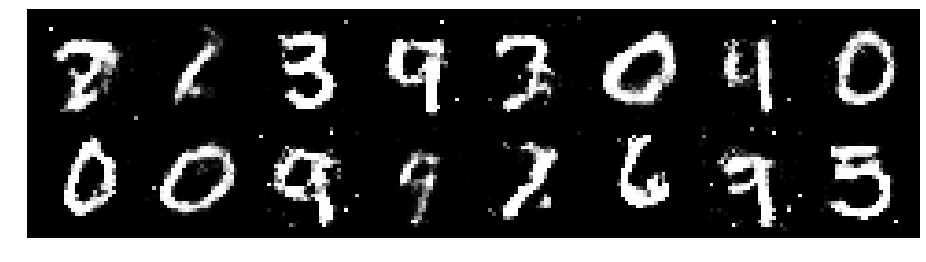

Epoch: [67/200], Batch Num: [300/600]
Discriminator Loss: 1.2301, Generator Loss: 1.0965
D(x): 0.5796, D(G(z)): 0.4111


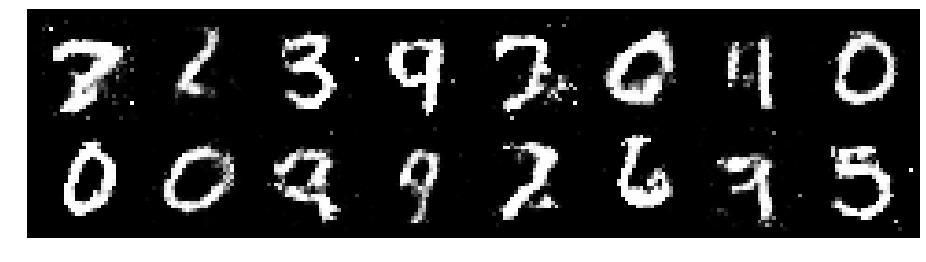

Epoch: [67/200], Batch Num: [400/600]
Discriminator Loss: 1.1253, Generator Loss: 0.9964
D(x): 0.6890, D(G(z)): 0.4576


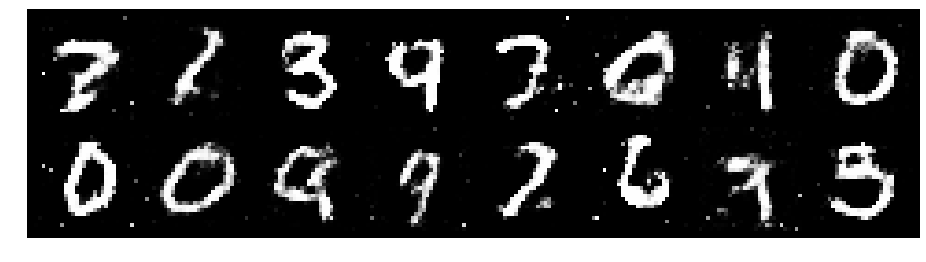

Epoch: [67/200], Batch Num: [500/600]
Discriminator Loss: 1.0894, Generator Loss: 1.2665
D(x): 0.5770, D(G(z)): 0.3469


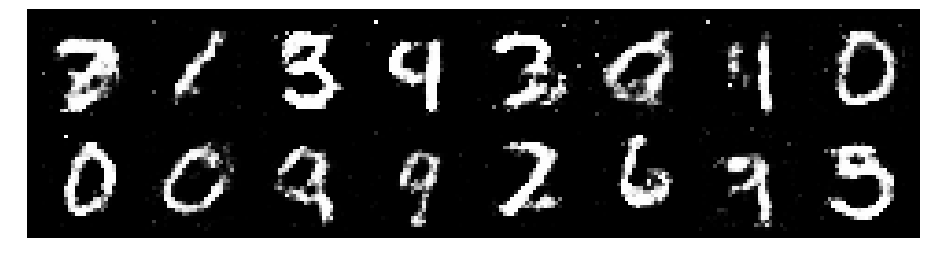

Epoch: [68/200], Batch Num: [0/600]
Discriminator Loss: 1.2981, Generator Loss: 0.9915
D(x): 0.5165, D(G(z)): 0.3987


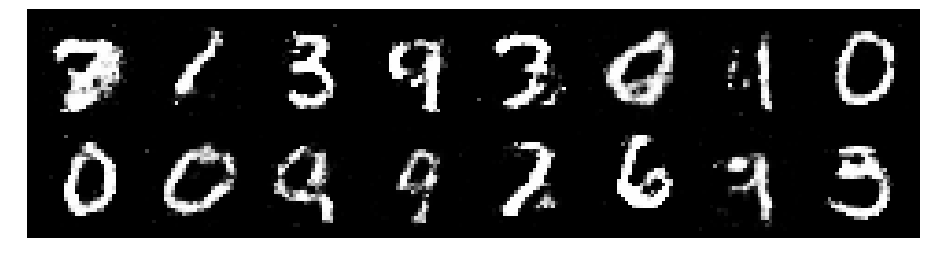

Epoch: [68/200], Batch Num: [100/600]
Discriminator Loss: 1.1295, Generator Loss: 1.1436
D(x): 0.6016, D(G(z)): 0.3700


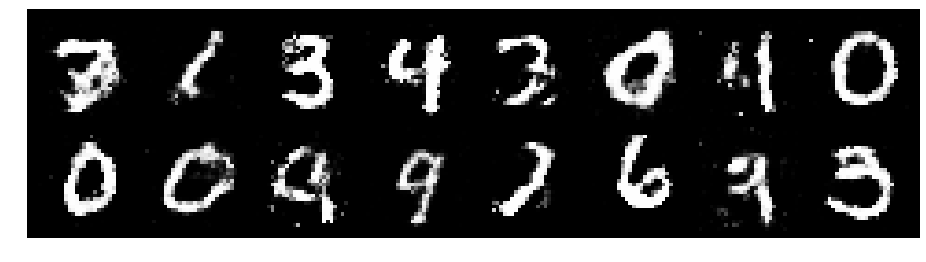

Epoch: [68/200], Batch Num: [200/600]
Discriminator Loss: 1.2677, Generator Loss: 0.8778
D(x): 0.5683, D(G(z)): 0.4389


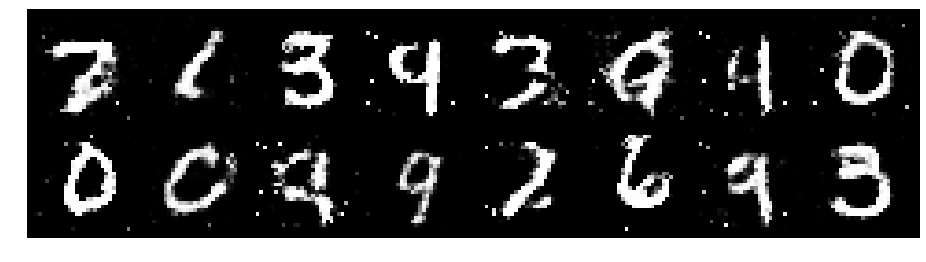

Epoch: [68/200], Batch Num: [300/600]
Discriminator Loss: 1.2326, Generator Loss: 0.9973
D(x): 0.5726, D(G(z)): 0.4218


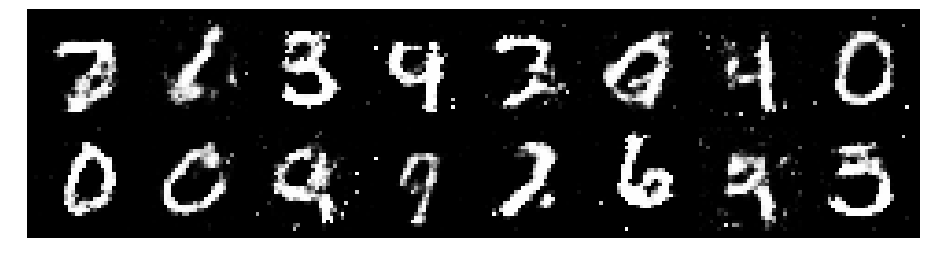

Epoch: [68/200], Batch Num: [400/600]
Discriminator Loss: 1.1582, Generator Loss: 1.0036
D(x): 0.5783, D(G(z)): 0.3970


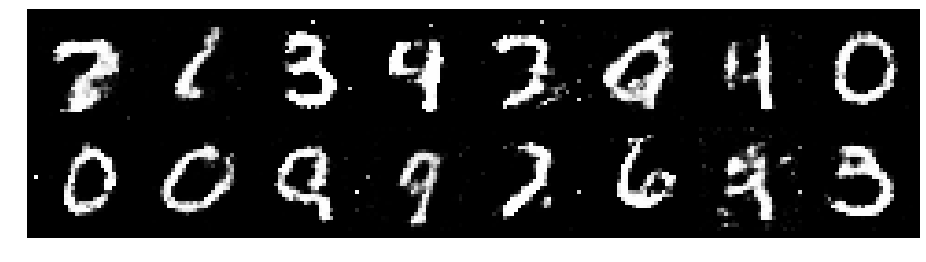

Epoch: [68/200], Batch Num: [500/600]
Discriminator Loss: 1.2170, Generator Loss: 0.9400
D(x): 0.6083, D(G(z)): 0.4565


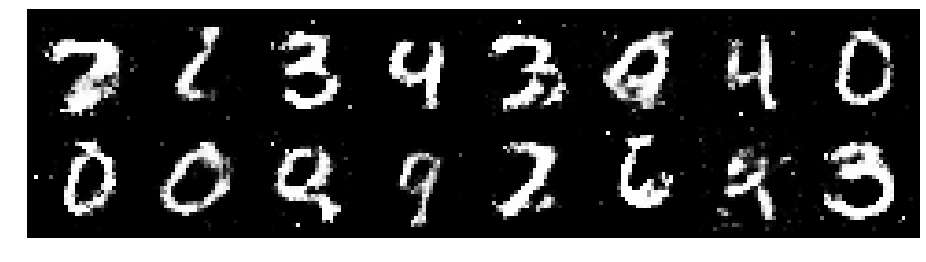

Epoch: [69/200], Batch Num: [0/600]
Discriminator Loss: 1.1876, Generator Loss: 1.0026
D(x): 0.5662, D(G(z)): 0.4126


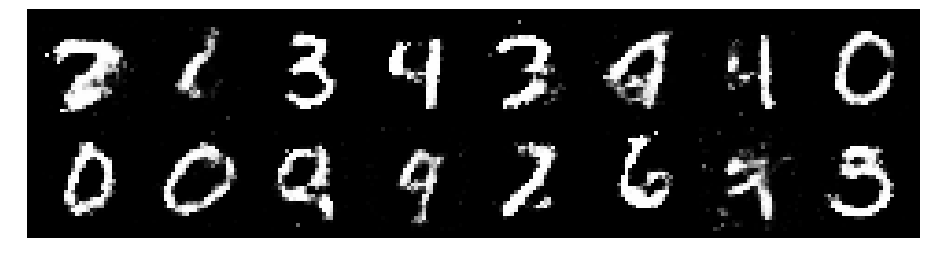

Epoch: [69/200], Batch Num: [100/600]
Discriminator Loss: 1.1823, Generator Loss: 1.0449
D(x): 0.5607, D(G(z)): 0.3950


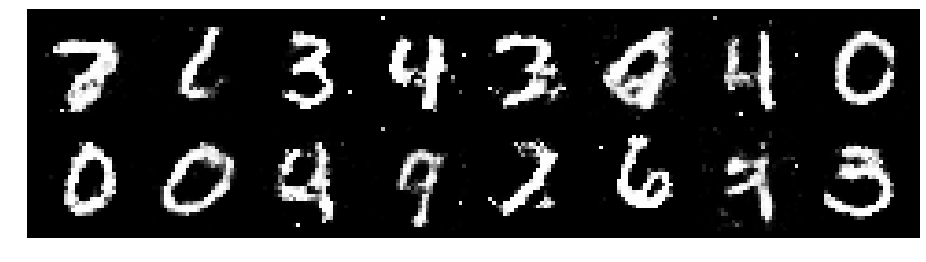

Epoch: [69/200], Batch Num: [200/600]
Discriminator Loss: 0.9885, Generator Loss: 1.1595
D(x): 0.6452, D(G(z)): 0.3372


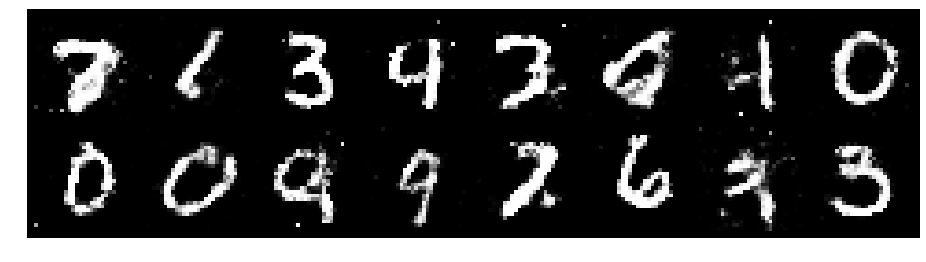

Epoch: [69/200], Batch Num: [300/600]
Discriminator Loss: 1.1214, Generator Loss: 1.0838
D(x): 0.5509, D(G(z)): 0.3551


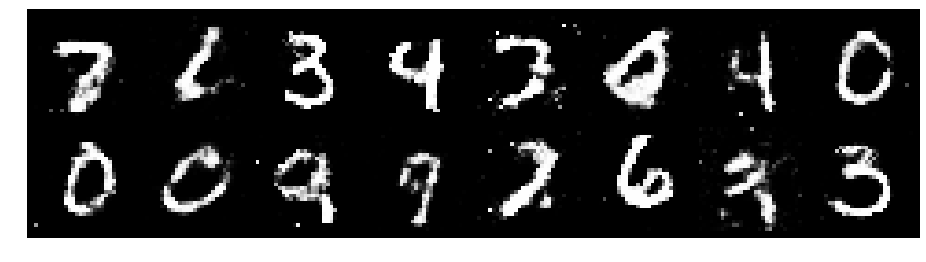

Epoch: [69/200], Batch Num: [400/600]
Discriminator Loss: 1.2443, Generator Loss: 1.0227
D(x): 0.5694, D(G(z)): 0.4166


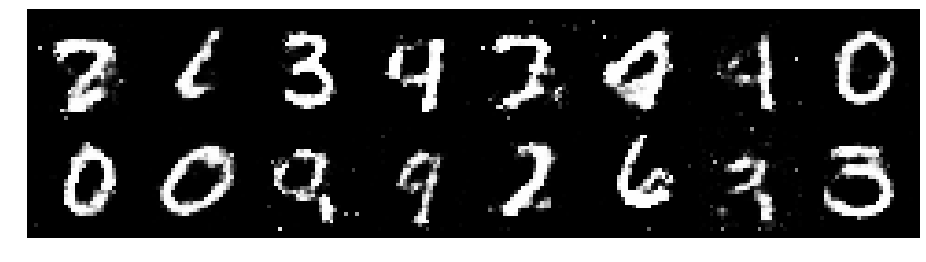

Epoch: [69/200], Batch Num: [500/600]
Discriminator Loss: 1.2787, Generator Loss: 1.0852
D(x): 0.5712, D(G(z)): 0.4205


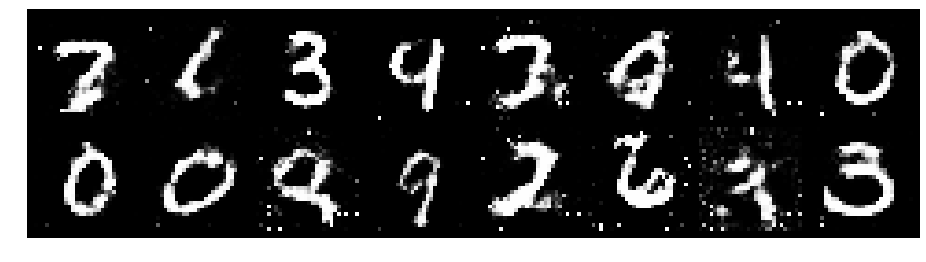

Epoch: [70/200], Batch Num: [0/600]
Discriminator Loss: 1.2606, Generator Loss: 0.9386
D(x): 0.5487, D(G(z)): 0.4295


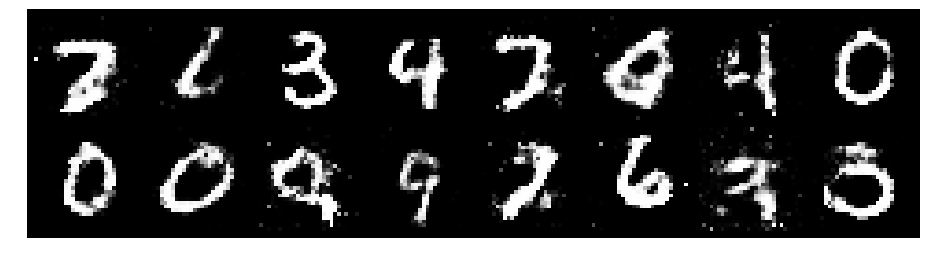

Epoch: [70/200], Batch Num: [100/600]
Discriminator Loss: 1.2148, Generator Loss: 1.1145
D(x): 0.5754, D(G(z)): 0.4297


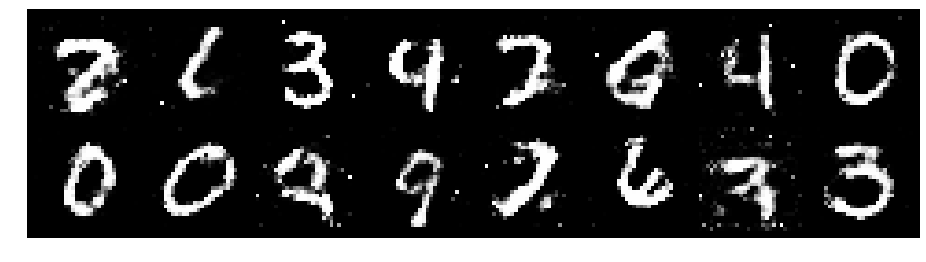

Epoch: [70/200], Batch Num: [200/600]
Discriminator Loss: 1.1930, Generator Loss: 0.9903
D(x): 0.5699, D(G(z)): 0.3983


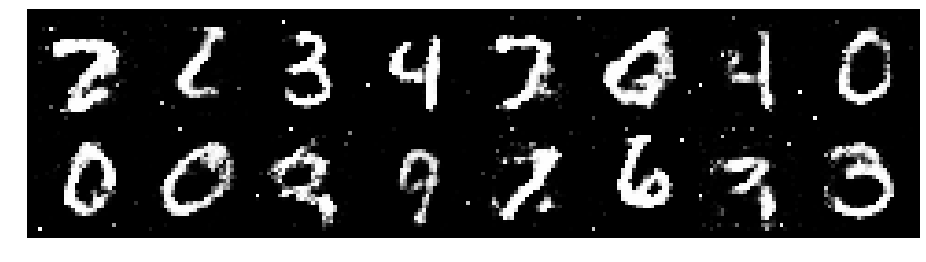

Epoch: [70/200], Batch Num: [300/600]
Discriminator Loss: 1.2334, Generator Loss: 1.0703
D(x): 0.5979, D(G(z)): 0.4009


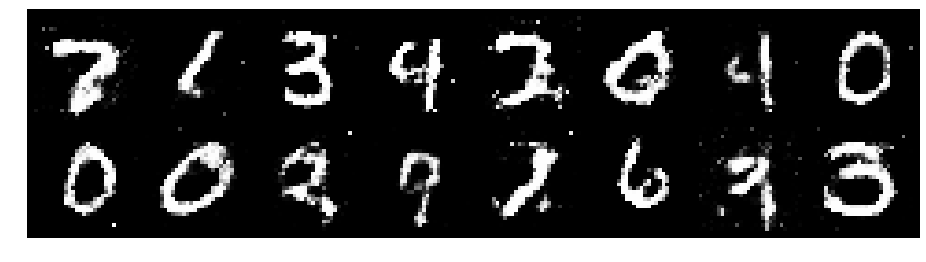

Epoch: [70/200], Batch Num: [400/600]
Discriminator Loss: 1.3356, Generator Loss: 0.9038
D(x): 0.5919, D(G(z)): 0.4927


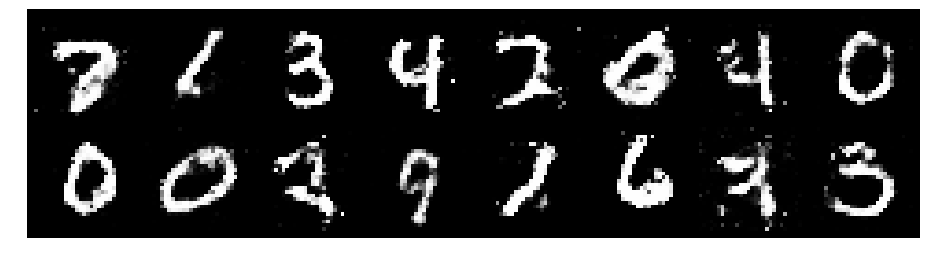

Epoch: [70/200], Batch Num: [500/600]
Discriminator Loss: 1.1901, Generator Loss: 0.8346
D(x): 0.6079, D(G(z)): 0.4655


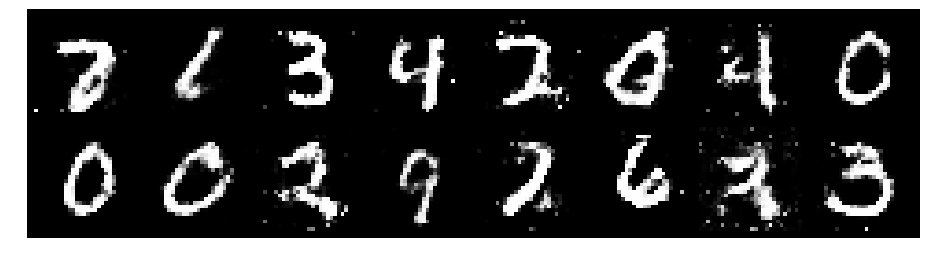

Epoch: [71/200], Batch Num: [0/600]
Discriminator Loss: 1.1564, Generator Loss: 0.9589
D(x): 0.6227, D(G(z)): 0.4237


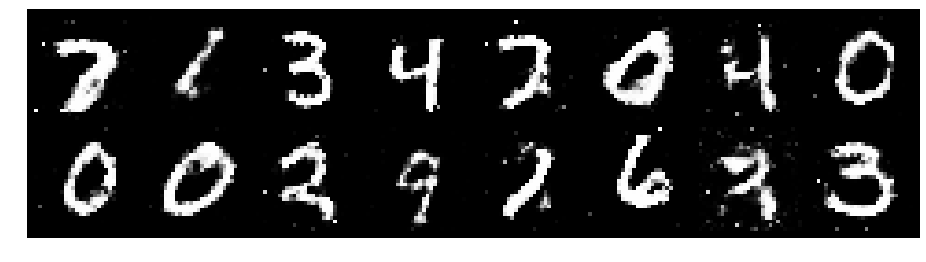

Epoch: [71/200], Batch Num: [100/600]
Discriminator Loss: 1.2721, Generator Loss: 0.8351
D(x): 0.5315, D(G(z)): 0.4244


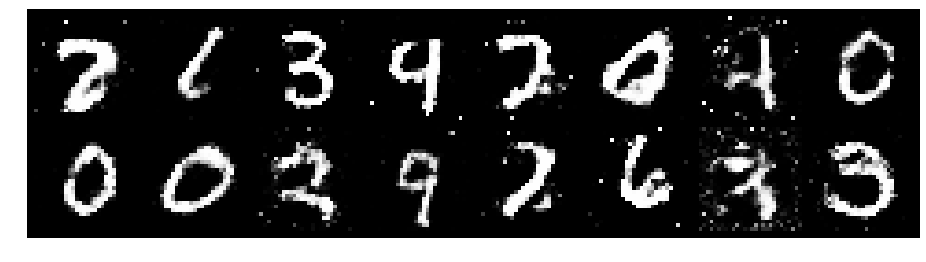

Epoch: [71/200], Batch Num: [200/600]
Discriminator Loss: 1.2743, Generator Loss: 1.0079
D(x): 0.5550, D(G(z)): 0.4438


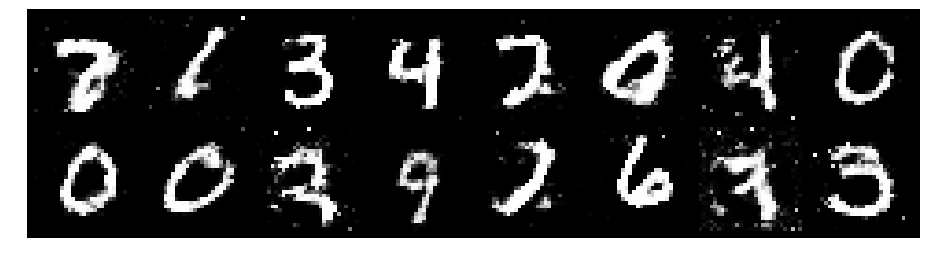

Epoch: [71/200], Batch Num: [300/600]
Discriminator Loss: 1.1597, Generator Loss: 1.0707
D(x): 0.5906, D(G(z)): 0.3919


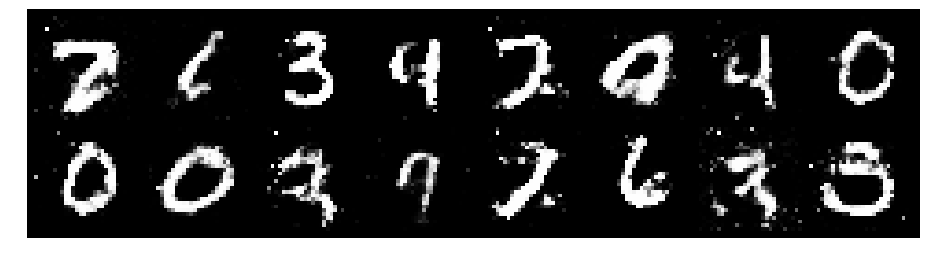

Epoch: [71/200], Batch Num: [400/600]
Discriminator Loss: 1.2257, Generator Loss: 0.9863
D(x): 0.5819, D(G(z)): 0.4384


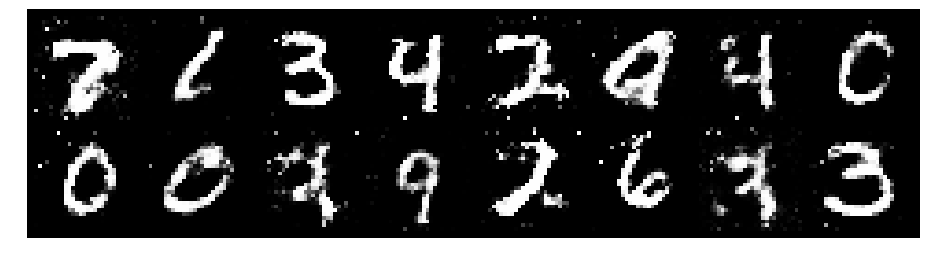

Epoch: [71/200], Batch Num: [500/600]
Discriminator Loss: 1.2496, Generator Loss: 0.8975
D(x): 0.6117, D(G(z)): 0.4535


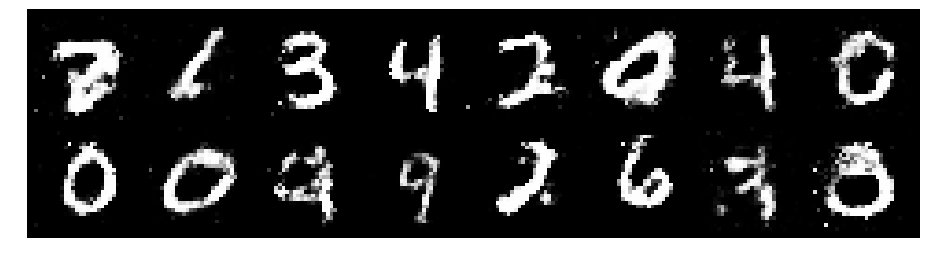

Epoch: [72/200], Batch Num: [0/600]
Discriminator Loss: 1.1567, Generator Loss: 1.0020
D(x): 0.6189, D(G(z)): 0.4378


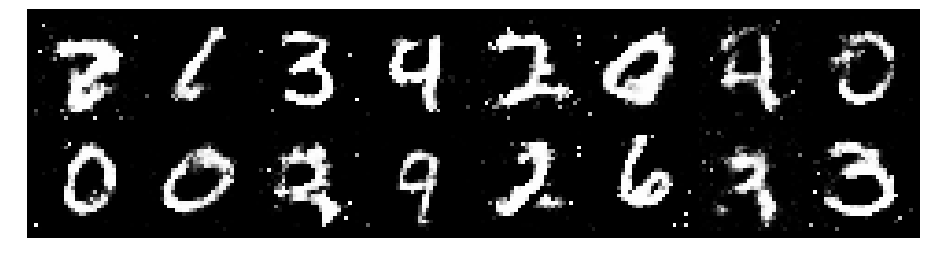

Epoch: [72/200], Batch Num: [100/600]
Discriminator Loss: 1.1816, Generator Loss: 1.1626
D(x): 0.5821, D(G(z)): 0.4042


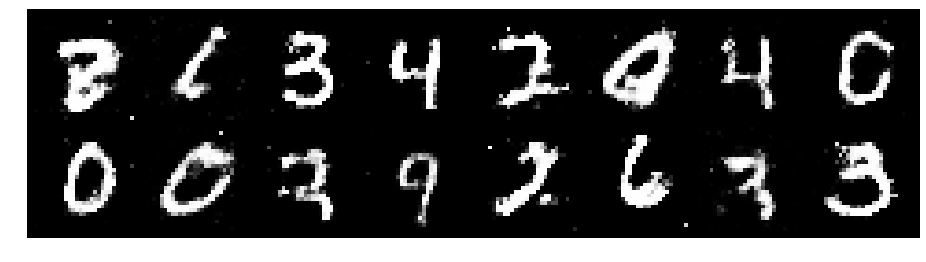

Epoch: [72/200], Batch Num: [200/600]
Discriminator Loss: 1.2501, Generator Loss: 1.0627
D(x): 0.6076, D(G(z)): 0.4256


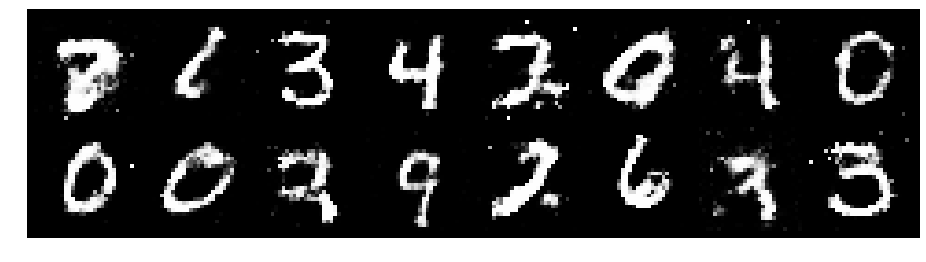

Epoch: [72/200], Batch Num: [300/600]
Discriminator Loss: 1.2482, Generator Loss: 1.0104
D(x): 0.5717, D(G(z)): 0.4202


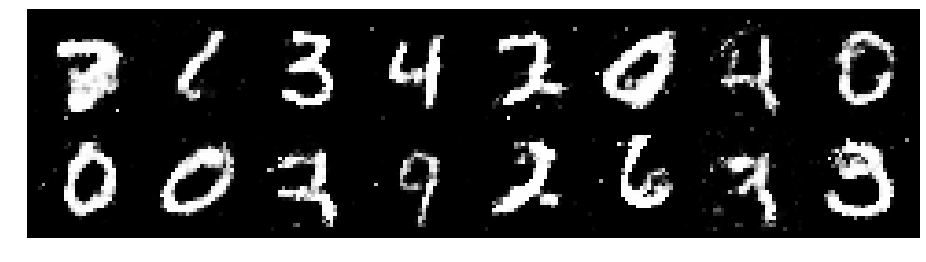

Epoch: [72/200], Batch Num: [400/600]
Discriminator Loss: 1.2964, Generator Loss: 1.0062
D(x): 0.5809, D(G(z)): 0.4632


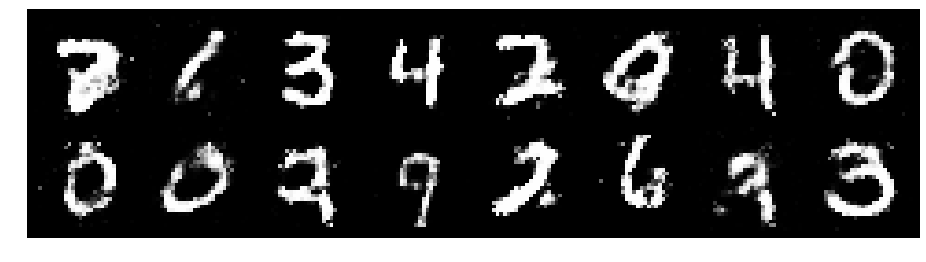

Epoch: [72/200], Batch Num: [500/600]
Discriminator Loss: 1.1843, Generator Loss: 0.9750
D(x): 0.5970, D(G(z)): 0.4010


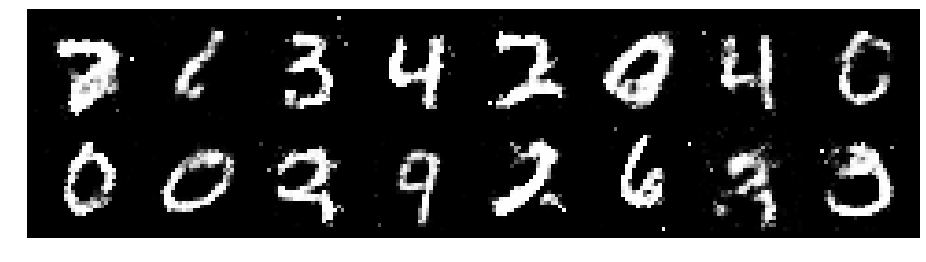

Epoch: [73/200], Batch Num: [0/600]
Discriminator Loss: 1.2904, Generator Loss: 0.9471
D(x): 0.5157, D(G(z)): 0.4110


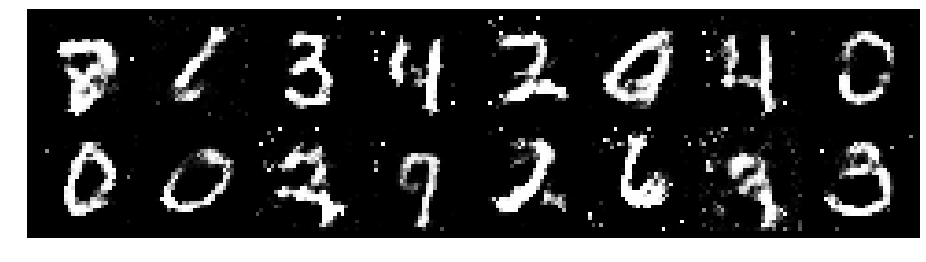

Epoch: [73/200], Batch Num: [100/600]
Discriminator Loss: 1.2454, Generator Loss: 0.9272
D(x): 0.6061, D(G(z)): 0.4470


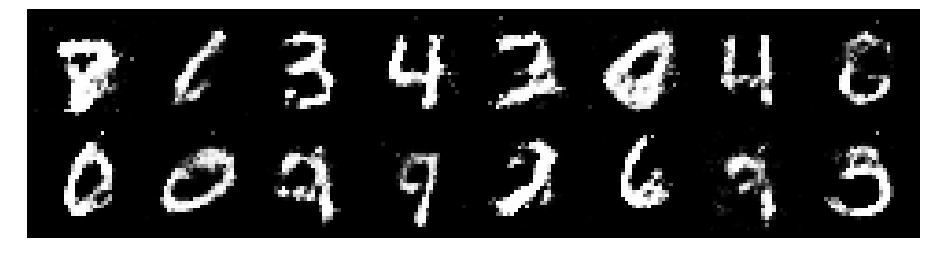

Epoch: [73/200], Batch Num: [200/600]
Discriminator Loss: 1.2022, Generator Loss: 0.9133
D(x): 0.6021, D(G(z)): 0.4479


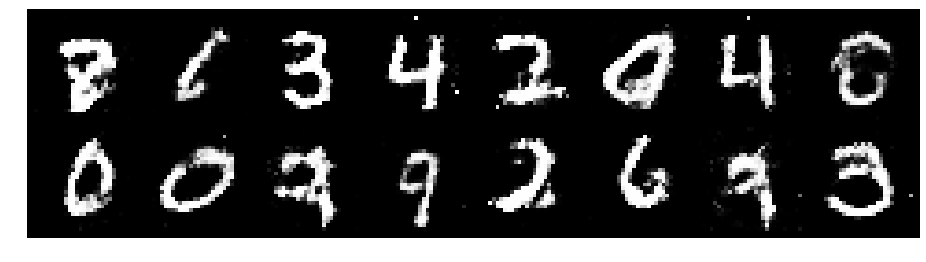

Epoch: [73/200], Batch Num: [300/600]
Discriminator Loss: 1.2090, Generator Loss: 0.8572
D(x): 0.5711, D(G(z)): 0.4316


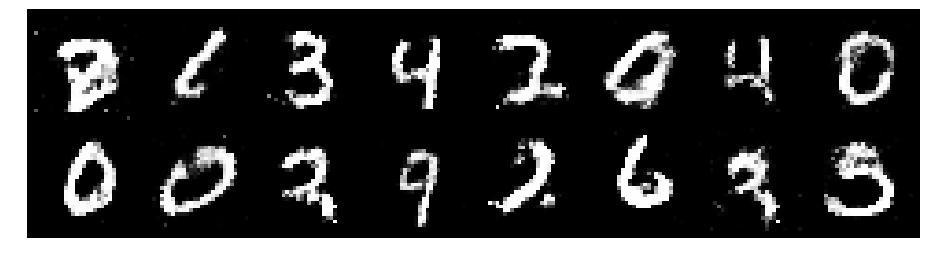

Epoch: [73/200], Batch Num: [400/600]
Discriminator Loss: 1.0964, Generator Loss: 1.0495
D(x): 0.5811, D(G(z)): 0.3756


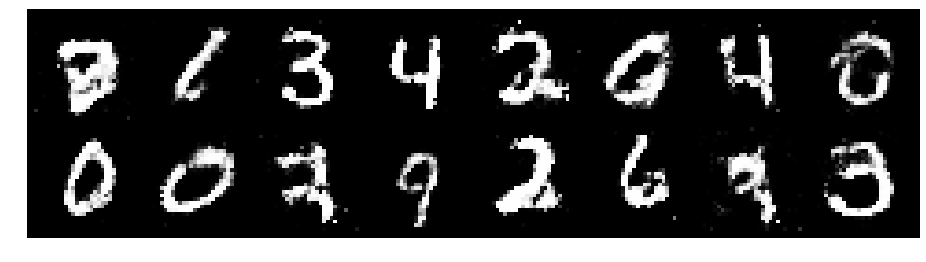

Epoch: [73/200], Batch Num: [500/600]
Discriminator Loss: 1.1270, Generator Loss: 0.9272
D(x): 0.5990, D(G(z)): 0.4033


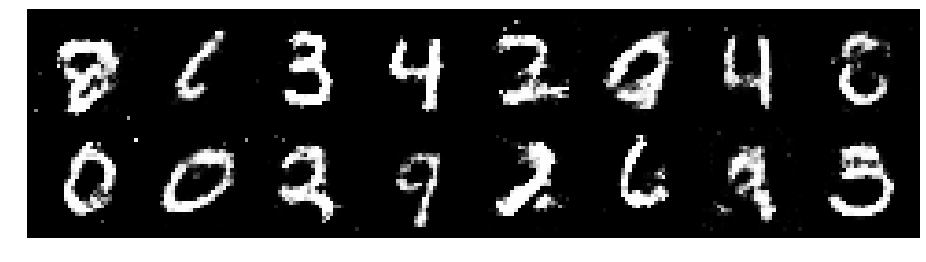

Epoch: [74/200], Batch Num: [0/600]
Discriminator Loss: 1.1752, Generator Loss: 0.9619
D(x): 0.5682, D(G(z)): 0.4092


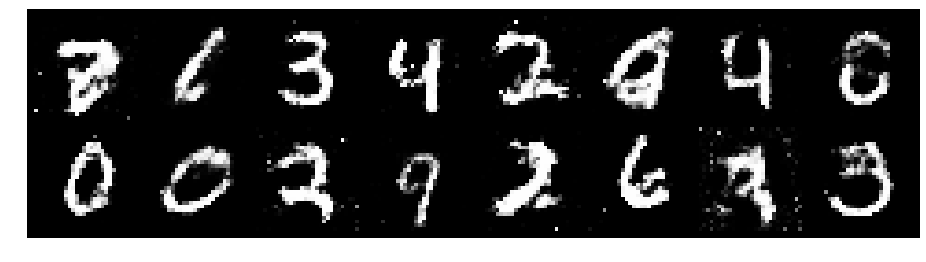

Epoch: [74/200], Batch Num: [100/600]
Discriminator Loss: 1.1231, Generator Loss: 0.9208
D(x): 0.6063, D(G(z)): 0.4137


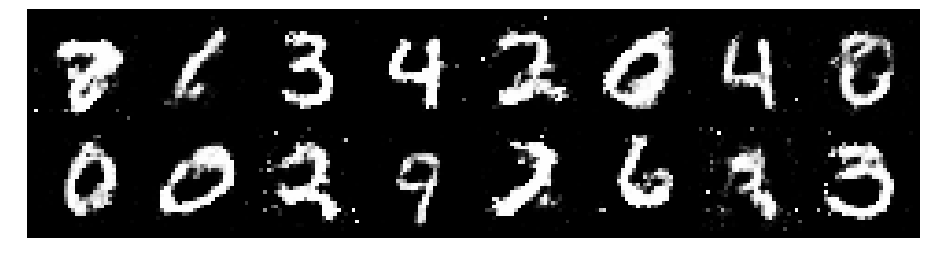

Epoch: [74/200], Batch Num: [200/600]
Discriminator Loss: 1.2798, Generator Loss: 0.9130
D(x): 0.5993, D(G(z)): 0.4824


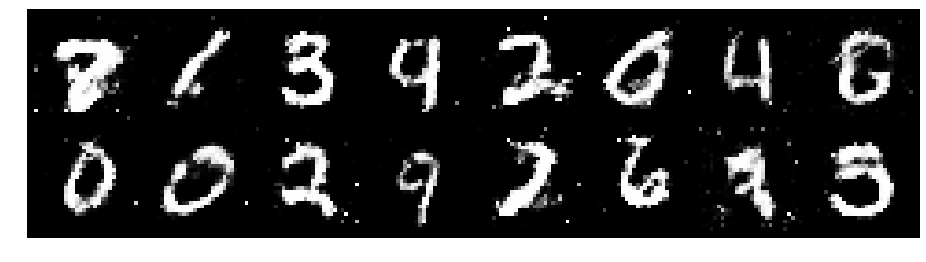

Epoch: [74/200], Batch Num: [300/600]
Discriminator Loss: 1.2301, Generator Loss: 0.9570
D(x): 0.5663, D(G(z)): 0.4260


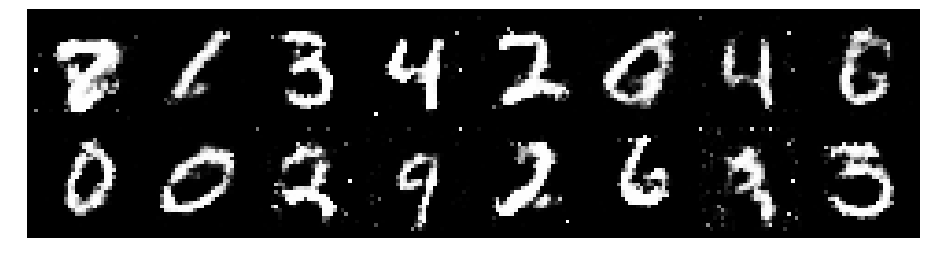

Epoch: [74/200], Batch Num: [400/600]
Discriminator Loss: 1.2088, Generator Loss: 1.0718
D(x): 0.6127, D(G(z)): 0.4044


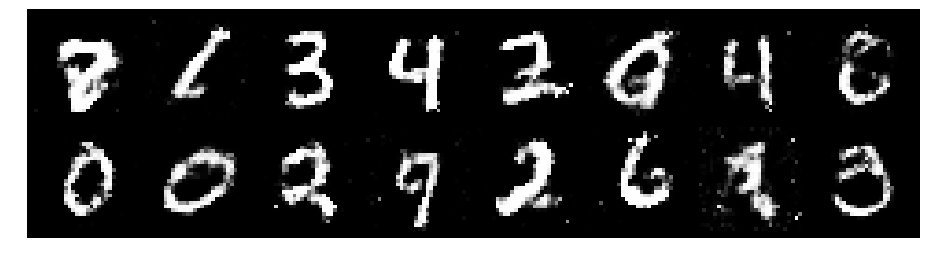

Epoch: [74/200], Batch Num: [500/600]
Discriminator Loss: 1.1277, Generator Loss: 1.0635
D(x): 0.5804, D(G(z)): 0.3611


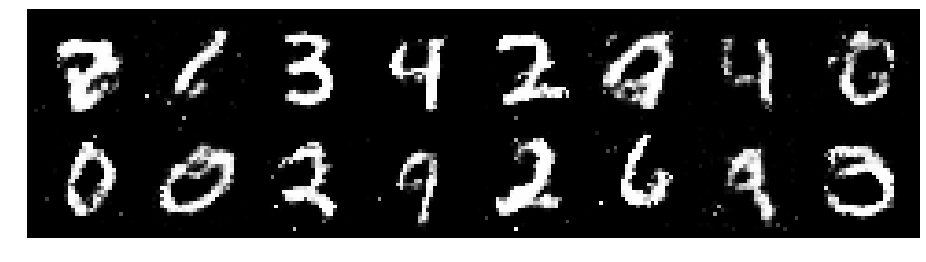

Epoch: [75/200], Batch Num: [0/600]
Discriminator Loss: 1.2907, Generator Loss: 0.8457
D(x): 0.5895, D(G(z)): 0.4715


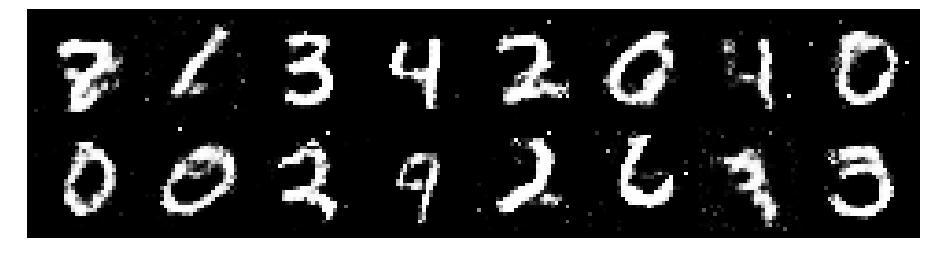

Epoch: [75/200], Batch Num: [100/600]
Discriminator Loss: 1.1463, Generator Loss: 1.0682
D(x): 0.5771, D(G(z)): 0.3980


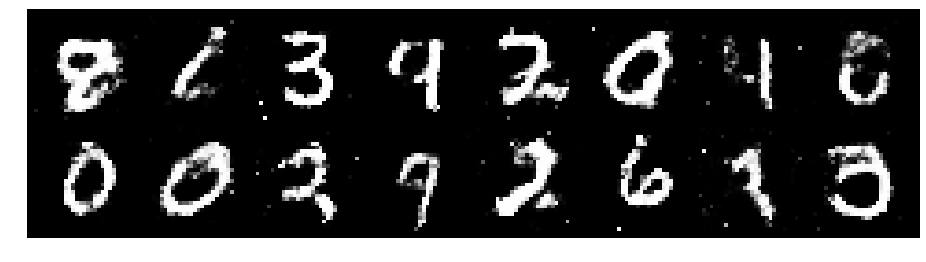

Epoch: [75/200], Batch Num: [200/600]
Discriminator Loss: 1.3081, Generator Loss: 0.9481
D(x): 0.5445, D(G(z)): 0.4448


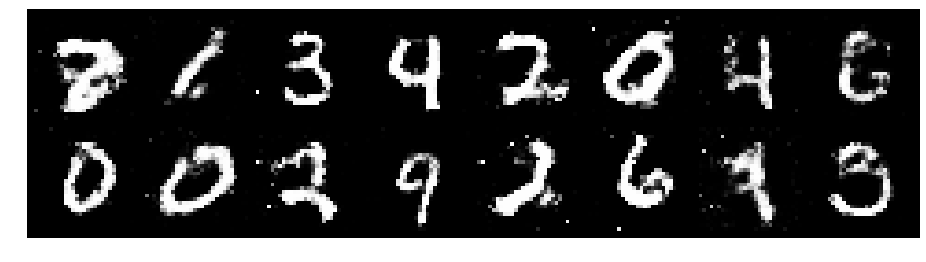

Epoch: [75/200], Batch Num: [300/600]
Discriminator Loss: 1.1444, Generator Loss: 0.9255
D(x): 0.6111, D(G(z)): 0.4213


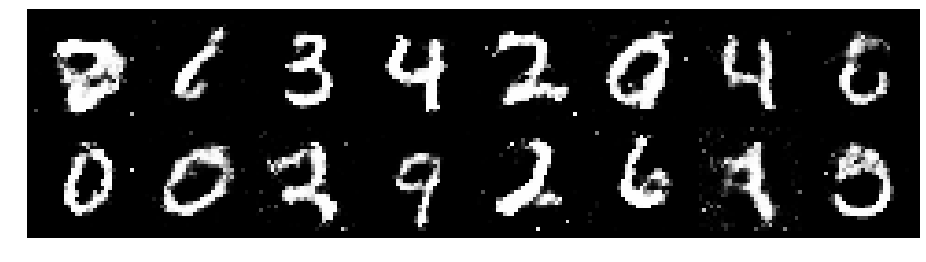

Epoch: [75/200], Batch Num: [400/600]
Discriminator Loss: 1.2340, Generator Loss: 0.9853
D(x): 0.5735, D(G(z)): 0.4228


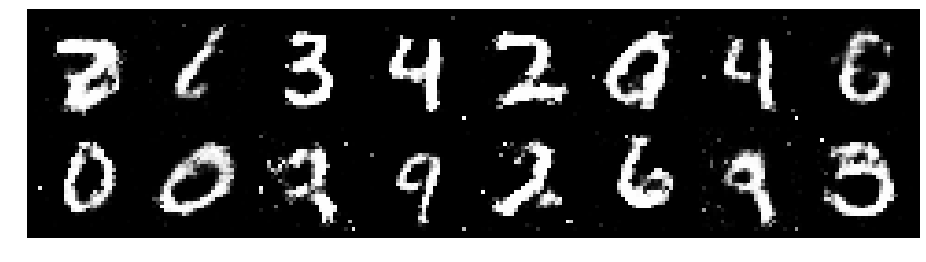

Epoch: [75/200], Batch Num: [500/600]
Discriminator Loss: 1.1537, Generator Loss: 0.9644
D(x): 0.6146, D(G(z)): 0.4253


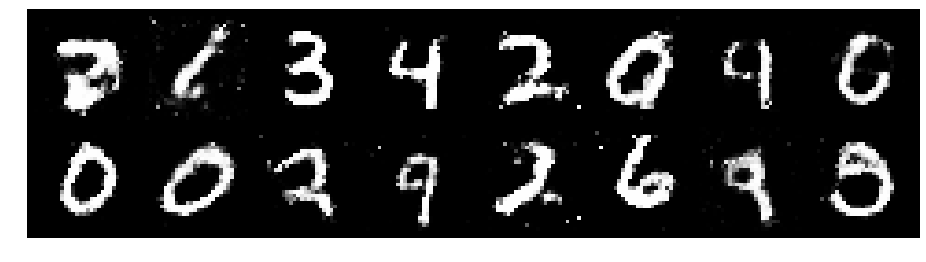

Epoch: [76/200], Batch Num: [0/600]
Discriminator Loss: 1.1571, Generator Loss: 1.0437
D(x): 0.5816, D(G(z)): 0.4064


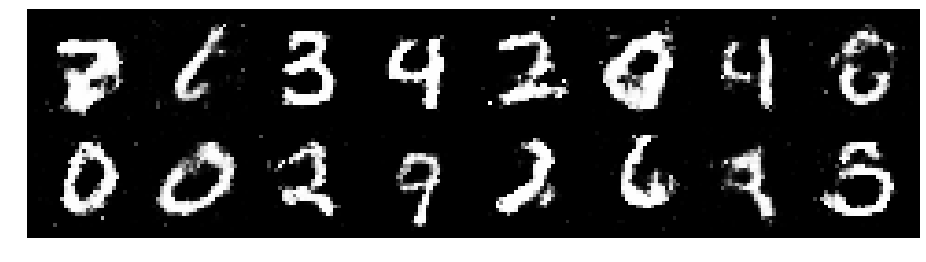

Epoch: [76/200], Batch Num: [100/600]
Discriminator Loss: 1.3248, Generator Loss: 1.0947
D(x): 0.5559, D(G(z)): 0.4255


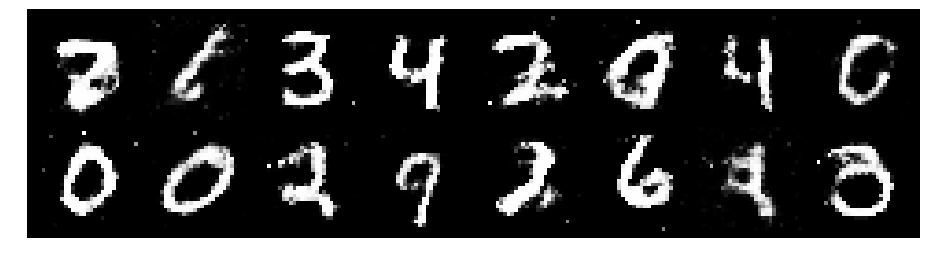

Epoch: [76/200], Batch Num: [200/600]
Discriminator Loss: 1.3503, Generator Loss: 0.7885
D(x): 0.5872, D(G(z)): 0.4797


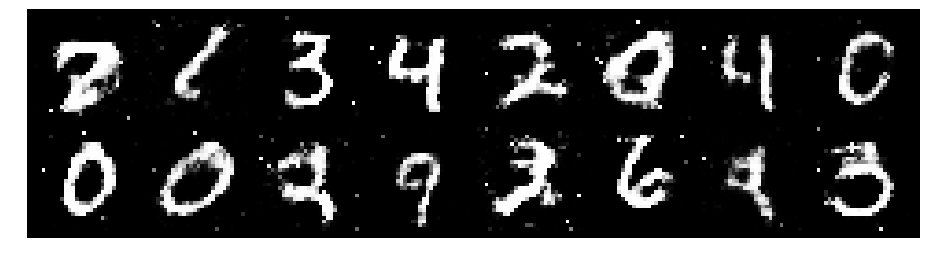

Epoch: [76/200], Batch Num: [300/600]
Discriminator Loss: 1.3460, Generator Loss: 1.0395
D(x): 0.5757, D(G(z)): 0.4763


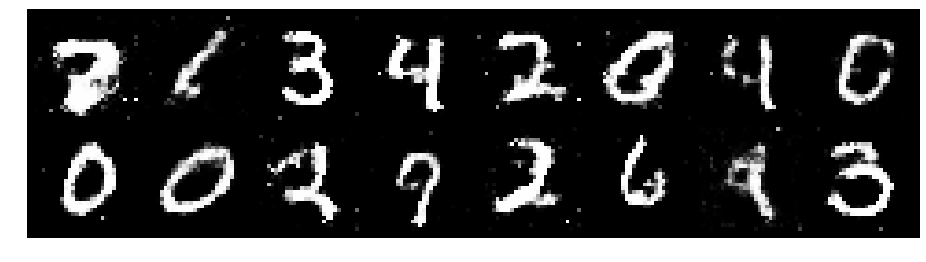

Epoch: [76/200], Batch Num: [400/600]
Discriminator Loss: 1.2275, Generator Loss: 0.9505
D(x): 0.5659, D(G(z)): 0.4000


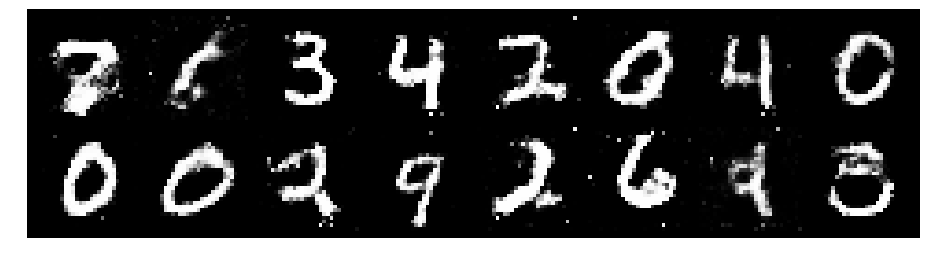

Epoch: [76/200], Batch Num: [500/600]
Discriminator Loss: 1.2616, Generator Loss: 0.8791
D(x): 0.5544, D(G(z)): 0.4231


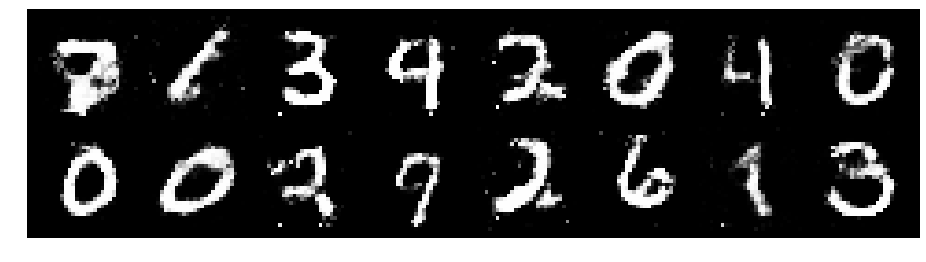

Epoch: [77/200], Batch Num: [0/600]
Discriminator Loss: 1.2481, Generator Loss: 0.9425
D(x): 0.5601, D(G(z)): 0.4198


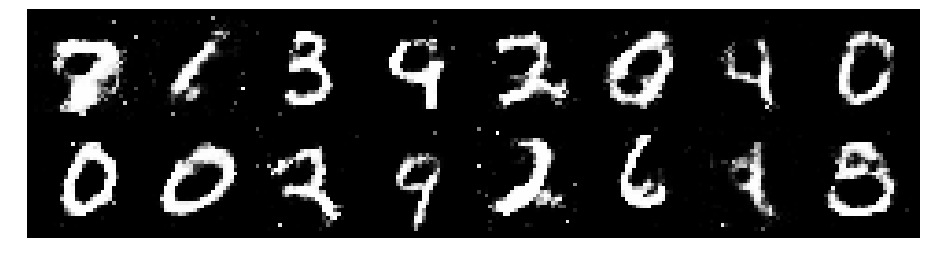

Epoch: [77/200], Batch Num: [100/600]
Discriminator Loss: 1.2763, Generator Loss: 0.8878
D(x): 0.5550, D(G(z)): 0.4501


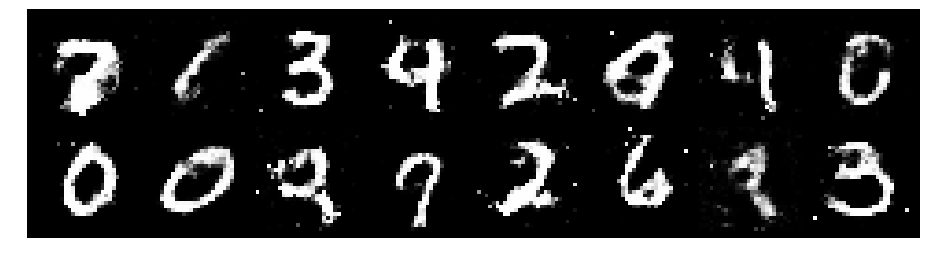

Epoch: [77/200], Batch Num: [200/600]
Discriminator Loss: 1.1137, Generator Loss: 1.1079
D(x): 0.5799, D(G(z)): 0.3624


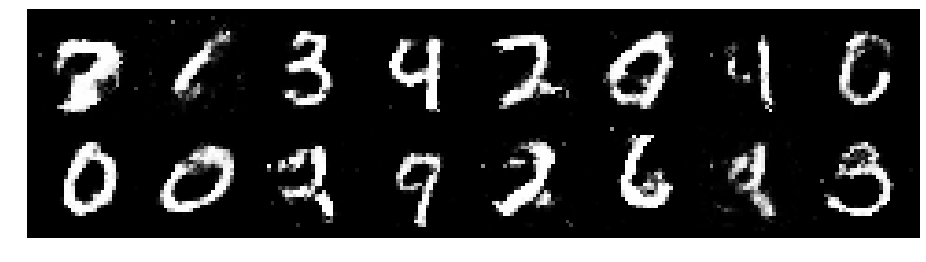

Epoch: [77/200], Batch Num: [300/600]
Discriminator Loss: 1.2157, Generator Loss: 0.9529
D(x): 0.6368, D(G(z)): 0.4773


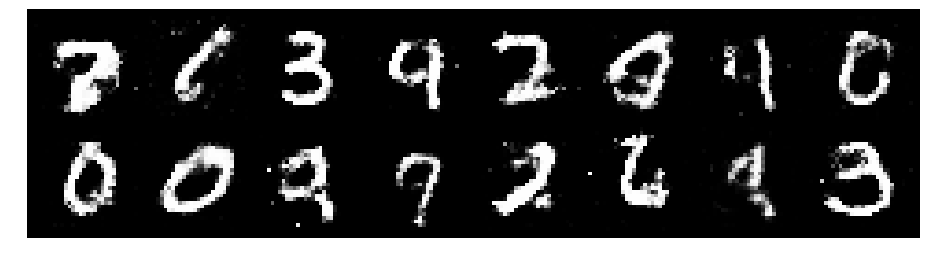

Epoch: [77/200], Batch Num: [400/600]
Discriminator Loss: 1.2694, Generator Loss: 0.8905
D(x): 0.5411, D(G(z)): 0.4470


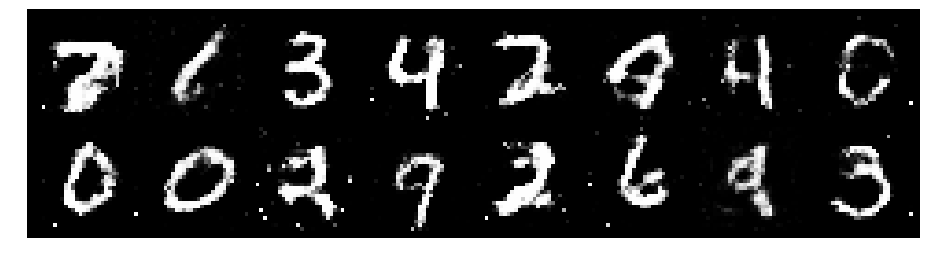

Epoch: [77/200], Batch Num: [500/600]
Discriminator Loss: 1.1215, Generator Loss: 0.9580
D(x): 0.5845, D(G(z)): 0.3977


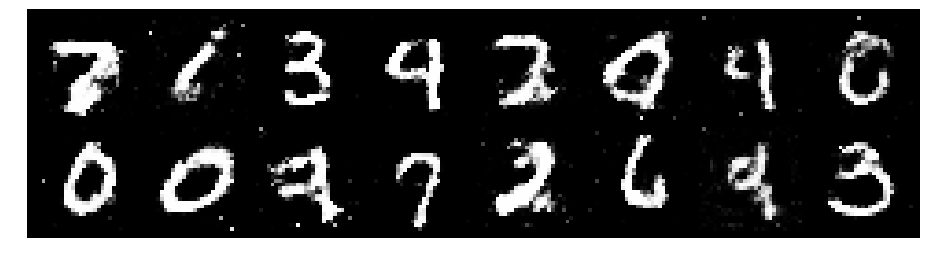

Epoch: [78/200], Batch Num: [0/600]
Discriminator Loss: 1.2192, Generator Loss: 0.9670
D(x): 0.5502, D(G(z)): 0.4185


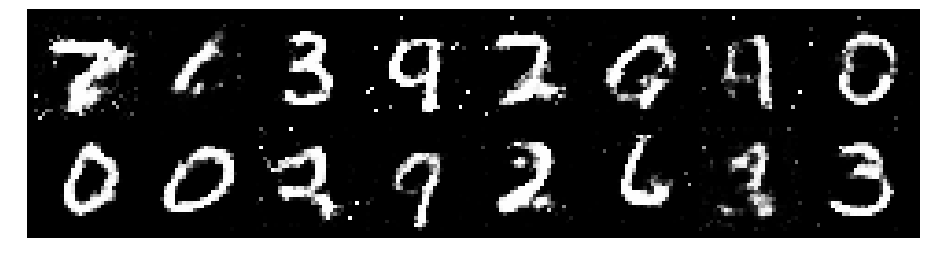

Epoch: [78/200], Batch Num: [100/600]
Discriminator Loss: 1.2551, Generator Loss: 0.8613
D(x): 0.5809, D(G(z)): 0.4571


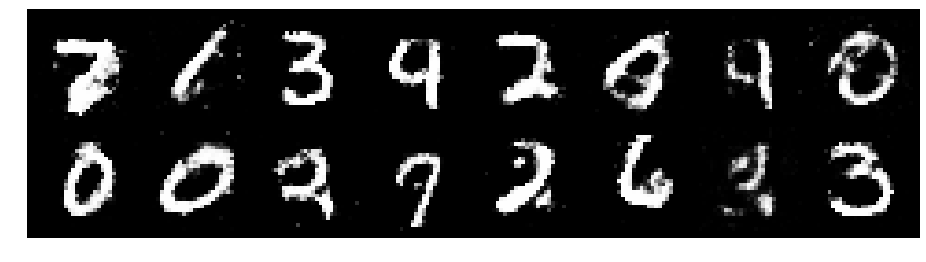

Epoch: [78/200], Batch Num: [200/600]
Discriminator Loss: 1.0992, Generator Loss: 0.9471
D(x): 0.6071, D(G(z)): 0.4033


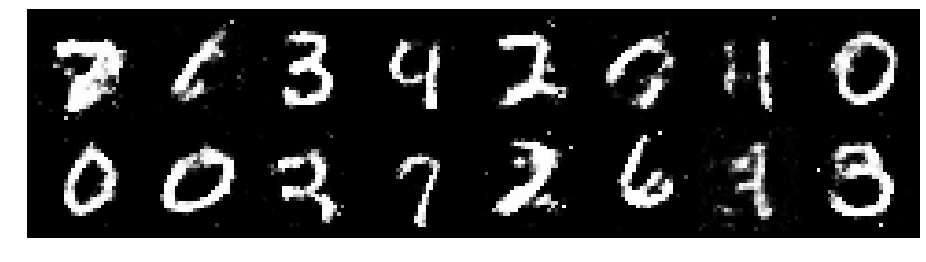

Epoch: [78/200], Batch Num: [300/600]
Discriminator Loss: 1.1682, Generator Loss: 1.0764
D(x): 0.6082, D(G(z)): 0.4176


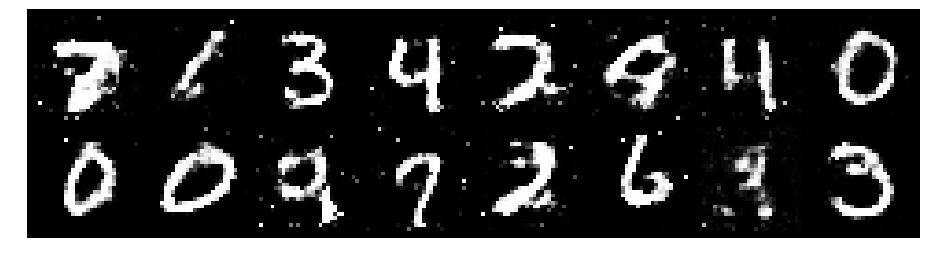

Epoch: [78/200], Batch Num: [400/600]
Discriminator Loss: 1.3175, Generator Loss: 0.9956
D(x): 0.5283, D(G(z)): 0.4330


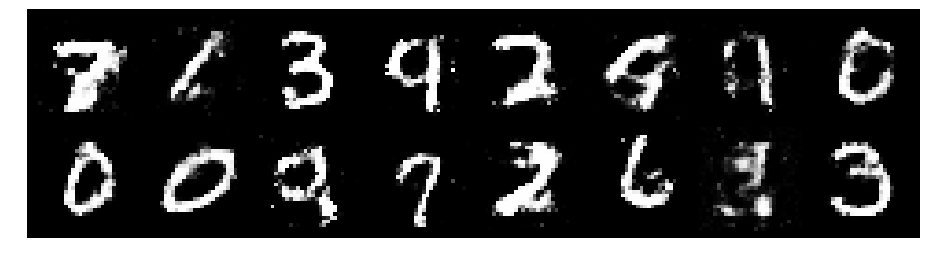

Epoch: [78/200], Batch Num: [500/600]
Discriminator Loss: 1.1329, Generator Loss: 1.0296
D(x): 0.6056, D(G(z)): 0.4004


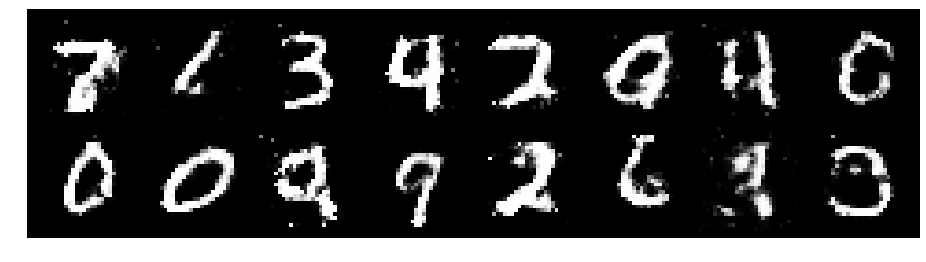

Epoch: [79/200], Batch Num: [0/600]
Discriminator Loss: 1.2192, Generator Loss: 0.9655
D(x): 0.5569, D(G(z)): 0.4156


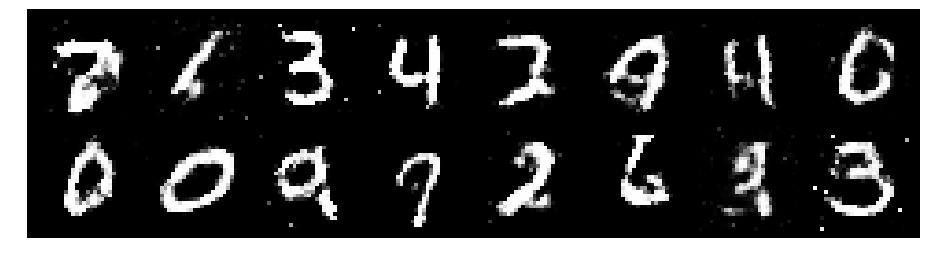

Epoch: [79/200], Batch Num: [100/600]
Discriminator Loss: 1.1268, Generator Loss: 0.9265
D(x): 0.5976, D(G(z)): 0.4100


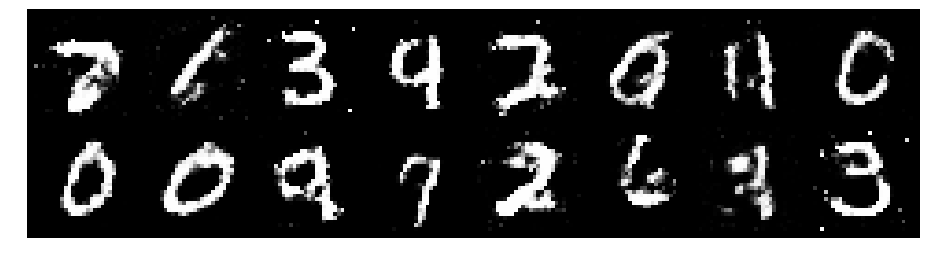

Epoch: [79/200], Batch Num: [200/600]
Discriminator Loss: 1.2369, Generator Loss: 0.9958
D(x): 0.5700, D(G(z)): 0.4305


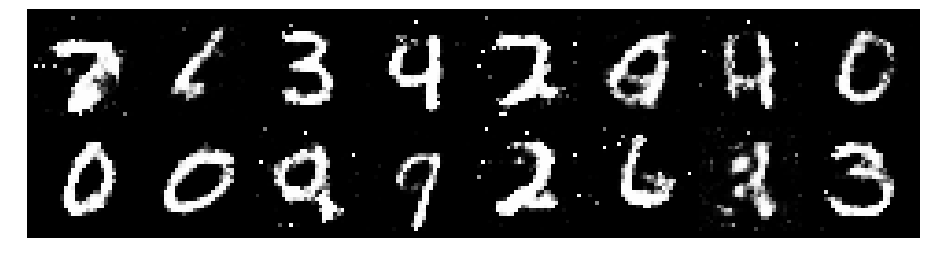

Epoch: [79/200], Batch Num: [300/600]
Discriminator Loss: 1.2778, Generator Loss: 0.9832
D(x): 0.5556, D(G(z)): 0.4266


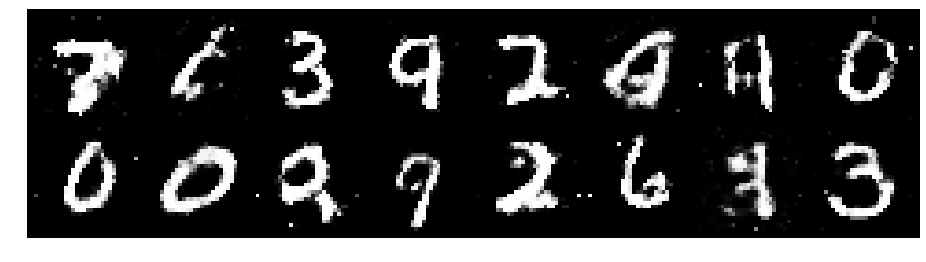

Epoch: [79/200], Batch Num: [400/600]
Discriminator Loss: 1.1942, Generator Loss: 1.0127
D(x): 0.5699, D(G(z)): 0.4087


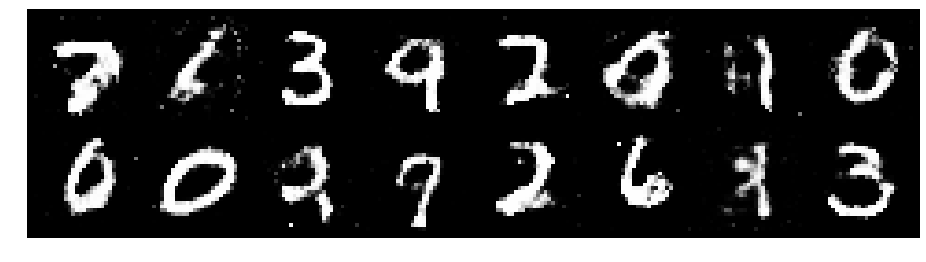

Epoch: [79/200], Batch Num: [500/600]
Discriminator Loss: 1.1860, Generator Loss: 0.9635
D(x): 0.6083, D(G(z)): 0.4328


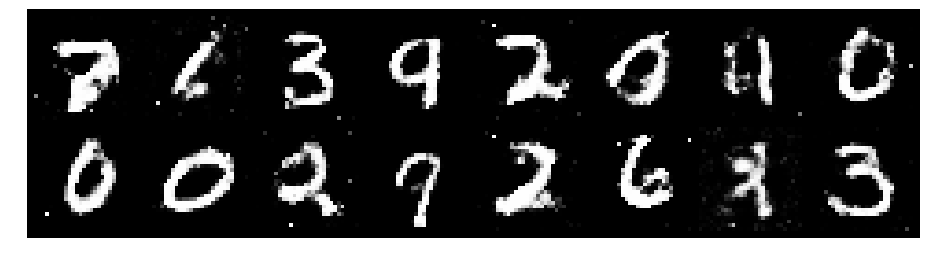

Epoch: [80/200], Batch Num: [0/600]
Discriminator Loss: 1.2157, Generator Loss: 0.9896
D(x): 0.5639, D(G(z)): 0.3883


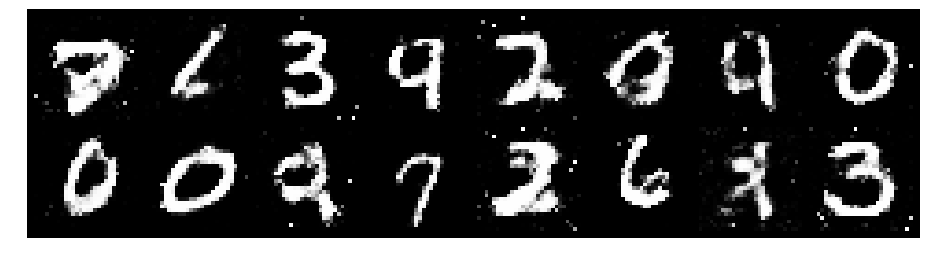

Epoch: [80/200], Batch Num: [100/600]
Discriminator Loss: 1.2674, Generator Loss: 1.0227
D(x): 0.5659, D(G(z)): 0.4319


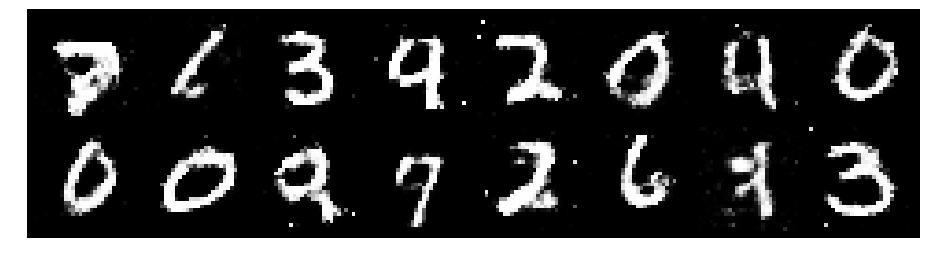

Epoch: [80/200], Batch Num: [200/600]
Discriminator Loss: 1.3131, Generator Loss: 1.0174
D(x): 0.5507, D(G(z)): 0.4327


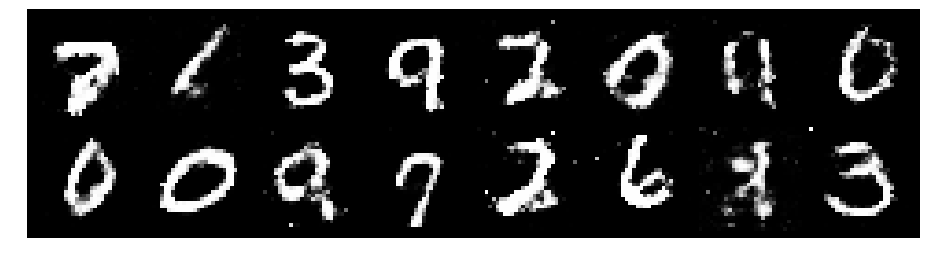

Epoch: [80/200], Batch Num: [300/600]
Discriminator Loss: 1.1865, Generator Loss: 0.9350
D(x): 0.6222, D(G(z)): 0.4412


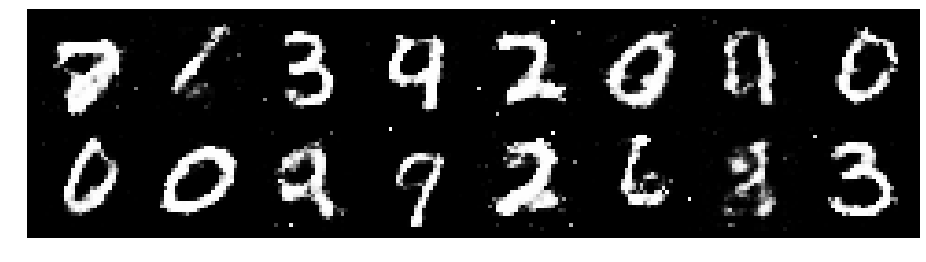

Epoch: [80/200], Batch Num: [400/600]
Discriminator Loss: 1.3599, Generator Loss: 0.9083
D(x): 0.5163, D(G(z)): 0.4409


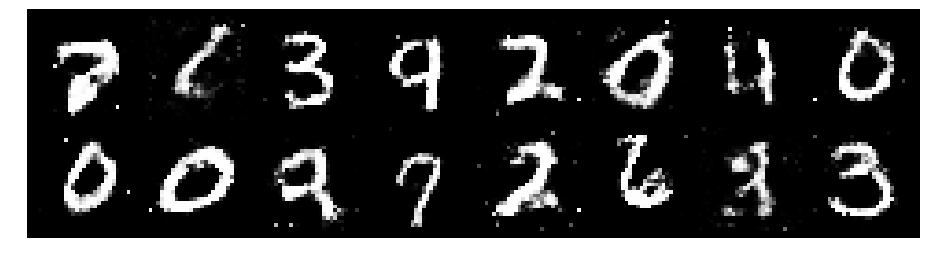

Epoch: [80/200], Batch Num: [500/600]
Discriminator Loss: 1.1966, Generator Loss: 0.9205
D(x): 0.5931, D(G(z)): 0.4447


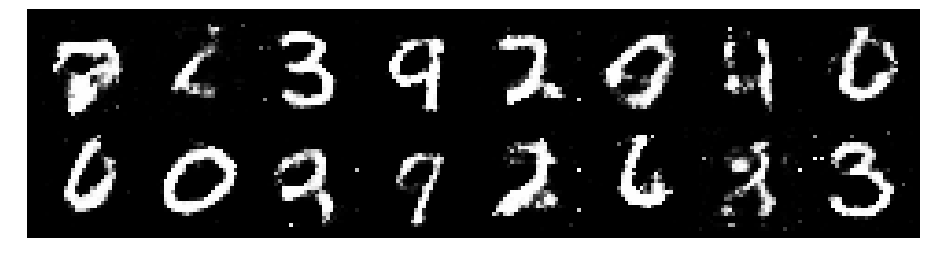

Epoch: [81/200], Batch Num: [0/600]
Discriminator Loss: 1.0249, Generator Loss: 1.1706
D(x): 0.6649, D(G(z)): 0.3900


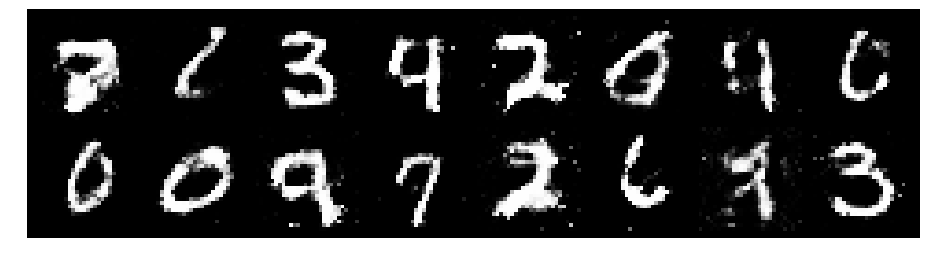

Epoch: [81/200], Batch Num: [100/600]
Discriminator Loss: 0.9497, Generator Loss: 1.2743
D(x): 0.6991, D(G(z)): 0.3756


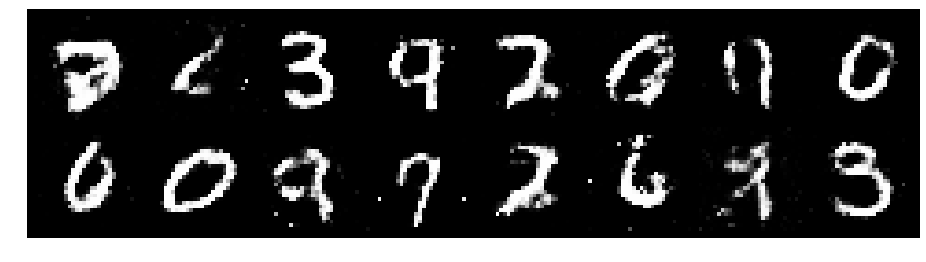

Epoch: [81/200], Batch Num: [200/600]
Discriminator Loss: 1.1123, Generator Loss: 1.0781
D(x): 0.6244, D(G(z)): 0.3957


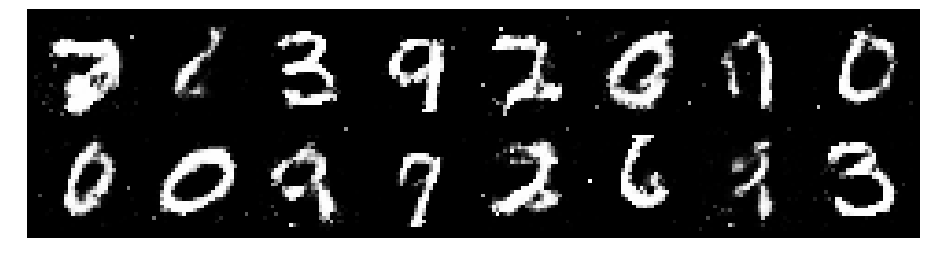

Epoch: [81/200], Batch Num: [300/600]
Discriminator Loss: 1.2095, Generator Loss: 0.9231
D(x): 0.5840, D(G(z)): 0.4301


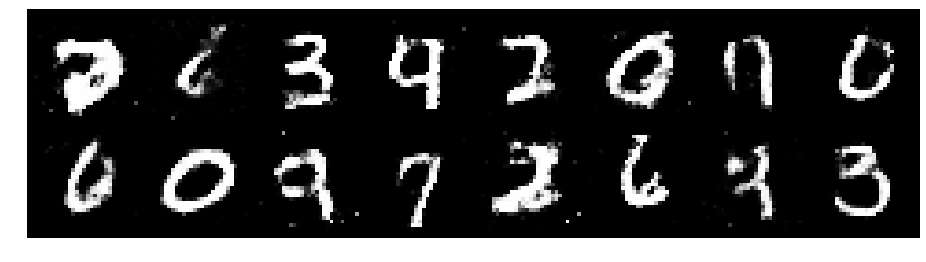

Epoch: [81/200], Batch Num: [400/600]
Discriminator Loss: 1.1238, Generator Loss: 1.2364
D(x): 0.6175, D(G(z)): 0.3878


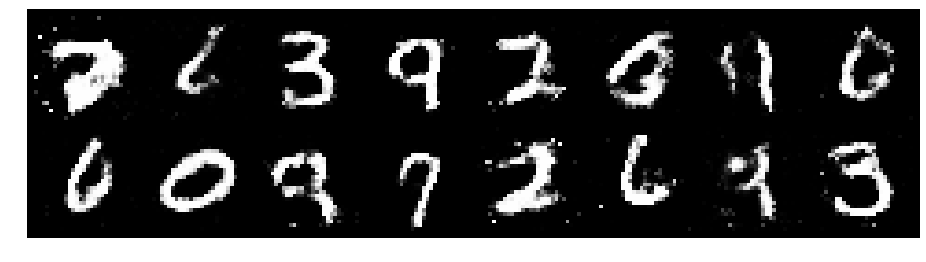

Epoch: [81/200], Batch Num: [500/600]
Discriminator Loss: 1.1587, Generator Loss: 0.9196
D(x): 0.6097, D(G(z)): 0.4362


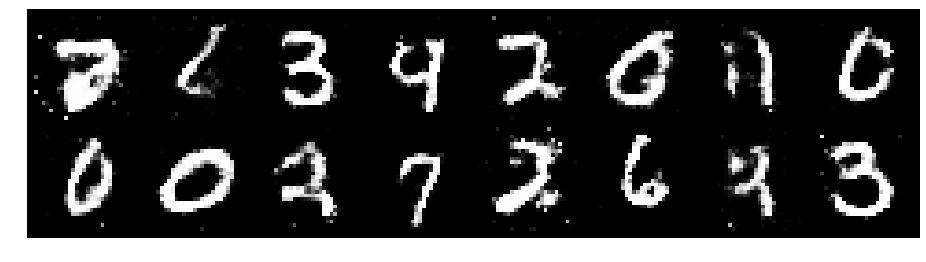

Epoch: [82/200], Batch Num: [0/600]
Discriminator Loss: 1.1747, Generator Loss: 0.9864
D(x): 0.5771, D(G(z)): 0.3918


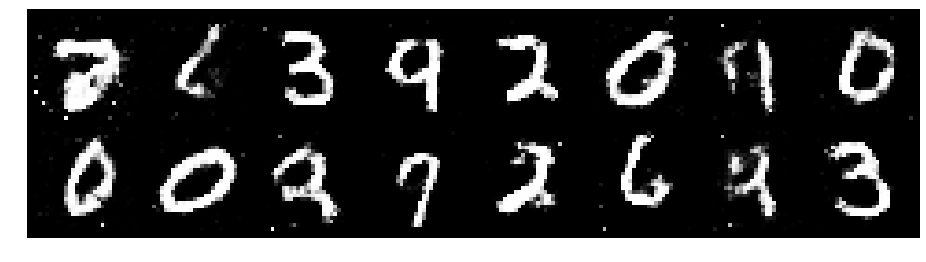

Epoch: [82/200], Batch Num: [100/600]
Discriminator Loss: 1.1765, Generator Loss: 1.0393
D(x): 0.5669, D(G(z)): 0.3825


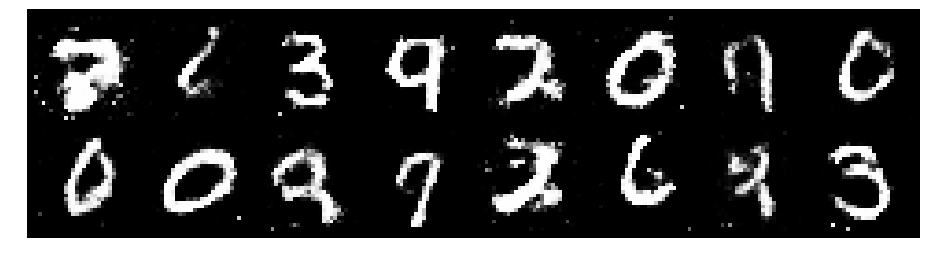

Epoch: [82/200], Batch Num: [200/600]
Discriminator Loss: 1.1205, Generator Loss: 1.0695
D(x): 0.5982, D(G(z)): 0.3836


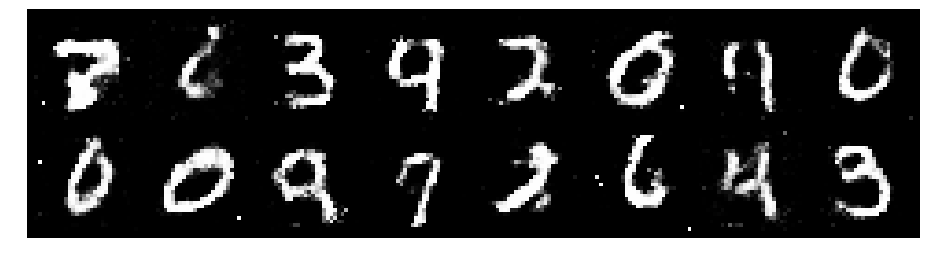

Epoch: [82/200], Batch Num: [300/600]
Discriminator Loss: 1.2236, Generator Loss: 0.9313
D(x): 0.5853, D(G(z)): 0.4404


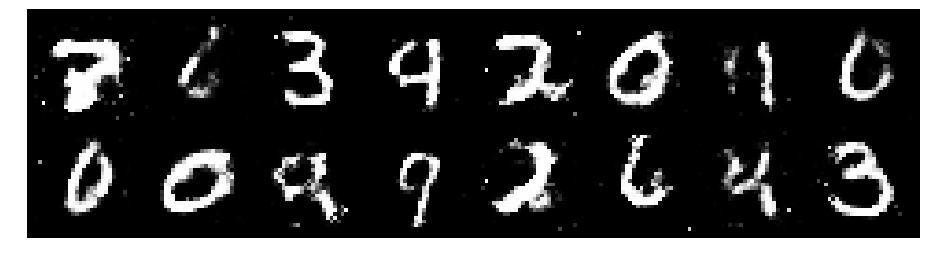

Epoch: [82/200], Batch Num: [400/600]
Discriminator Loss: 1.1682, Generator Loss: 1.0996
D(x): 0.6091, D(G(z)): 0.4270


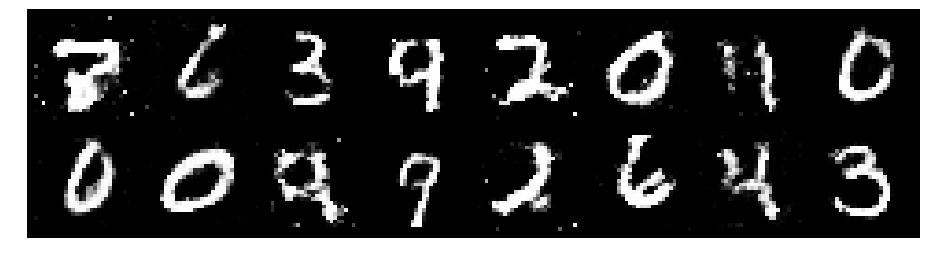

Epoch: [82/200], Batch Num: [500/600]
Discriminator Loss: 1.2336, Generator Loss: 1.1337
D(x): 0.5909, D(G(z)): 0.4006


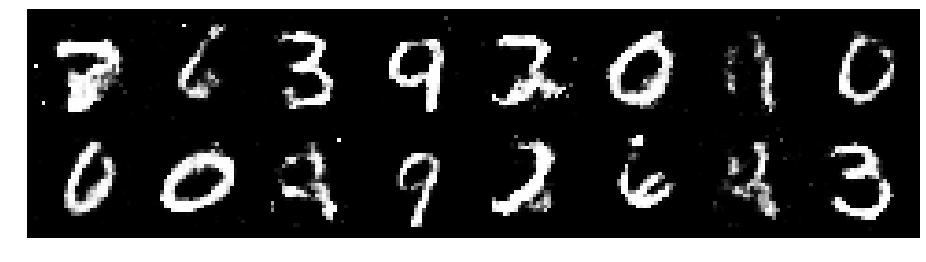

Epoch: [83/200], Batch Num: [0/600]
Discriminator Loss: 1.1575, Generator Loss: 0.9804
D(x): 0.5410, D(G(z)): 0.3580


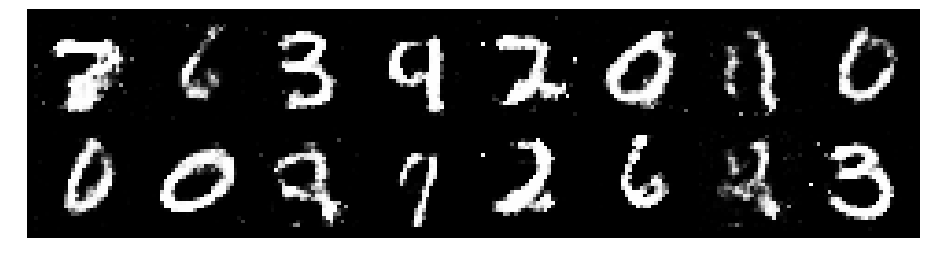

Epoch: [83/200], Batch Num: [100/600]
Discriminator Loss: 1.2143, Generator Loss: 1.0817
D(x): 0.6134, D(G(z)): 0.4361


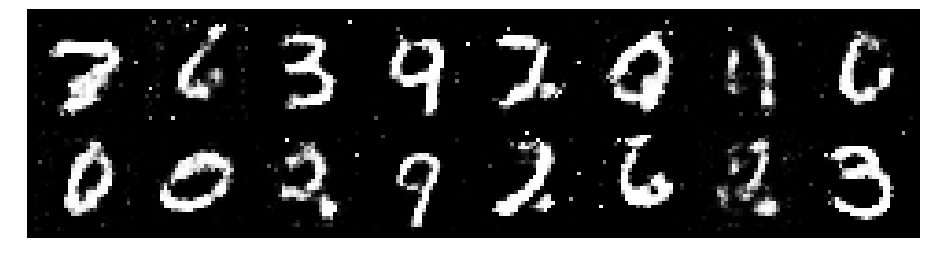

Epoch: [83/200], Batch Num: [200/600]
Discriminator Loss: 1.2291, Generator Loss: 0.9062
D(x): 0.6207, D(G(z)): 0.4450


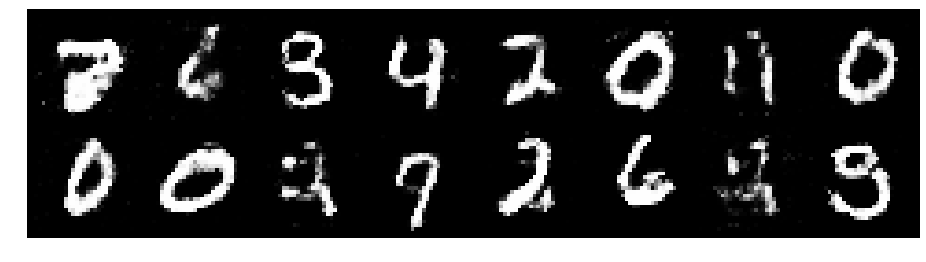

Epoch: [83/200], Batch Num: [300/600]
Discriminator Loss: 1.2784, Generator Loss: 0.9461
D(x): 0.5523, D(G(z)): 0.4347


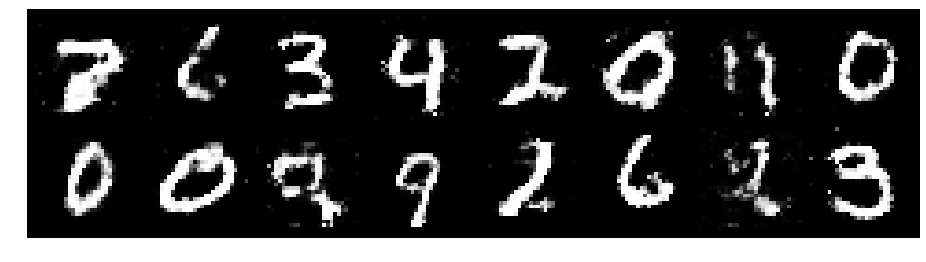

Epoch: [83/200], Batch Num: [400/600]
Discriminator Loss: 1.2825, Generator Loss: 0.9175
D(x): 0.5422, D(G(z)): 0.4158


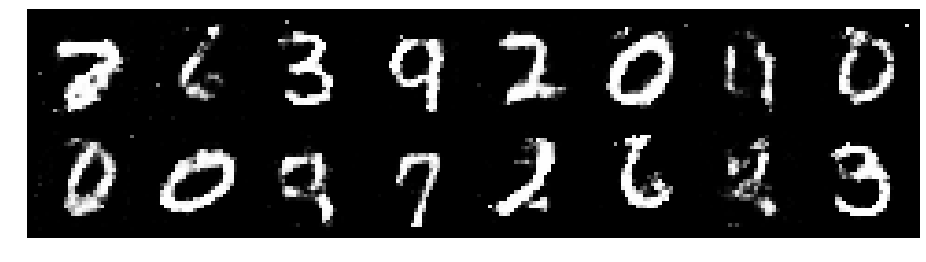

Epoch: [83/200], Batch Num: [500/600]
Discriminator Loss: 1.1968, Generator Loss: 0.9442
D(x): 0.6038, D(G(z)): 0.4523


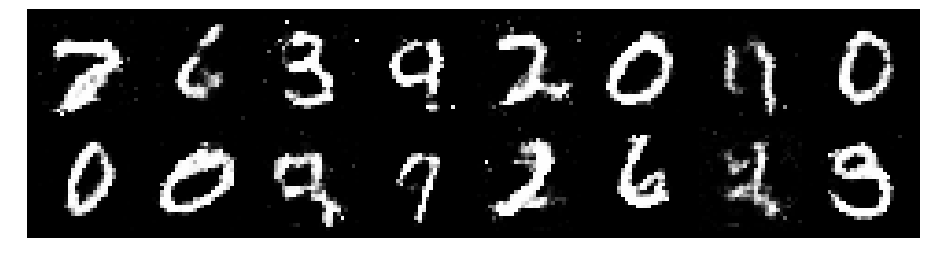

Epoch: [84/200], Batch Num: [0/600]
Discriminator Loss: 1.3236, Generator Loss: 1.0271
D(x): 0.5086, D(G(z)): 0.4135


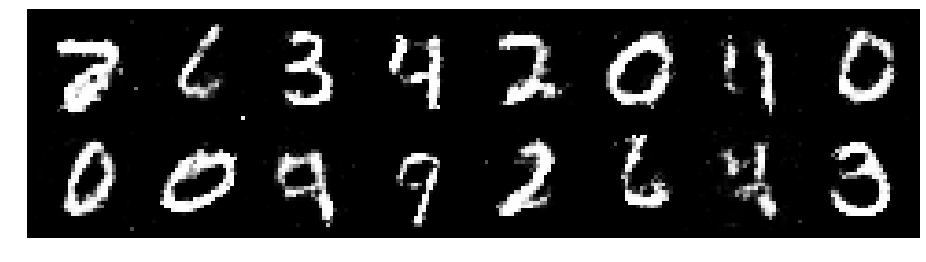

Epoch: [84/200], Batch Num: [100/600]
Discriminator Loss: 1.2773, Generator Loss: 0.9934
D(x): 0.6109, D(G(z)): 0.4734


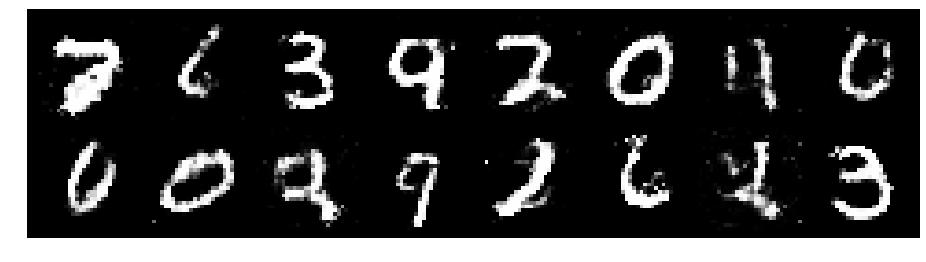

Epoch: [84/200], Batch Num: [200/600]
Discriminator Loss: 1.2160, Generator Loss: 0.9419
D(x): 0.5710, D(G(z)): 0.4292


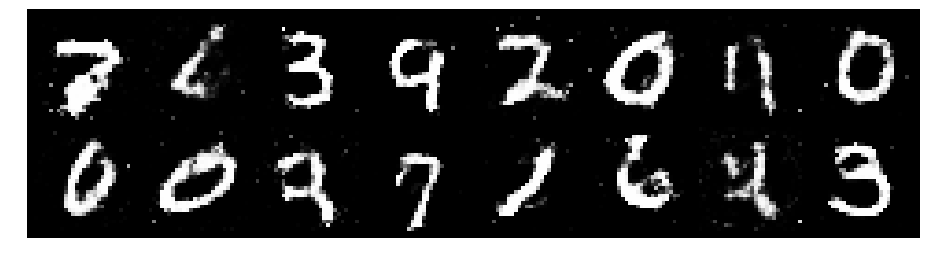

Epoch: [84/200], Batch Num: [300/600]
Discriminator Loss: 1.2312, Generator Loss: 0.9638
D(x): 0.5878, D(G(z)): 0.4487


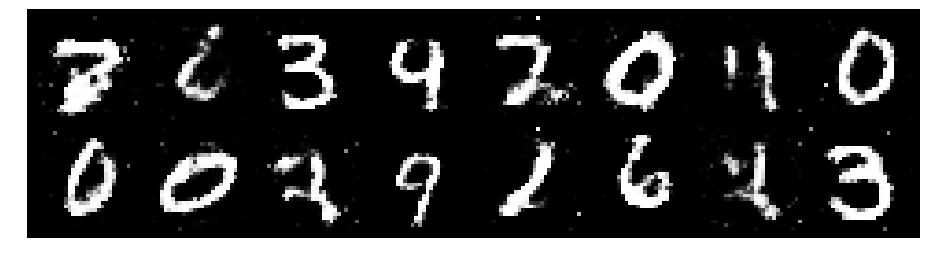

Epoch: [84/200], Batch Num: [400/600]
Discriminator Loss: 1.2698, Generator Loss: 0.8779
D(x): 0.6179, D(G(z)): 0.4816


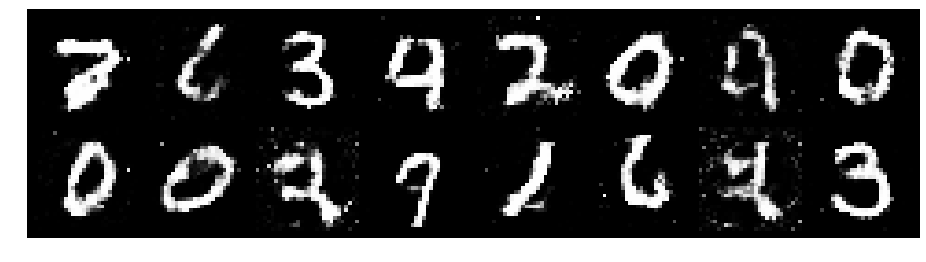

Epoch: [84/200], Batch Num: [500/600]
Discriminator Loss: 1.1712, Generator Loss: 0.9457
D(x): 0.6054, D(G(z)): 0.4455


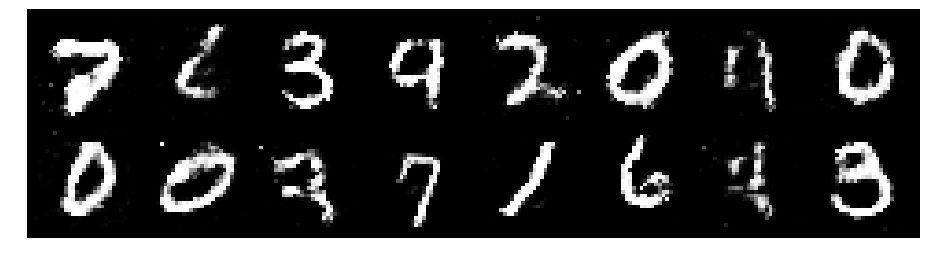

Epoch: [85/200], Batch Num: [0/600]
Discriminator Loss: 1.2807, Generator Loss: 0.9291
D(x): 0.5820, D(G(z)): 0.4477


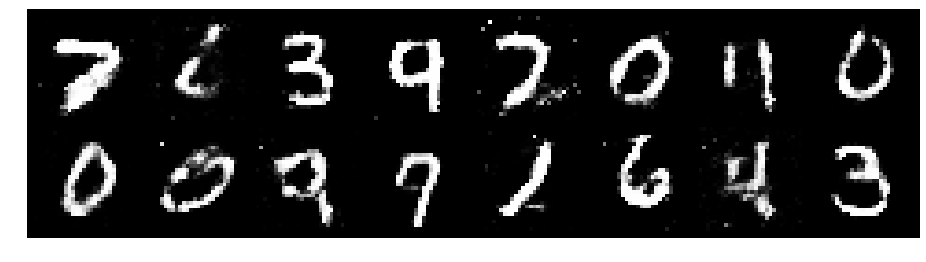

Epoch: [85/200], Batch Num: [100/600]
Discriminator Loss: 1.3145, Generator Loss: 1.1277
D(x): 0.5475, D(G(z)): 0.4300


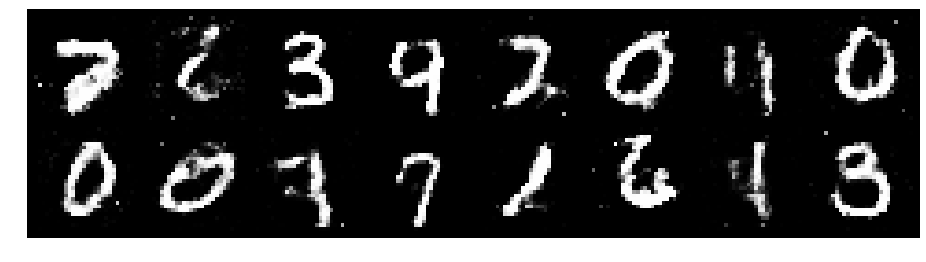

Epoch: [85/200], Batch Num: [200/600]
Discriminator Loss: 1.2324, Generator Loss: 0.9626
D(x): 0.5714, D(G(z)): 0.4223


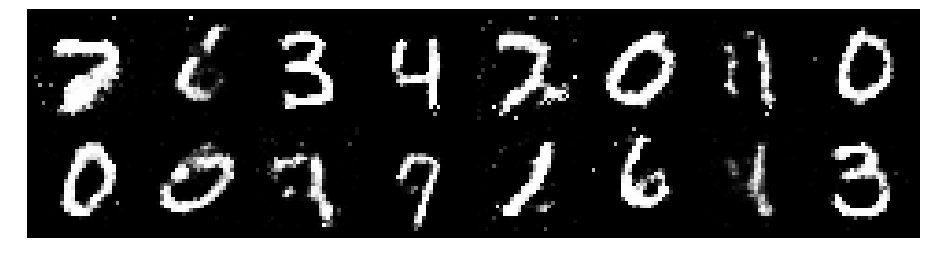

Epoch: [85/200], Batch Num: [300/600]
Discriminator Loss: 1.2332, Generator Loss: 0.9752
D(x): 0.5628, D(G(z)): 0.4223


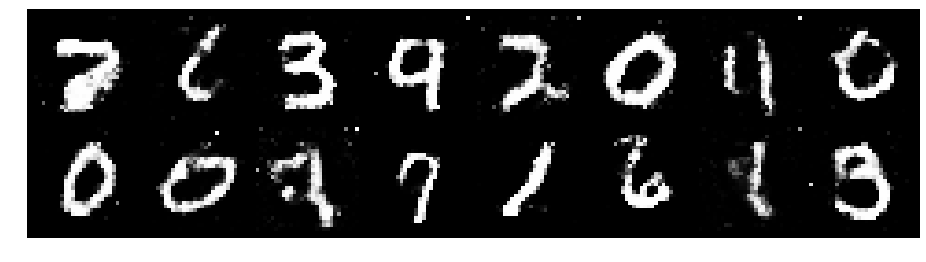

Epoch: [85/200], Batch Num: [400/600]
Discriminator Loss: 1.2084, Generator Loss: 0.9568
D(x): 0.5816, D(G(z)): 0.4314


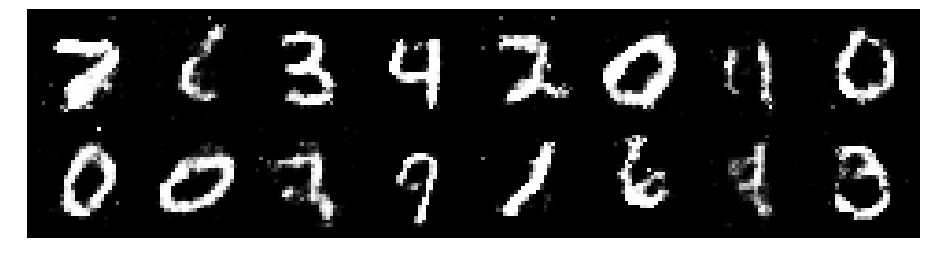

Epoch: [85/200], Batch Num: [500/600]
Discriminator Loss: 1.2250, Generator Loss: 0.8811
D(x): 0.6065, D(G(z)): 0.4603


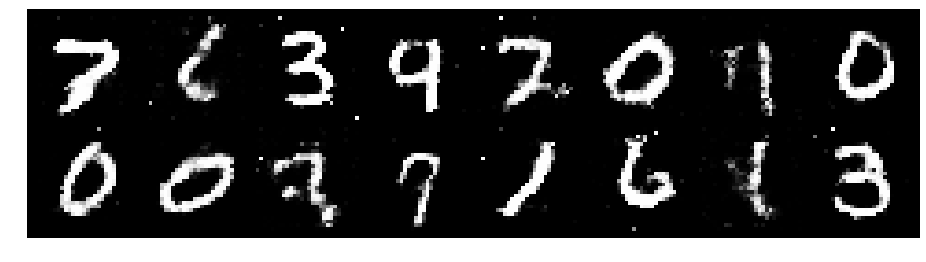

Epoch: [86/200], Batch Num: [0/600]
Discriminator Loss: 1.2581, Generator Loss: 1.0379
D(x): 0.6307, D(G(z)): 0.4835


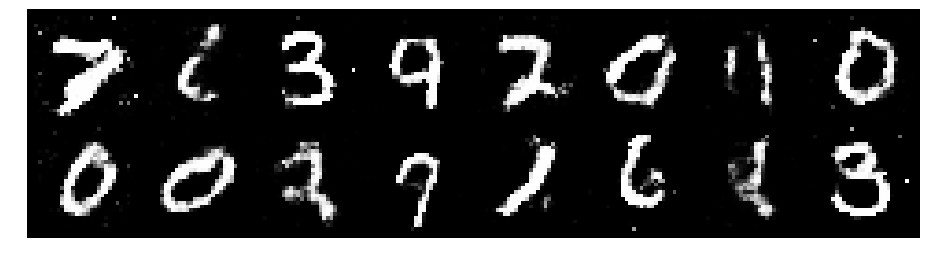

Epoch: [86/200], Batch Num: [100/600]
Discriminator Loss: 1.2122, Generator Loss: 0.9490
D(x): 0.6264, D(G(z)): 0.4635


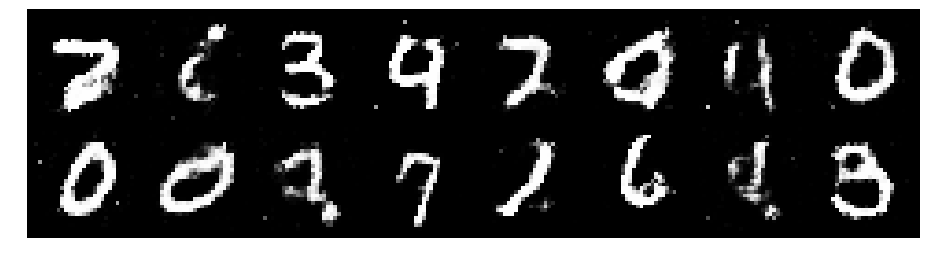

Epoch: [86/200], Batch Num: [200/600]
Discriminator Loss: 1.2688, Generator Loss: 0.9004
D(x): 0.5579, D(G(z)): 0.4427


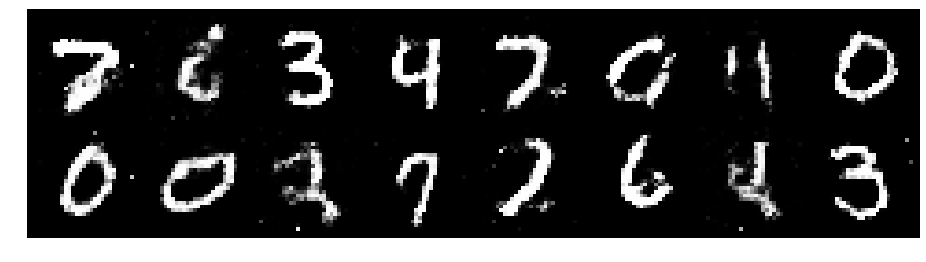

Epoch: [86/200], Batch Num: [300/600]
Discriminator Loss: 1.2303, Generator Loss: 0.9611
D(x): 0.5197, D(G(z)): 0.3766


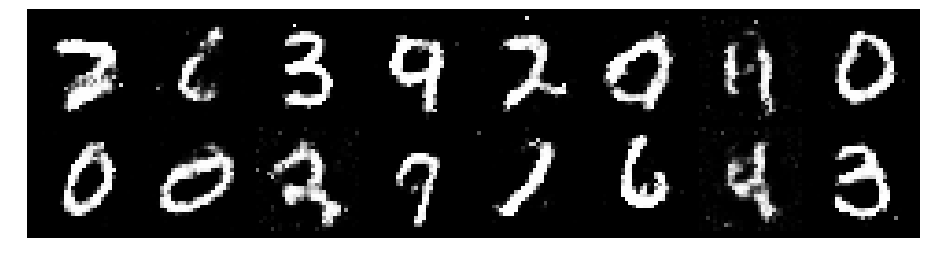

Epoch: [86/200], Batch Num: [400/600]
Discriminator Loss: 1.3064, Generator Loss: 0.9768
D(x): 0.5093, D(G(z)): 0.3938


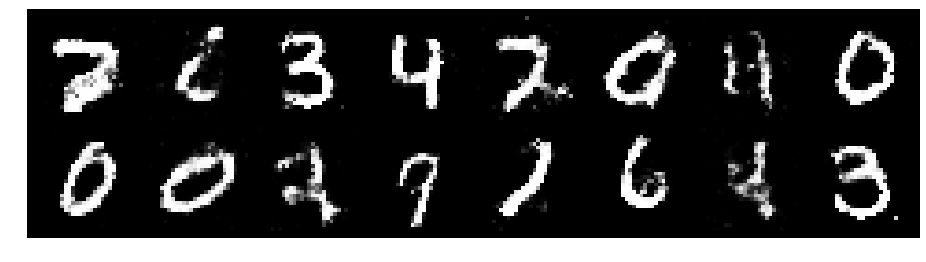

Epoch: [86/200], Batch Num: [500/600]
Discriminator Loss: 1.2029, Generator Loss: 0.9663
D(x): 0.5580, D(G(z)): 0.4112


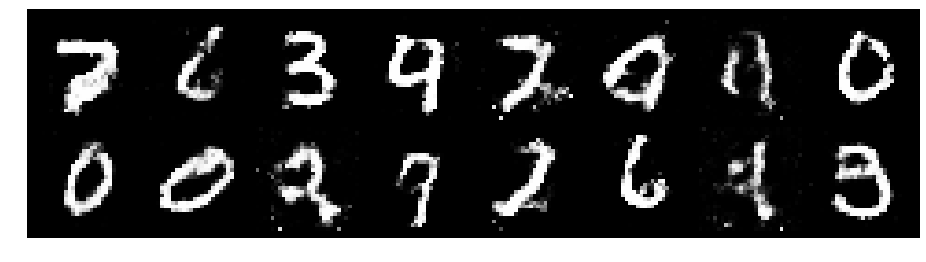

Epoch: [87/200], Batch Num: [0/600]
Discriminator Loss: 1.1542, Generator Loss: 1.1196
D(x): 0.6031, D(G(z)): 0.4087


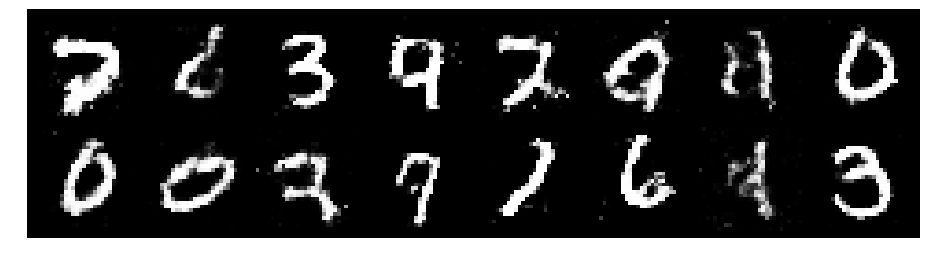

Epoch: [87/200], Batch Num: [100/600]
Discriminator Loss: 1.1528, Generator Loss: 0.9495
D(x): 0.5811, D(G(z)): 0.3958


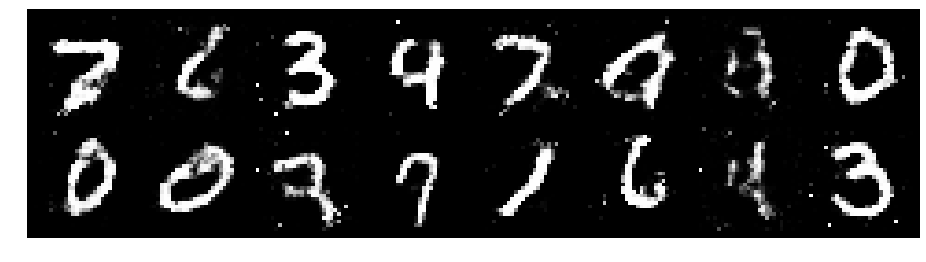

Epoch: [87/200], Batch Num: [200/600]
Discriminator Loss: 1.2592, Generator Loss: 1.0288
D(x): 0.5738, D(G(z)): 0.4400


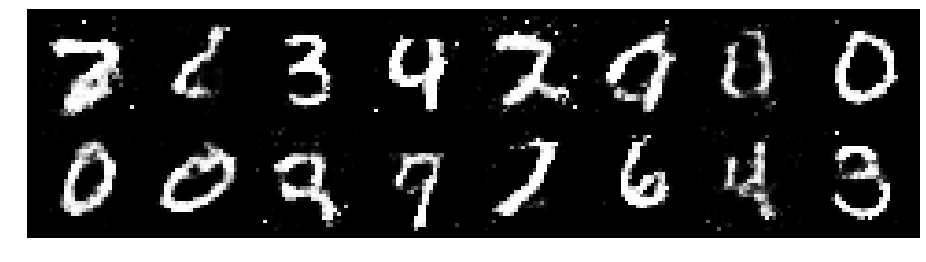

Epoch: [87/200], Batch Num: [300/600]
Discriminator Loss: 1.1493, Generator Loss: 1.0637
D(x): 0.5777, D(G(z)): 0.4011


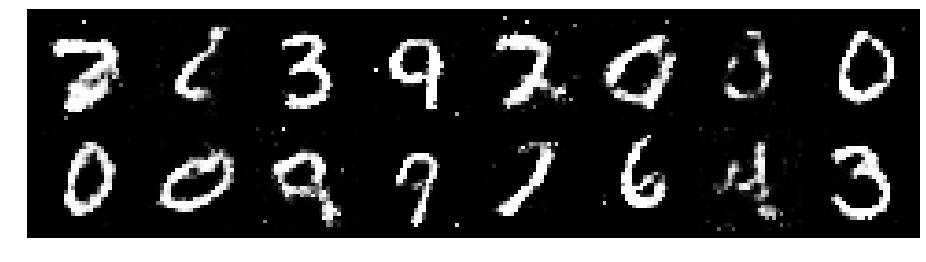

Epoch: [87/200], Batch Num: [400/600]
Discriminator Loss: 1.2042, Generator Loss: 1.2085
D(x): 0.5856, D(G(z)): 0.4096


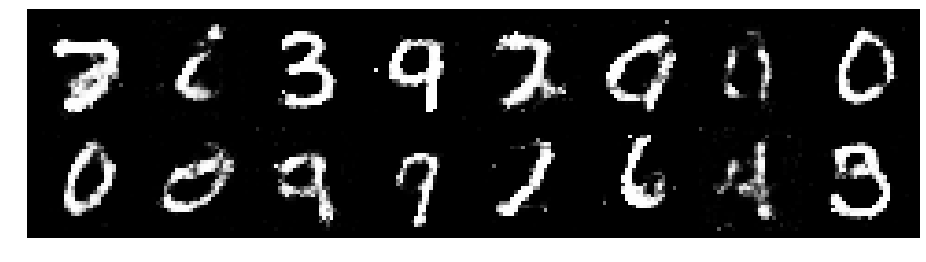

Epoch: [87/200], Batch Num: [500/600]
Discriminator Loss: 1.2611, Generator Loss: 0.9852
D(x): 0.6037, D(G(z)): 0.4671


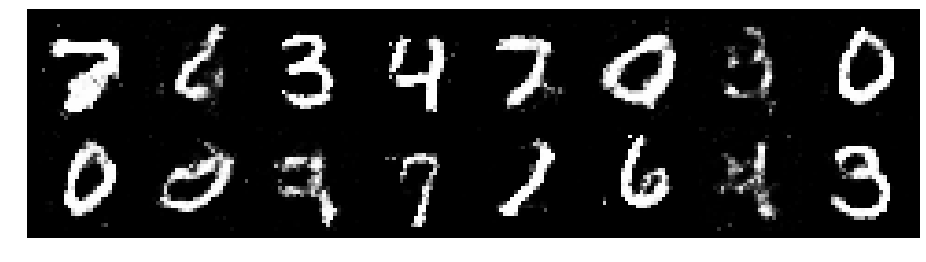

Epoch: [88/200], Batch Num: [0/600]
Discriminator Loss: 1.1576, Generator Loss: 0.9846
D(x): 0.5953, D(G(z)): 0.4208


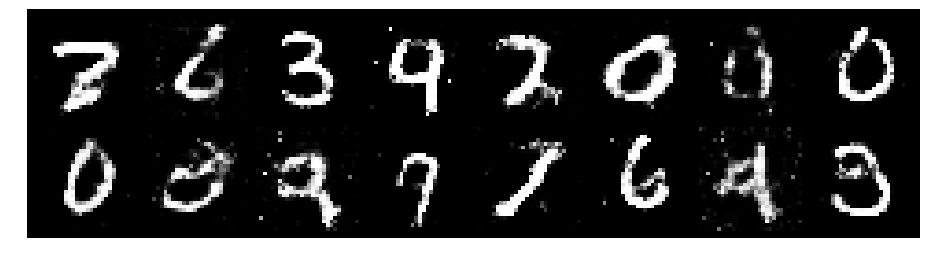

Epoch: [88/200], Batch Num: [100/600]
Discriminator Loss: 1.1681, Generator Loss: 0.9042
D(x): 0.5818, D(G(z)): 0.4135


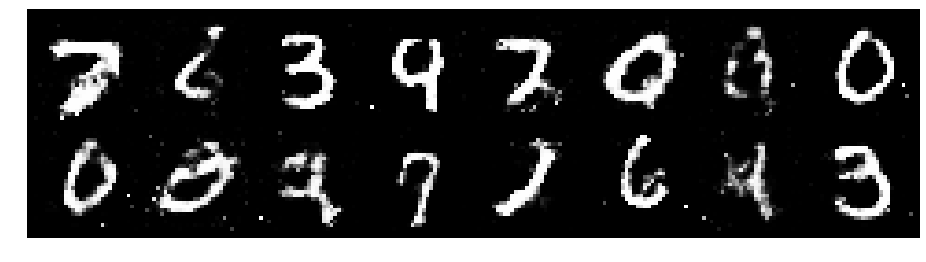

Epoch: [88/200], Batch Num: [200/600]
Discriminator Loss: 1.3257, Generator Loss: 0.8406
D(x): 0.5466, D(G(z)): 0.4683


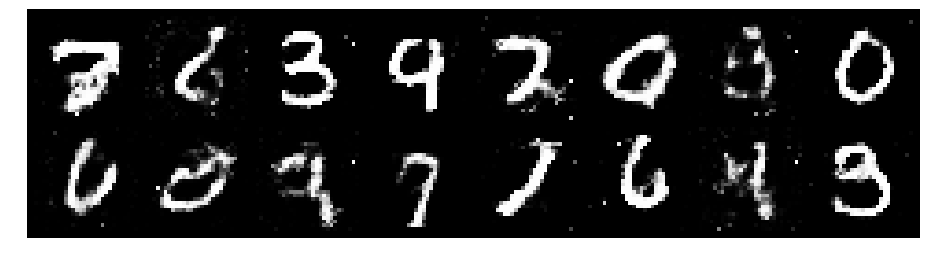

Epoch: [88/200], Batch Num: [300/600]
Discriminator Loss: 1.2888, Generator Loss: 0.8811
D(x): 0.5525, D(G(z)): 0.4423


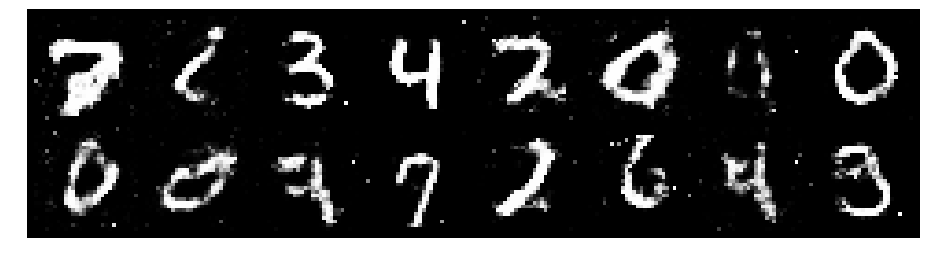

Epoch: [88/200], Batch Num: [400/600]
Discriminator Loss: 1.3152, Generator Loss: 0.8252
D(x): 0.5333, D(G(z)): 0.4572


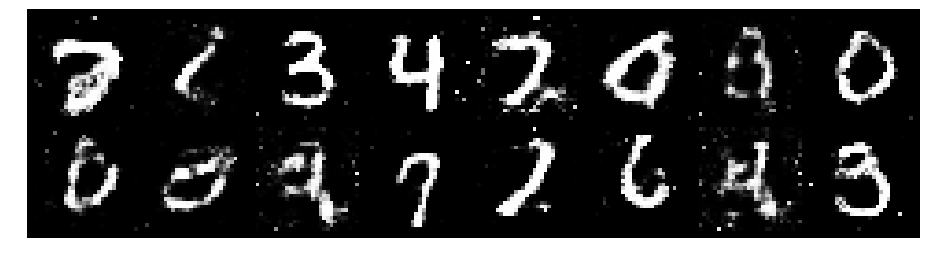

Epoch: [88/200], Batch Num: [500/600]
Discriminator Loss: 1.2296, Generator Loss: 0.8988
D(x): 0.5243, D(G(z)): 0.4065


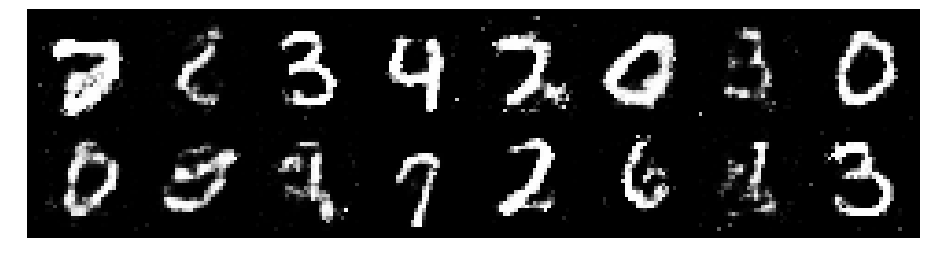

Epoch: [89/200], Batch Num: [0/600]
Discriminator Loss: 1.1983, Generator Loss: 0.9258
D(x): 0.5640, D(G(z)): 0.4180


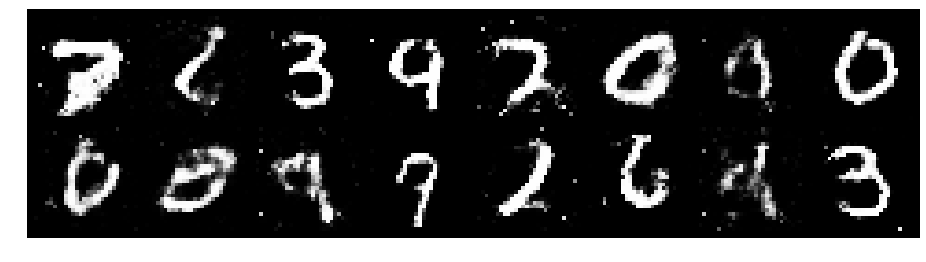

Epoch: [89/200], Batch Num: [100/600]
Discriminator Loss: 1.2651, Generator Loss: 0.9787
D(x): 0.5702, D(G(z)): 0.4321


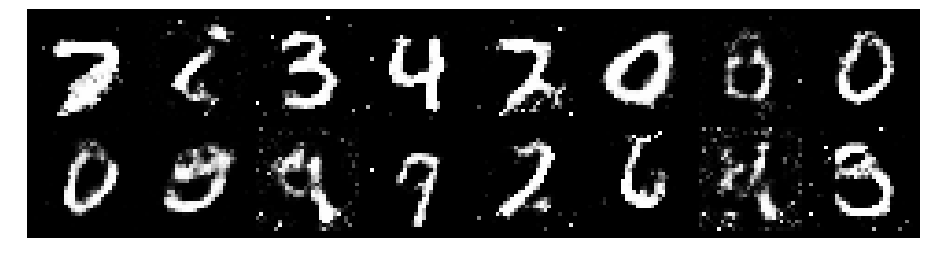

Epoch: [89/200], Batch Num: [200/600]
Discriminator Loss: 1.2383, Generator Loss: 0.8651
D(x): 0.5608, D(G(z)): 0.4371


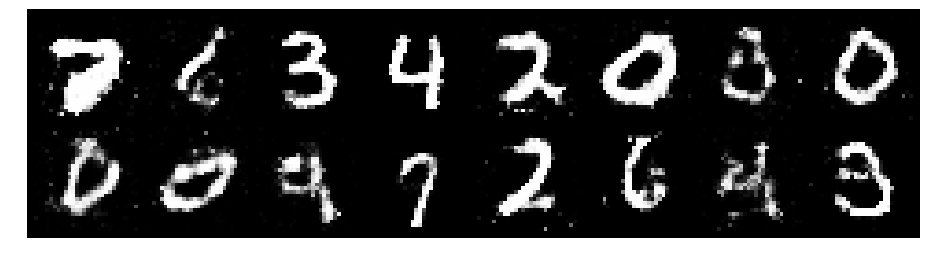

Epoch: [89/200], Batch Num: [300/600]
Discriminator Loss: 1.2539, Generator Loss: 0.8986
D(x): 0.5452, D(G(z)): 0.4369


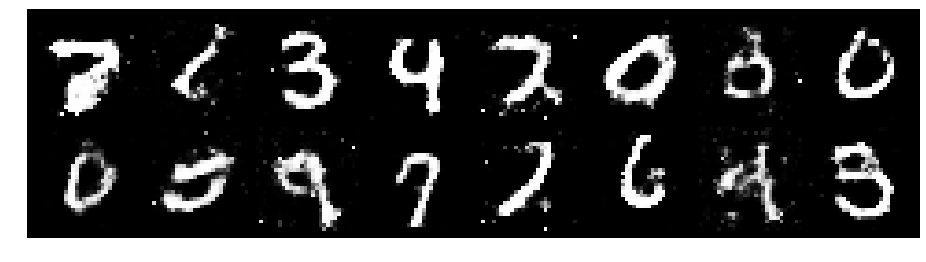

Epoch: [89/200], Batch Num: [400/600]
Discriminator Loss: 1.2926, Generator Loss: 0.9810
D(x): 0.5560, D(G(z)): 0.4418


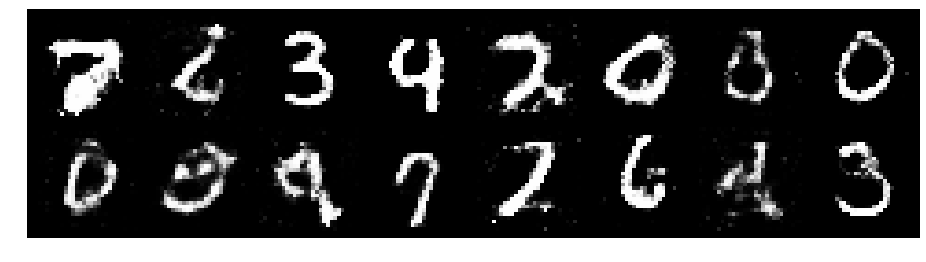

Epoch: [89/200], Batch Num: [500/600]
Discriminator Loss: 1.1482, Generator Loss: 0.9640
D(x): 0.6038, D(G(z)): 0.4131


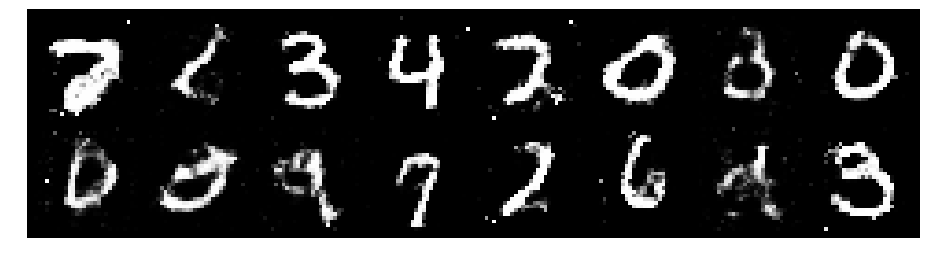

Epoch: [90/200], Batch Num: [0/600]
Discriminator Loss: 1.2336, Generator Loss: 0.9803
D(x): 0.6032, D(G(z)): 0.4497


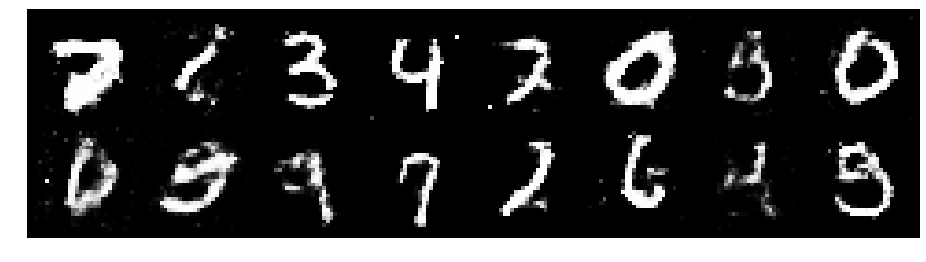

Epoch: [90/200], Batch Num: [100/600]
Discriminator Loss: 1.2036, Generator Loss: 0.8499
D(x): 0.6197, D(G(z)): 0.4503


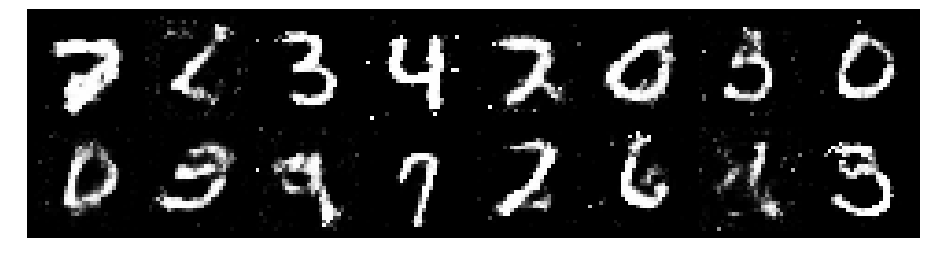

Epoch: [90/200], Batch Num: [200/600]
Discriminator Loss: 1.2288, Generator Loss: 1.0007
D(x): 0.5932, D(G(z)): 0.4492


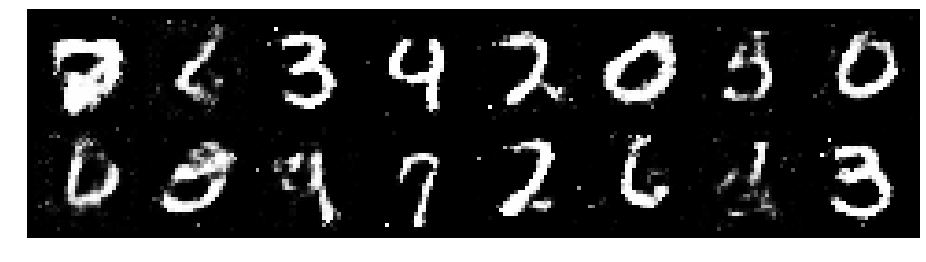

Epoch: [90/200], Batch Num: [300/600]
Discriminator Loss: 1.2283, Generator Loss: 0.9605
D(x): 0.5679, D(G(z)): 0.4375


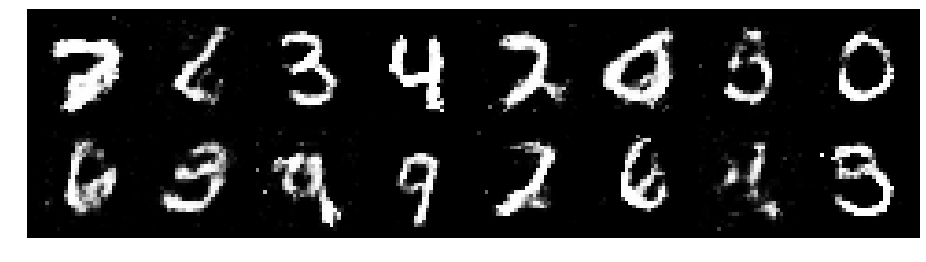

Epoch: [90/200], Batch Num: [400/600]
Discriminator Loss: 1.2926, Generator Loss: 0.8541
D(x): 0.5518, D(G(z)): 0.4374


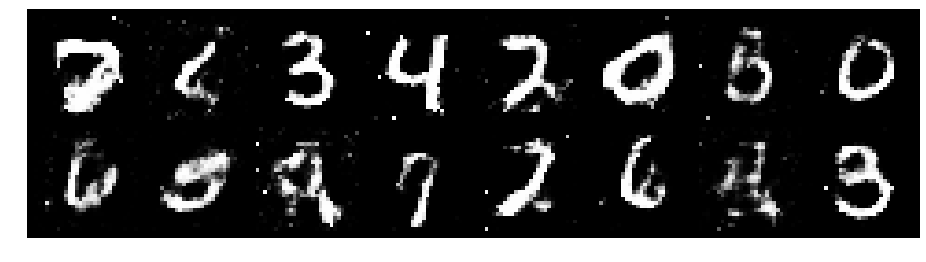

Epoch: [90/200], Batch Num: [500/600]
Discriminator Loss: 1.1735, Generator Loss: 0.9601
D(x): 0.5609, D(G(z)): 0.4117


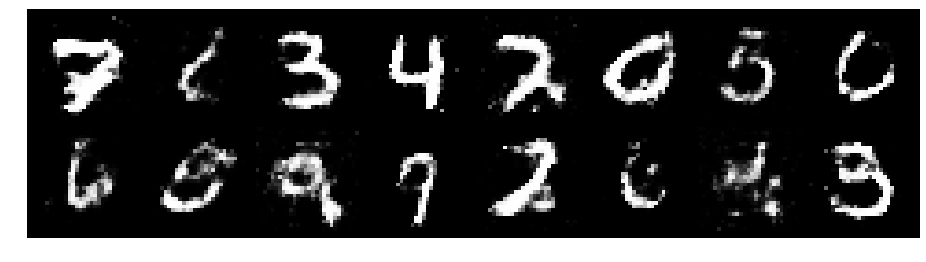

Epoch: [91/200], Batch Num: [0/600]
Discriminator Loss: 1.2425, Generator Loss: 0.8679
D(x): 0.5474, D(G(z)): 0.4434


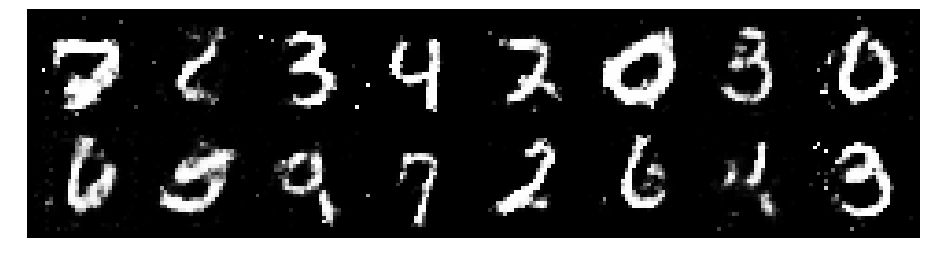

Epoch: [91/200], Batch Num: [100/600]
Discriminator Loss: 1.1282, Generator Loss: 0.8953
D(x): 0.5654, D(G(z)): 0.3849


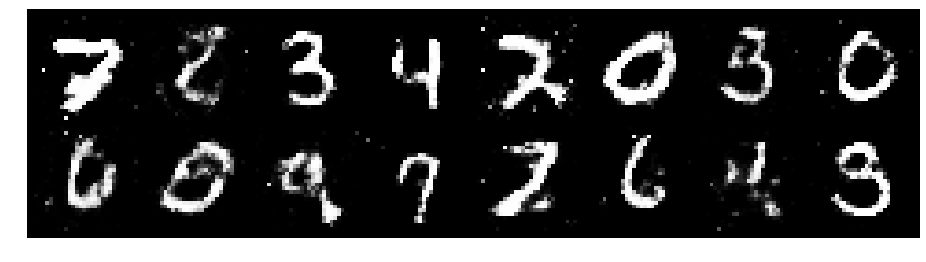

Epoch: [91/200], Batch Num: [200/600]
Discriminator Loss: 1.2807, Generator Loss: 0.9112
D(x): 0.5467, D(G(z)): 0.4405


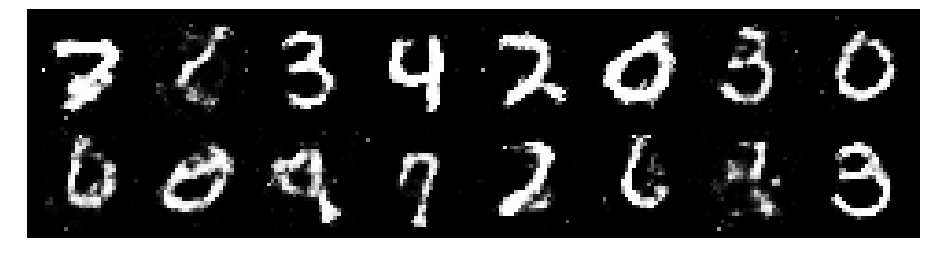

Epoch: [91/200], Batch Num: [300/600]
Discriminator Loss: 1.3609, Generator Loss: 0.8239
D(x): 0.5666, D(G(z)): 0.4894


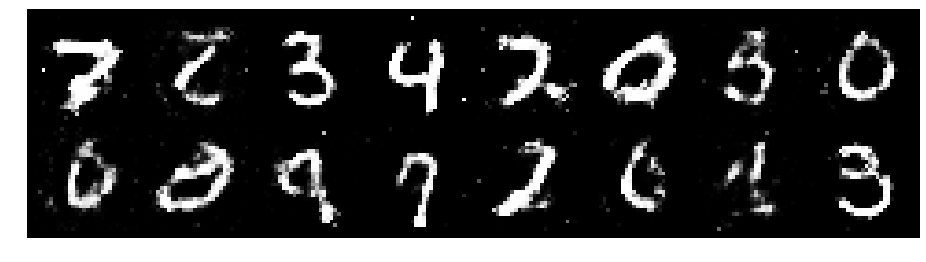

Epoch: [91/200], Batch Num: [400/600]
Discriminator Loss: 1.2870, Generator Loss: 0.8963
D(x): 0.5493, D(G(z)): 0.4366


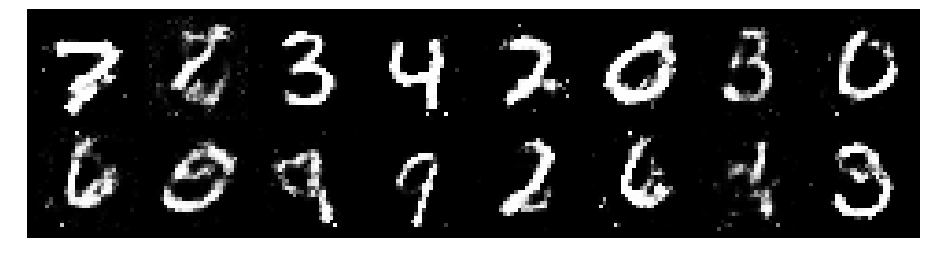

Epoch: [91/200], Batch Num: [500/600]
Discriminator Loss: 1.2725, Generator Loss: 0.9355
D(x): 0.5815, D(G(z)): 0.4454


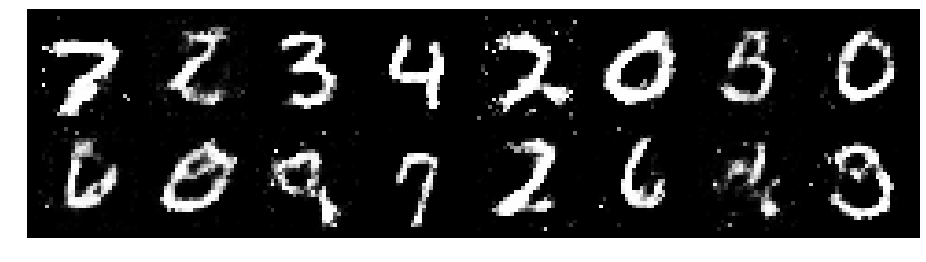

Epoch: [92/200], Batch Num: [0/600]
Discriminator Loss: 1.1759, Generator Loss: 0.9001
D(x): 0.5796, D(G(z)): 0.4269


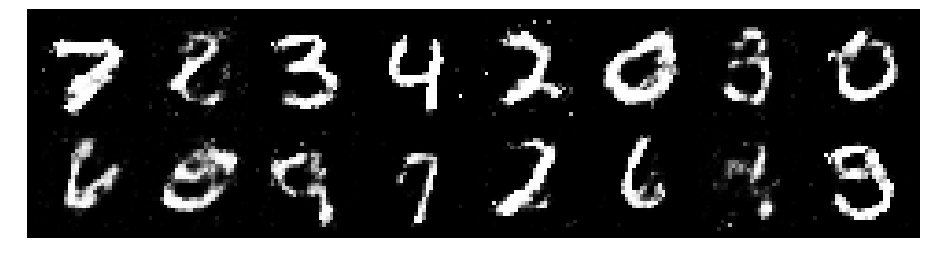

Epoch: [92/200], Batch Num: [100/600]
Discriminator Loss: 1.1964, Generator Loss: 0.8212
D(x): 0.6140, D(G(z)): 0.4374


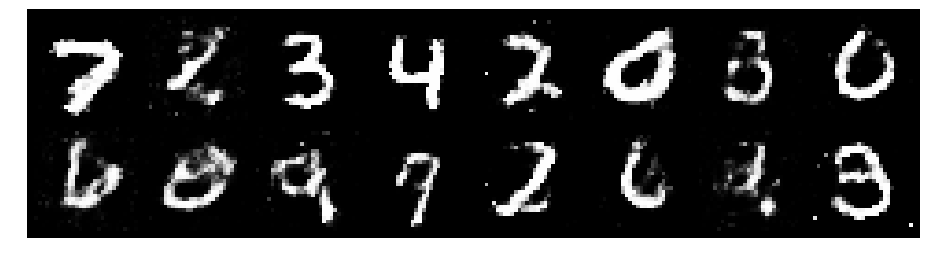

Epoch: [92/200], Batch Num: [200/600]
Discriminator Loss: 1.2687, Generator Loss: 0.8024
D(x): 0.5781, D(G(z)): 0.4476


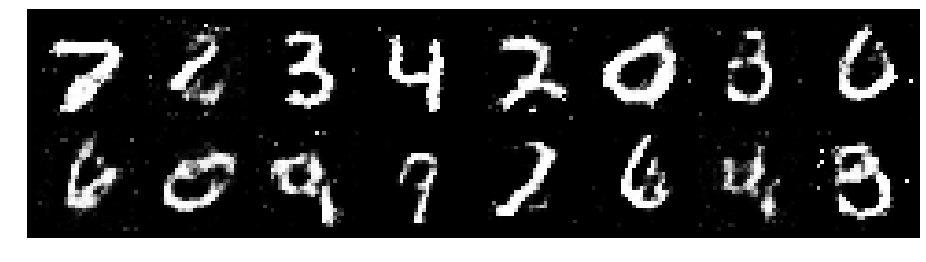

Epoch: [92/200], Batch Num: [300/600]
Discriminator Loss: 1.3330, Generator Loss: 0.8298
D(x): 0.5459, D(G(z)): 0.4576


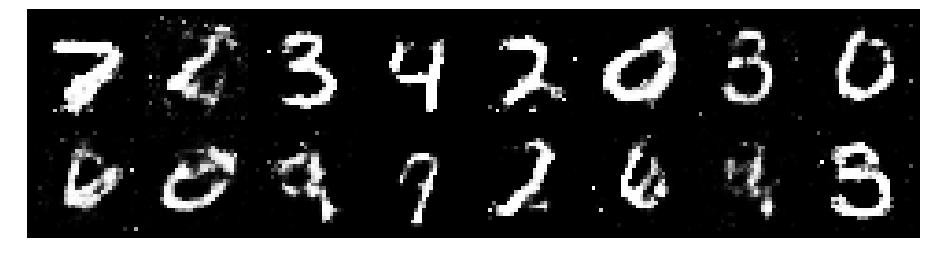

Epoch: [92/200], Batch Num: [400/600]
Discriminator Loss: 1.2074, Generator Loss: 0.9706
D(x): 0.5385, D(G(z)): 0.3898


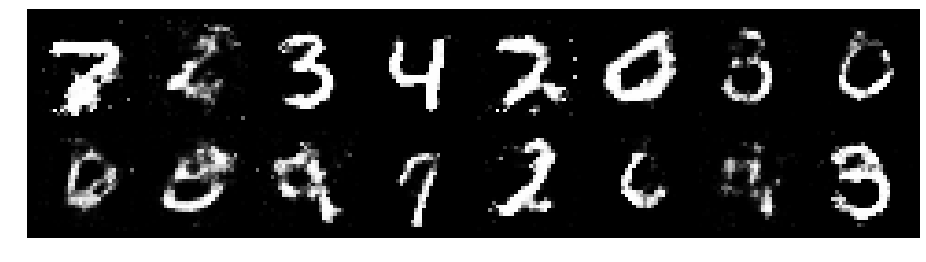

Epoch: [92/200], Batch Num: [500/600]
Discriminator Loss: 1.1640, Generator Loss: 0.8717
D(x): 0.5974, D(G(z)): 0.4176


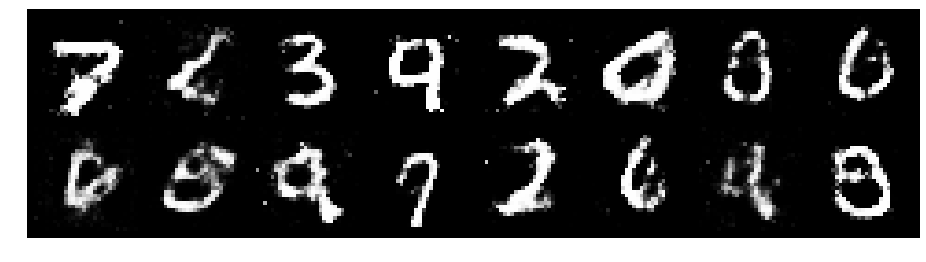

Epoch: [93/200], Batch Num: [0/600]
Discriminator Loss: 1.3053, Generator Loss: 0.8418
D(x): 0.5513, D(G(z)): 0.4622


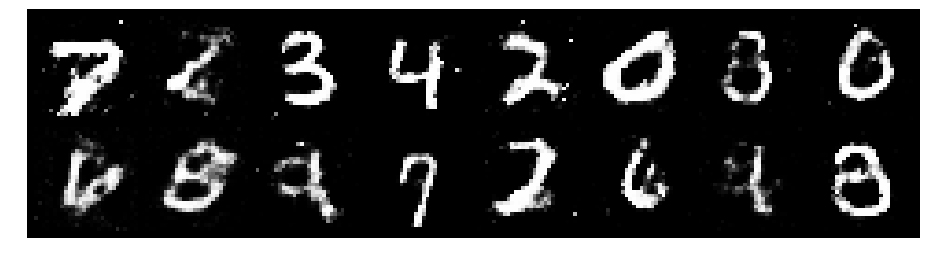

Epoch: [93/200], Batch Num: [100/600]
Discriminator Loss: 1.3626, Generator Loss: 0.9814
D(x): 0.5244, D(G(z)): 0.4533


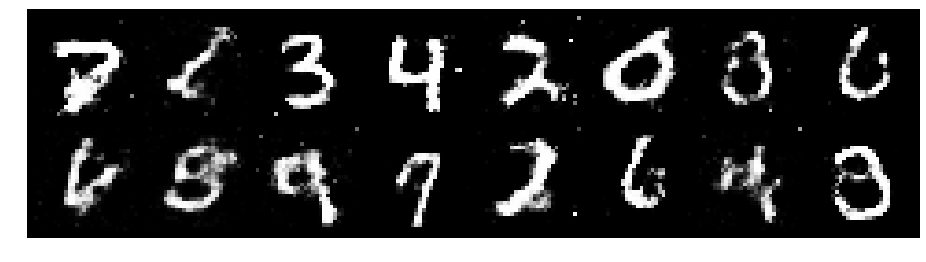

Epoch: [93/200], Batch Num: [200/600]
Discriminator Loss: 1.4096, Generator Loss: 1.0219
D(x): 0.5562, D(G(z)): 0.4825


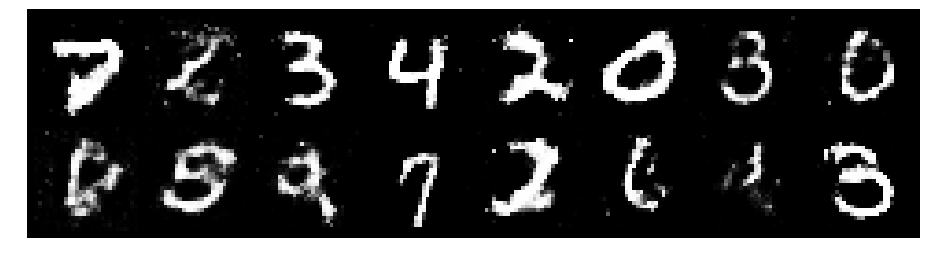

Epoch: [93/200], Batch Num: [300/600]
Discriminator Loss: 1.2898, Generator Loss: 0.9102
D(x): 0.5380, D(G(z)): 0.4423


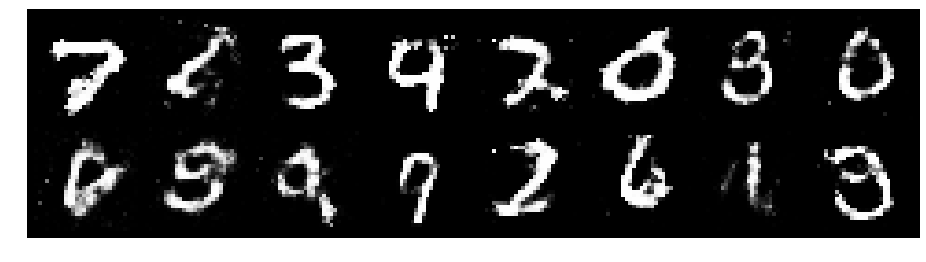

Epoch: [93/200], Batch Num: [400/600]
Discriminator Loss: 1.2256, Generator Loss: 0.9020
D(x): 0.5517, D(G(z)): 0.4112


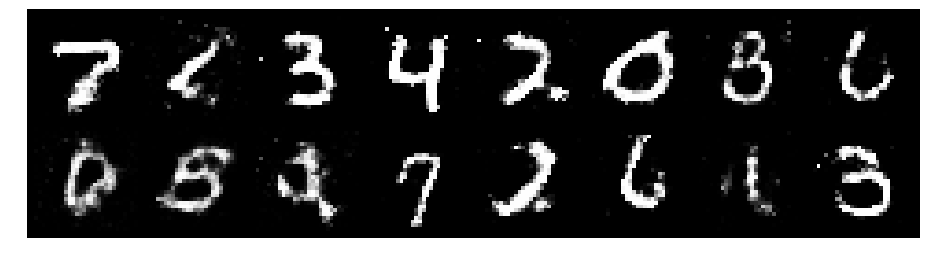

Epoch: [93/200], Batch Num: [500/600]
Discriminator Loss: 1.2310, Generator Loss: 1.0049
D(x): 0.5689, D(G(z)): 0.4413


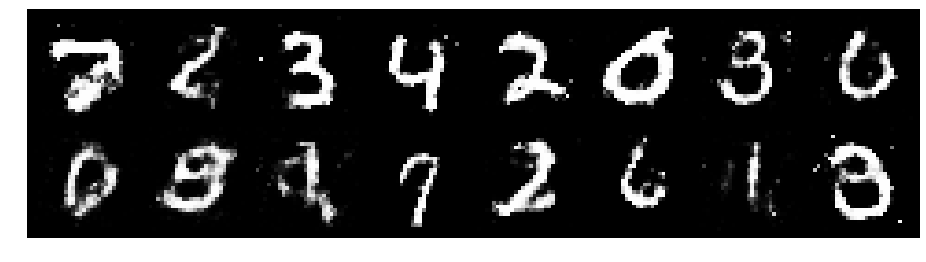

Epoch: [94/200], Batch Num: [0/600]
Discriminator Loss: 1.2458, Generator Loss: 0.8900
D(x): 0.5505, D(G(z)): 0.4328


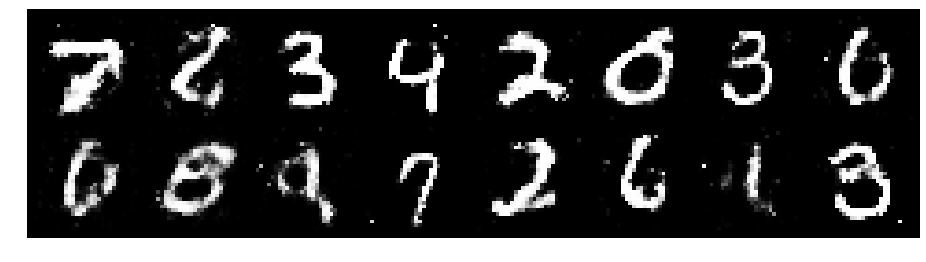

Epoch: [94/200], Batch Num: [100/600]
Discriminator Loss: 1.2301, Generator Loss: 0.9406
D(x): 0.5647, D(G(z)): 0.4343


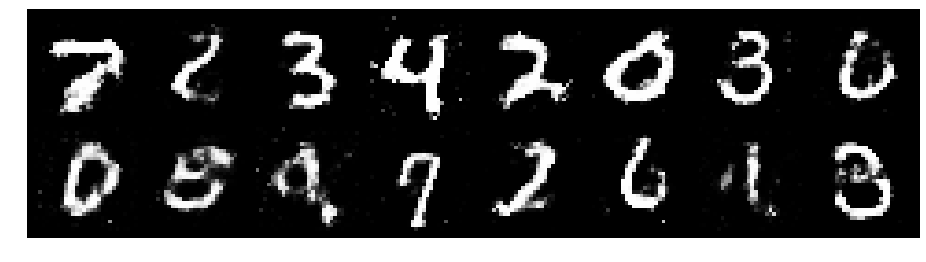

Epoch: [94/200], Batch Num: [200/600]
Discriminator Loss: 1.1336, Generator Loss: 0.9925
D(x): 0.6003, D(G(z)): 0.4040


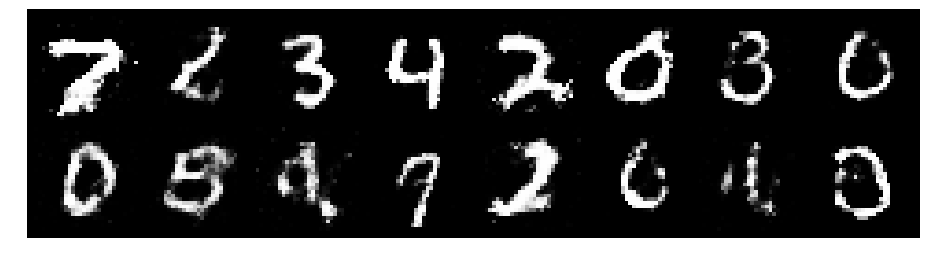

Epoch: [94/200], Batch Num: [300/600]
Discriminator Loss: 1.2433, Generator Loss: 0.9681
D(x): 0.5420, D(G(z)): 0.4231


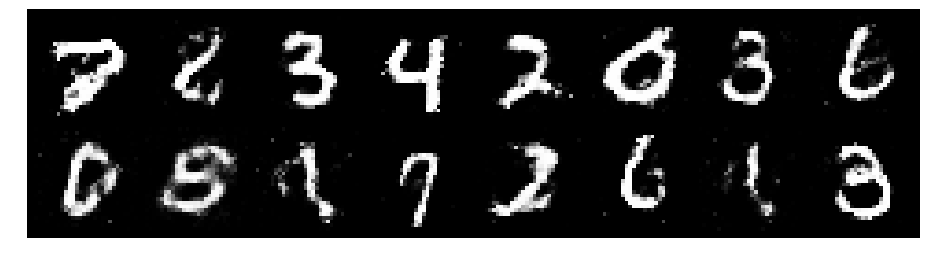

Epoch: [94/200], Batch Num: [400/600]
Discriminator Loss: 1.1957, Generator Loss: 1.0276
D(x): 0.5545, D(G(z)): 0.4164


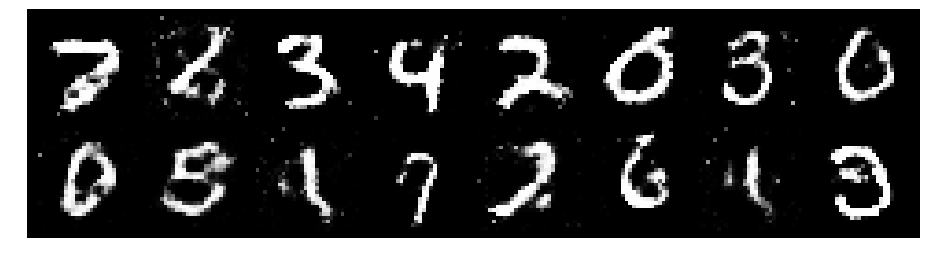

Epoch: [94/200], Batch Num: [500/600]
Discriminator Loss: 1.2867, Generator Loss: 0.8873
D(x): 0.5478, D(G(z)): 0.4685


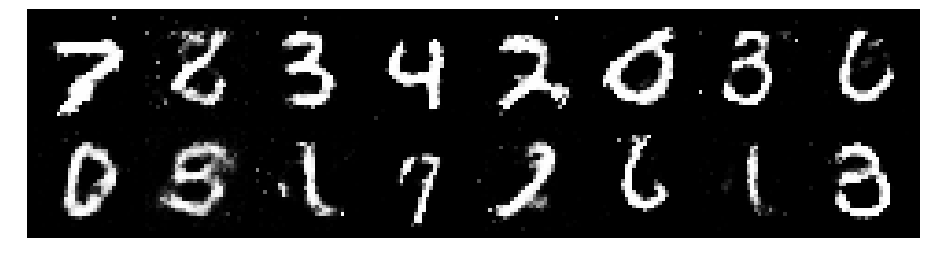

Epoch: [95/200], Batch Num: [0/600]
Discriminator Loss: 1.2658, Generator Loss: 0.9212
D(x): 0.5532, D(G(z)): 0.4405


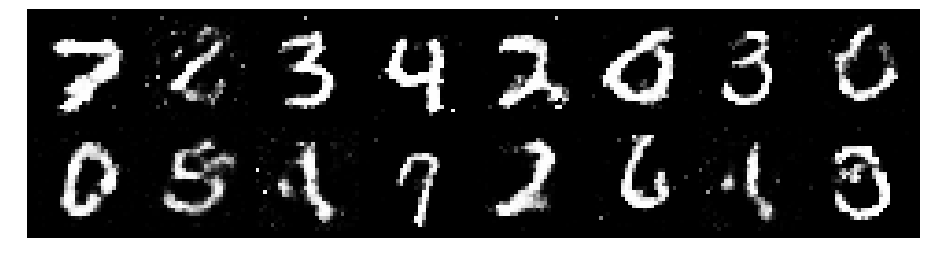

Epoch: [95/200], Batch Num: [100/600]
Discriminator Loss: 1.2247, Generator Loss: 0.8722
D(x): 0.5675, D(G(z)): 0.4450


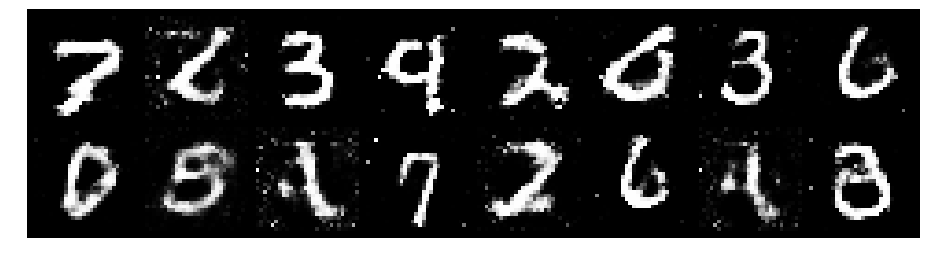

Epoch: [95/200], Batch Num: [200/600]
Discriminator Loss: 1.3172, Generator Loss: 0.7933
D(x): 0.5584, D(G(z)): 0.4574


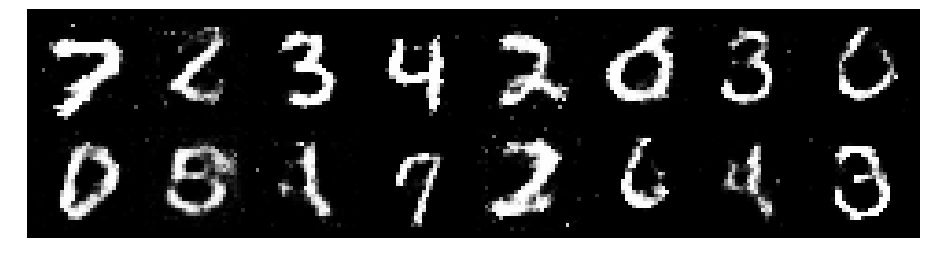

Epoch: [95/200], Batch Num: [300/600]
Discriminator Loss: 1.3064, Generator Loss: 0.8039
D(x): 0.5740, D(G(z)): 0.4753


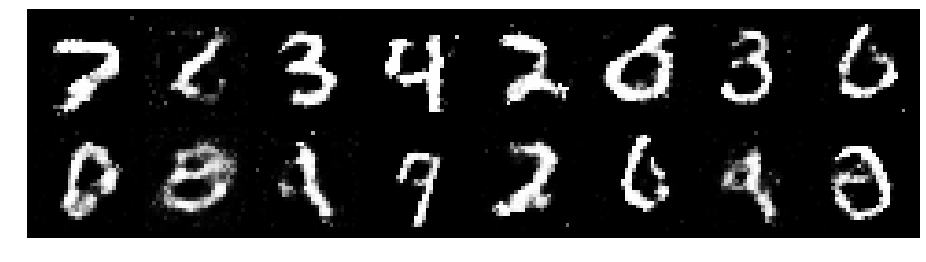

Epoch: [95/200], Batch Num: [400/600]
Discriminator Loss: 1.2966, Generator Loss: 0.8675
D(x): 0.5603, D(G(z)): 0.4512


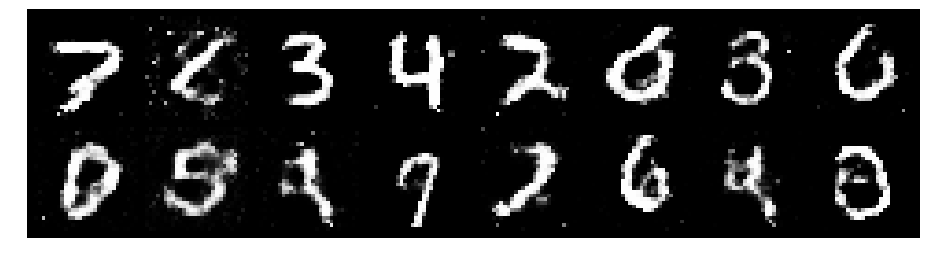

Epoch: [95/200], Batch Num: [500/600]
Discriminator Loss: 1.1739, Generator Loss: 0.8828
D(x): 0.5620, D(G(z)): 0.4061


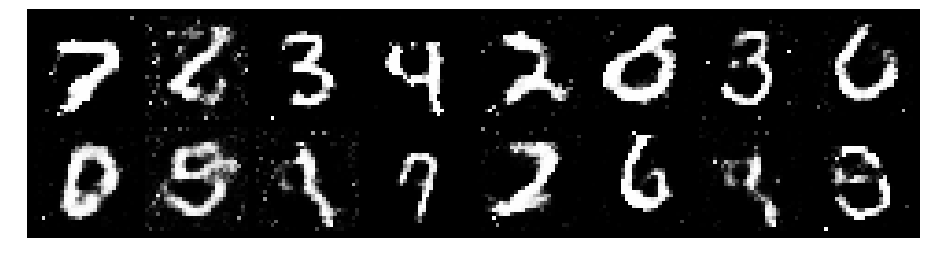

Epoch: [96/200], Batch Num: [0/600]
Discriminator Loss: 1.4211, Generator Loss: 0.9335
D(x): 0.5194, D(G(z)): 0.4575


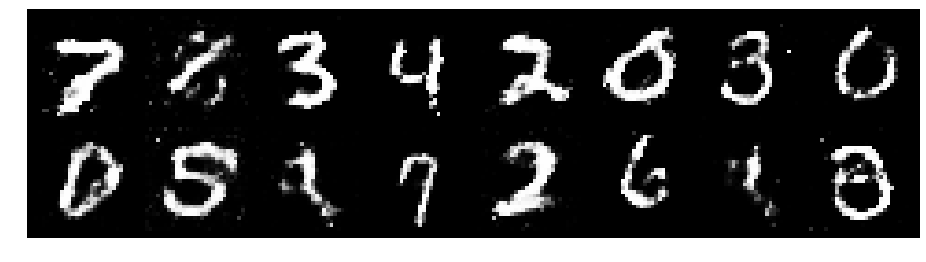

Epoch: [96/200], Batch Num: [100/600]
Discriminator Loss: 1.2132, Generator Loss: 0.9277
D(x): 0.5624, D(G(z)): 0.4262


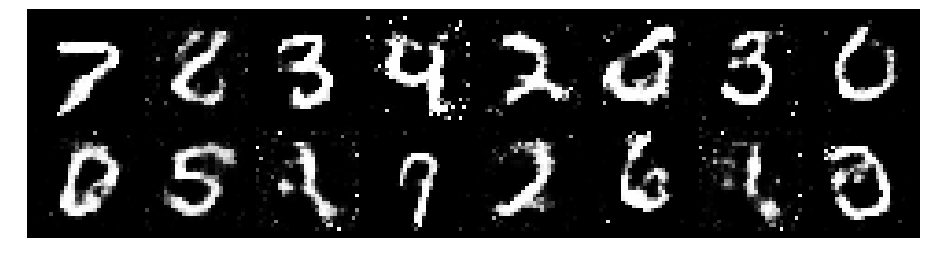

Epoch: [96/200], Batch Num: [200/600]
Discriminator Loss: 1.2449, Generator Loss: 0.8447
D(x): 0.5388, D(G(z)): 0.4309


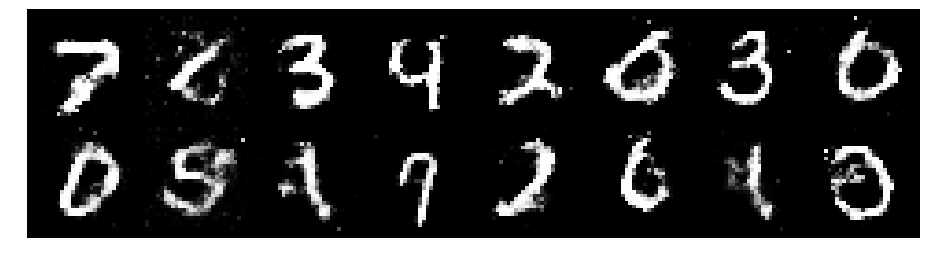

Epoch: [96/200], Batch Num: [300/600]
Discriminator Loss: 1.2673, Generator Loss: 0.8817
D(x): 0.5446, D(G(z)): 0.4447


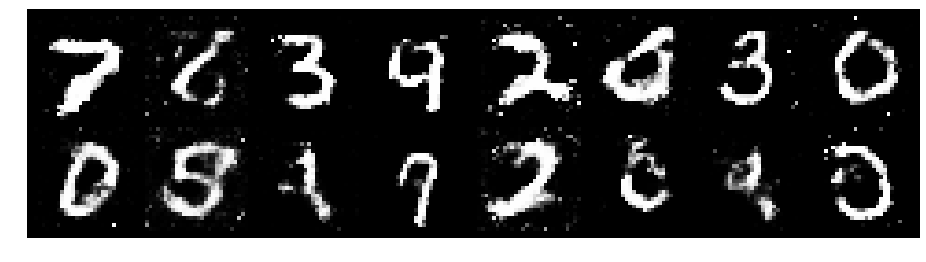

Epoch: [96/200], Batch Num: [400/600]
Discriminator Loss: 1.1731, Generator Loss: 1.0093
D(x): 0.5311, D(G(z)): 0.3663


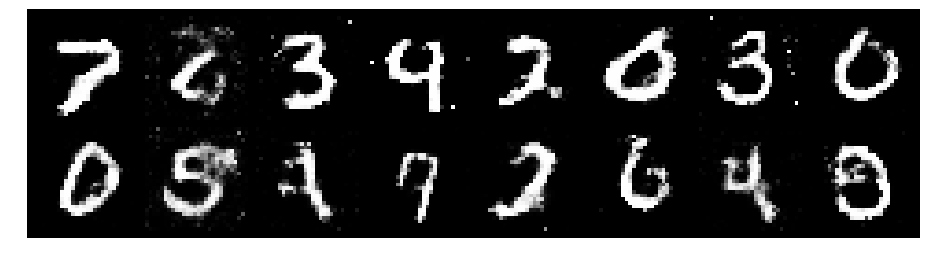

Epoch: [96/200], Batch Num: [500/600]
Discriminator Loss: 1.1903, Generator Loss: 0.9160
D(x): 0.5733, D(G(z)): 0.4112


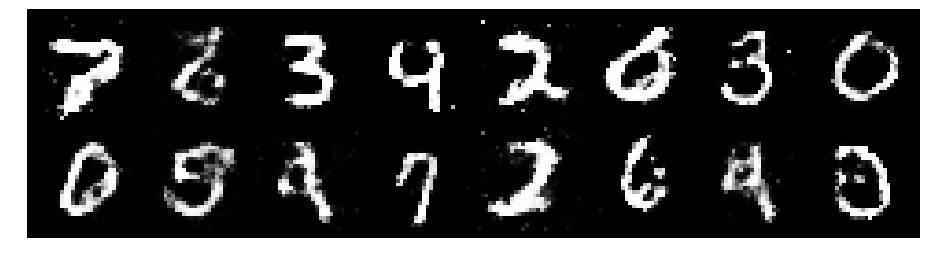

Epoch: [97/200], Batch Num: [0/600]
Discriminator Loss: 1.2587, Generator Loss: 0.8762
D(x): 0.5733, D(G(z)): 0.4595


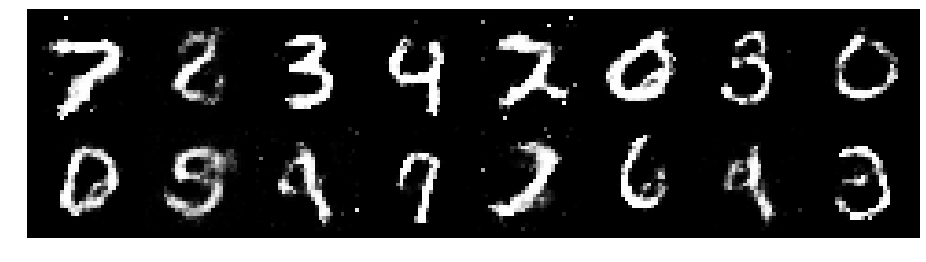

Epoch: [97/200], Batch Num: [100/600]
Discriminator Loss: 1.3866, Generator Loss: 0.8170
D(x): 0.5514, D(G(z)): 0.4688


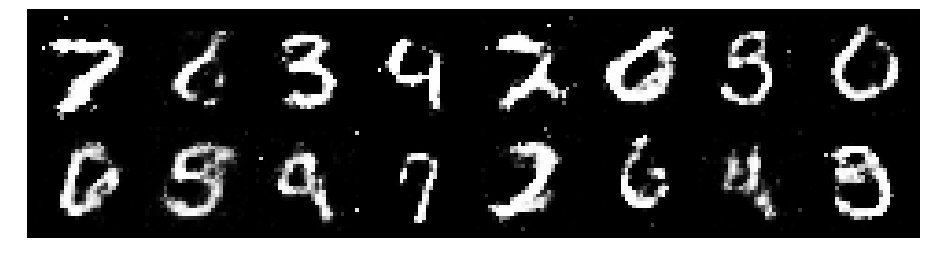

Epoch: [97/200], Batch Num: [200/600]
Discriminator Loss: 1.3592, Generator Loss: 0.7997
D(x): 0.5394, D(G(z)): 0.4262


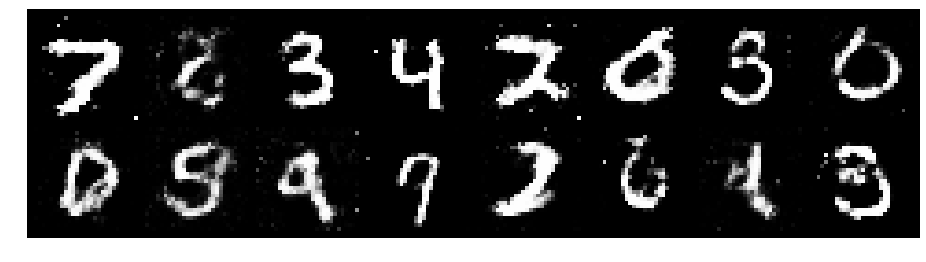

Epoch: [97/200], Batch Num: [300/600]
Discriminator Loss: 1.3284, Generator Loss: 1.0057
D(x): 0.5493, D(G(z)): 0.4242


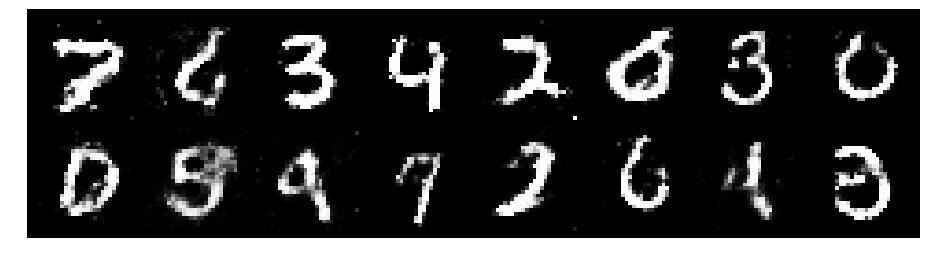

Epoch: [97/200], Batch Num: [400/600]
Discriminator Loss: 1.2934, Generator Loss: 0.8098
D(x): 0.5497, D(G(z)): 0.4393


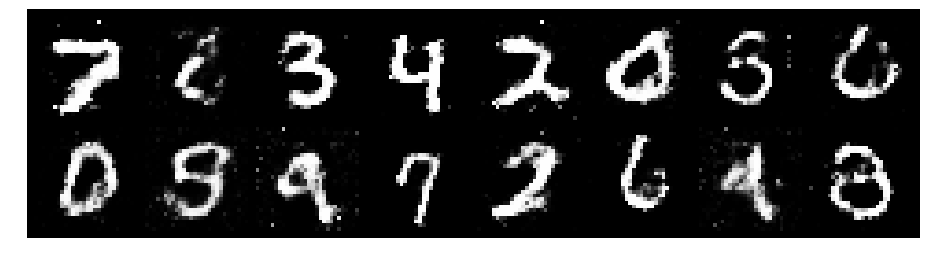

Epoch: [97/200], Batch Num: [500/600]
Discriminator Loss: 1.2449, Generator Loss: 0.9085
D(x): 0.5690, D(G(z)): 0.4464


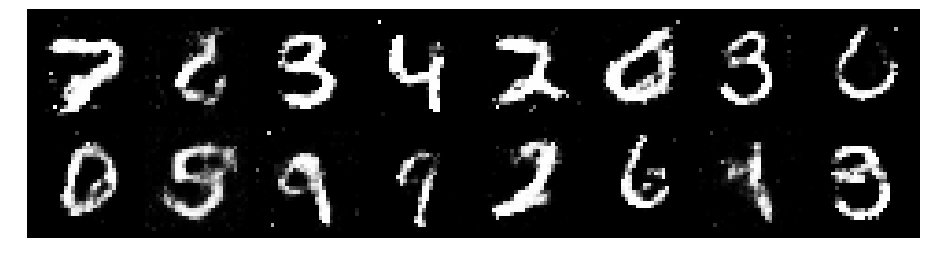

Epoch: [98/200], Batch Num: [0/600]
Discriminator Loss: 1.2253, Generator Loss: 0.9603
D(x): 0.5743, D(G(z)): 0.4278


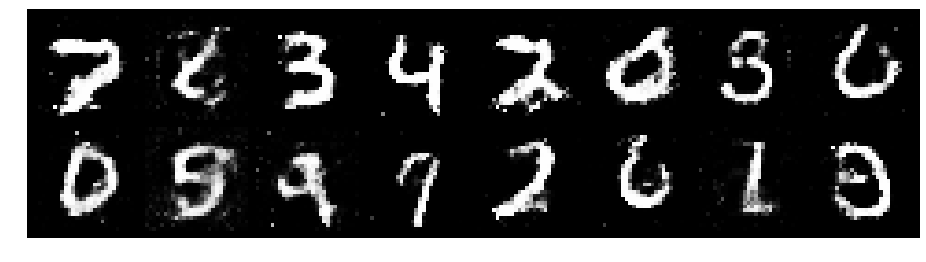

Epoch: [98/200], Batch Num: [100/600]
Discriminator Loss: 1.1023, Generator Loss: 1.0798
D(x): 0.5793, D(G(z)): 0.3604


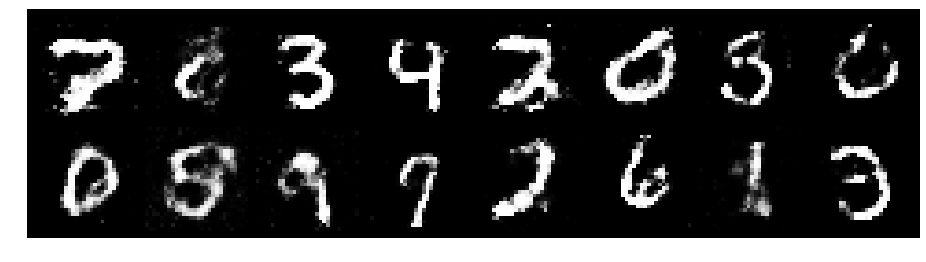

Epoch: [98/200], Batch Num: [200/600]
Discriminator Loss: 1.2153, Generator Loss: 0.9358
D(x): 0.5459, D(G(z)): 0.4041


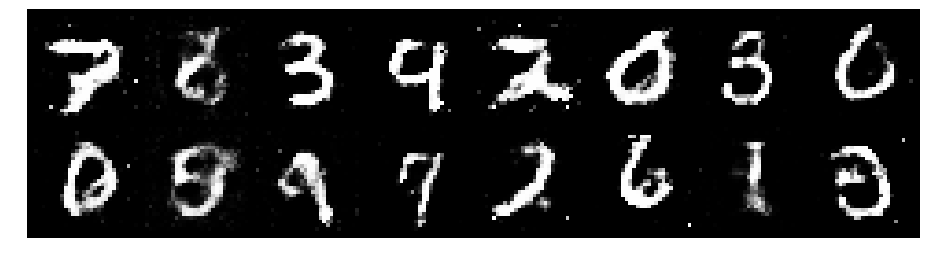

Epoch: [98/200], Batch Num: [300/600]
Discriminator Loss: 1.3500, Generator Loss: 0.9619
D(x): 0.5340, D(G(z)): 0.4373


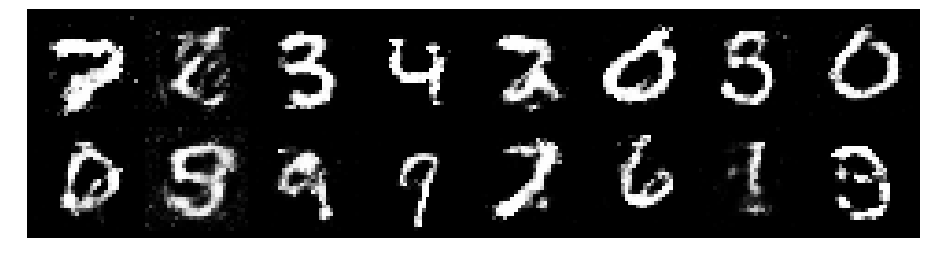

Epoch: [98/200], Batch Num: [400/600]
Discriminator Loss: 1.2488, Generator Loss: 0.8949
D(x): 0.5469, D(G(z)): 0.4381


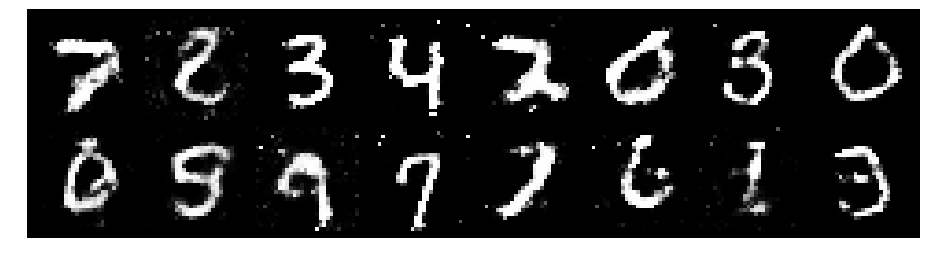

Epoch: [98/200], Batch Num: [500/600]
Discriminator Loss: 1.2561, Generator Loss: 0.8637
D(x): 0.5407, D(G(z)): 0.4070


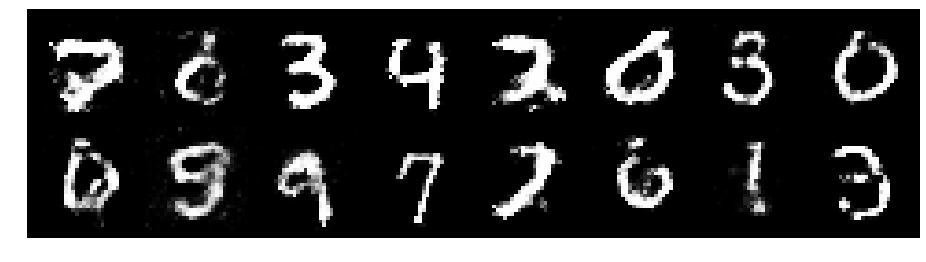

Epoch: [99/200], Batch Num: [0/600]
Discriminator Loss: 1.2527, Generator Loss: 0.8367
D(x): 0.6276, D(G(z)): 0.4881


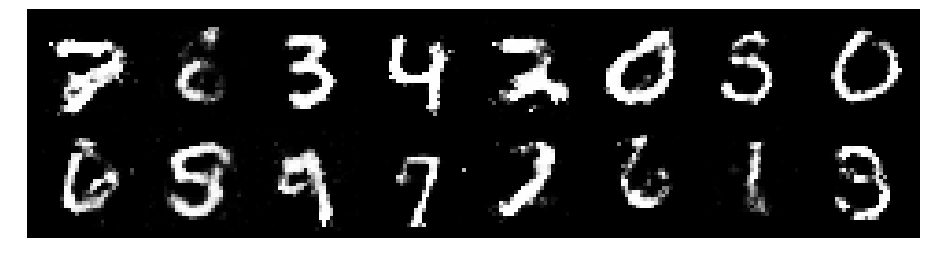

Epoch: [99/200], Batch Num: [100/600]
Discriminator Loss: 1.3030, Generator Loss: 0.8736
D(x): 0.5427, D(G(z)): 0.4199


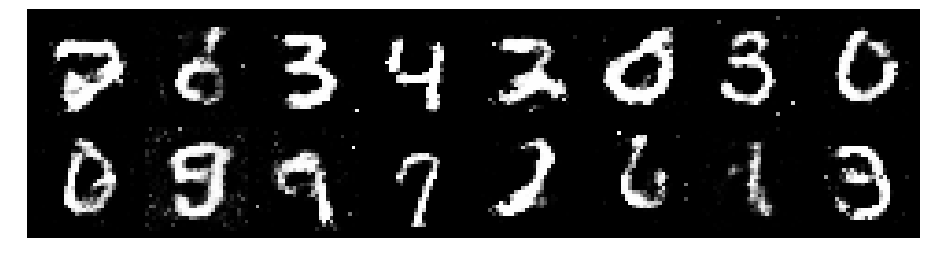

Epoch: [99/200], Batch Num: [200/600]
Discriminator Loss: 1.2007, Generator Loss: 0.9486
D(x): 0.5464, D(G(z)): 0.3895


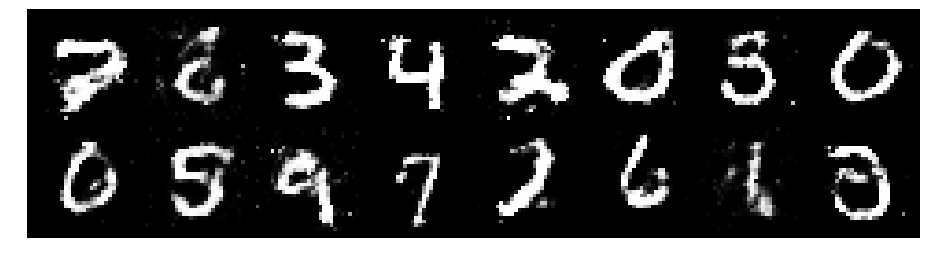

Epoch: [99/200], Batch Num: [300/600]
Discriminator Loss: 1.2122, Generator Loss: 1.0234
D(x): 0.5993, D(G(z)): 0.4532


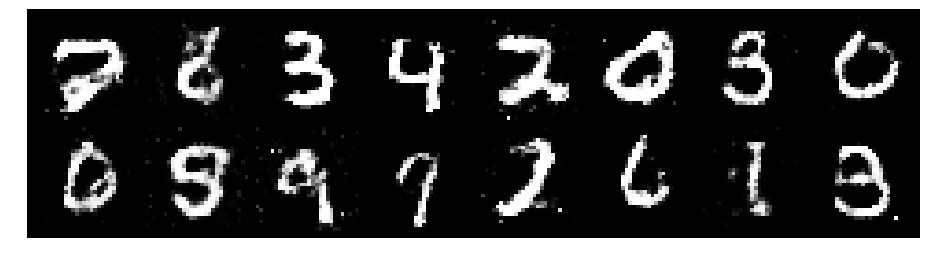

Epoch: [99/200], Batch Num: [400/600]
Discriminator Loss: 1.2670, Generator Loss: 1.0021
D(x): 0.5190, D(G(z)): 0.3873


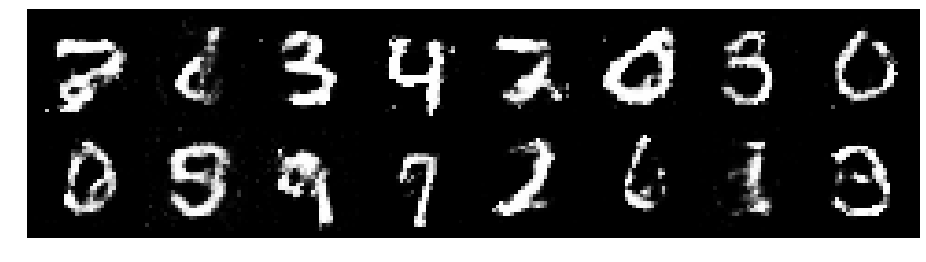

Epoch: [99/200], Batch Num: [500/600]
Discriminator Loss: 1.2539, Generator Loss: 1.0089
D(x): 0.5588, D(G(z)): 0.4329


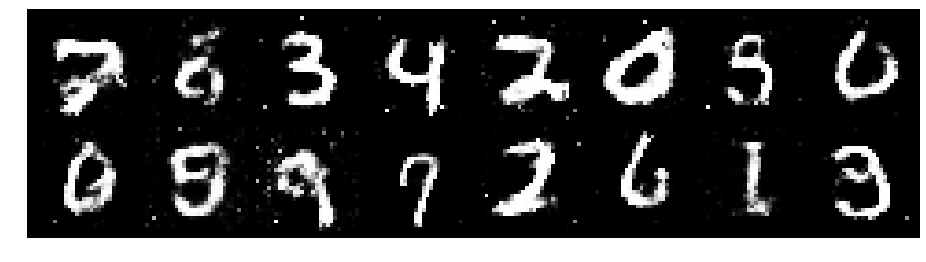

Epoch: [100/200], Batch Num: [0/600]
Discriminator Loss: 1.2618, Generator Loss: 0.9619
D(x): 0.5940, D(G(z)): 0.4438


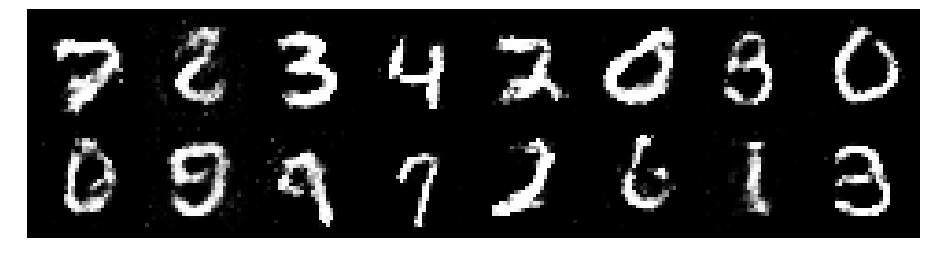

Epoch: [100/200], Batch Num: [100/600]
Discriminator Loss: 1.2573, Generator Loss: 0.9274
D(x): 0.5538, D(G(z)): 0.4084


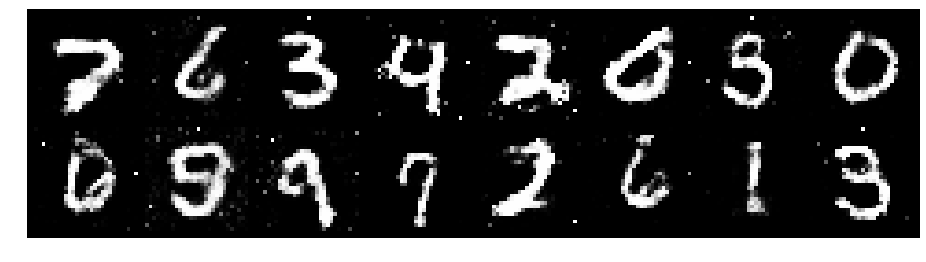

Epoch: [100/200], Batch Num: [200/600]
Discriminator Loss: 1.1846, Generator Loss: 1.1275
D(x): 0.5632, D(G(z)): 0.4124


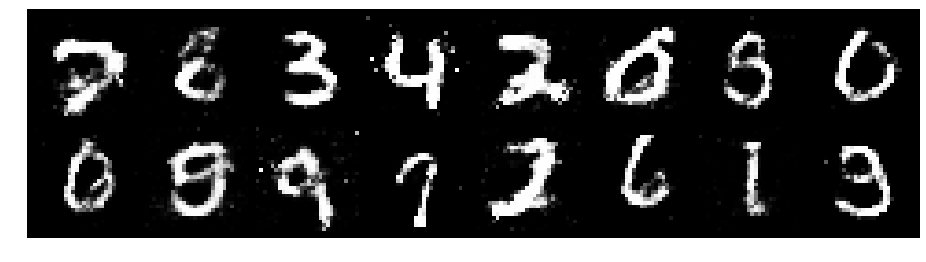

Epoch: [100/200], Batch Num: [300/600]
Discriminator Loss: 1.1232, Generator Loss: 1.0279
D(x): 0.5964, D(G(z)): 0.3893


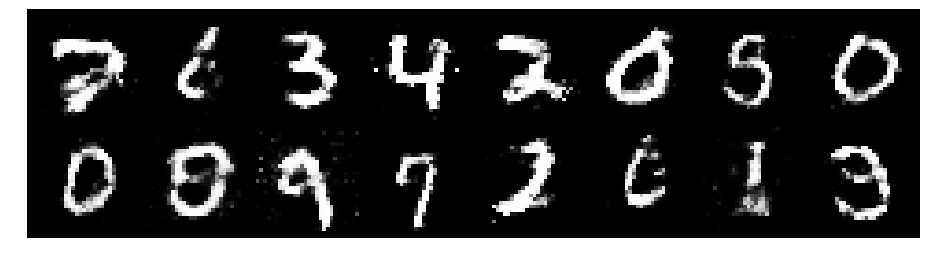

Epoch: [100/200], Batch Num: [400/600]
Discriminator Loss: 1.1862, Generator Loss: 1.0890
D(x): 0.5505, D(G(z)): 0.3729


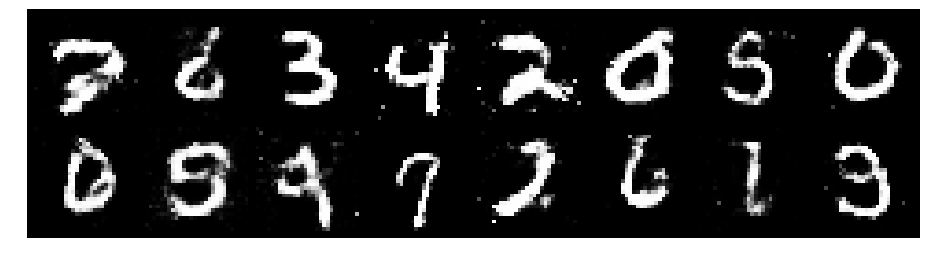

Epoch: [100/200], Batch Num: [500/600]
Discriminator Loss: 1.2315, Generator Loss: 0.9713
D(x): 0.5969, D(G(z)): 0.4586


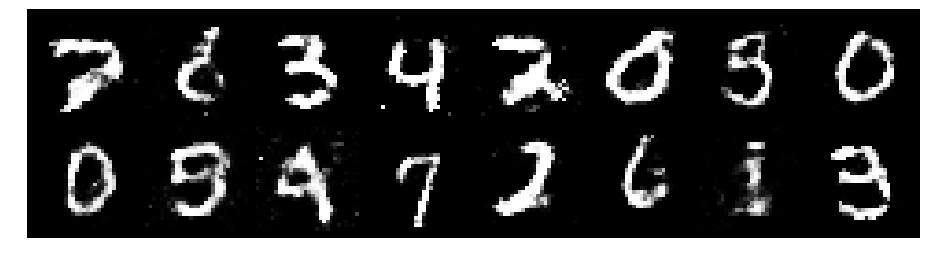

Epoch: [101/200], Batch Num: [0/600]
Discriminator Loss: 1.2434, Generator Loss: 0.8805
D(x): 0.5714, D(G(z)): 0.4449


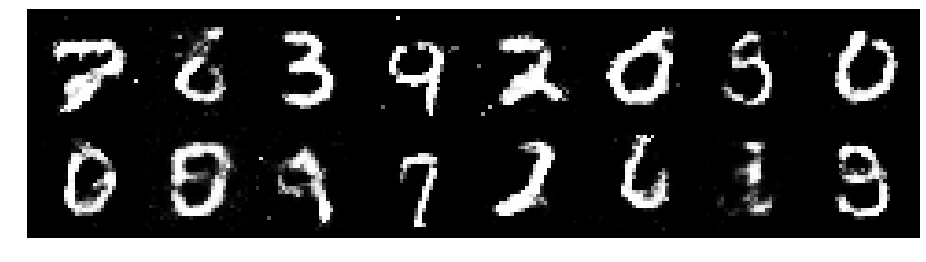

Epoch: [101/200], Batch Num: [100/600]
Discriminator Loss: 1.3582, Generator Loss: 0.9307
D(x): 0.5452, D(G(z)): 0.4676


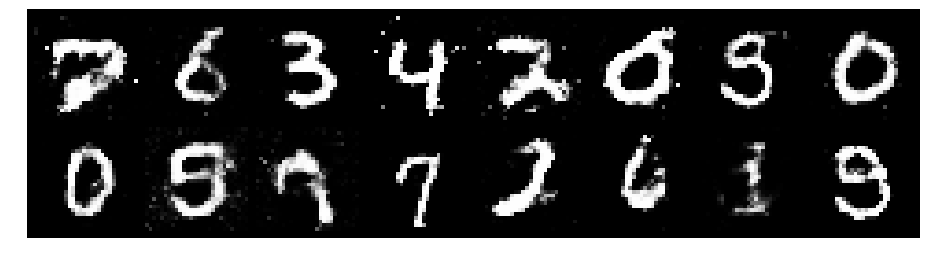

Epoch: [101/200], Batch Num: [200/600]
Discriminator Loss: 1.4592, Generator Loss: 0.8363
D(x): 0.5390, D(G(z)): 0.4805


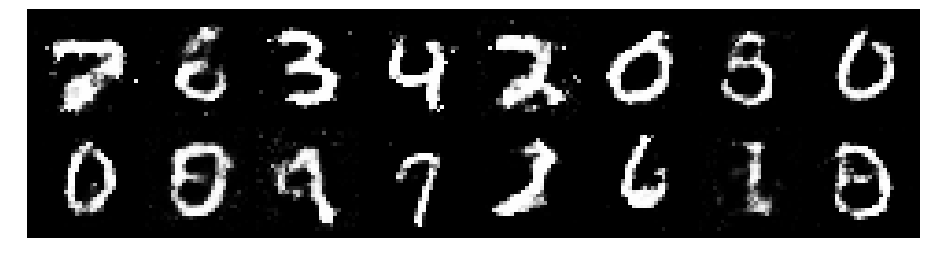

Epoch: [101/200], Batch Num: [300/600]
Discriminator Loss: 1.2862, Generator Loss: 0.9695
D(x): 0.5623, D(G(z)): 0.4237


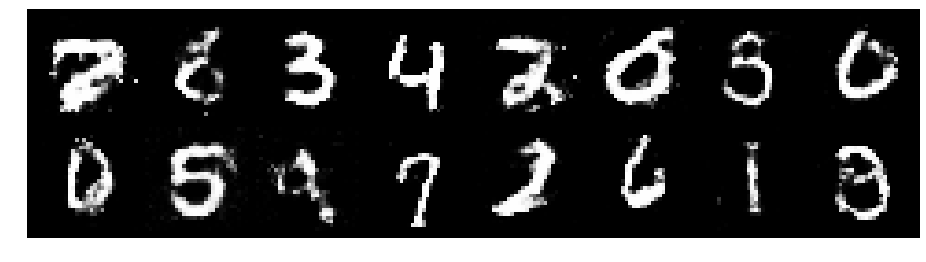

Epoch: [101/200], Batch Num: [400/600]
Discriminator Loss: 1.1152, Generator Loss: 0.8839
D(x): 0.5781, D(G(z)): 0.3682


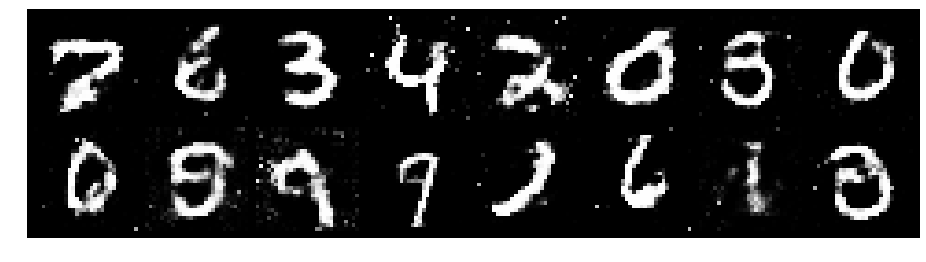

Epoch: [101/200], Batch Num: [500/600]
Discriminator Loss: 1.1951, Generator Loss: 0.9550
D(x): 0.5641, D(G(z)): 0.4001


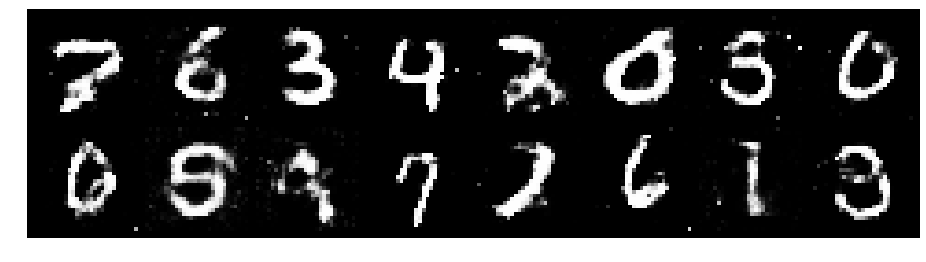

Epoch: [102/200], Batch Num: [0/600]
Discriminator Loss: 1.1691, Generator Loss: 1.0194
D(x): 0.5610, D(G(z)): 0.3957


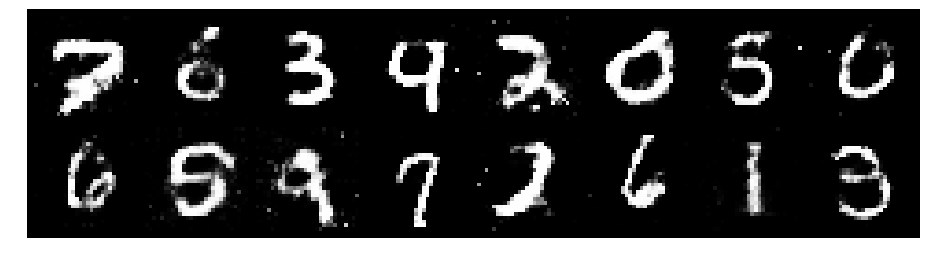

Epoch: [102/200], Batch Num: [100/600]
Discriminator Loss: 1.2765, Generator Loss: 0.8629
D(x): 0.5669, D(G(z)): 0.4474


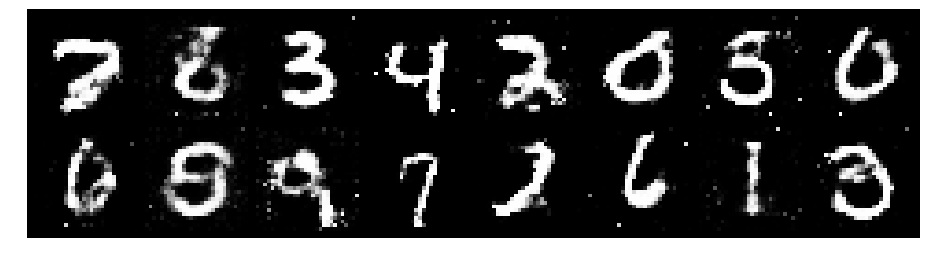

Epoch: [102/200], Batch Num: [200/600]
Discriminator Loss: 1.1004, Generator Loss: 0.9828
D(x): 0.6056, D(G(z)): 0.3958


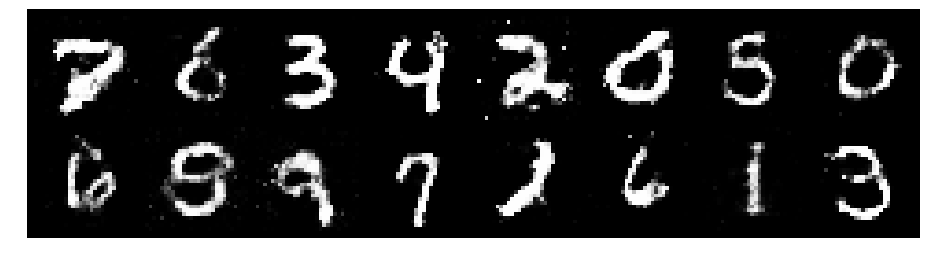

Epoch: [102/200], Batch Num: [300/600]
Discriminator Loss: 1.2032, Generator Loss: 0.8815
D(x): 0.5650, D(G(z)): 0.4137


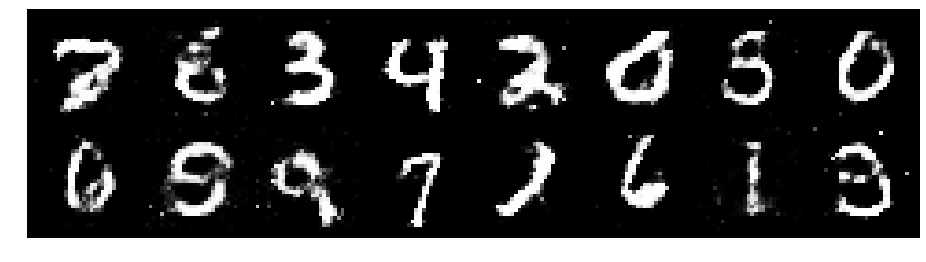

Epoch: [102/200], Batch Num: [400/600]
Discriminator Loss: 1.1942, Generator Loss: 0.8990
D(x): 0.5586, D(G(z)): 0.4049


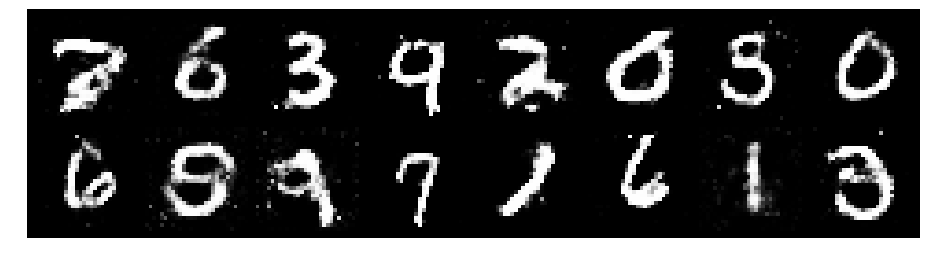

Epoch: [102/200], Batch Num: [500/600]
Discriminator Loss: 1.2952, Generator Loss: 0.8198
D(x): 0.5351, D(G(z)): 0.4554


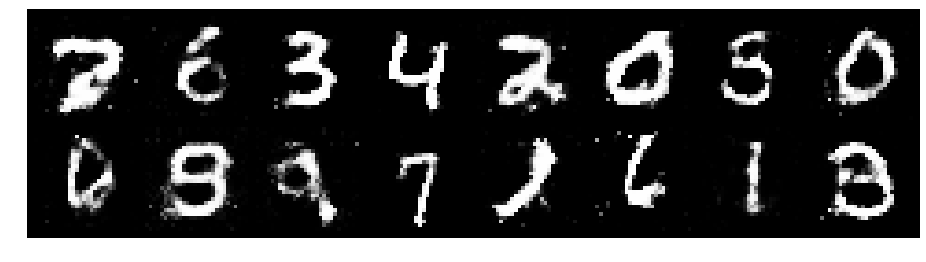

Epoch: [103/200], Batch Num: [0/600]
Discriminator Loss: 1.2411, Generator Loss: 1.0274
D(x): 0.5889, D(G(z)): 0.4387


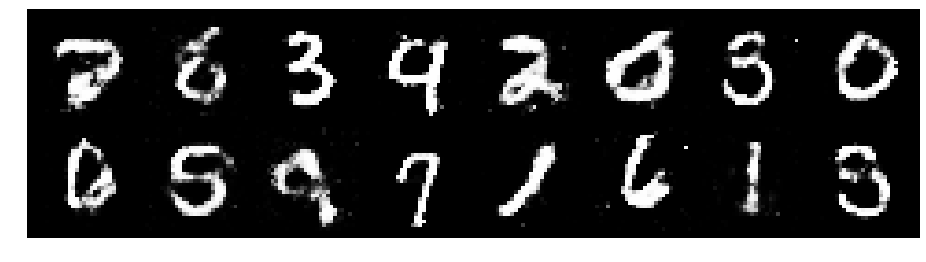

Epoch: [103/200], Batch Num: [100/600]
Discriminator Loss: 1.2986, Generator Loss: 0.9362
D(x): 0.5255, D(G(z)): 0.4438


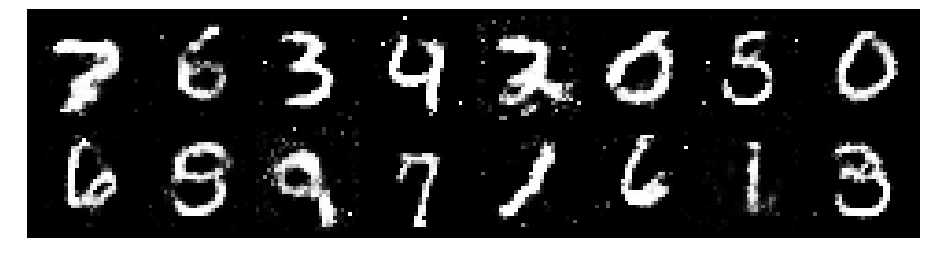

Epoch: [103/200], Batch Num: [200/600]
Discriminator Loss: 1.2610, Generator Loss: 0.8812
D(x): 0.5340, D(G(z)): 0.4135


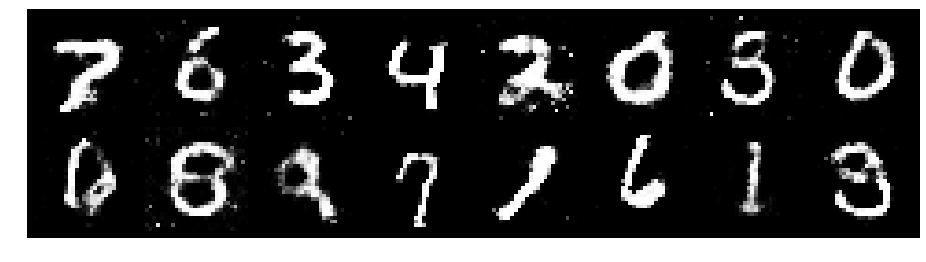

Epoch: [103/200], Batch Num: [300/600]
Discriminator Loss: 1.1999, Generator Loss: 0.8955
D(x): 0.5551, D(G(z)): 0.4253


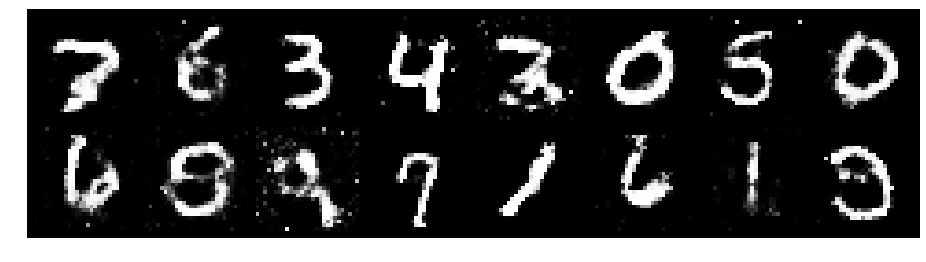

Epoch: [103/200], Batch Num: [400/600]
Discriminator Loss: 1.2836, Generator Loss: 0.8689
D(x): 0.5715, D(G(z)): 0.4709


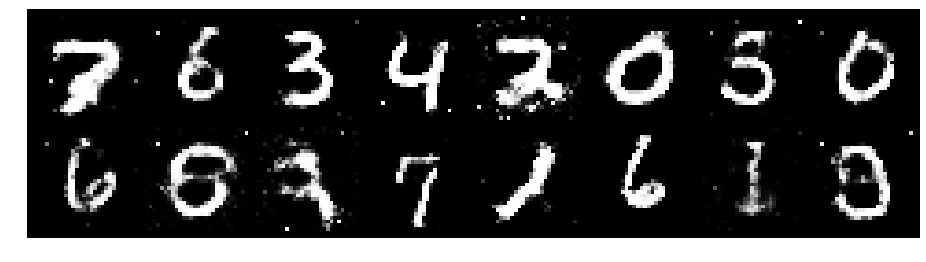

Epoch: [103/200], Batch Num: [500/600]
Discriminator Loss: 1.2372, Generator Loss: 0.8633
D(x): 0.5712, D(G(z)): 0.4486


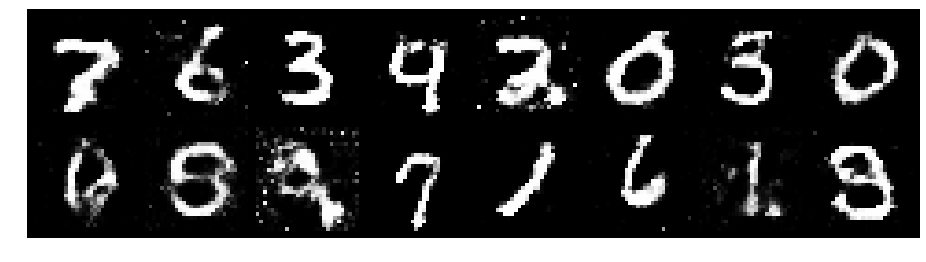

Epoch: [104/200], Batch Num: [0/600]
Discriminator Loss: 1.1453, Generator Loss: 0.9349
D(x): 0.6231, D(G(z)): 0.4480


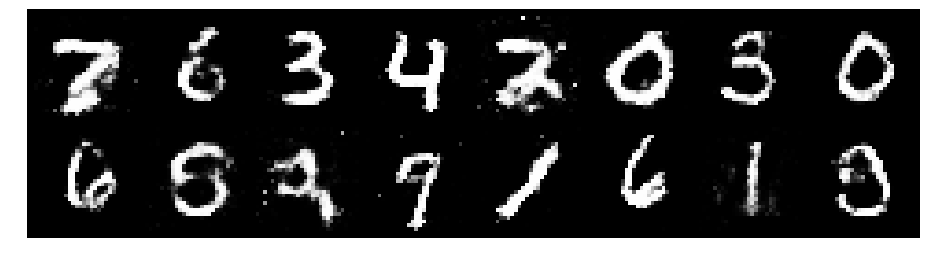

Epoch: [104/200], Batch Num: [100/600]
Discriminator Loss: 1.1797, Generator Loss: 0.9580
D(x): 0.6164, D(G(z)): 0.4334


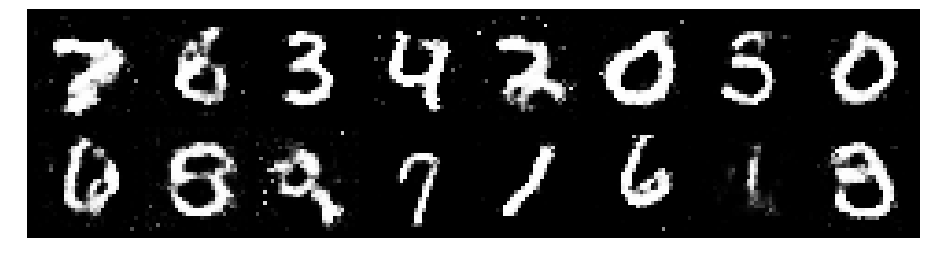

Epoch: [104/200], Batch Num: [200/600]
Discriminator Loss: 1.2515, Generator Loss: 0.8977
D(x): 0.5621, D(G(z)): 0.4169


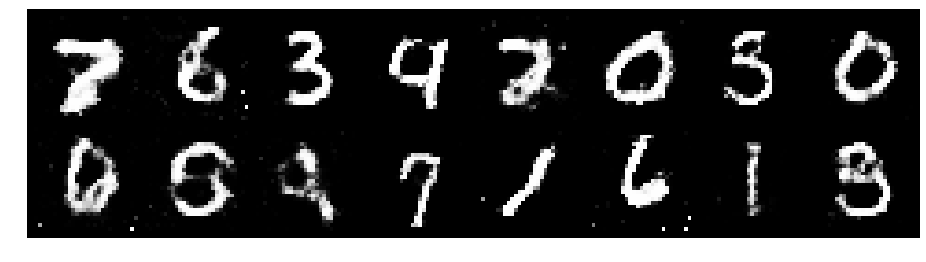

Epoch: [104/200], Batch Num: [300/600]
Discriminator Loss: 1.2334, Generator Loss: 0.9062
D(x): 0.5995, D(G(z)): 0.4480


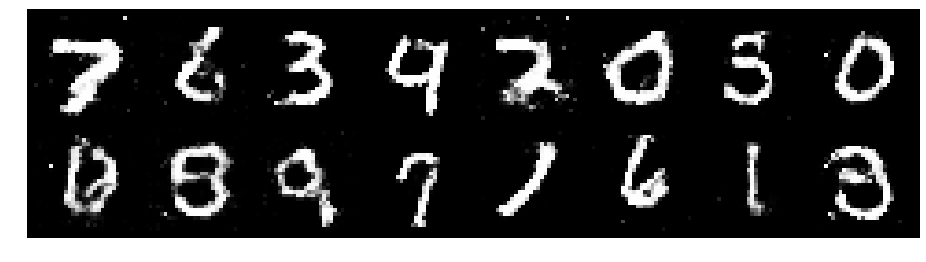

Epoch: [104/200], Batch Num: [400/600]
Discriminator Loss: 1.0973, Generator Loss: 0.9520
D(x): 0.6412, D(G(z)): 0.4203


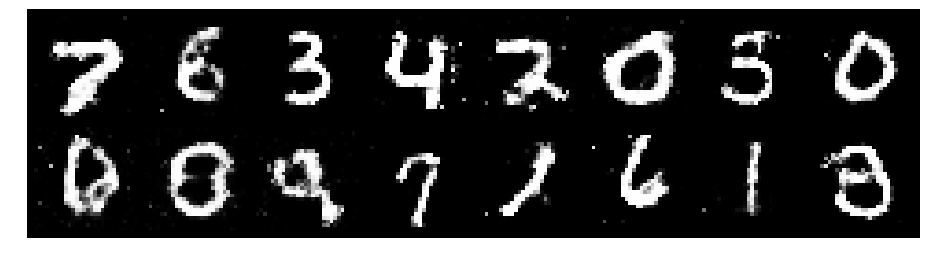

Epoch: [104/200], Batch Num: [500/600]
Discriminator Loss: 1.2100, Generator Loss: 0.9668
D(x): 0.5704, D(G(z)): 0.4131


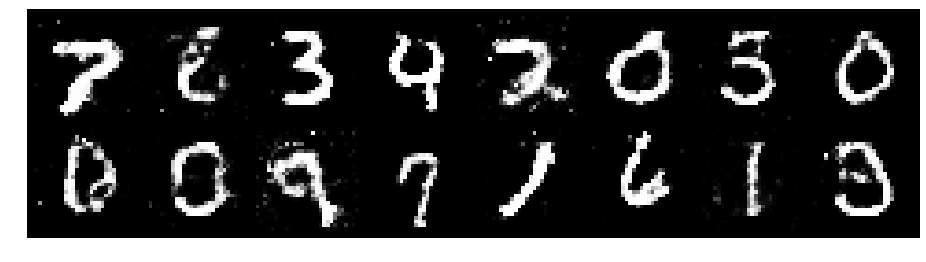

Epoch: [105/200], Batch Num: [0/600]
Discriminator Loss: 1.1987, Generator Loss: 1.1222
D(x): 0.5886, D(G(z)): 0.4165


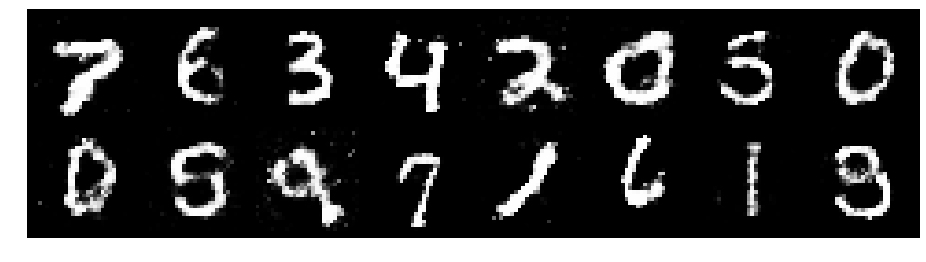

Epoch: [105/200], Batch Num: [100/600]
Discriminator Loss: 1.3662, Generator Loss: 0.9201
D(x): 0.5930, D(G(z)): 0.5151


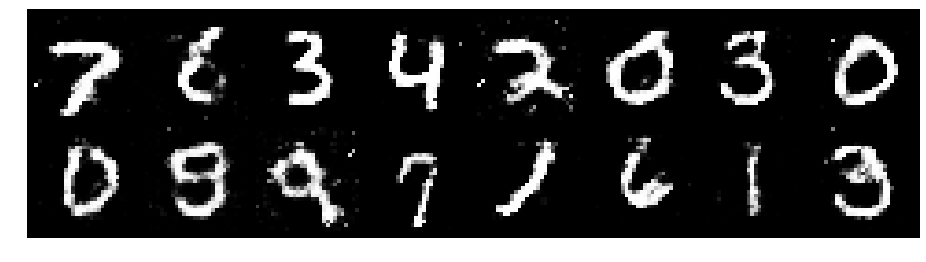

Epoch: [105/200], Batch Num: [200/600]
Discriminator Loss: 1.2955, Generator Loss: 0.8208
D(x): 0.5716, D(G(z)): 0.4688


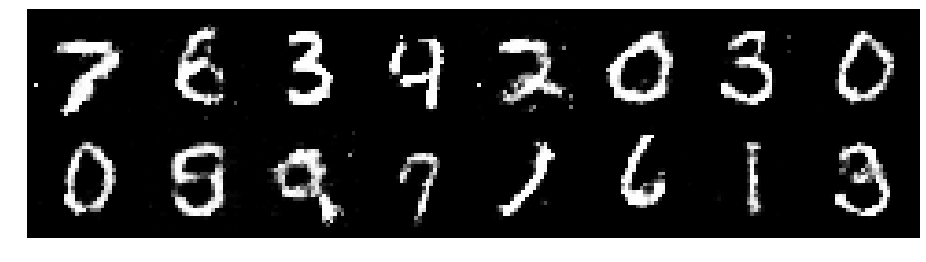

Epoch: [105/200], Batch Num: [300/600]
Discriminator Loss: 1.3307, Generator Loss: 0.9004
D(x): 0.5359, D(G(z)): 0.4525


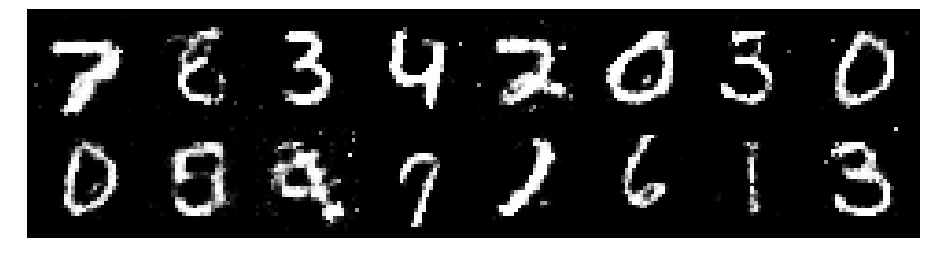

Epoch: [105/200], Batch Num: [400/600]
Discriminator Loss: 1.3168, Generator Loss: 0.7585
D(x): 0.5423, D(G(z)): 0.4747


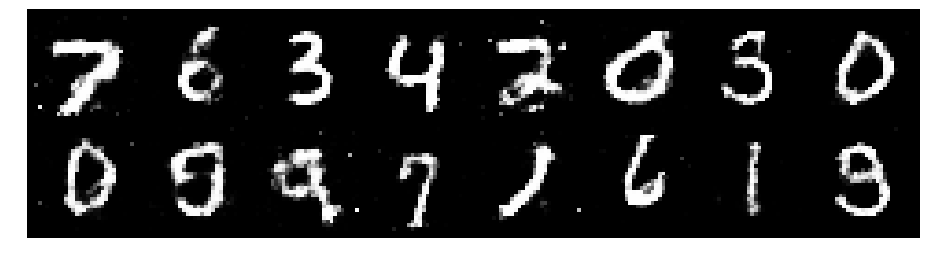

Epoch: [105/200], Batch Num: [500/600]
Discriminator Loss: 1.1898, Generator Loss: 0.8425
D(x): 0.5772, D(G(z)): 0.4431


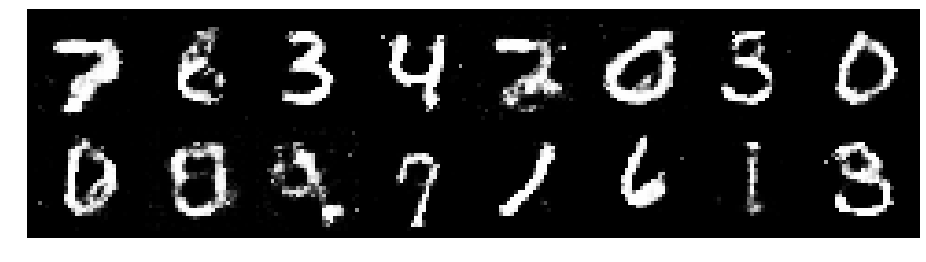

Epoch: [106/200], Batch Num: [0/600]
Discriminator Loss: 1.3197, Generator Loss: 0.9388
D(x): 0.5292, D(G(z)): 0.4427


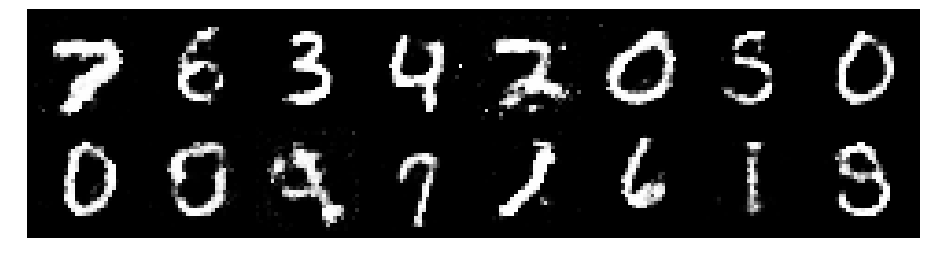

Epoch: [106/200], Batch Num: [100/600]
Discriminator Loss: 1.2030, Generator Loss: 0.7754
D(x): 0.5637, D(G(z)): 0.4386


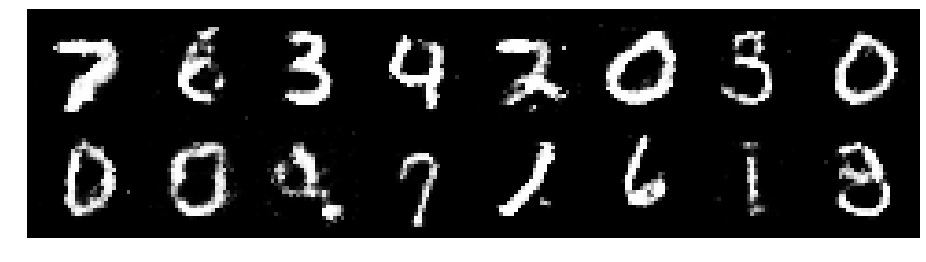

Epoch: [106/200], Batch Num: [200/600]
Discriminator Loss: 1.2965, Generator Loss: 0.9507
D(x): 0.5171, D(G(z)): 0.4409


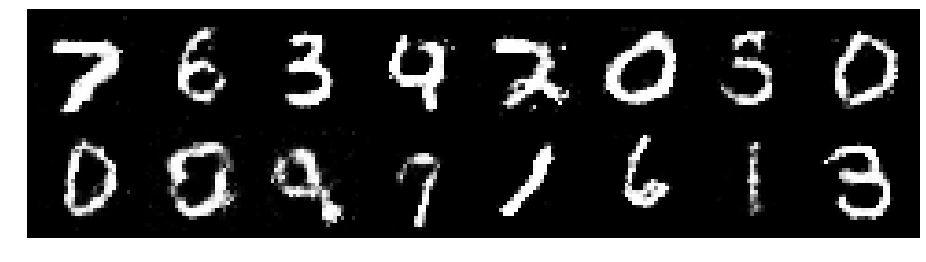

Epoch: [106/200], Batch Num: [300/600]
Discriminator Loss: 1.2292, Generator Loss: 0.8328
D(x): 0.6017, D(G(z)): 0.4751


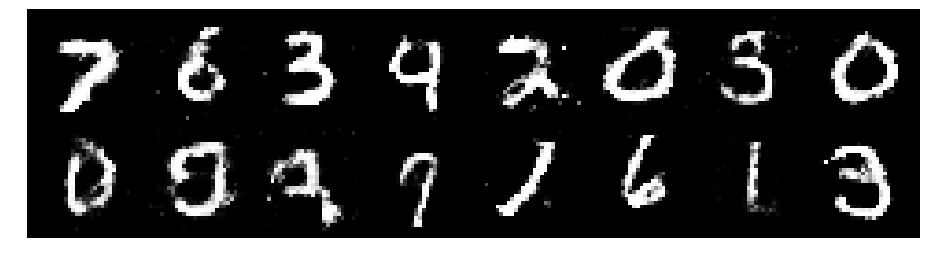

Epoch: [106/200], Batch Num: [400/600]
Discriminator Loss: 1.2923, Generator Loss: 0.9578
D(x): 0.5382, D(G(z)): 0.4478


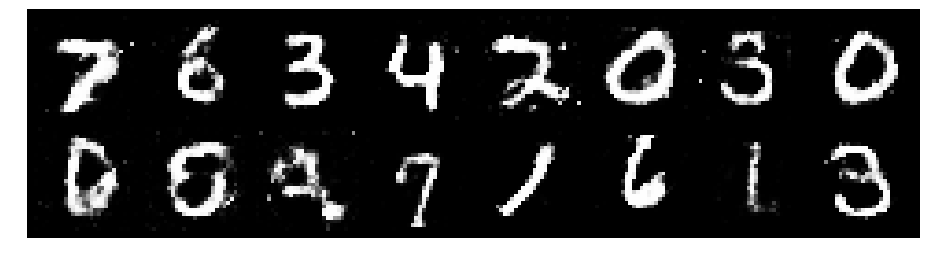

Epoch: [106/200], Batch Num: [500/600]
Discriminator Loss: 1.2174, Generator Loss: 0.8094
D(x): 0.6337, D(G(z)): 0.4662


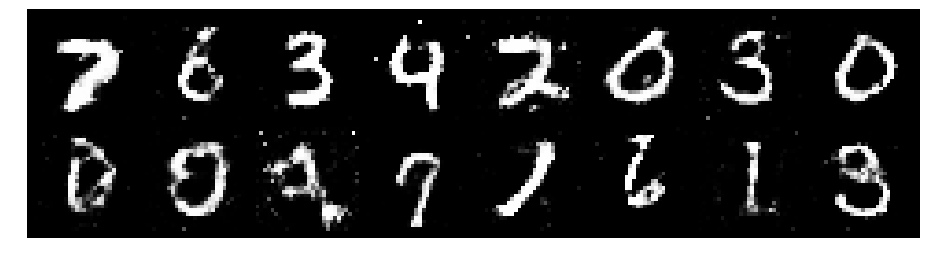

Epoch: [107/200], Batch Num: [0/600]
Discriminator Loss: 1.3342, Generator Loss: 0.9092
D(x): 0.5686, D(G(z)): 0.4691


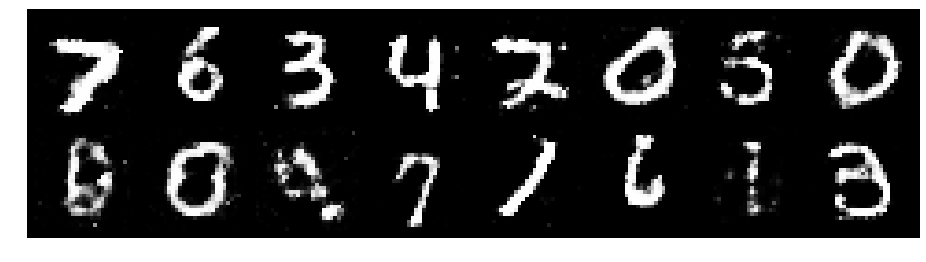

Epoch: [107/200], Batch Num: [100/600]
Discriminator Loss: 1.3791, Generator Loss: 0.8470
D(x): 0.5289, D(G(z)): 0.4567


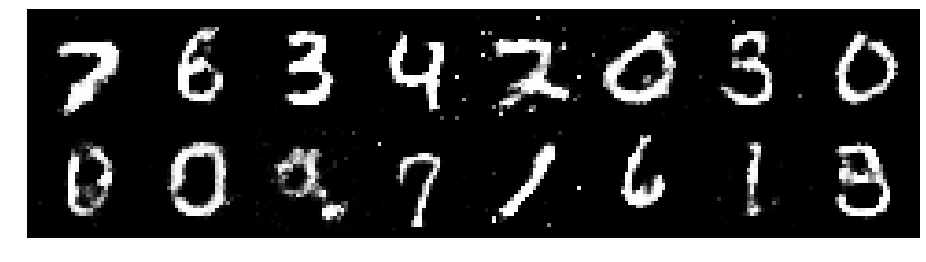

Epoch: [107/200], Batch Num: [200/600]
Discriminator Loss: 1.2149, Generator Loss: 0.8217
D(x): 0.5849, D(G(z)): 0.4463


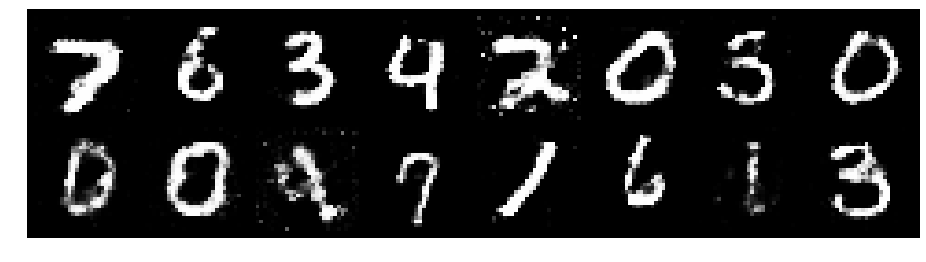

Epoch: [107/200], Batch Num: [300/600]
Discriminator Loss: 1.3421, Generator Loss: 0.7967
D(x): 0.5582, D(G(z)): 0.4785


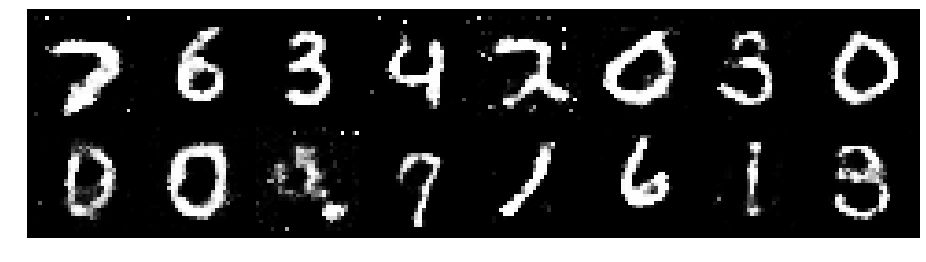

Epoch: [107/200], Batch Num: [400/600]
Discriminator Loss: 1.3381, Generator Loss: 0.7702
D(x): 0.5636, D(G(z)): 0.4863


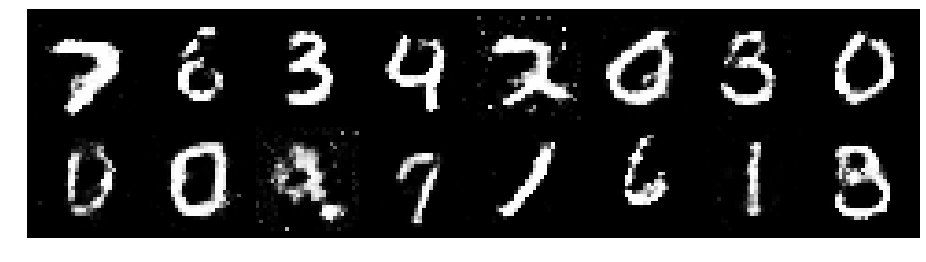

Epoch: [107/200], Batch Num: [500/600]
Discriminator Loss: 1.2511, Generator Loss: 0.9662
D(x): 0.5267, D(G(z)): 0.3966


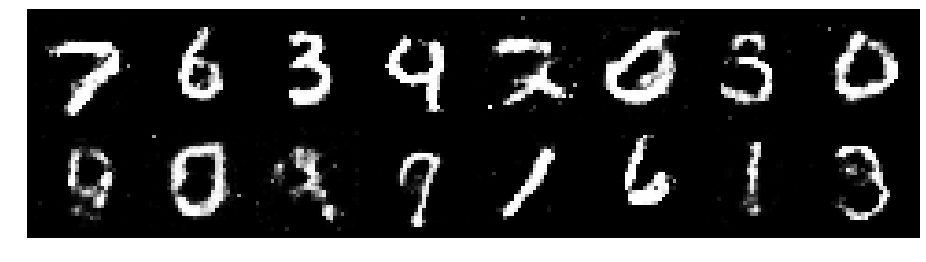

Epoch: [108/200], Batch Num: [0/600]
Discriminator Loss: 1.3566, Generator Loss: 1.0834
D(x): 0.4806, D(G(z)): 0.4002


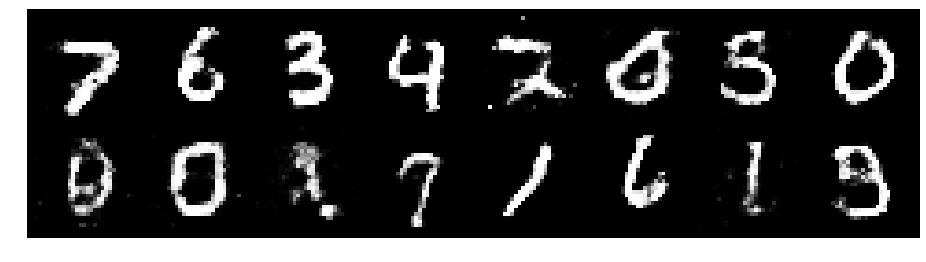

Epoch: [108/200], Batch Num: [100/600]
Discriminator Loss: 1.3159, Generator Loss: 0.7703
D(x): 0.5498, D(G(z)): 0.4749


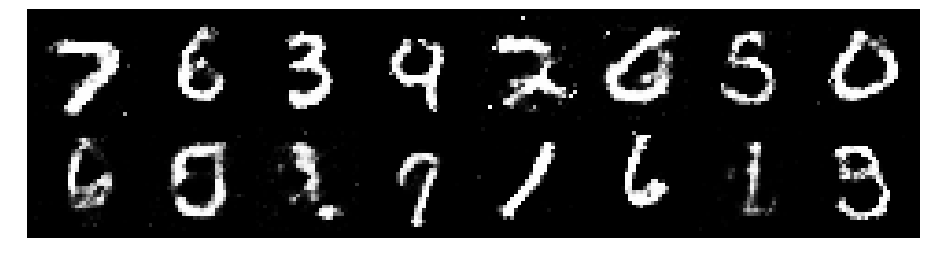

Epoch: [108/200], Batch Num: [200/600]
Discriminator Loss: 1.2577, Generator Loss: 0.9774
D(x): 0.5256, D(G(z)): 0.4072


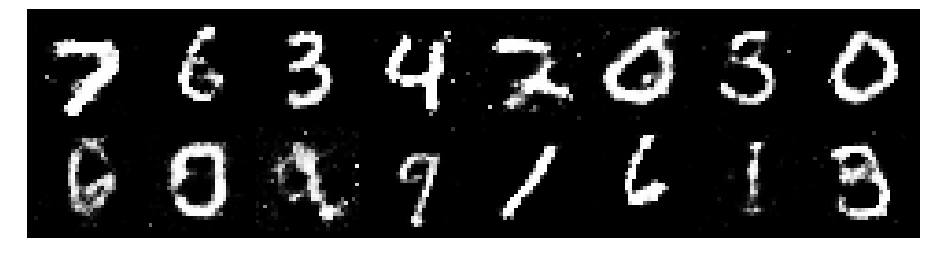

Epoch: [108/200], Batch Num: [300/600]
Discriminator Loss: 1.3049, Generator Loss: 1.0775
D(x): 0.5160, D(G(z)): 0.4149


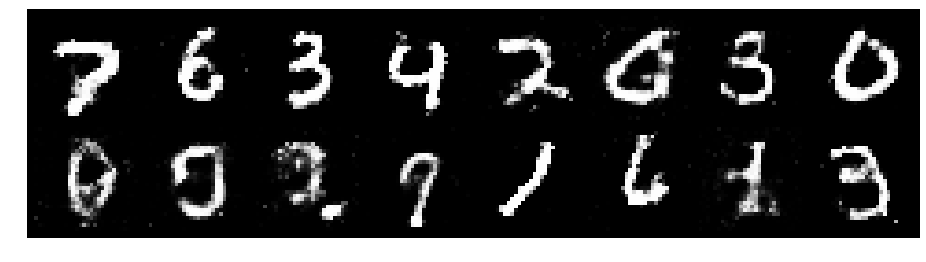

Epoch: [108/200], Batch Num: [400/600]
Discriminator Loss: 1.2303, Generator Loss: 0.9021
D(x): 0.5470, D(G(z)): 0.4240


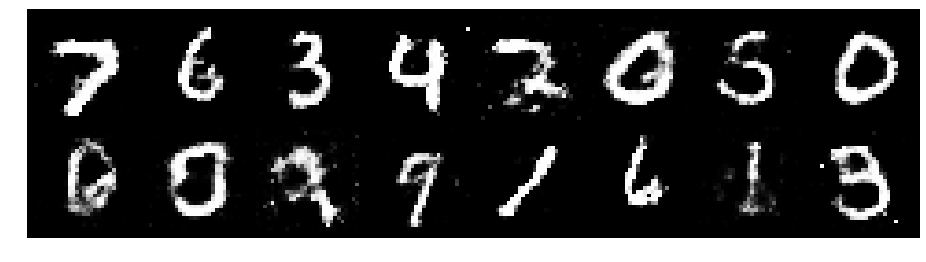

Epoch: [108/200], Batch Num: [500/600]
Discriminator Loss: 1.2034, Generator Loss: 0.9172
D(x): 0.5852, D(G(z)): 0.4326


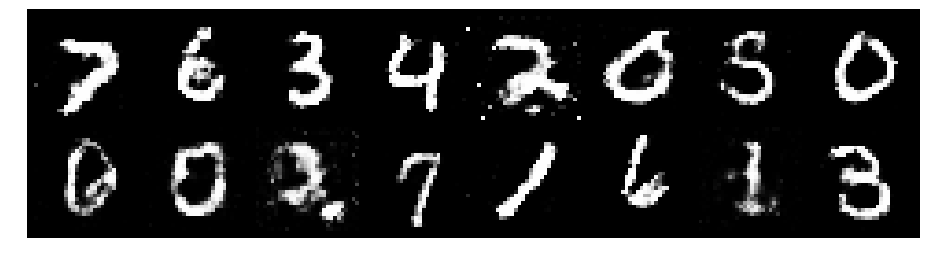

Epoch: [109/200], Batch Num: [0/600]
Discriminator Loss: 1.0865, Generator Loss: 1.1924
D(x): 0.6333, D(G(z)): 0.3758


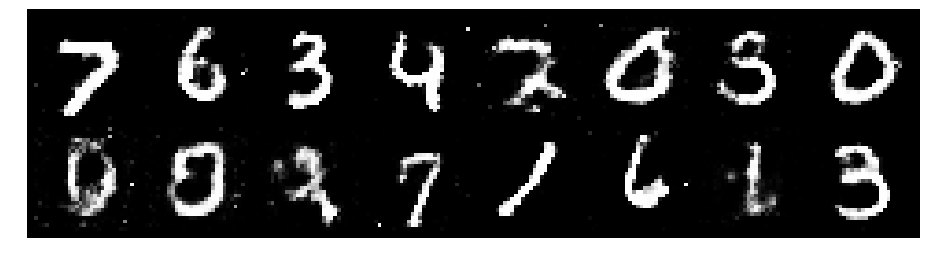

Epoch: [109/200], Batch Num: [100/600]
Discriminator Loss: 1.2943, Generator Loss: 1.0293
D(x): 0.4875, D(G(z)): 0.3679


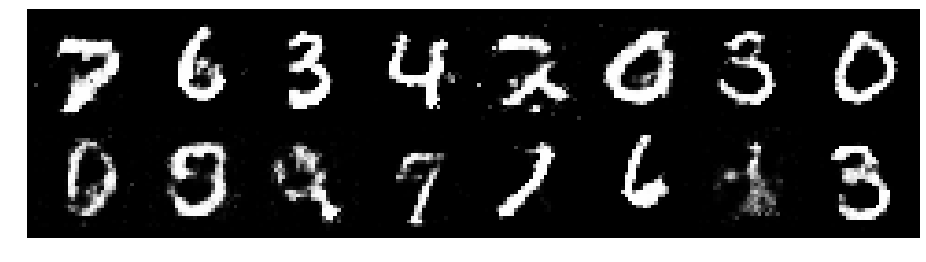

Epoch: [109/200], Batch Num: [200/600]
Discriminator Loss: 1.1348, Generator Loss: 0.9167
D(x): 0.6162, D(G(z)): 0.4235


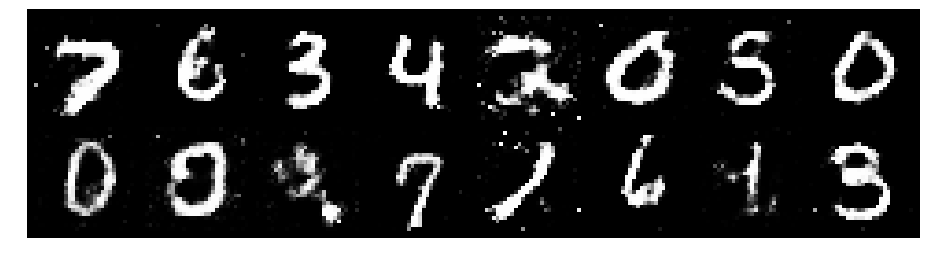

Epoch: [109/200], Batch Num: [300/600]
Discriminator Loss: 1.1329, Generator Loss: 0.9900
D(x): 0.6276, D(G(z)): 0.4249


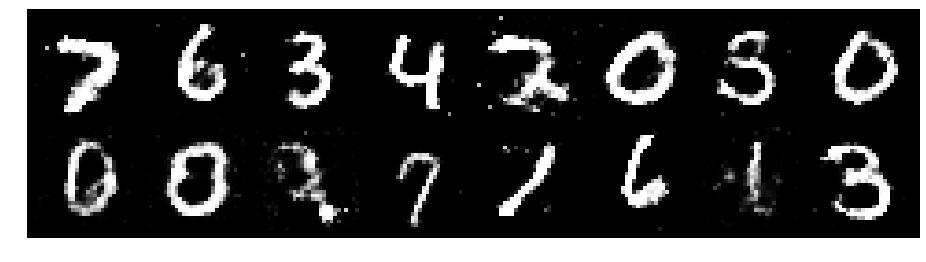

Epoch: [109/200], Batch Num: [400/600]
Discriminator Loss: 1.2075, Generator Loss: 0.7988
D(x): 0.5691, D(G(z)): 0.4368


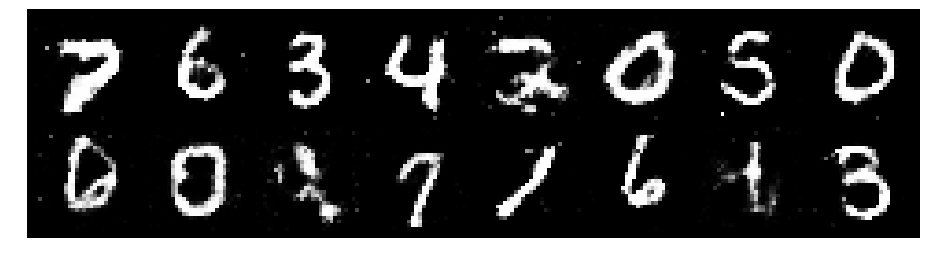

Epoch: [109/200], Batch Num: [500/600]
Discriminator Loss: 1.3296, Generator Loss: 0.9842
D(x): 0.5224, D(G(z)): 0.4473


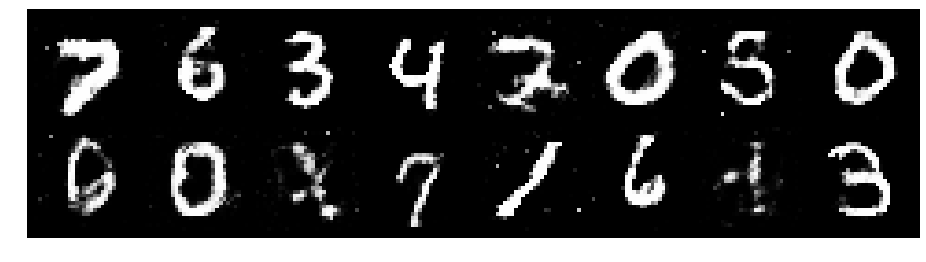

Epoch: [110/200], Batch Num: [0/600]
Discriminator Loss: 1.4421, Generator Loss: 0.8721
D(x): 0.5381, D(G(z)): 0.5118


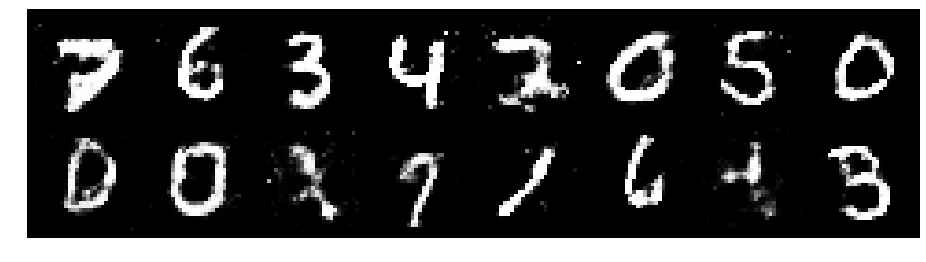

Epoch: [110/200], Batch Num: [100/600]
Discriminator Loss: 1.2459, Generator Loss: 0.9516
D(x): 0.5554, D(G(z)): 0.4210


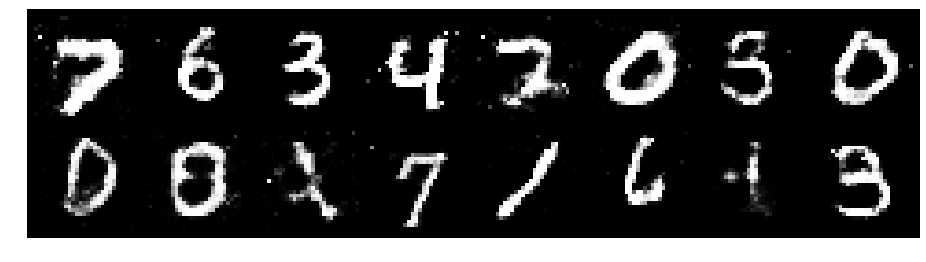

Epoch: [110/200], Batch Num: [200/600]
Discriminator Loss: 1.4763, Generator Loss: 0.9182
D(x): 0.4990, D(G(z)): 0.4803


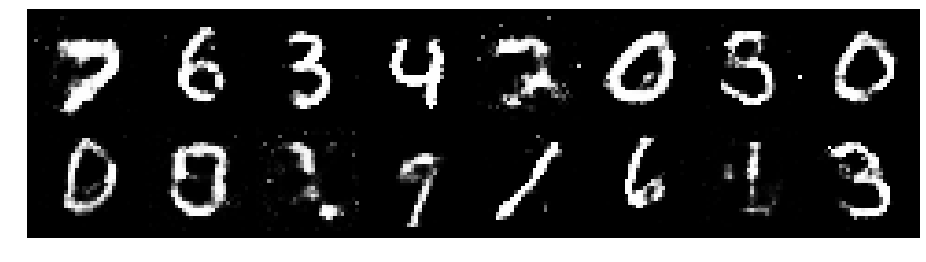

Epoch: [110/200], Batch Num: [300/600]
Discriminator Loss: 1.2913, Generator Loss: 0.9016
D(x): 0.5496, D(G(z)): 0.4443


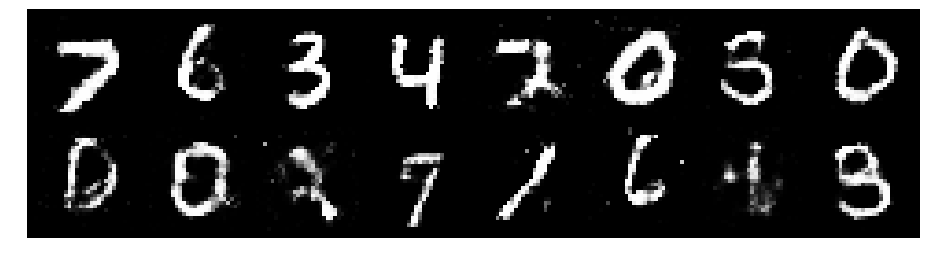

Epoch: [110/200], Batch Num: [400/600]
Discriminator Loss: 1.3571, Generator Loss: 0.9826
D(x): 0.5153, D(G(z)): 0.4453


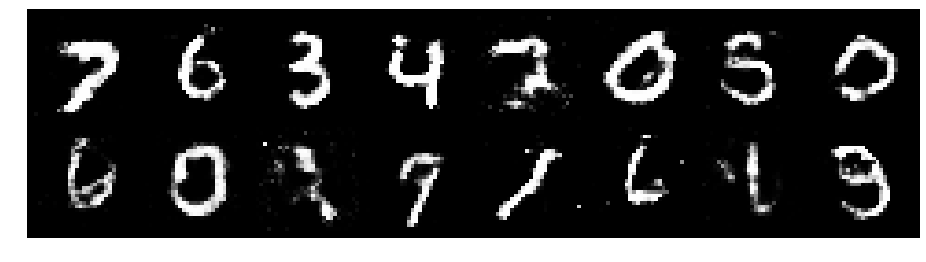

Epoch: [110/200], Batch Num: [500/600]
Discriminator Loss: 1.2934, Generator Loss: 0.8175
D(x): 0.5406, D(G(z)): 0.4464


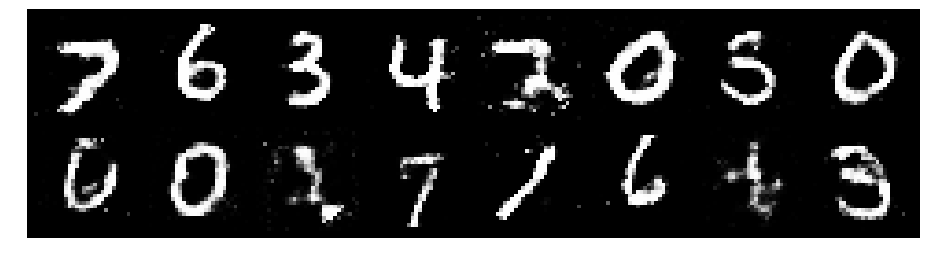

Epoch: [111/200], Batch Num: [0/600]
Discriminator Loss: 1.3036, Generator Loss: 0.9110
D(x): 0.5319, D(G(z)): 0.4403


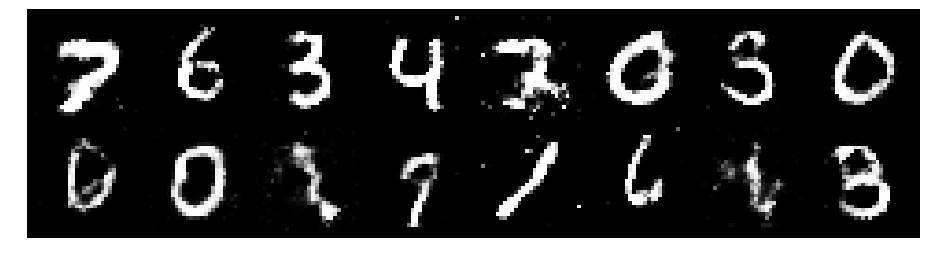

Epoch: [111/200], Batch Num: [100/600]
Discriminator Loss: 1.1766, Generator Loss: 0.9641
D(x): 0.5687, D(G(z)): 0.4104


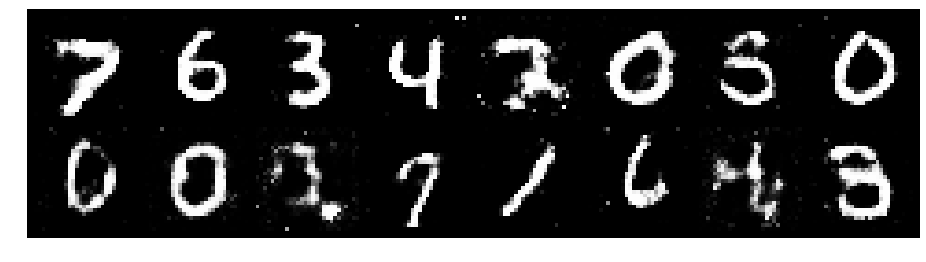

Epoch: [111/200], Batch Num: [200/600]
Discriminator Loss: 1.2110, Generator Loss: 0.8213
D(x): 0.5892, D(G(z)): 0.4495


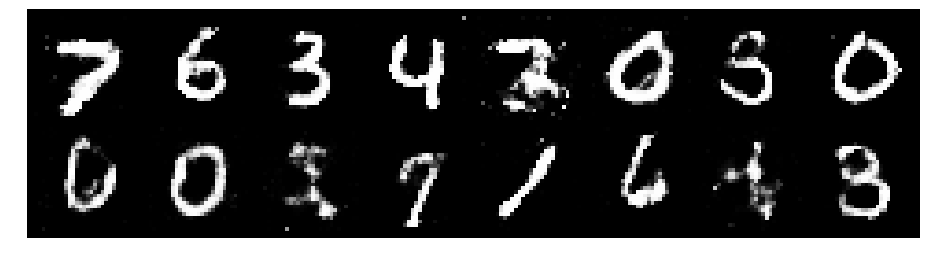

Epoch: [111/200], Batch Num: [300/600]
Discriminator Loss: 1.2195, Generator Loss: 0.9415
D(x): 0.5536, D(G(z)): 0.4248


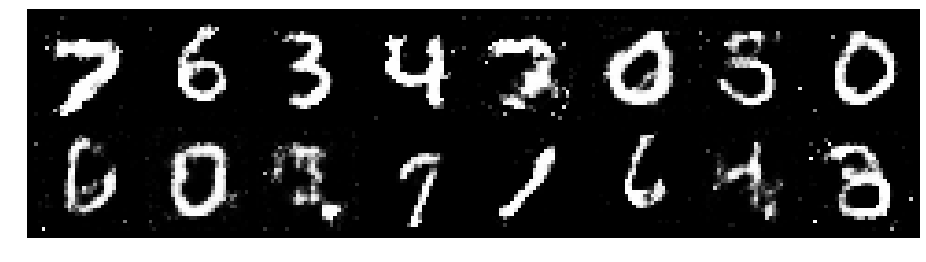

Epoch: [111/200], Batch Num: [400/600]
Discriminator Loss: 1.2751, Generator Loss: 0.7857
D(x): 0.5527, D(G(z)): 0.4688


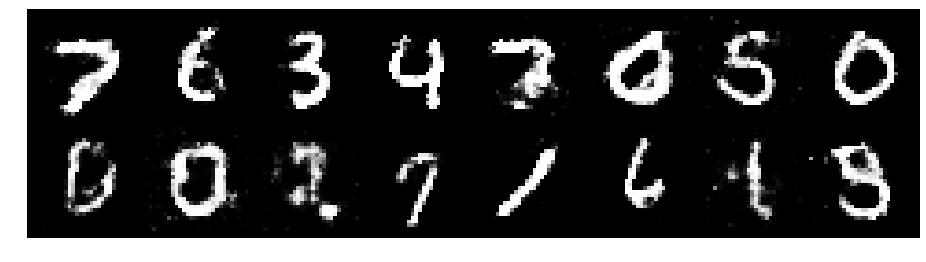

Epoch: [111/200], Batch Num: [500/600]
Discriminator Loss: 1.2044, Generator Loss: 0.8200
D(x): 0.5832, D(G(z)): 0.4407


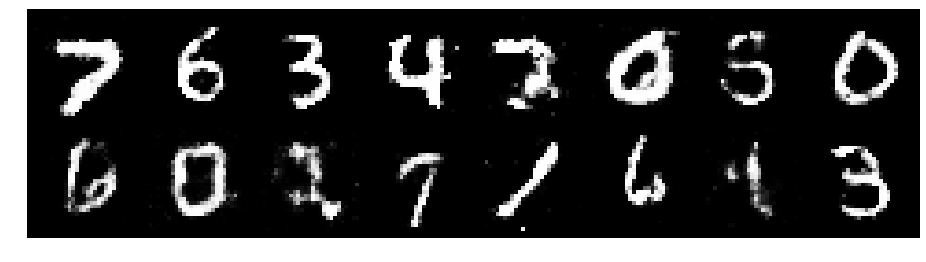

Epoch: [112/200], Batch Num: [0/600]
Discriminator Loss: 1.2039, Generator Loss: 0.9249
D(x): 0.5965, D(G(z)): 0.4623


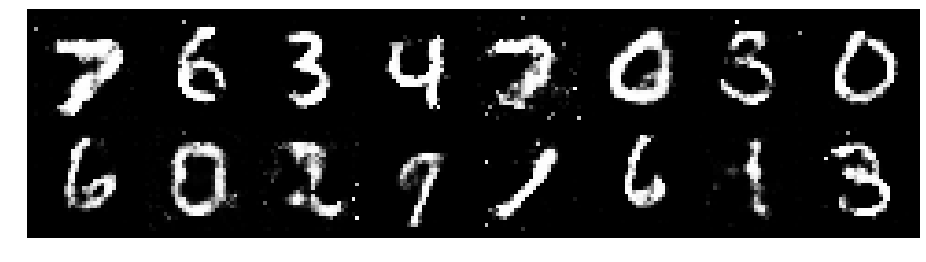

Epoch: [112/200], Batch Num: [100/600]
Discriminator Loss: 1.1790, Generator Loss: 0.8728
D(x): 0.5728, D(G(z)): 0.4065


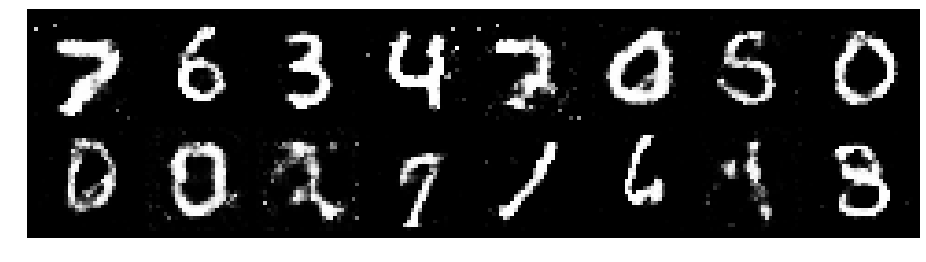

Epoch: [112/200], Batch Num: [200/600]
Discriminator Loss: 1.1402, Generator Loss: 0.9796
D(x): 0.5872, D(G(z)): 0.4061


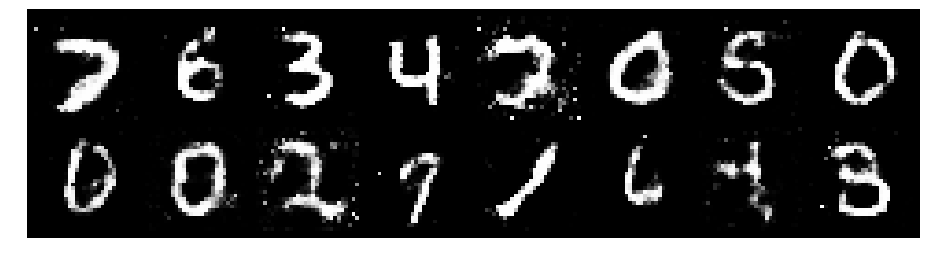

Epoch: [112/200], Batch Num: [300/600]
Discriminator Loss: 1.2958, Generator Loss: 0.9495
D(x): 0.5608, D(G(z)): 0.4317


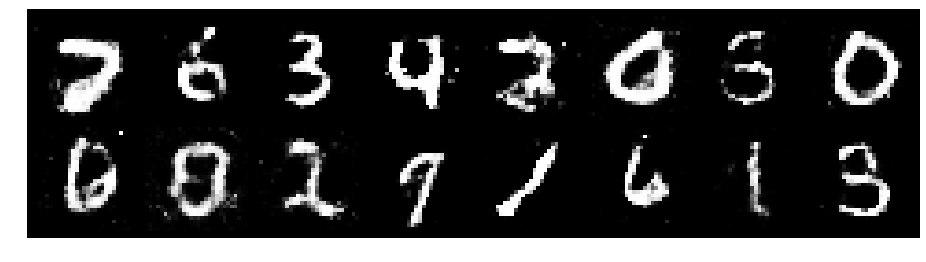

Epoch: [112/200], Batch Num: [400/600]
Discriminator Loss: 1.0523, Generator Loss: 1.0304
D(x): 0.6373, D(G(z)): 0.4122


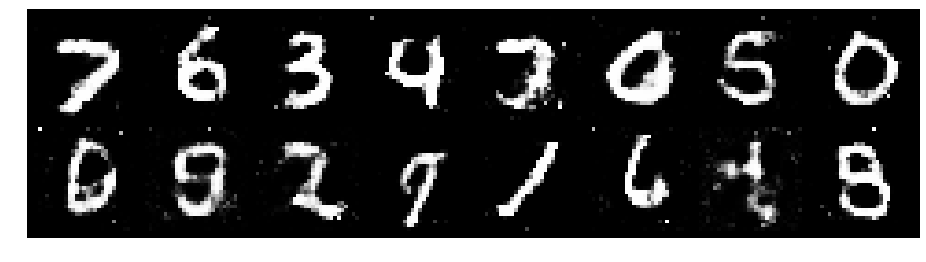

Epoch: [112/200], Batch Num: [500/600]
Discriminator Loss: 1.3529, Generator Loss: 0.8885
D(x): 0.5417, D(G(z)): 0.4615


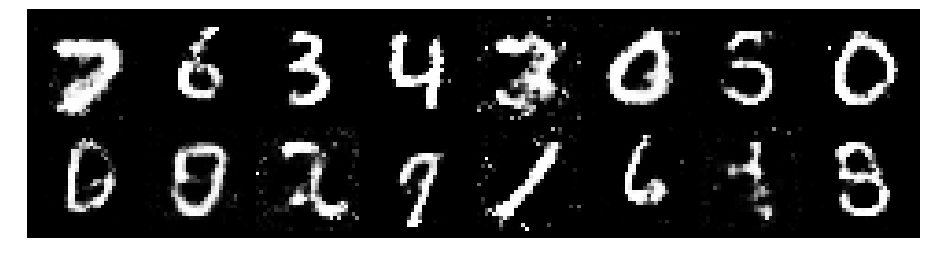

Epoch: [113/200], Batch Num: [0/600]
Discriminator Loss: 1.2406, Generator Loss: 0.8712
D(x): 0.5846, D(G(z)): 0.4392


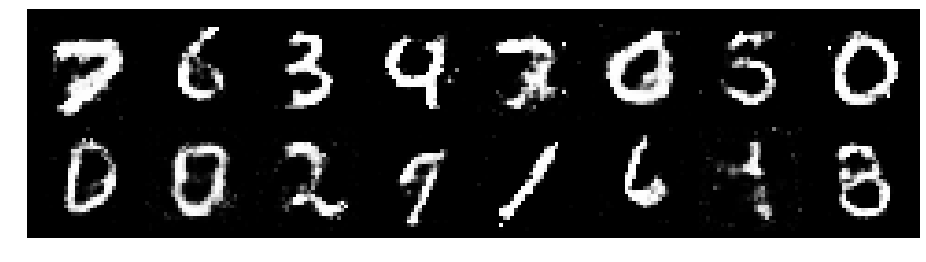

Epoch: [113/200], Batch Num: [100/600]
Discriminator Loss: 1.3198, Generator Loss: 0.8538
D(x): 0.5256, D(G(z)): 0.4403


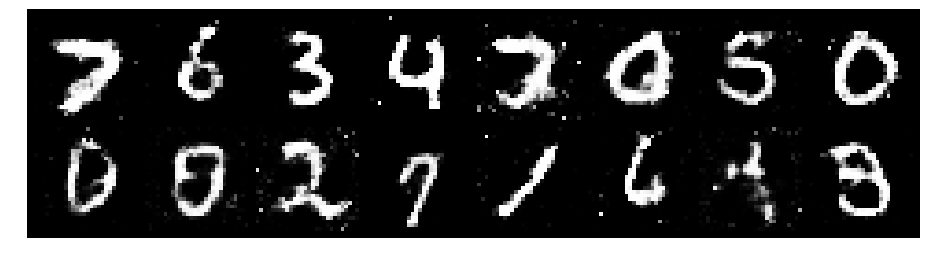

Epoch: [113/200], Batch Num: [200/600]
Discriminator Loss: 1.2460, Generator Loss: 0.9106
D(x): 0.5296, D(G(z)): 0.4064


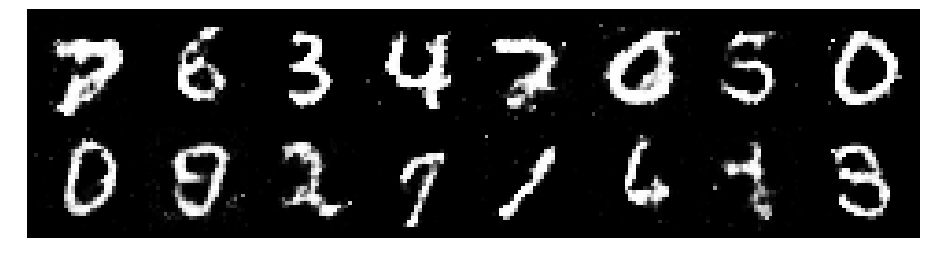

Epoch: [113/200], Batch Num: [300/600]
Discriminator Loss: 1.2859, Generator Loss: 0.8764
D(x): 0.5293, D(G(z)): 0.4188


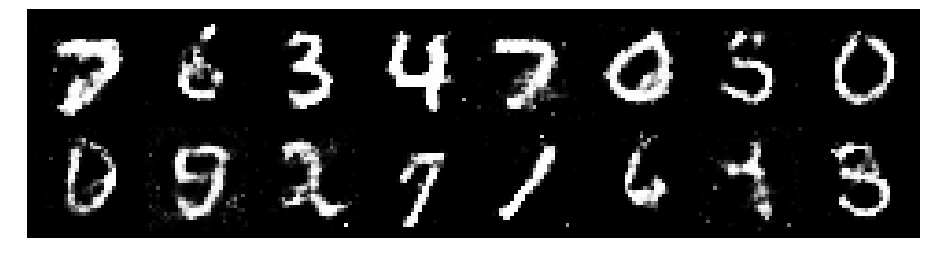

Epoch: [113/200], Batch Num: [400/600]
Discriminator Loss: 1.3763, Generator Loss: 0.7858
D(x): 0.5472, D(G(z)): 0.4914


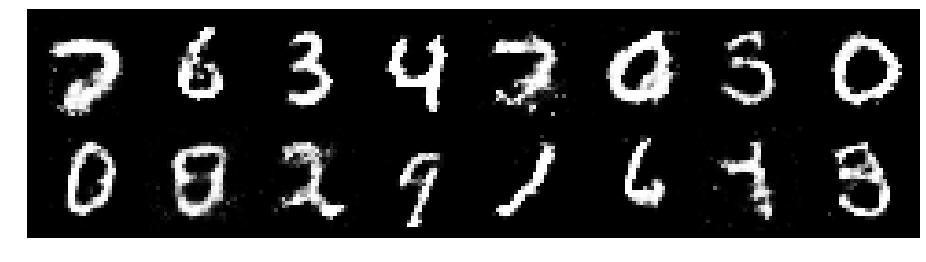

Epoch: [113/200], Batch Num: [500/600]
Discriminator Loss: 1.3597, Generator Loss: 0.8782
D(x): 0.4930, D(G(z)): 0.4374


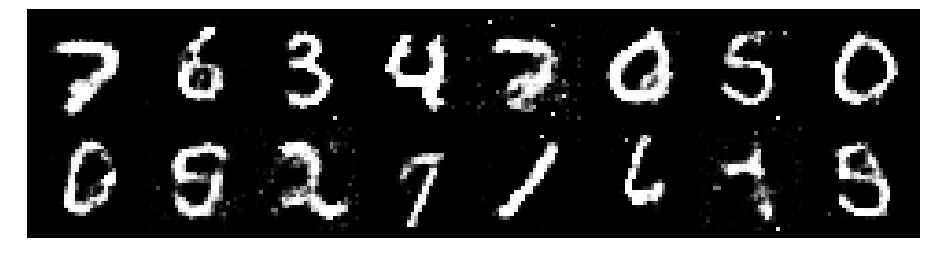

Epoch: [114/200], Batch Num: [0/600]
Discriminator Loss: 1.2857, Generator Loss: 0.8322
D(x): 0.5283, D(G(z)): 0.4330


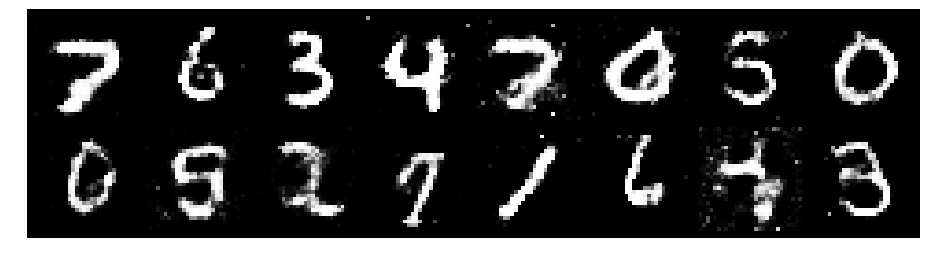

Epoch: [114/200], Batch Num: [100/600]
Discriminator Loss: 1.2637, Generator Loss: 0.9231
D(x): 0.6066, D(G(z)): 0.4731


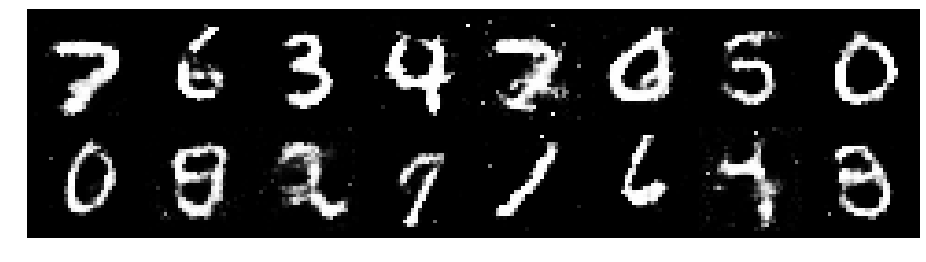

Epoch: [114/200], Batch Num: [200/600]
Discriminator Loss: 1.3426, Generator Loss: 0.8120
D(x): 0.5681, D(G(z)): 0.4764


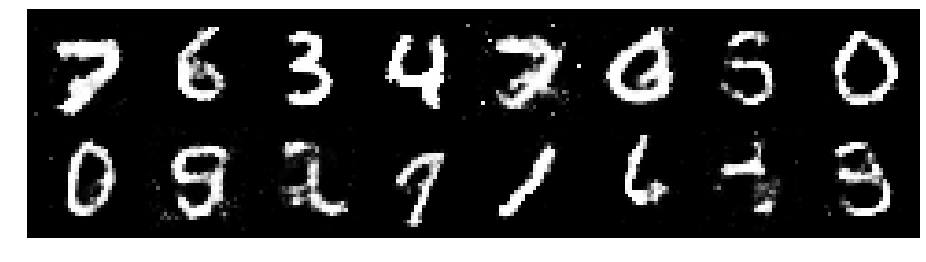

Epoch: [114/200], Batch Num: [300/600]
Discriminator Loss: 1.3850, Generator Loss: 0.8653
D(x): 0.5177, D(G(z)): 0.4697


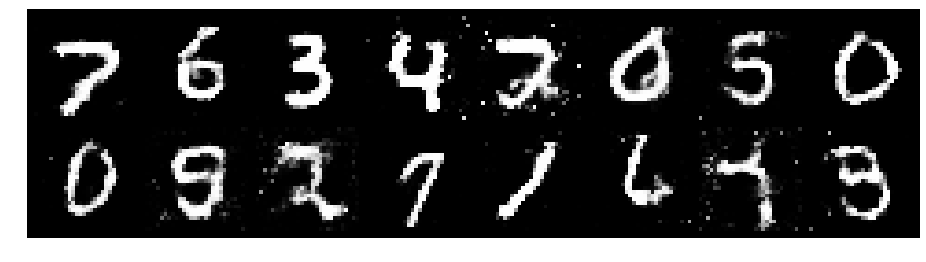

Epoch: [114/200], Batch Num: [400/600]
Discriminator Loss: 1.3075, Generator Loss: 0.8598
D(x): 0.5226, D(G(z)): 0.4345


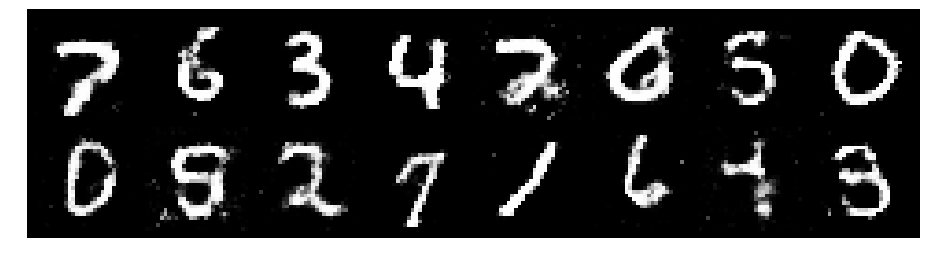

Epoch: [114/200], Batch Num: [500/600]
Discriminator Loss: 1.2812, Generator Loss: 0.9778
D(x): 0.5113, D(G(z)): 0.4028


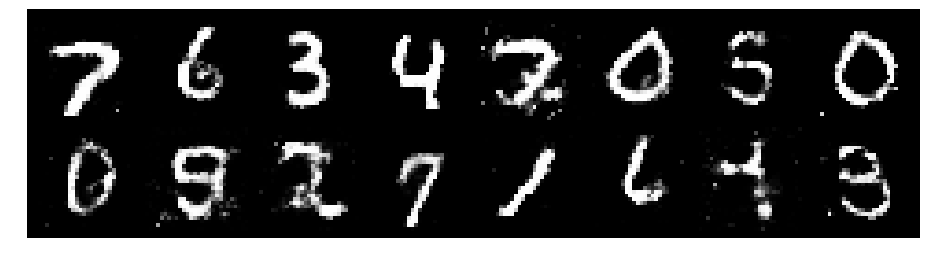

Epoch: [115/200], Batch Num: [0/600]
Discriminator Loss: 1.2280, Generator Loss: 0.9396
D(x): 0.5512, D(G(z)): 0.4191


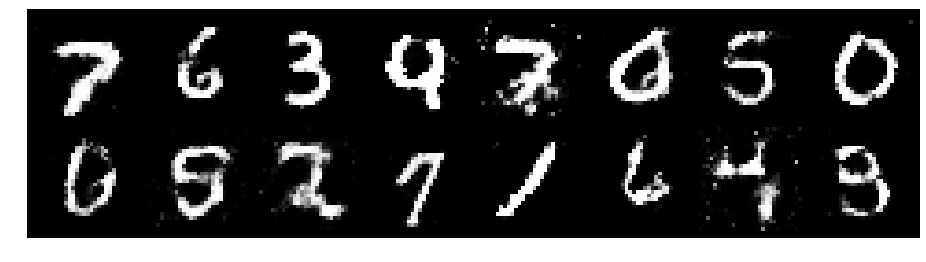

Epoch: [115/200], Batch Num: [100/600]
Discriminator Loss: 1.1987, Generator Loss: 0.8851
D(x): 0.6092, D(G(z)): 0.4640


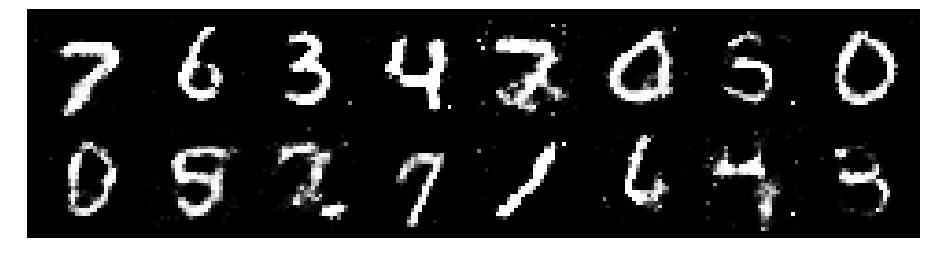

Epoch: [115/200], Batch Num: [200/600]
Discriminator Loss: 1.2703, Generator Loss: 0.9465
D(x): 0.5380, D(G(z)): 0.4231


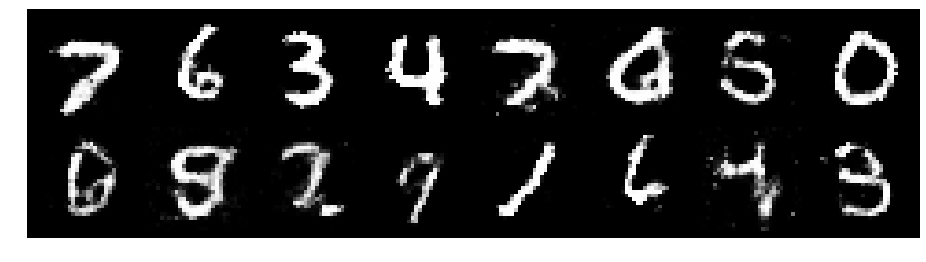

Epoch: [115/200], Batch Num: [300/600]
Discriminator Loss: 1.2846, Generator Loss: 0.8028
D(x): 0.5348, D(G(z)): 0.4458


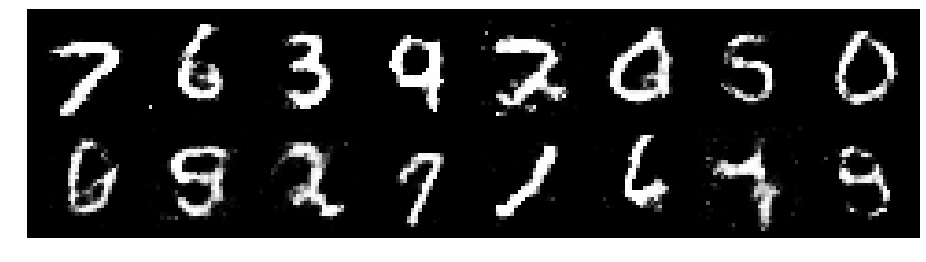

Epoch: [115/200], Batch Num: [400/600]
Discriminator Loss: 1.2346, Generator Loss: 0.9489
D(x): 0.5623, D(G(z)): 0.4300


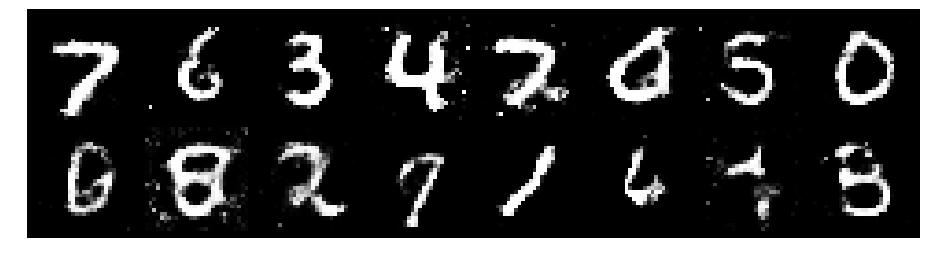

Epoch: [115/200], Batch Num: [500/600]
Discriminator Loss: 1.3341, Generator Loss: 0.9159
D(x): 0.5698, D(G(z)): 0.4791


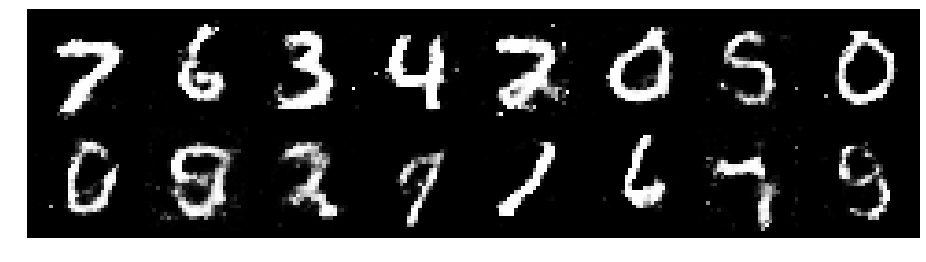

Epoch: [116/200], Batch Num: [0/600]
Discriminator Loss: 1.2876, Generator Loss: 0.9190
D(x): 0.5340, D(G(z)): 0.4404


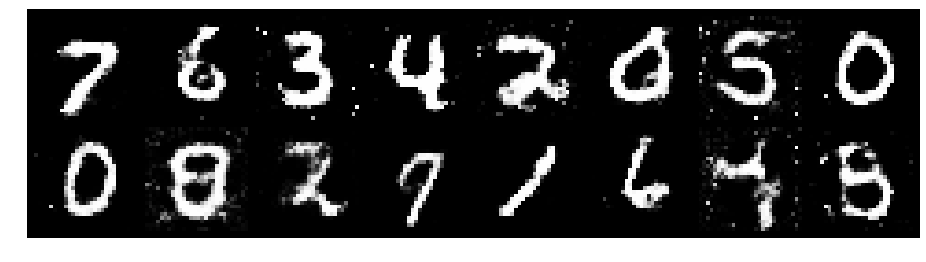

Epoch: [116/200], Batch Num: [100/600]
Discriminator Loss: 1.2945, Generator Loss: 0.7970
D(x): 0.5722, D(G(z)): 0.4817


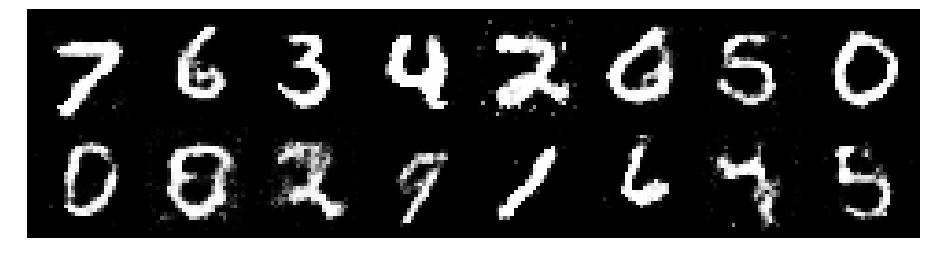

Epoch: [116/200], Batch Num: [200/600]
Discriminator Loss: 1.2834, Generator Loss: 0.8658
D(x): 0.5880, D(G(z)): 0.4706


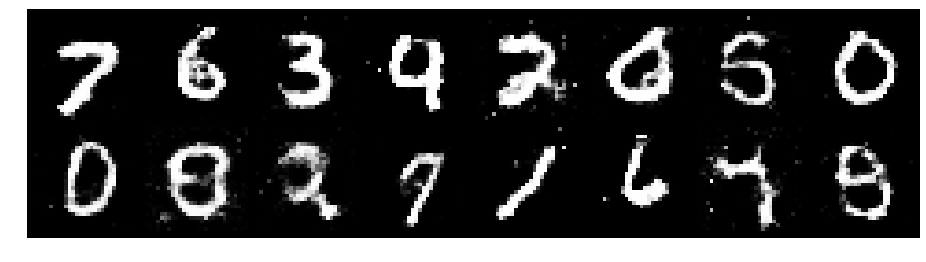

Epoch: [116/200], Batch Num: [300/600]
Discriminator Loss: 1.2658, Generator Loss: 0.8330
D(x): 0.5478, D(G(z)): 0.4545


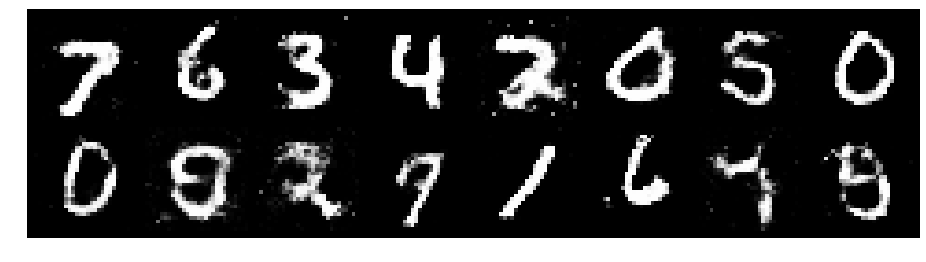

Epoch: [116/200], Batch Num: [400/600]
Discriminator Loss: 1.3121, Generator Loss: 0.8565
D(x): 0.5392, D(G(z)): 0.4360


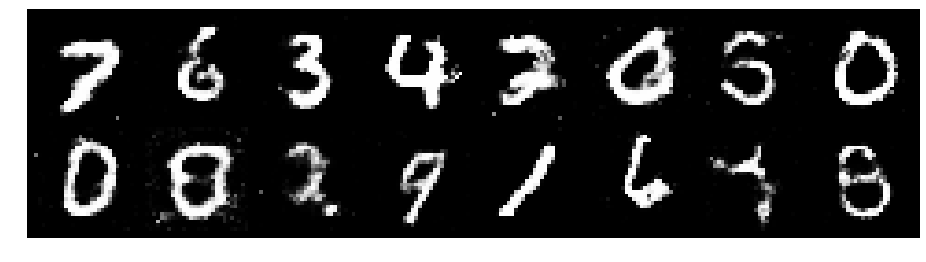

Epoch: [116/200], Batch Num: [500/600]
Discriminator Loss: 1.3745, Generator Loss: 0.9905
D(x): 0.5096, D(G(z)): 0.4392


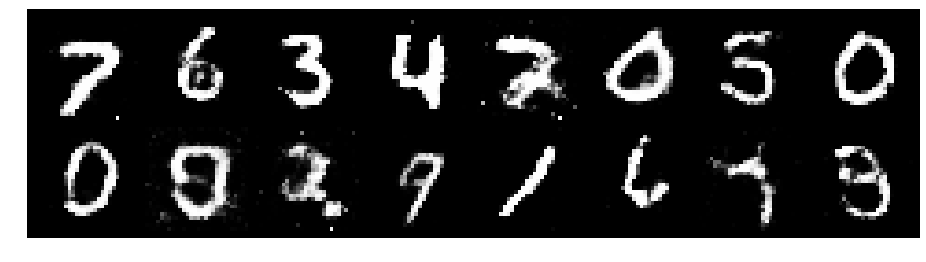

Epoch: [117/200], Batch Num: [0/600]
Discriminator Loss: 1.3538, Generator Loss: 0.9139
D(x): 0.5590, D(G(z)): 0.4783


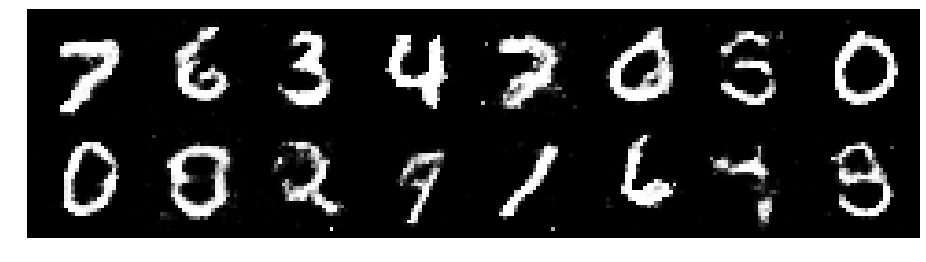

Epoch: [117/200], Batch Num: [100/600]
Discriminator Loss: 1.2207, Generator Loss: 0.9092
D(x): 0.5421, D(G(z)): 0.4167


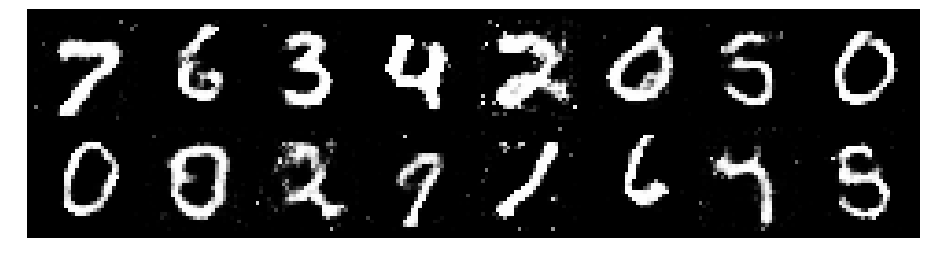

Epoch: [117/200], Batch Num: [200/600]
Discriminator Loss: 1.1763, Generator Loss: 0.8895
D(x): 0.5876, D(G(z)): 0.4274


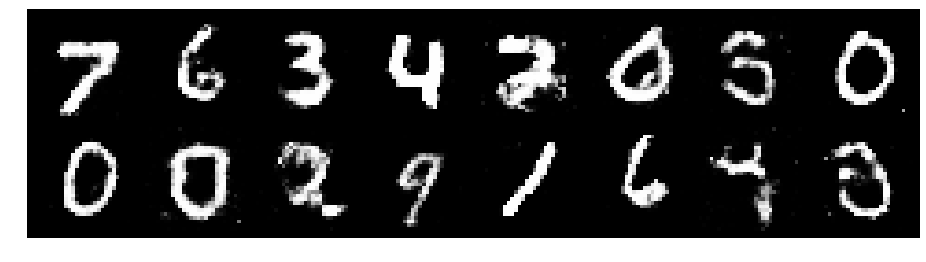

Epoch: [117/200], Batch Num: [300/600]
Discriminator Loss: 1.1958, Generator Loss: 1.0197
D(x): 0.5461, D(G(z)): 0.3748


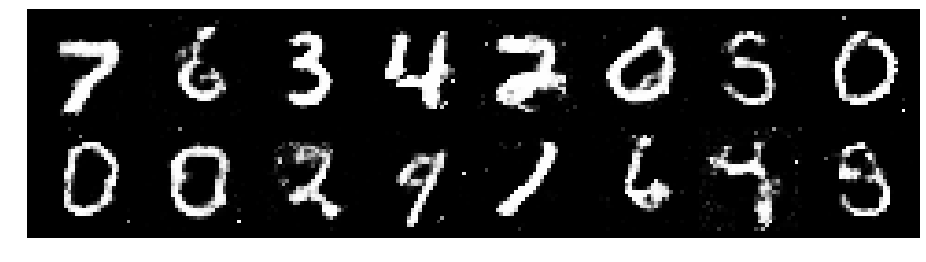

Epoch: [117/200], Batch Num: [400/600]
Discriminator Loss: 1.3497, Generator Loss: 0.9529
D(x): 0.5345, D(G(z)): 0.4436


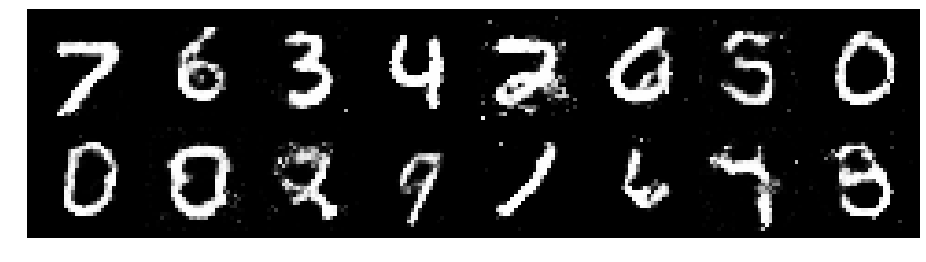

Epoch: [117/200], Batch Num: [500/600]
Discriminator Loss: 1.2563, Generator Loss: 0.9092
D(x): 0.5674, D(G(z)): 0.4414


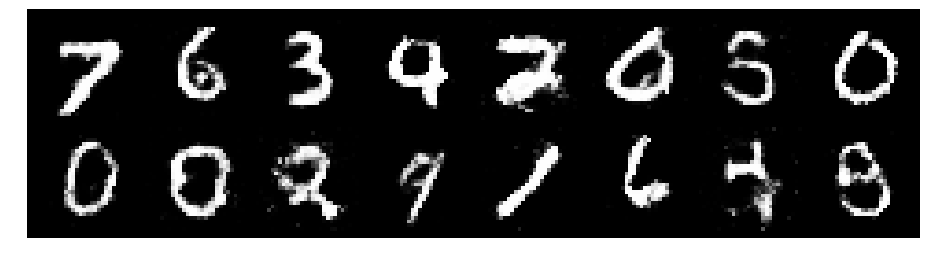

Epoch: [118/200], Batch Num: [0/600]
Discriminator Loss: 1.1914, Generator Loss: 0.9149
D(x): 0.5696, D(G(z)): 0.4231


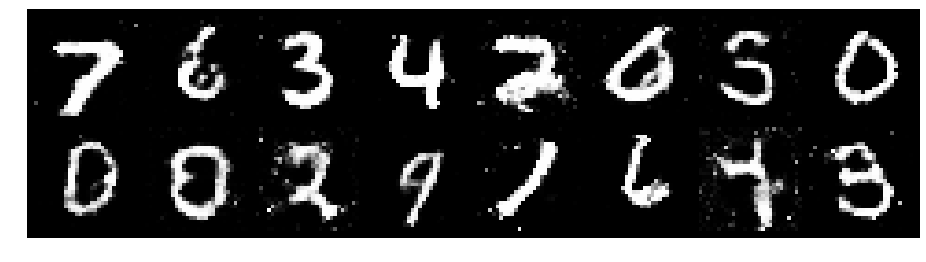

Epoch: [118/200], Batch Num: [100/600]
Discriminator Loss: 1.2444, Generator Loss: 0.8854
D(x): 0.5401, D(G(z)): 0.4114


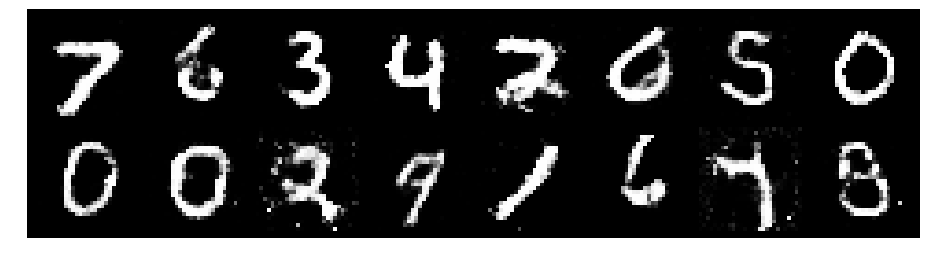

Epoch: [118/200], Batch Num: [200/600]
Discriminator Loss: 1.3164, Generator Loss: 0.8376
D(x): 0.5460, D(G(z)): 0.4557


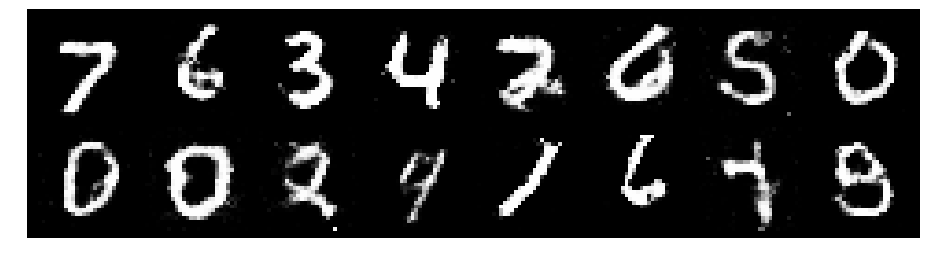

Epoch: [118/200], Batch Num: [300/600]
Discriminator Loss: 1.1839, Generator Loss: 0.8644
D(x): 0.5575, D(G(z)): 0.4039


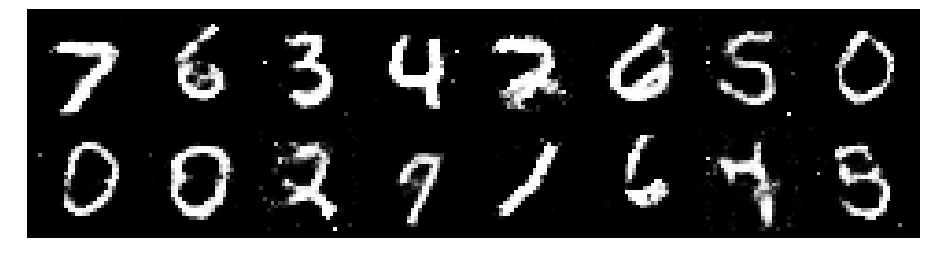

Epoch: [118/200], Batch Num: [400/600]
Discriminator Loss: 1.1028, Generator Loss: 1.0836
D(x): 0.5841, D(G(z)): 0.3802


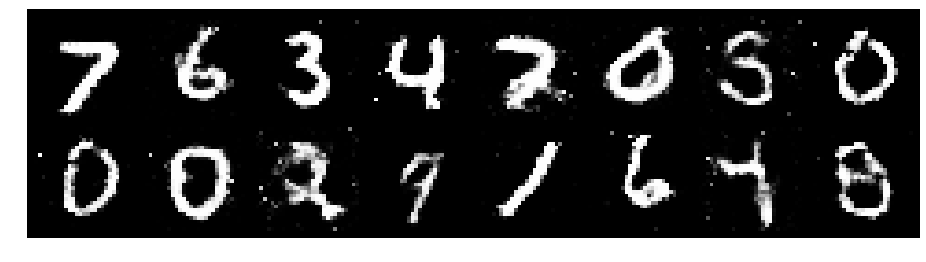

Epoch: [118/200], Batch Num: [500/600]
Discriminator Loss: 1.1543, Generator Loss: 1.0085
D(x): 0.5707, D(G(z)): 0.4015


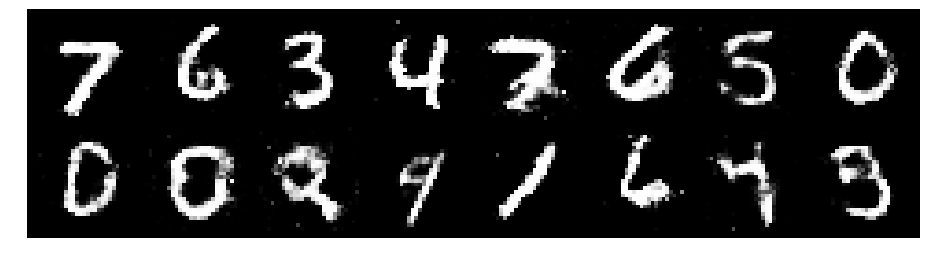

Epoch: [119/200], Batch Num: [0/600]
Discriminator Loss: 1.2593, Generator Loss: 0.9128
D(x): 0.5330, D(G(z)): 0.4301


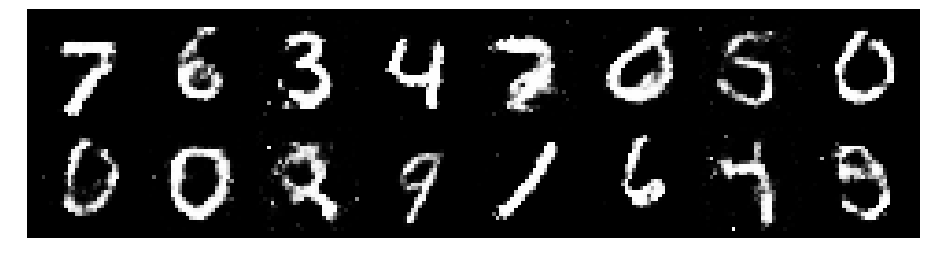

Epoch: [119/200], Batch Num: [100/600]
Discriminator Loss: 1.2150, Generator Loss: 1.0386
D(x): 0.5366, D(G(z)): 0.3931


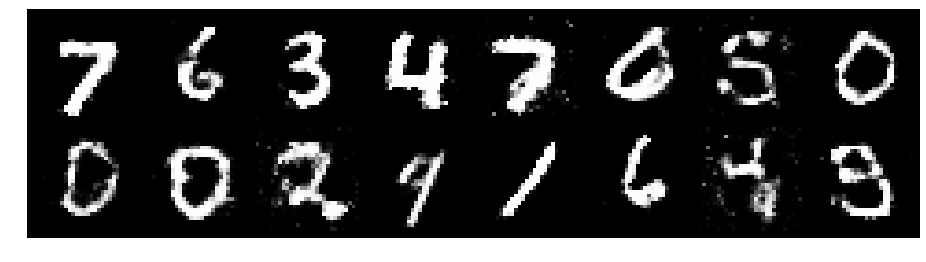

Epoch: [119/200], Batch Num: [200/600]
Discriminator Loss: 1.2454, Generator Loss: 0.9078
D(x): 0.5870, D(G(z)): 0.4613


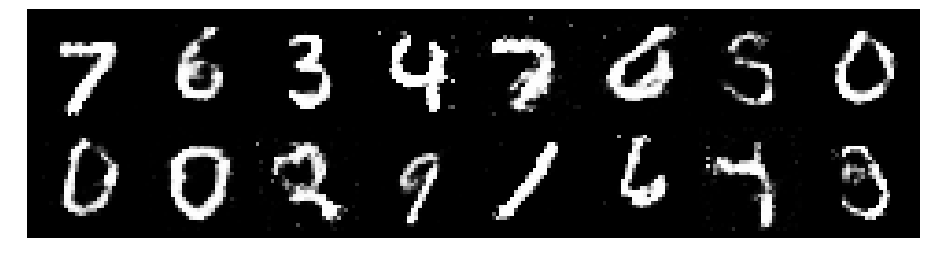

Epoch: [119/200], Batch Num: [300/600]
Discriminator Loss: 1.3485, Generator Loss: 0.8330
D(x): 0.5269, D(G(z)): 0.4467


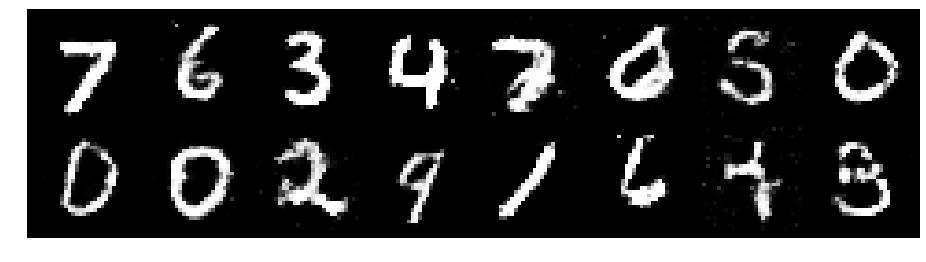

Epoch: [119/200], Batch Num: [400/600]
Discriminator Loss: 1.3994, Generator Loss: 0.8831
D(x): 0.5335, D(G(z)): 0.4657


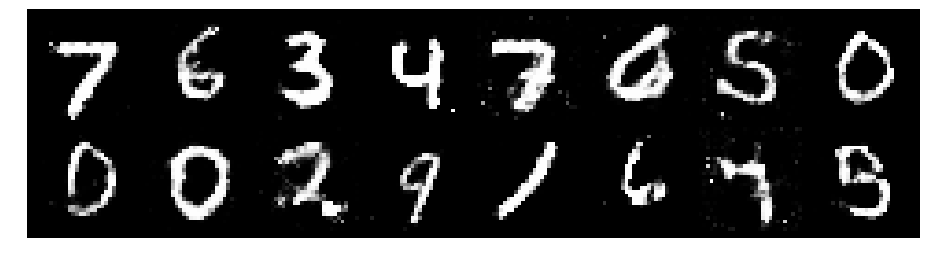

Epoch: [119/200], Batch Num: [500/600]
Discriminator Loss: 1.2202, Generator Loss: 0.8245
D(x): 0.5893, D(G(z)): 0.4498


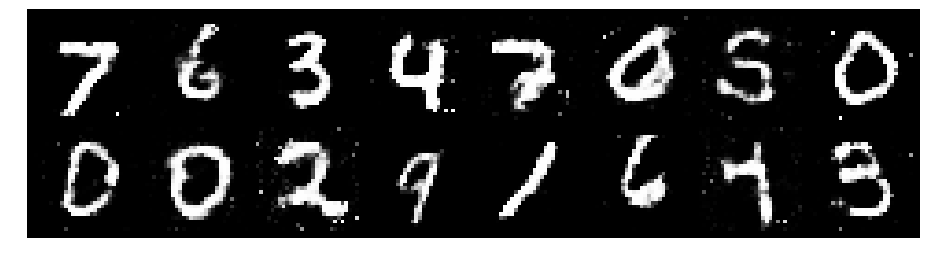

Epoch: [120/200], Batch Num: [0/600]
Discriminator Loss: 1.1668, Generator Loss: 1.0402
D(x): 0.5696, D(G(z)): 0.3987


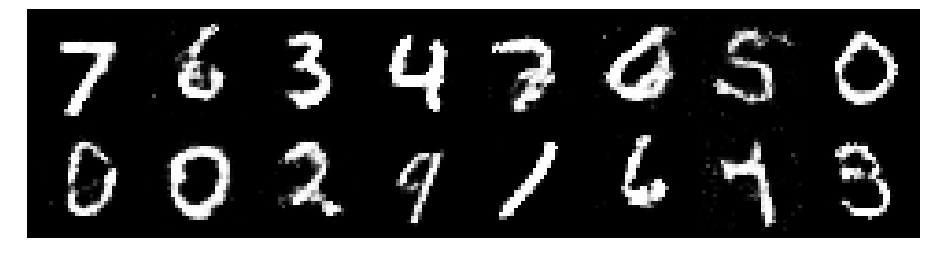

Epoch: [120/200], Batch Num: [100/600]
Discriminator Loss: 1.2180, Generator Loss: 1.0751
D(x): 0.5691, D(G(z)): 0.4138


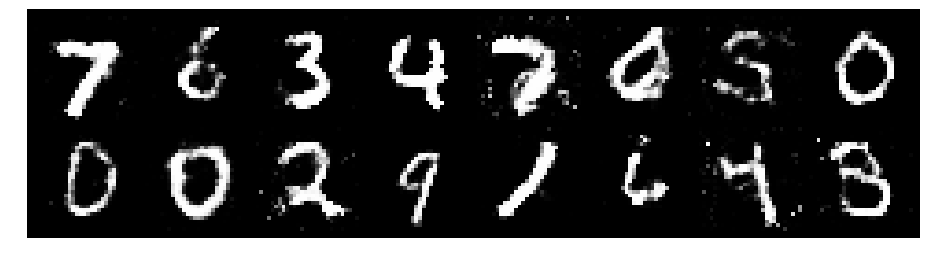

Epoch: [120/200], Batch Num: [200/600]
Discriminator Loss: 1.2773, Generator Loss: 0.8061
D(x): 0.5685, D(G(z)): 0.4496


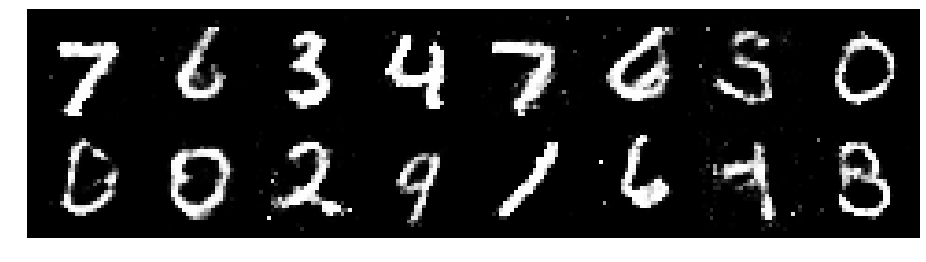

Epoch: [120/200], Batch Num: [300/600]
Discriminator Loss: 1.2729, Generator Loss: 0.9103
D(x): 0.5252, D(G(z)): 0.4188


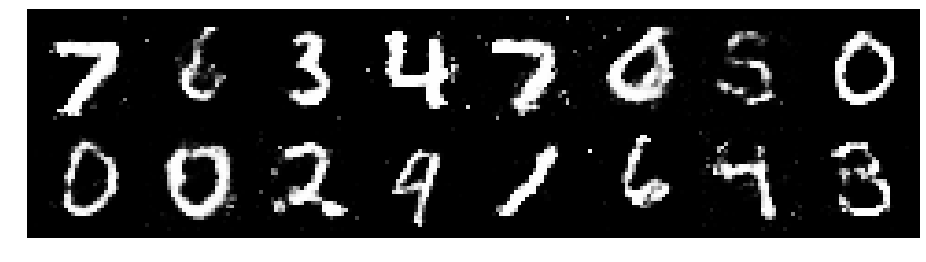

Epoch: [120/200], Batch Num: [400/600]
Discriminator Loss: 1.3349, Generator Loss: 0.8275
D(x): 0.5555, D(G(z)): 0.4809


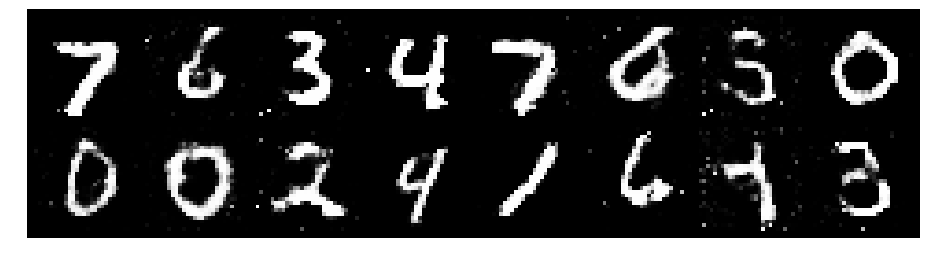

Epoch: [120/200], Batch Num: [500/600]
Discriminator Loss: 1.2630, Generator Loss: 0.9563
D(x): 0.5409, D(G(z)): 0.4363


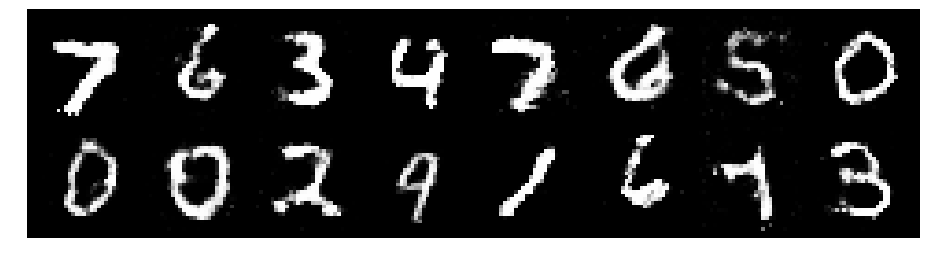

Epoch: [121/200], Batch Num: [0/600]
Discriminator Loss: 1.1635, Generator Loss: 0.9468
D(x): 0.5380, D(G(z)): 0.3575


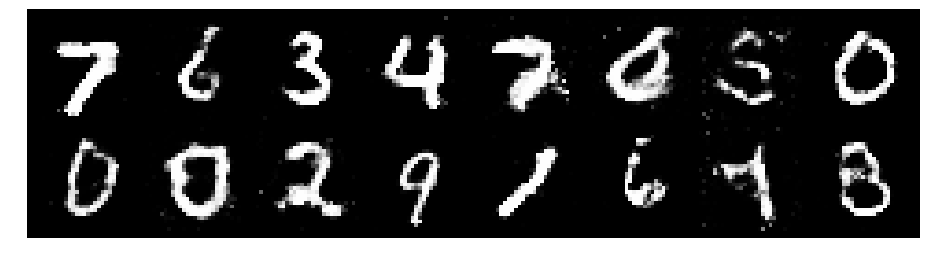

Epoch: [121/200], Batch Num: [100/600]
Discriminator Loss: 1.2326, Generator Loss: 0.8781
D(x): 0.5532, D(G(z)): 0.4316


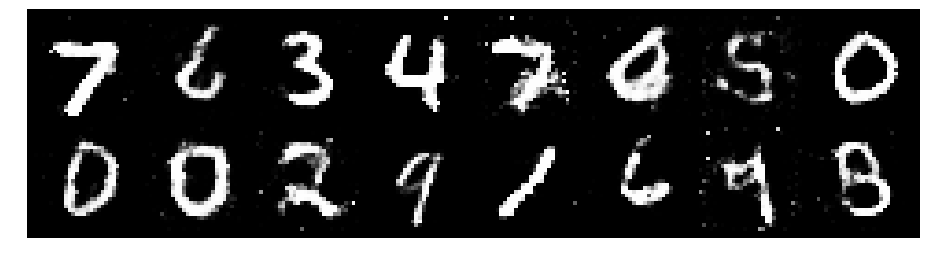

Epoch: [121/200], Batch Num: [200/600]
Discriminator Loss: 1.1623, Generator Loss: 0.9645
D(x): 0.5902, D(G(z)): 0.4188


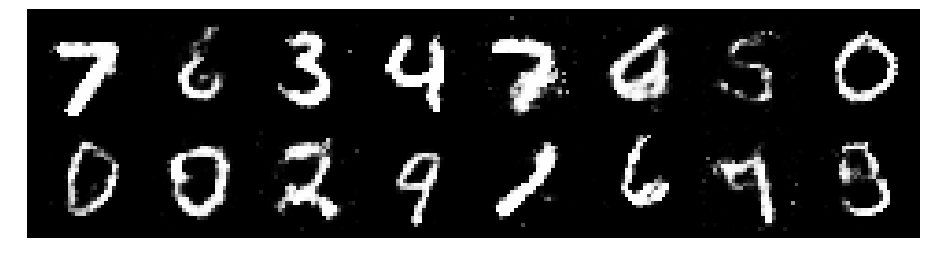

Epoch: [121/200], Batch Num: [300/600]
Discriminator Loss: 1.1866, Generator Loss: 1.0764
D(x): 0.5614, D(G(z)): 0.3906


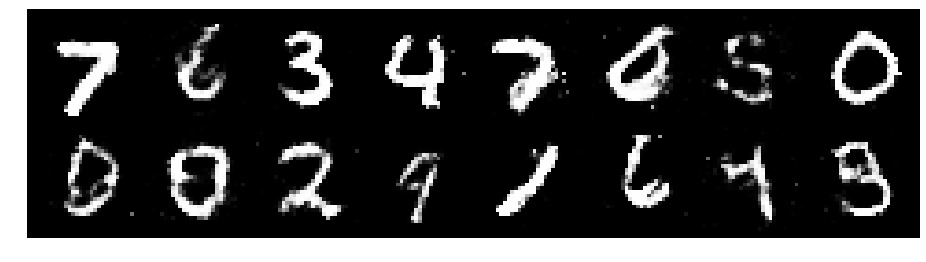

Epoch: [121/200], Batch Num: [400/600]
Discriminator Loss: 1.3805, Generator Loss: 0.7733
D(x): 0.5451, D(G(z)): 0.4750


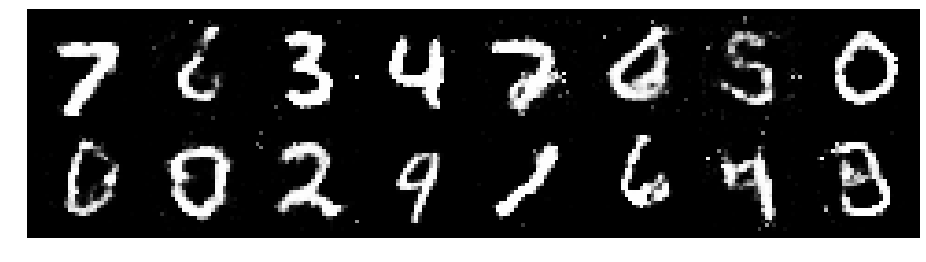

Epoch: [121/200], Batch Num: [500/600]
Discriminator Loss: 1.2930, Generator Loss: 0.9282
D(x): 0.5423, D(G(z)): 0.4403


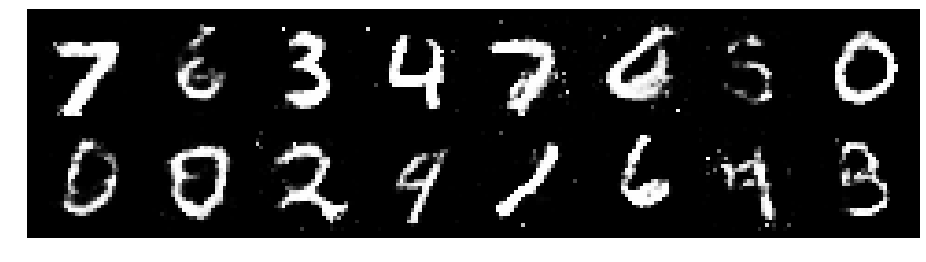

Epoch: [122/200], Batch Num: [0/600]
Discriminator Loss: 1.2036, Generator Loss: 0.9844
D(x): 0.5648, D(G(z)): 0.4232


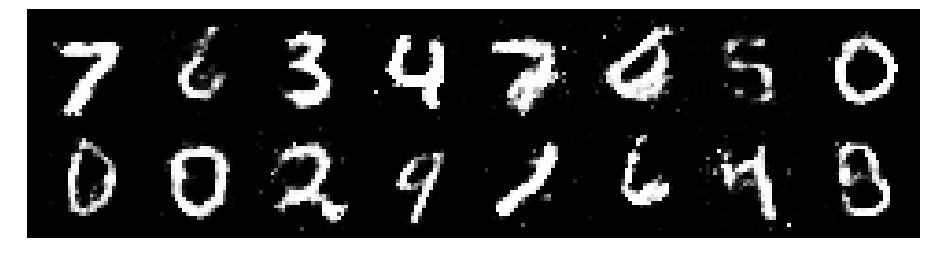

Epoch: [122/200], Batch Num: [100/600]
Discriminator Loss: 1.2839, Generator Loss: 0.7976
D(x): 0.5866, D(G(z)): 0.4880


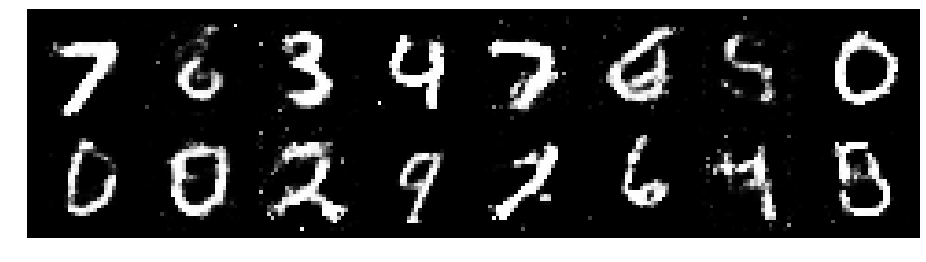

Epoch: [122/200], Batch Num: [200/600]
Discriminator Loss: 1.2549, Generator Loss: 0.9164
D(x): 0.5591, D(G(z)): 0.4347


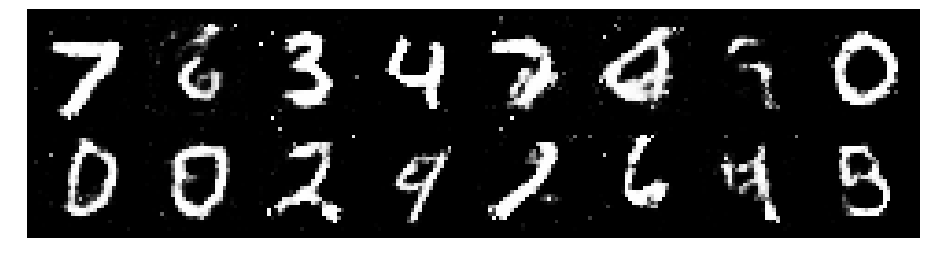

Epoch: [122/200], Batch Num: [300/600]
Discriminator Loss: 1.2046, Generator Loss: 0.8760
D(x): 0.5909, D(G(z)): 0.4522


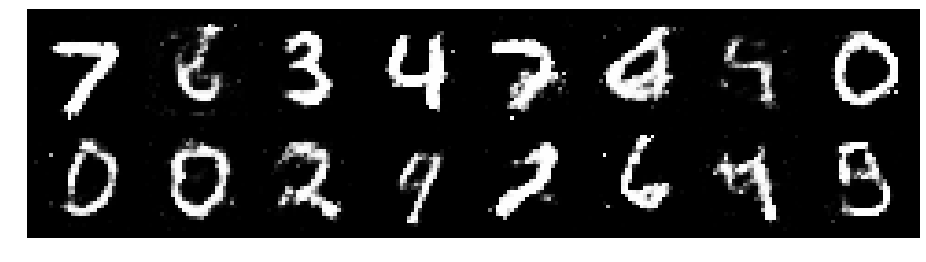

Epoch: [122/200], Batch Num: [400/600]
Discriminator Loss: 1.2927, Generator Loss: 0.9179
D(x): 0.5537, D(G(z)): 0.4536


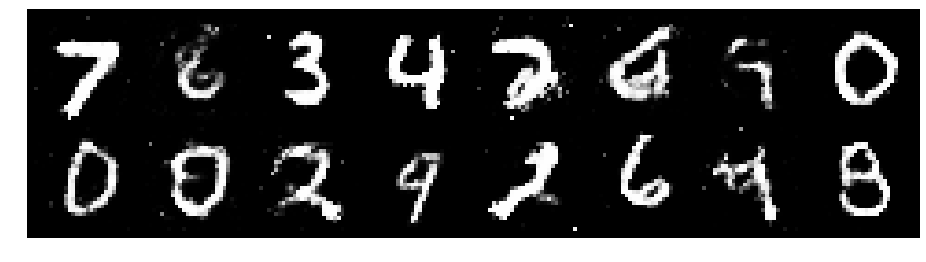

Epoch: [122/200], Batch Num: [500/600]
Discriminator Loss: 1.2822, Generator Loss: 0.8518
D(x): 0.5303, D(G(z)): 0.4321


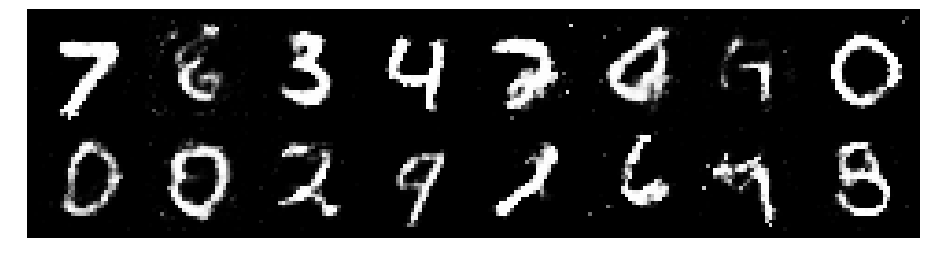

Epoch: [123/200], Batch Num: [0/600]
Discriminator Loss: 1.2352, Generator Loss: 0.9613
D(x): 0.5777, D(G(z)): 0.4420


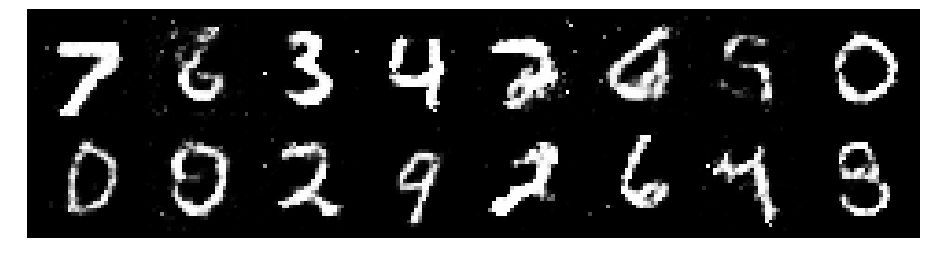

Epoch: [123/200], Batch Num: [100/600]
Discriminator Loss: 1.1572, Generator Loss: 0.9644
D(x): 0.5936, D(G(z)): 0.4087


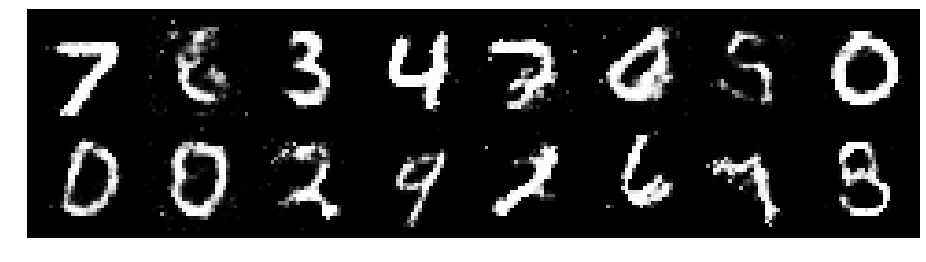

Epoch: [123/200], Batch Num: [200/600]
Discriminator Loss: 1.1721, Generator Loss: 0.9107
D(x): 0.6043, D(G(z)): 0.4259


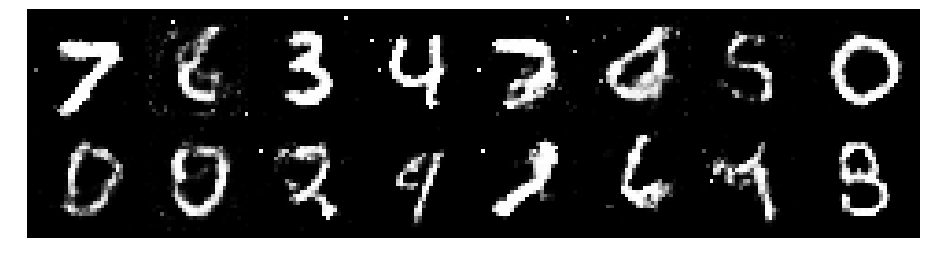

Epoch: [123/200], Batch Num: [300/600]
Discriminator Loss: 1.2230, Generator Loss: 1.0668
D(x): 0.5337, D(G(z)): 0.3956


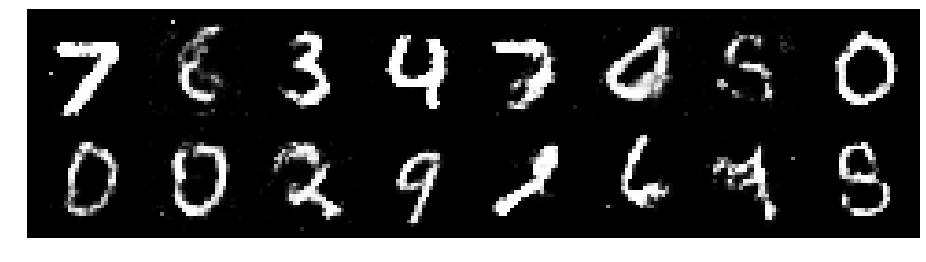

Epoch: [123/200], Batch Num: [400/600]
Discriminator Loss: 1.4378, Generator Loss: 0.8389
D(x): 0.5140, D(G(z)): 0.4680


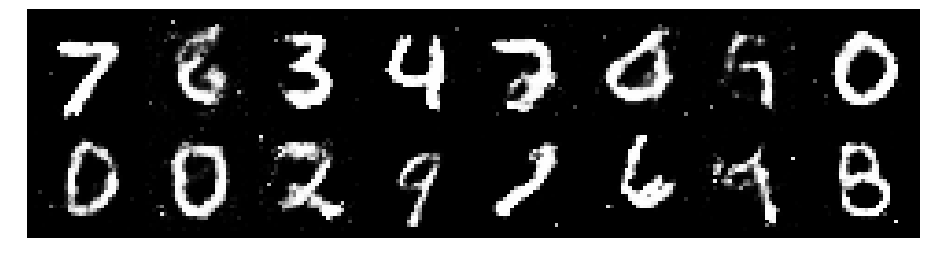

Epoch: [123/200], Batch Num: [500/600]
Discriminator Loss: 1.3119, Generator Loss: 0.9366
D(x): 0.5722, D(G(z)): 0.4498


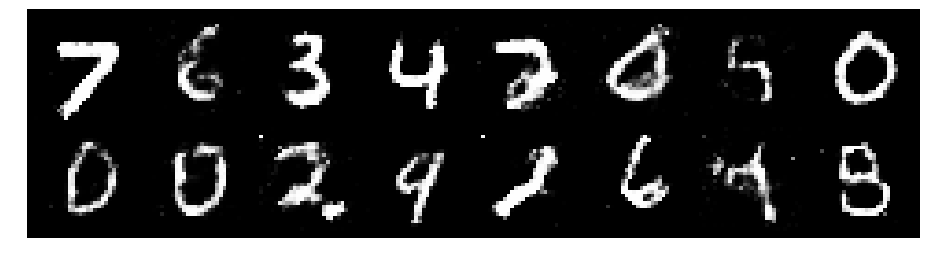

Epoch: [124/200], Batch Num: [0/600]
Discriminator Loss: 1.2513, Generator Loss: 0.9730
D(x): 0.5809, D(G(z)): 0.4553


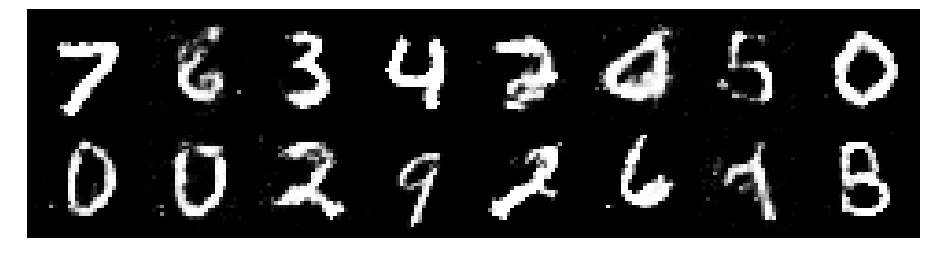

Epoch: [124/200], Batch Num: [100/600]
Discriminator Loss: 1.3641, Generator Loss: 0.8537
D(x): 0.5614, D(G(z)): 0.4929


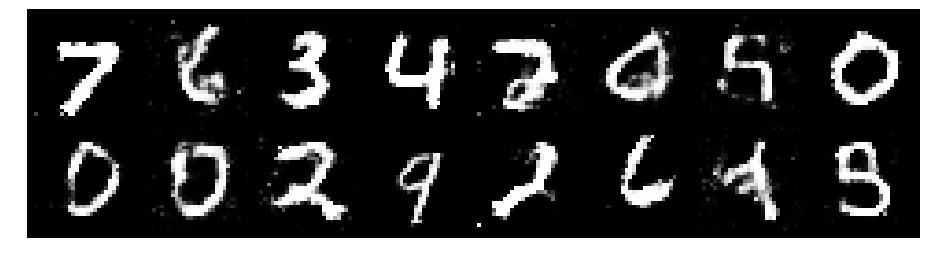

Epoch: [124/200], Batch Num: [200/600]
Discriminator Loss: 1.3929, Generator Loss: 0.7762
D(x): 0.5491, D(G(z)): 0.4835


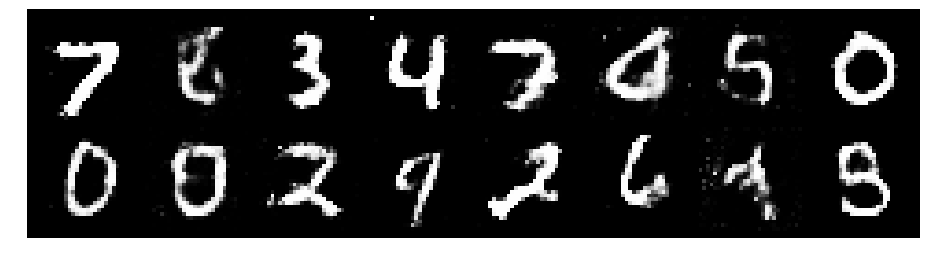

Epoch: [124/200], Batch Num: [300/600]
Discriminator Loss: 1.3813, Generator Loss: 0.8752
D(x): 0.5314, D(G(z)): 0.4762


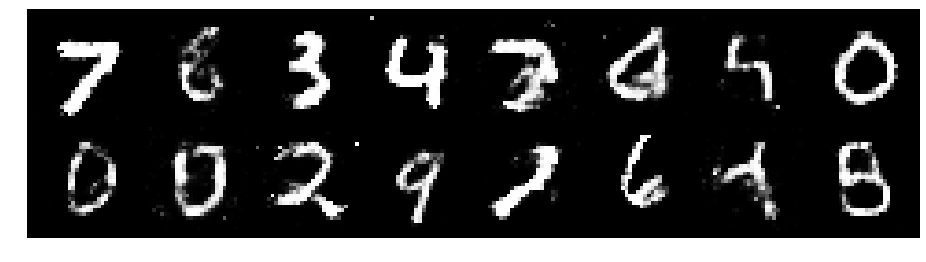

Epoch: [124/200], Batch Num: [400/600]
Discriminator Loss: 1.1768, Generator Loss: 0.9480
D(x): 0.5789, D(G(z)): 0.4092


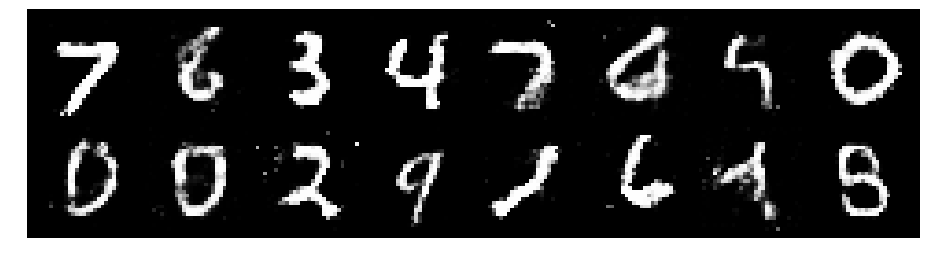

Epoch: [124/200], Batch Num: [500/600]
Discriminator Loss: 1.3117, Generator Loss: 0.8404
D(x): 0.5575, D(G(z)): 0.4777


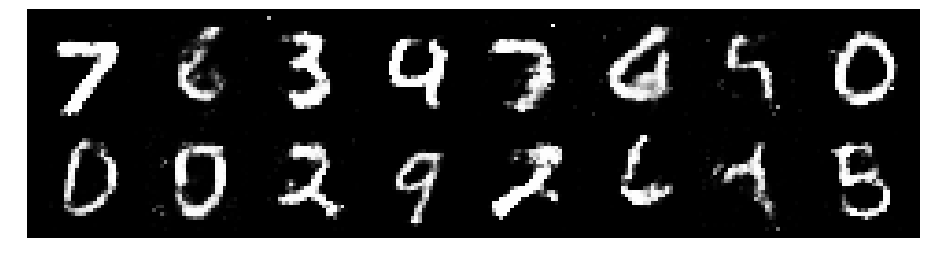

Epoch: [125/200], Batch Num: [0/600]
Discriminator Loss: 1.2971, Generator Loss: 0.8855
D(x): 0.5494, D(G(z)): 0.4495


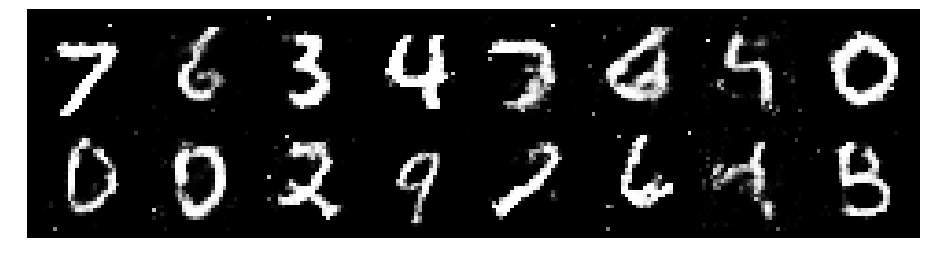

Epoch: [125/200], Batch Num: [100/600]
Discriminator Loss: 1.2091, Generator Loss: 0.9318
D(x): 0.5361, D(G(z)): 0.4119


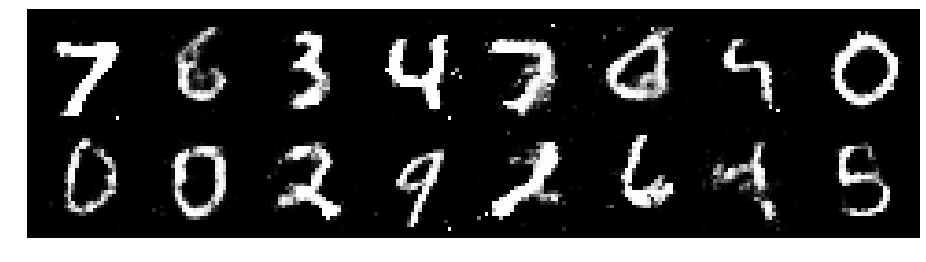

Epoch: [125/200], Batch Num: [200/600]
Discriminator Loss: 1.2592, Generator Loss: 0.9457
D(x): 0.5922, D(G(z)): 0.4675


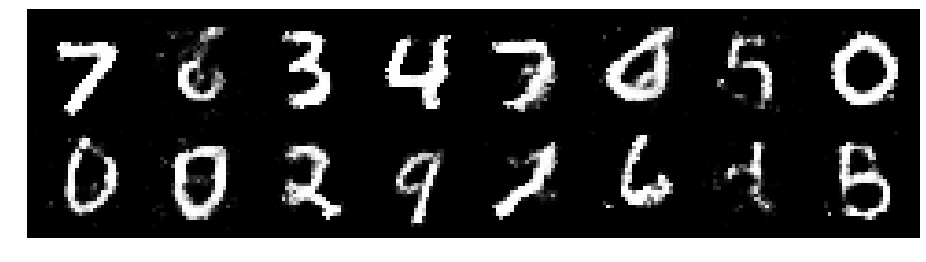

Epoch: [125/200], Batch Num: [300/600]
Discriminator Loss: 1.1677, Generator Loss: 0.9946
D(x): 0.6015, D(G(z)): 0.4201


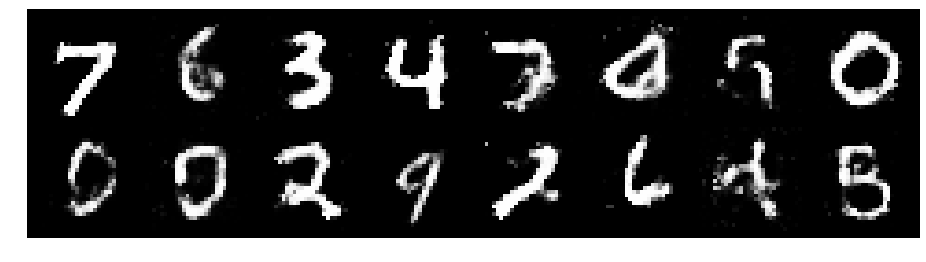

Epoch: [125/200], Batch Num: [400/600]
Discriminator Loss: 1.2294, Generator Loss: 1.0866
D(x): 0.5875, D(G(z)): 0.4342


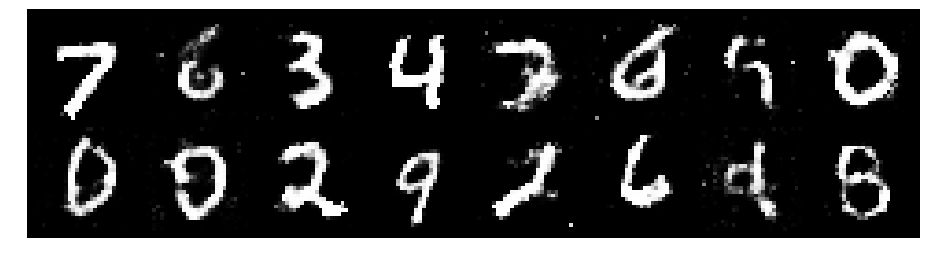

Epoch: [125/200], Batch Num: [500/600]
Discriminator Loss: 1.1553, Generator Loss: 1.0597
D(x): 0.5975, D(G(z)): 0.4190


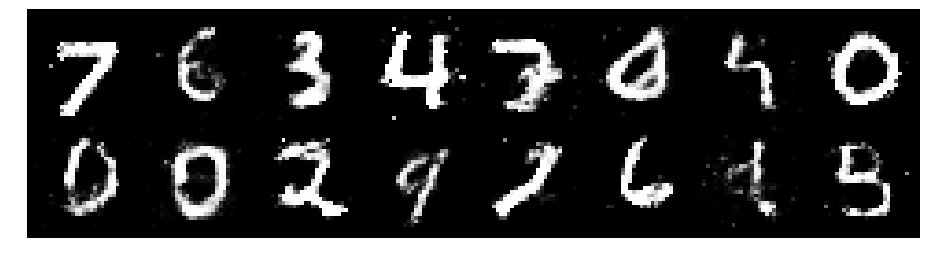

Epoch: [126/200], Batch Num: [0/600]
Discriminator Loss: 1.2563, Generator Loss: 0.9542
D(x): 0.5584, D(G(z)): 0.4186


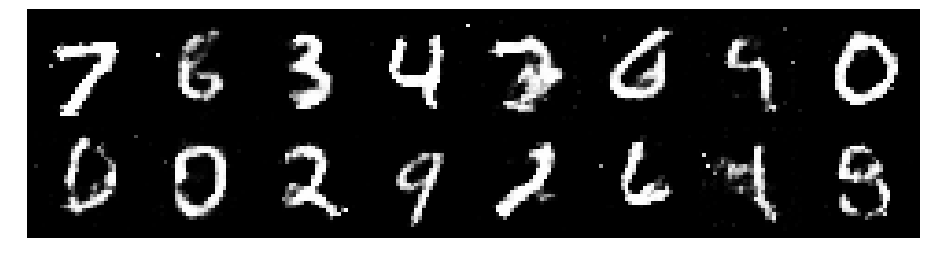

Epoch: [126/200], Batch Num: [100/600]
Discriminator Loss: 1.1880, Generator Loss: 0.8395
D(x): 0.5935, D(G(z)): 0.4232


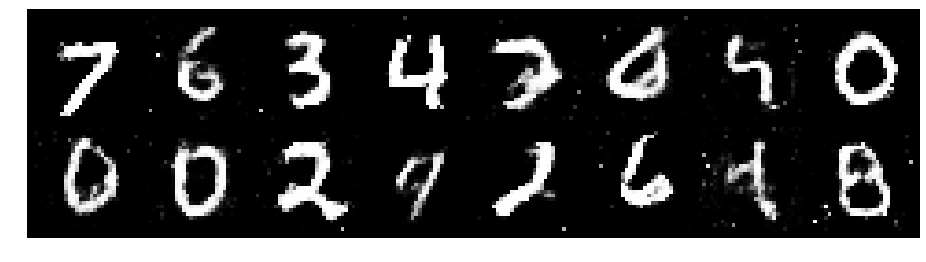

Epoch: [126/200], Batch Num: [200/600]
Discriminator Loss: 1.1962, Generator Loss: 0.8577
D(x): 0.6083, D(G(z)): 0.4392


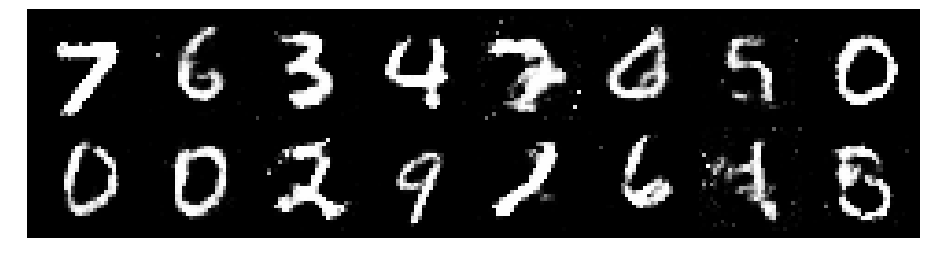

Epoch: [126/200], Batch Num: [300/600]
Discriminator Loss: 1.1334, Generator Loss: 1.0497
D(x): 0.5975, D(G(z)): 0.4009


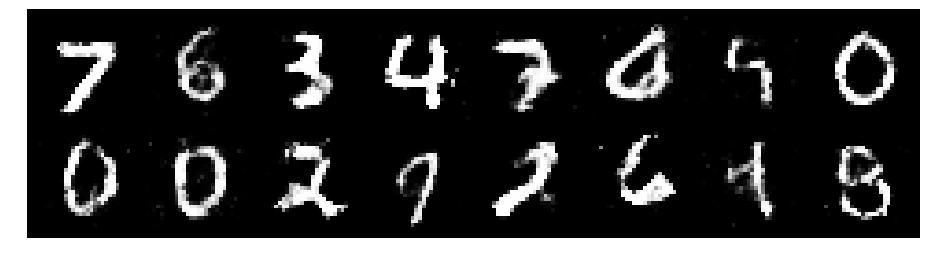

Epoch: [126/200], Batch Num: [400/600]
Discriminator Loss: 1.2544, Generator Loss: 0.9601
D(x): 0.5798, D(G(z)): 0.4531


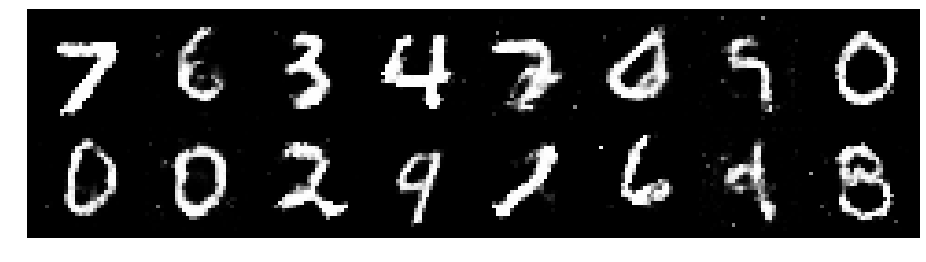

Epoch: [126/200], Batch Num: [500/600]
Discriminator Loss: 1.2468, Generator Loss: 0.9352
D(x): 0.5894, D(G(z)): 0.4742


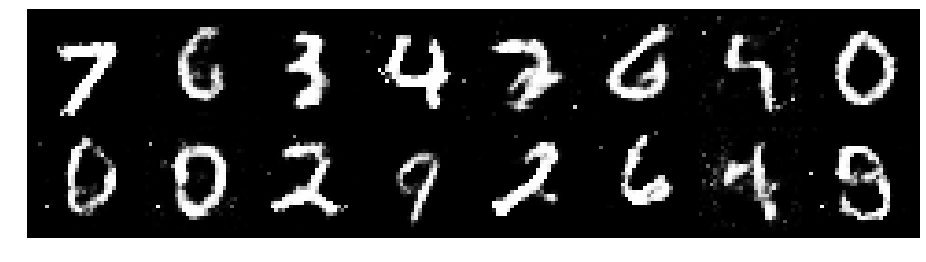

Epoch: [127/200], Batch Num: [0/600]
Discriminator Loss: 1.1875, Generator Loss: 0.9717
D(x): 0.5831, D(G(z)): 0.4132


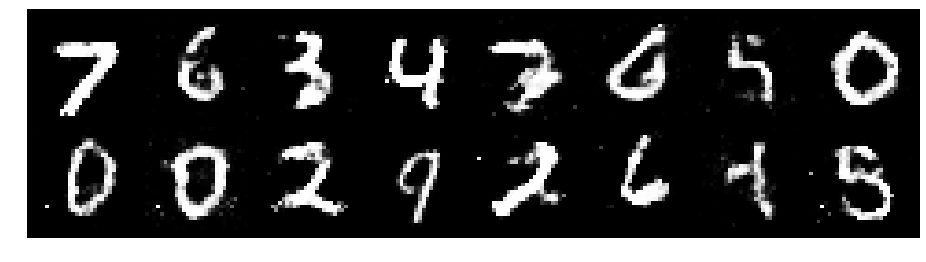

Epoch: [127/200], Batch Num: [100/600]
Discriminator Loss: 1.2740, Generator Loss: 1.0454
D(x): 0.5514, D(G(z)): 0.4241


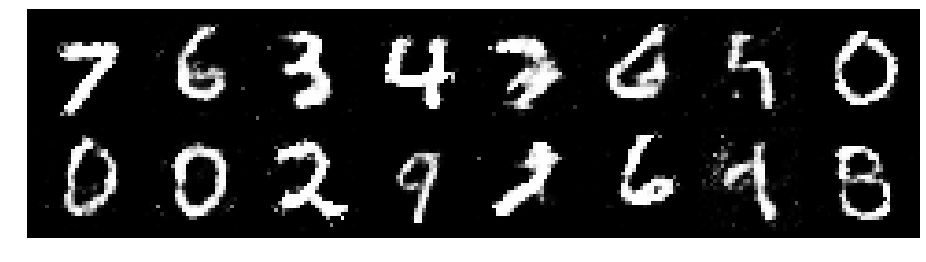

Epoch: [127/200], Batch Num: [200/600]
Discriminator Loss: 1.1711, Generator Loss: 0.8964
D(x): 0.6020, D(G(z)): 0.4393


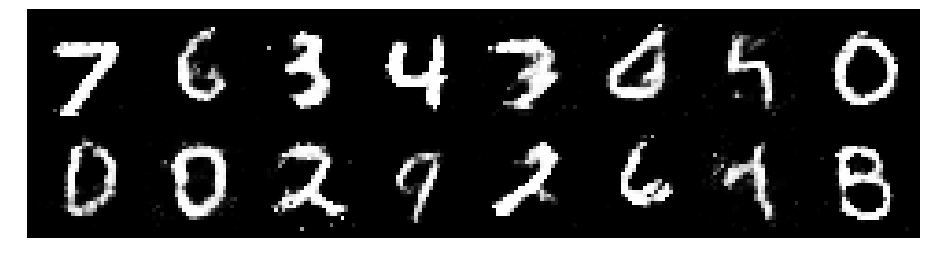

Epoch: [127/200], Batch Num: [300/600]
Discriminator Loss: 1.2088, Generator Loss: 0.9102
D(x): 0.5619, D(G(z)): 0.4146


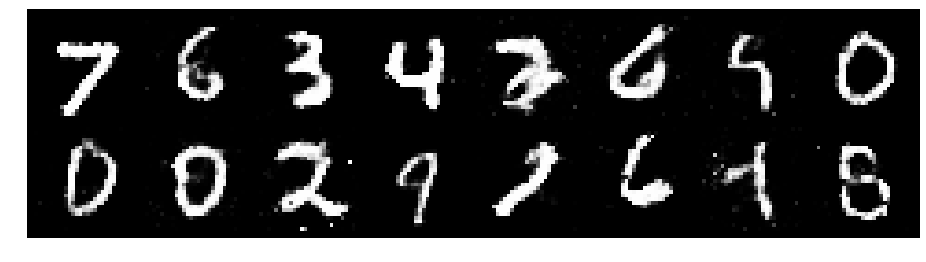

Epoch: [127/200], Batch Num: [400/600]
Discriminator Loss: 1.2439, Generator Loss: 0.7900
D(x): 0.5738, D(G(z)): 0.4517


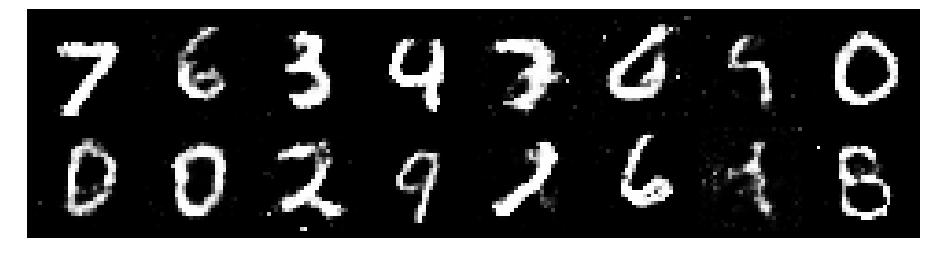

Epoch: [127/200], Batch Num: [500/600]
Discriminator Loss: 1.2575, Generator Loss: 0.8844
D(x): 0.5877, D(G(z)): 0.4607


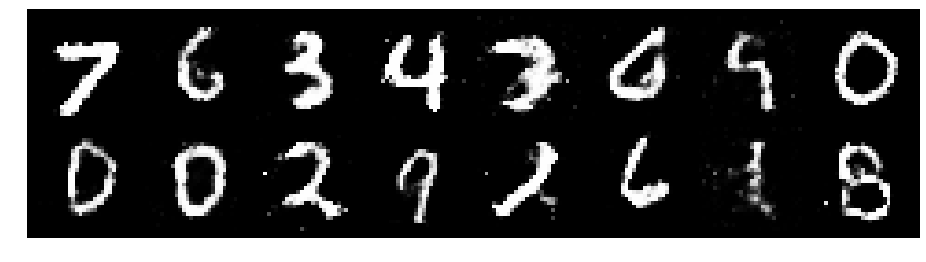

Epoch: [128/200], Batch Num: [0/600]
Discriminator Loss: 1.2797, Generator Loss: 0.8022
D(x): 0.5803, D(G(z)): 0.4687


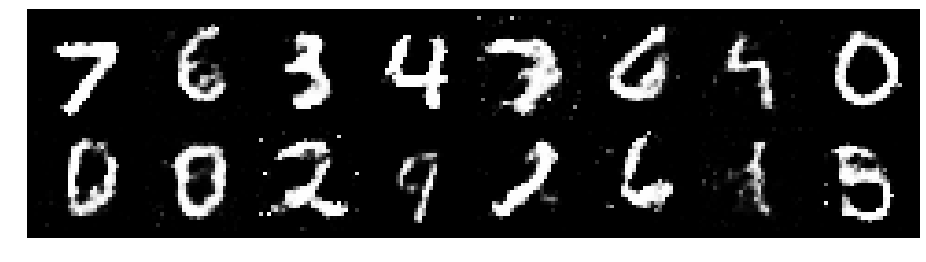

Epoch: [128/200], Batch Num: [100/600]
Discriminator Loss: 1.2651, Generator Loss: 0.8854
D(x): 0.5911, D(G(z)): 0.4499


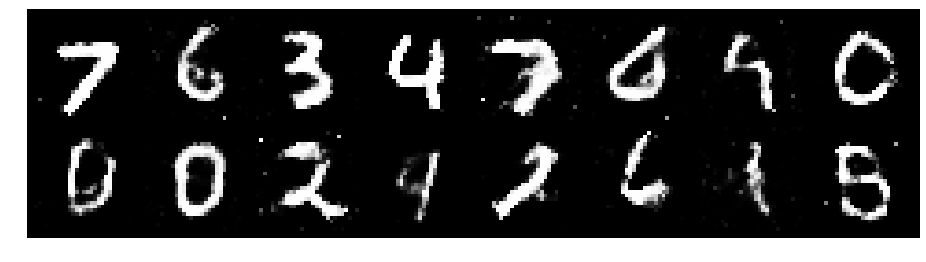

Epoch: [128/200], Batch Num: [200/600]
Discriminator Loss: 1.3085, Generator Loss: 0.7587
D(x): 0.5377, D(G(z)): 0.4388


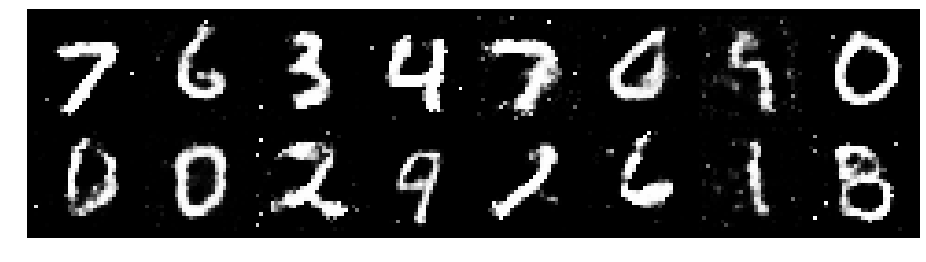

Epoch: [128/200], Batch Num: [300/600]
Discriminator Loss: 1.2232, Generator Loss: 0.8912
D(x): 0.5658, D(G(z)): 0.4247


In [0]:
logger = Logger(model_name='VGAN', data_name='MNIST')
# Total number of epochs to train
num_epochs = 200
for epoch in range(num_epochs):
    for n_batch, (real_batch,_) in enumerate(data_loader):
        N = real_batch.size(0)
        # 1. Train Discriminator
        real_data = Variable(images_to_vectors(real_batch)).cuda()
        # Generate fake data and detach 
        # (so gradients are not calculated for generator)
        fake_data = generator(noise(N).cuda()).detach()
        # Train D
        d_error, d_pred_real, d_pred_fake = \
              train_discriminator(d_optimizer, real_data, fake_data)

        # 2. Train Generator
        # Generate fake data
        fake_data = generator(noise(N).cuda())
        # Train G
        g_error = train_generator(g_optimizer, fake_data)
        # Log batch error
        logger.log(d_error, g_error, epoch, n_batch, num_batches)
        # Display Progress every few batches
        if (n_batch) % 100 == 0: 
            test_images = vectors_to_images(generator(test_noise.cuda()))
            test_images = test_images.data
            logger.log_images(
                test_images, num_test_samples, 
                epoch, n_batch, num_batches
            );
            # Display status Logs
            logger.display_status(
                epoch, num_epochs, n_batch, num_batches,
                d_error, g_error, d_pred_real, d_pred_fake
            )